# Описание

## Задачи
_Испольуется три задачи:_
- DM -- двухальтернативный выбор
- Romo -- сравнение двух сигнало через задержку
- CtxDM -- DM с контекстом
Вход состоит из одного контекстного входа, одного стимула, 6 входов, кодирующих задачи. Выход как и раньше состоит из трех частей: контекстный выход, выходы принятия решения.

## Сеть
 Сеть состоит из lif AdEx нейронов

# Импорт всех необходимых библиотек

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from cgtasknet.instruments.instrument_accuracy_network import CorrectAnswerNetwork
from cgtasknet.tasks.reduce import (
    CtxDMTaskParameters,
    DMTaskParameters,
    DMTaskRandomModParameters,
    GoDlTaskParameters,
    GoDlTaskRandomModParameters,
    GoRtTaskParameters,
    GoRtTaskRandomModParameters,
    GoTaskParameters,
    GoTaskRandomModParameters,
    MultyReduceTasks,
    RomoTaskParameters,
    RomoTaskRandomModParameters,
)
from tqdm import tqdm

# Определяем устройство

In [2]:
device = torch.device("cuda:2" if torch.cuda.is_available() else "cpu")
print(f"{device}")

cuda:2


# Функция построения входов и выходов

In [3]:
import os


def plot_results(inputs, target_outputs, outputs):
    if isinstance(inputs, torch.Tensor) and isinstance(target_outputs, torch.Tensor):
        inputs, t_outputs = (
            inputs.detach().cpu().numpy(),
            target_outputs.detach().cpu().numpy(),
        )
    for bath in range(min(batch_size, 20)):
        fig = plt.figure(figsize=(15, 3))
        ax1 = fig.add_subplot(141)
        plt.title("Inputs")
        plt.xlabel("$time, ms$")
        plt.ylabel("$Magnitude$")
        for i in range(3):
            plt.plot(inputs[:, bath, i].T, label=rf"$in_{i + 1}$")
        plt.legend()
        plt.tight_layout()

        ax2 = fig.add_subplot(142)
        plt.title("Task code (context)")
        plt.xticks(np.arange(1, len(tasks) + 1), sorted(tasks), rotation=90)
        plt.yticks([])
        for i in range(3, inputs.shape[-1]):
            plt.plot([i - 2] * 2, [0, inputs[0, bath, i]])
        plt.tight_layout()

        ax3 = fig.add_subplot(143)
        plt.title("Target output")
        plt.xlabel("$time, ms$")
        for i in range(t_outputs.shape[-1]):
            plt.plot(t_outputs[:, bath, i], label=rf"$out_{i + 1}$")
        plt.legend()
        plt.tight_layout()

        ax4 = fig.add_subplot(144)
        plt.title("Real output")
        plt.xlabel("$time, ms$")
        for i in range(outputs.shape[-1]):
            plt.plot(
                outputs.detach().cpu().numpy()[:, bath, i], label=rf"$out_{i + 1}$"
            )
        plt.legend()
        plt.tight_layout()
        if not os.path.exists("figures"):
            os.mkdir("figures")
        plt.savefig(f"figures{os.sep}network_outputs_{name}_batch_{bath}.pdf")
        plt.show()
        plt.close()

# Определяем датасет
Датасет будет состоять из трех типов задач:
- DM задача;
- Romo задача;
- CtxDM задача.
_Параметры для последней задачи аналогичны DM задаче_
***
## Параметры датасета:

In [4]:
batch_size = 32
number_of_epochs = 3000
number_of_tasks = 2

go_task_list_values = np.linspace(0, 1, 8)

romo_parameters = RomoTaskRandomModParameters(
    romo=RomoTaskParameters(
        delay=0.2,
        positive_shift_delay_time=1.5,
        trial_time=0.2,
        positive_shift_trial_time=0.4,
        answer_time=0.25,
    ),
)
dm_parameters = DMTaskRandomModParameters(
    dm=DMTaskParameters(trial_time=0.3, positive_shift_trial_time=1.5, answer_time=0.25)
)
ctx_parameters = CtxDMTaskParameters(dm=dm_parameters.dm)
go_parameters = GoTaskRandomModParameters(
    go=GoTaskParameters(
        trial_time=0.3,
        positive_shift_trial_time=1.5,
        value=go_task_list_values,
        answer_time=0.25,
    )
)
gort_parameters = GoRtTaskRandomModParameters(
    go_rt=GoRtTaskParameters(
        trial_time=0.3,
        positive_shift_trial_time=1.5,
        answer_time=1.5,
        value=go_task_list_values,
    )
)
godl_parameters = GoDlTaskRandomModParameters(
    go_dl=GoDlTaskParameters(
        go=GoTaskParameters(
            trial_time=0.2,
            positive_shift_trial_time=0.4,
            answer_time=0.25,
            value=go_task_list_values,
        ),
        delay=0.2,
        positive_shift_delay_time=1.5,
    )
)

## Датасет

In [5]:
sigma = 0.5
tasks = [
    "RomoTask1",
    "RomoTask2",
    "DMTask1",
    "DMTask2",
    "CtxDMTask1",
    "CtxDMTask2",
    "GoTask1",
    "GoTask2",
    "GoRtTask1",
    "GoRtTask2",
    "GoDlTask1",
    "GoDlTask2",
]
task_dict = {
    tasks[0]: romo_parameters,
    tasks[1]: romo_parameters,
    tasks[2]: dm_parameters,
    tasks[3]: dm_parameters,
    tasks[4]: ctx_parameters,
    tasks[5]: ctx_parameters,
    tasks[6]: go_parameters,
    tasks[7]: go_parameters,
    tasks[8]: gort_parameters,
    tasks[9]: gort_parameters,
    tasks[10]: godl_parameters,
    tasks[11]: godl_parameters,
}
Task = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
)

print("Task parameters:")
for key in task_dict:
    print(f"{key}:\n{task_dict[key]}\n")

print(f"inputs/outputs: {Task.feature_and_act_size[0]}/{Task.feature_and_act_size[1]}")

Task parameters:
RomoTask1:
RomoTaskRandomModParameters(romo=RomoTaskParameters(dt=0.001, trial_time=0.2, answer_time=0.25, value=(None, None), delay=0.2, negative_shift_trial_time=0, positive_shift_trial_time=0.4, negative_shift_delay_time=0, positive_shift_delay_time=1.5), n_mods=2)

RomoTask2:
RomoTaskRandomModParameters(romo=RomoTaskParameters(dt=0.001, trial_time=0.2, answer_time=0.25, value=(None, None), delay=0.2, negative_shift_trial_time=0, positive_shift_trial_time=0.4, negative_shift_delay_time=0, positive_shift_delay_time=1.5), n_mods=2)

DMTask1:
DMTaskRandomModParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3, answer_time=0.25, value=None, negative_shift_trial_time=0, positive_shift_trial_time=1.5), n_mods=2)

DMTask2:
DMTaskRandomModParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3, answer_time=0.25, value=None, negative_shift_trial_time=0, positive_shift_trial_time=1.5), n_mods=2)

CtxDMTask1:
CtxDMTaskParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3,

In [6]:
sorted_tasks = sorted(tasks)
re_word = "Go"
choices_tasks = []
values_tasks = []
for i in range(len(sorted_tasks)):
    if re_word in sorted_tasks[i]:
        values_tasks.append(i)
    else:
        choices_tasks.append(i)
can = CorrectAnswerNetwork(choices_tasks, values_tasks, 0.15)

# Инициализация сети и выгрузка на device

In [7]:
from cgtasknet.net import SNNlifadex
from norse.torch import LIFAdExParameters

feature_size, output_size = Task.feature_and_act_size
hidden_size = 256

neuron_parameters = LIFAdExParameters(
    v_th=torch.as_tensor(0.45),
    tau_ada_inv=torch.as_tensor(1 / 2.0),
    alpha=100,
    method="super",
    # rho_reset = torch.as_tensor(5)
)
model = SNNlifadex(
    feature_size,
    hidden_size,
    output_size,
    neuron_parameters=neuron_parameters,
    tau_filter_inv=80,
    save_states=True,
    return_spiking=True
    
).to(device)
for name, param in model.named_parameters():
    if name == 'alif.recurrent_weights':
        initial_parameters = torch.clone(param.detach().cpu())


inputs, _ = Task.dataset(1)
inputs *= 0
additionalCurrent = 0.1 * torch.randn((1, hidden_size)).to(device) + 1.4
inputs = torch.from_numpy(inputs[-1000:]).type(torch.float).to(device)
outputs, states = model(inputs, additional_current = additionalCurrent)
outputs = outputs.detach().cpu()
plt.plot(outputs[:, 0, 0])
plt.show()
plt.close()

mean_fr = torch.zeros((hidden_size))

for i in range(len(states)):
    mean_fr += torch.mean(states[i].z.detach().cpu(), axis=0)
mean_fr /= len(states)
plt.plot(mean_fr == 0, '.')

mean_fr = torch.zeros((hidden_size))

for i in range(len(states)):
    mean_fr += torch.mean(states[i].z.detach().cpu(), axis=0)
mean_fr /= len(states)
plt.plot(mean_fr, '.')

# Критерий и функция ошибки

In [8]:
learning_rate = 5e-3
reg_freq = 1e3 #1e3 for square #for 600 1e5
class RMSELoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.mse = nn.MSELoss()

    def forward(self, yhat, y):
        return torch.sqrt(self.mse(yhat, y))


class MaskedMSELoss(torch.nn.Module):
    def __init__(self):
        super(MaskedMSELoss, self).__init__()

    def forward(self, input, target, mask):
        diff2 = (torch.flatten(input) - torch.flatten(target)) ** 2.0 * torch.flatten(
            mask
        )
        result = torch.sum(diff2) / torch.sum(mask)
        return result

class MaskedAndFrRegMSELoss(torch.nn.Module):
    def __init__(self):
        super(MaskedAndFrRegMSELoss, self).__init__()
        
    def forward(self, input, target, mask, state):
        diff2 = (torch.flatten(input) - torch.flatten(target)) ** 2.0 * torch.flatten(
        mask)
        result = torch.sum(diff2) / torch.sum(mask)
        s = []
        for i in range(len(state)):
            s.append(state[i])
        s = torch.stack(s)
        fr_neurons_mean = torch.mean(torch.mean(s, axis=0), axis=0)
        coefs = ((fr_neurons_mean > .03)).detach()
        fr_neurons_mean *= coefs
        fr_neurons_mean = torch.mean(fr_neurons_mean)
        result += fr_neurons_mean  * reg_freq
        return result

class MaskedAndFrBinsRegMSELoss(torch.nn.Module):
    
    def __init__(self):
        super(MaskedAndFrBinsRegMSELoss, self).__init__()
        
    def forward(self, input, target, mask, state, window=100):
        diff2 = (torch.flatten(input) - torch.flatten(target)) ** 2.0 * torch.flatten(
        mask)
        result = torch.sum(diff2) / torch.sum(mask)
        s = []
        for i in range(len(state)):
            s.append(state[i])
        s = torch.stack(s)
        time_series = len(s)
        mant = len(s) % window
        mant_ind = bool(mant)
        Nbin = time_series // window + int(mant_ind)
        s_bin = torch.zeros((Nbin, s.shape[1], s.shape[2]), requires_grad = True).to(device)
        
        for i in range(Nbin - 1):
            s_bin[i, ...] = torch.mean(s[i * window: (i + 1) * window, ...], axis=0)
        if not mant_ind:
            s_bin[-1, ...] = torch.mean(s[-window:, ...], axis=0)
        else:
            s_bin[-1, ...] = torch.mean(s[-mant:, ...], axis=0)
        coefs = ((s_bin > .02)).detach()
        s_bin *= coefs
        s_bin = torch.mean(s_bin, axis=[1, 2]) ** 2
        result += reg_freq * torch.sum(s_bin)
        return result
criterion = MaskedAndFrRegMSELoss()
#criterion = MaskedAndFrBinsRegMSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

## Генерация всех эпох
> Если память не позволяет, то необходимо генерировать каждую эпоху в основном цикле обучения

In [9]:
if False:
    list_inputs = []
    list_t_outputs = []
    for i in tqdm(range(number_of_epochs)):
        temp_input, temp_t_output = Task.dataset()
        temp_input.astype(dtype=np.float16)
        temp_t_output.astype(dtype=np.float16)
        temp_input[:, :, :] += np.random.normal(0, sigma, size=temp_input.shape)
        list_inputs.append(temp_input)
        list_t_outputs.append(temp_t_output)

# JIT numba generator (test)
TODO: Необходимо добавить в cgtasknet и вызывать оттуда

In [10]:
#from numba import njit, prange


#@njit(cache=True, parallel=True)
def every_bath_generator(
        start_sigma: float,
        stop_sigma: float,
        times: int = 1,
        batches: int = 1,
        actions: int = 1,
):
    data = np.zeros((times, batches, actions))
    for i in range(batches):
        data[:, i, :] = np.random.normal(
            0, np.random.uniform(start_sigma, stop_sigma), size=(times, actions)
        )
    return data

In [11]:
torch.cuda.empty_cache()


In [12]:
from norse.torch import LIFAdExState
Task_test = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
    task_number=6
)
def check_mean_fr(task = Task):
    init_state = LIFAdExState(
            torch.zeros(batch_size, hidden_size).to(device),
            torch.rand(batch_size, hidden_size).to(device),
            torch.zeros(batch_size, hidden_size).to(device),
            torch.zeros(batch_size, hidden_size).to(device),
        )
    inputs, target_outputs = task.dataset(1)

    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    result = model(inputs, init_state,)
    #del inputs, init_state
    torch.cuda.empty_cache()
    states = result[-1]
    spikes = []
    for state in states:
        spikes.append(state.detach().cpu())

    last_fix = torch.where(inputs[:, :, 0] == 1)[0][-1].item()
    #s = torch.stack(spikes)[:last_fix, ...]
    s = torch.stack(spikes)[:, ...]
    freq_sequence_new = torch.sort(
        torch.mean(torch.mean(s, axis=0), axis=0), dim=0
    ).values
    for i in range(len(freq_sequence_new)):
        plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")
    plt.show()
    plt.close()
    index=0
    plt.plot(target_outputs[:, index, 0].detach().cpu(), c='r')
    plt.plot(target_outputs[:, index, 1].detach().cpu(), c='b')
    plt.plot(target_outputs[:, index, 2].detach().cpu(), c='g')

    plt.plot(result[0][:, index, 0].detach().cpu(), c='r', alpha=.6
            )
    plt.plot(result[0][:, index, 1].detach().cpu(), c='b', alpha=.6
            )
    plt.plot(result[0][:, index, 2].detach().cpu(), c='g', alpha=.6
        )
    plt.show()
    plt.close()
#check_mean_fr()

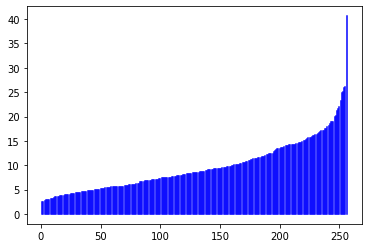

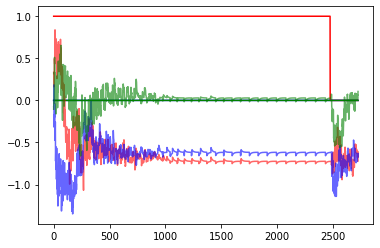

In [13]:
test = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
    task_number=1
)
check_mean_fr(Task)

# Основной цикл обучения

  0%|▏                                                                                                                                                              | 4/3000 [01:04<13:40:02, 16.42s/it]

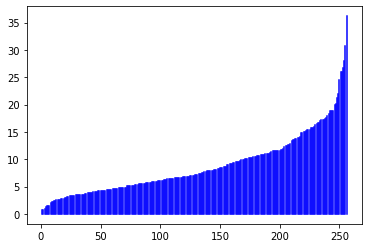

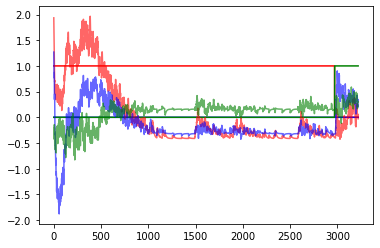

  0%|▍                                                                                                                                                              | 9/3000 [02:39<14:34:17, 17.54s/it]

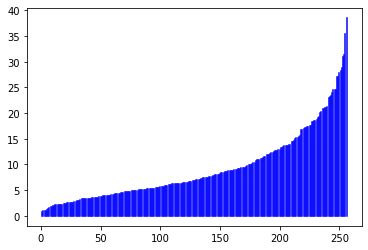

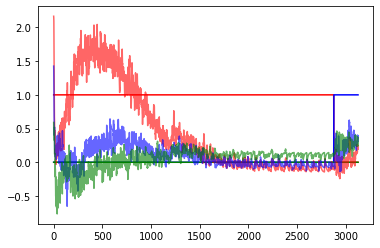

  0%|▋                                                                                                                                                             | 14/3000 [04:05<13:59:13, 16.86s/it]

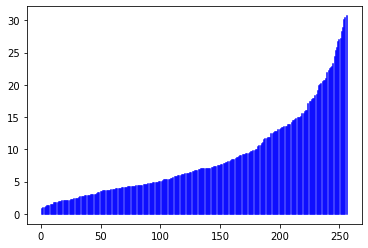

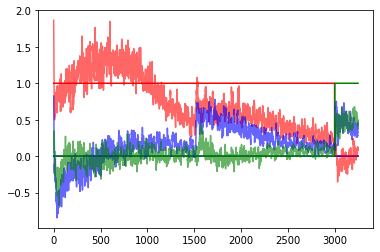

  1%|█                                                                                                                                                             | 19/3000 [05:27<13:12:15, 15.95s/it]

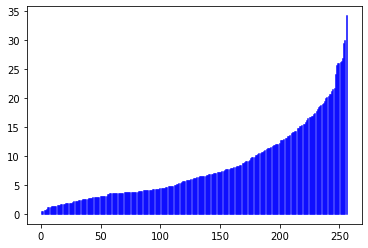

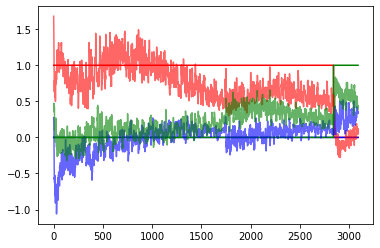

  1%|█▎                                                                                                                                                            | 24/3000 [07:01<14:40:02, 17.74s/it]

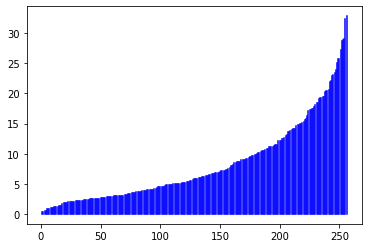

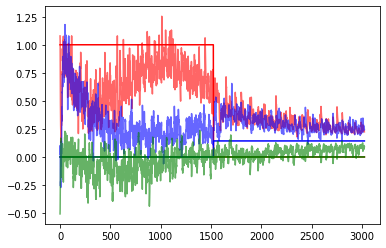

  1%|█▌                                                                                                                                                            | 29/3000 [08:29<14:41:37, 17.80s/it]

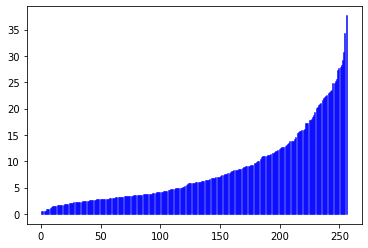

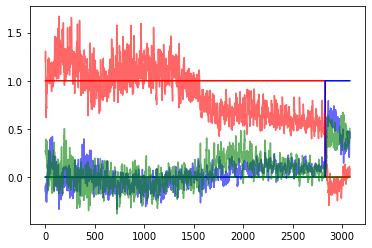

  1%|█▊                                                                                                                                                            | 34/3000 [10:06<15:18:36, 18.58s/it]

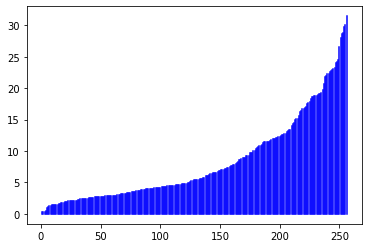

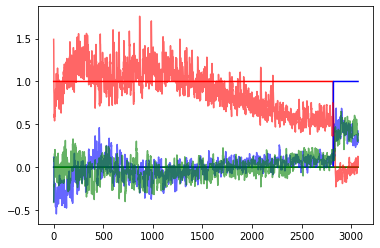

  1%|██                                                                                                                                                            | 39/3000 [11:36<13:59:11, 17.00s/it]

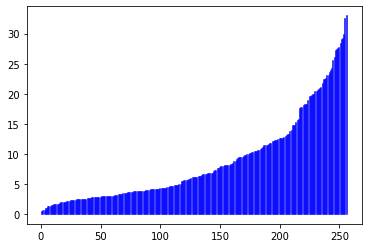

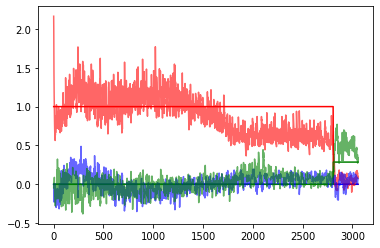

  1%|██▎                                                                                                                                                           | 44/3000 [13:04<14:07:07, 17.19s/it]

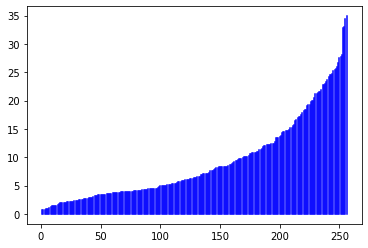

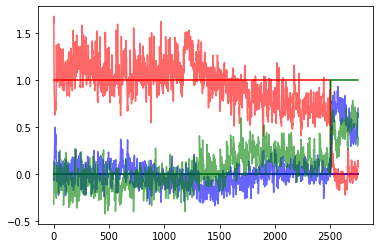

  2%|██▌                                                                                                                                                           | 49/3000 [14:24<12:51:57, 15.70s/it]

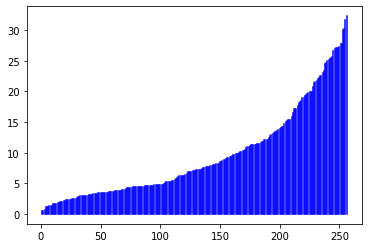

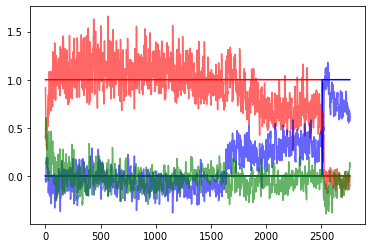

  2%|██▊                                                                                                                                                           | 54/3000 [16:42<17:41:03, 21.61s/it]

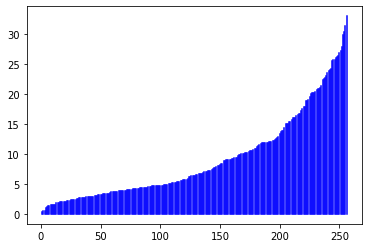

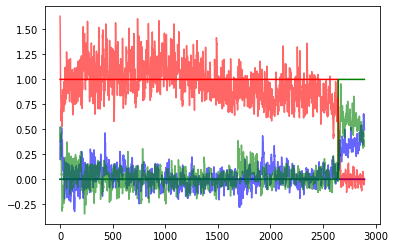

  2%|███                                                                                                                                                           | 59/3000 [18:17<15:00:49, 18.38s/it]

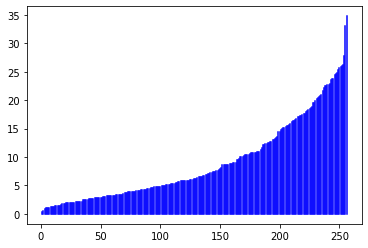

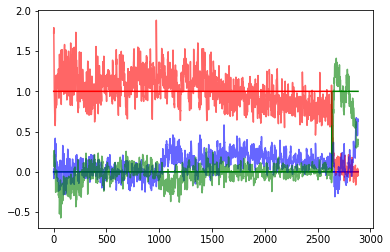

  2%|███▎                                                                                                                                                          | 64/3000 [19:49<14:57:11, 18.33s/it]

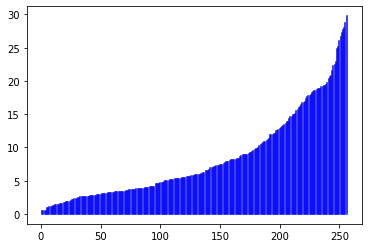

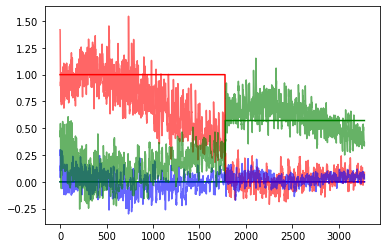

  2%|███▋                                                                                                                                                          | 69/3000 [21:15<13:31:14, 16.61s/it]

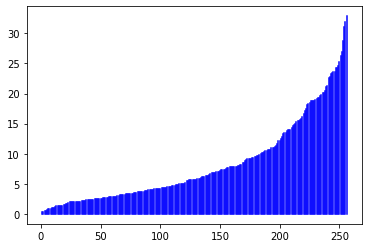

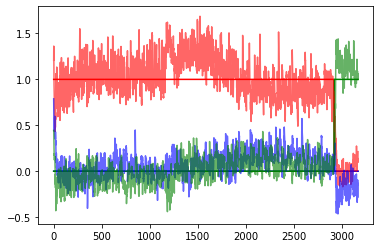

  2%|███▉                                                                                                                                                          | 74/3000 [22:41<13:10:00, 16.20s/it]

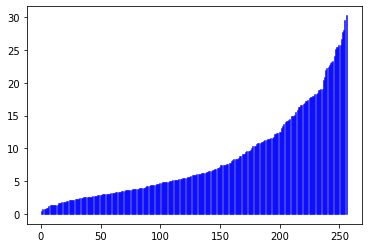

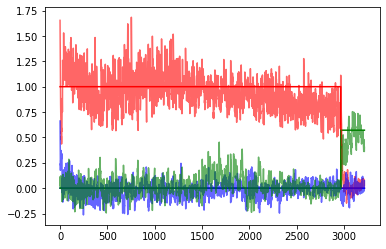

  3%|████▏                                                                                                                                                         | 79/3000 [24:06<13:24:05, 16.52s/it]

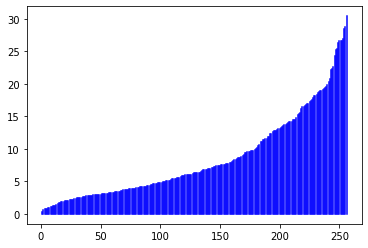

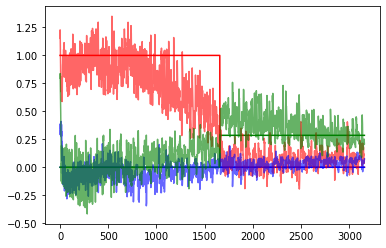

  3%|████▍                                                                                                                                                         | 84/3000 [25:33<13:39:00, 16.85s/it]

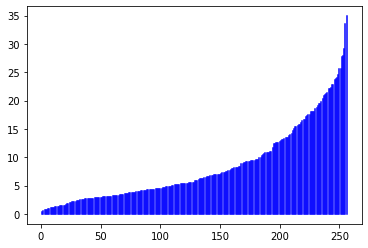

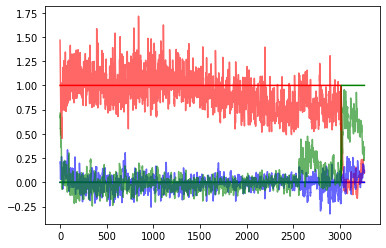

  3%|████▋                                                                                                                                                         | 89/3000 [27:00<13:33:54, 16.78s/it]

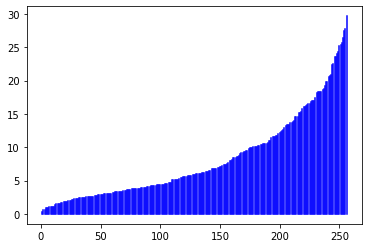

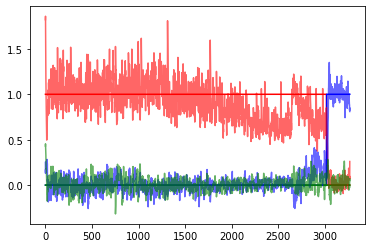

  3%|████▉                                                                                                                                                         | 94/3000 [28:25<13:17:18, 16.46s/it]

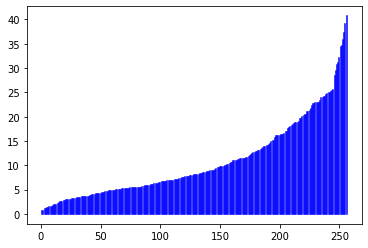

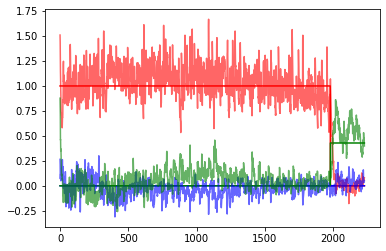

  3%|█████▏                                                                                                                                                        | 99/3000 [29:45<12:49:54, 15.92s/it]

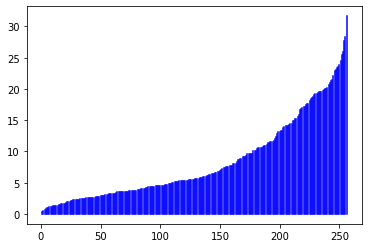

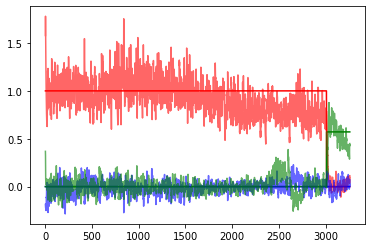

  3%|█████▍                                                                                                                                                       | 104/3000 [31:47<15:04:24, 18.74s/it]

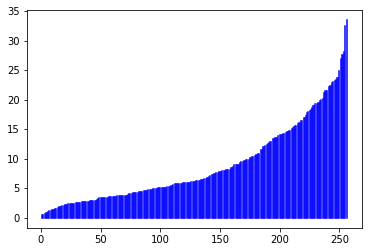

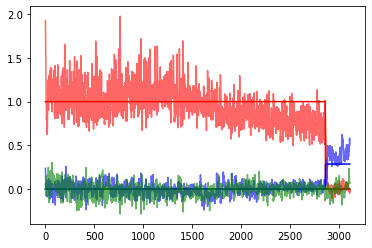

  4%|█████▋                                                                                                                                                       | 109/3000 [33:11<13:27:38, 16.76s/it]

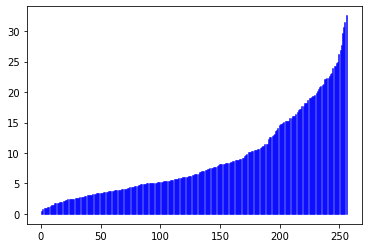

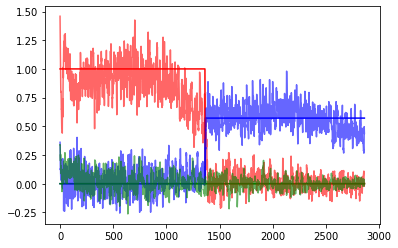

  4%|█████▉                                                                                                                                                       | 114/3000 [34:38<13:28:01, 16.80s/it]

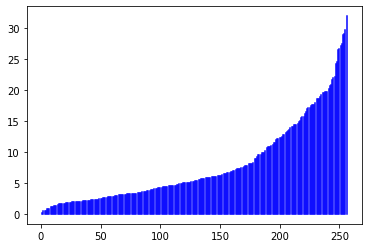

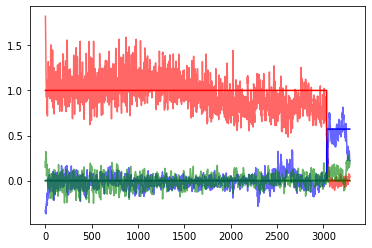

  4%|██████▏                                                                                                                                                      | 119/3000 [36:03<13:19:56, 16.66s/it]

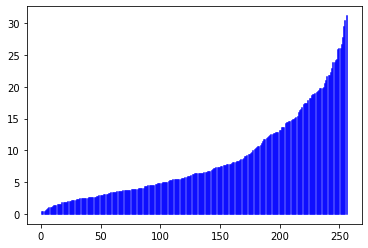

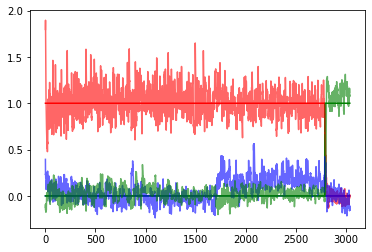

  4%|██████▍                                                                                                                                                      | 124/3000 [37:21<12:15:07, 15.34s/it]

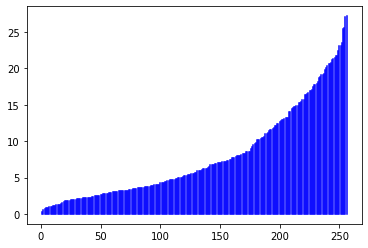

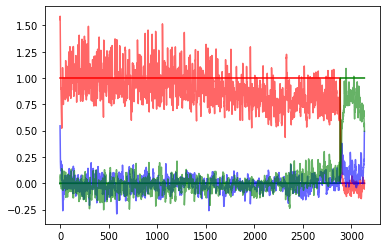

  4%|██████▊                                                                                                                                                      | 129/3000 [38:44<12:37:38, 15.83s/it]

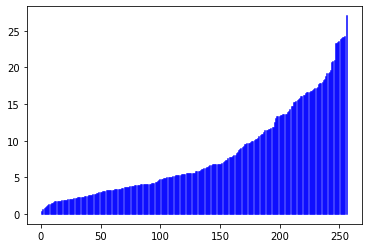

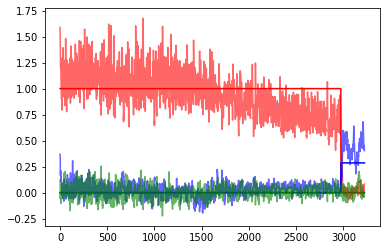

  4%|███████                                                                                                                                                      | 134/3000 [40:07<12:54:37, 16.22s/it]

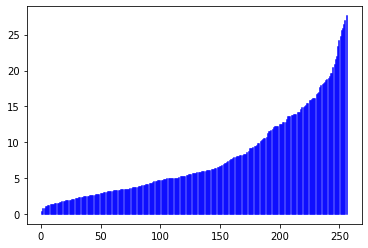

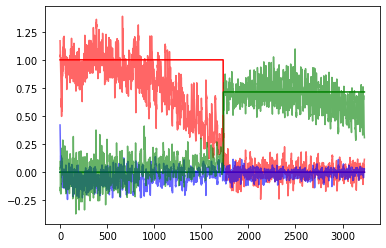

  5%|███████▎                                                                                                                                                     | 139/3000 [41:34<13:41:18, 17.22s/it]

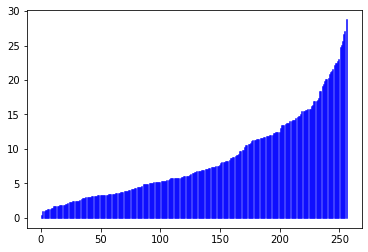

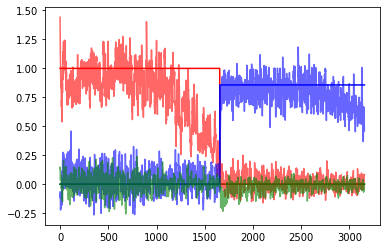

  5%|███████▌                                                                                                                                                     | 144/3000 [43:12<14:28:33, 18.25s/it]

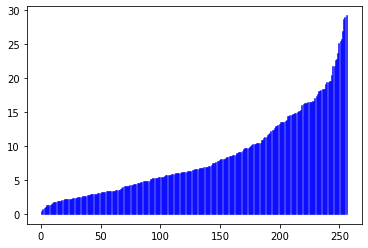

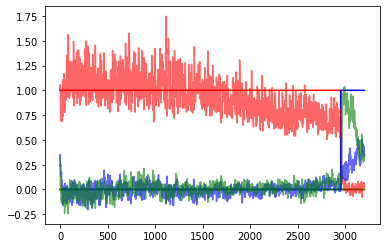

  5%|███████▊                                                                                                                                                     | 149/3000 [44:32<12:43:00, 16.06s/it]

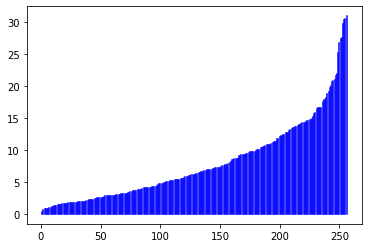

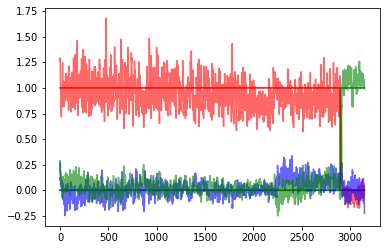

  5%|████████                                                                                                                                                     | 154/3000 [46:34<14:52:47, 18.82s/it]

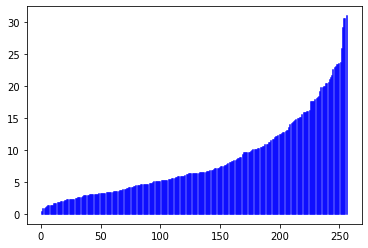

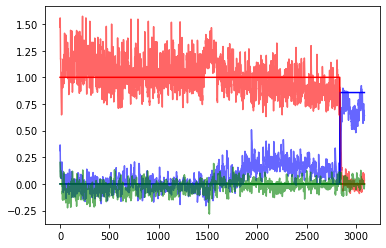

  5%|████████▎                                                                                                                                                    | 159/3000 [48:04<13:58:07, 17.70s/it]

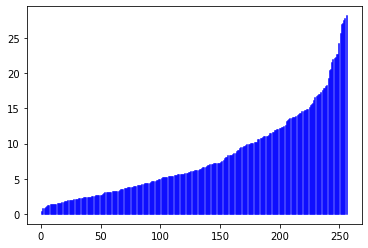

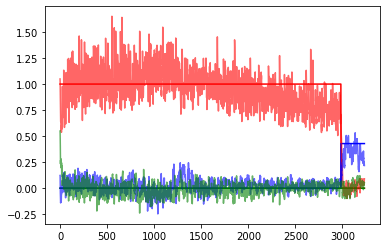

  5%|████████▌                                                                                                                                                    | 164/3000 [49:27<12:53:57, 16.37s/it]

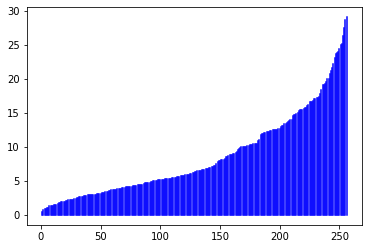

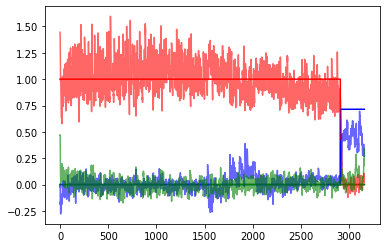

  6%|████████▊                                                                                                                                                    | 169/3000 [50:50<12:29:01, 15.87s/it]

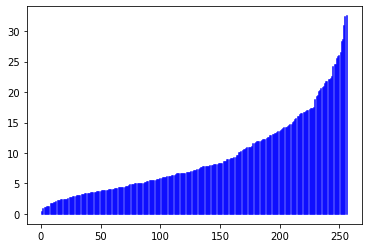

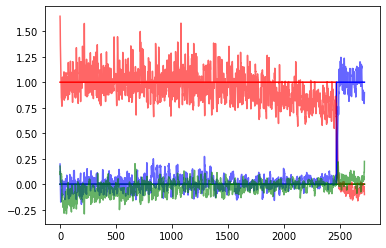

  6%|█████████                                                                                                                                                    | 174/3000 [52:14<12:54:48, 16.45s/it]

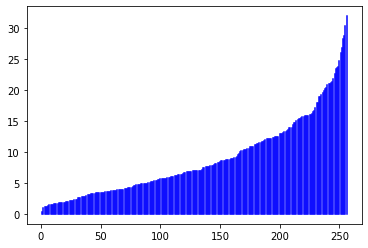

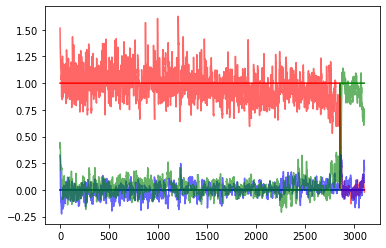

  6%|█████████▎                                                                                                                                                   | 179/3000 [53:39<13:06:23, 16.73s/it]

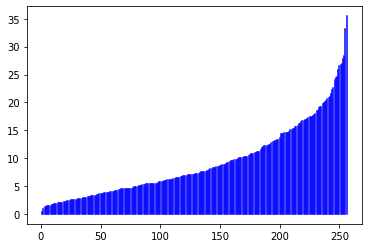

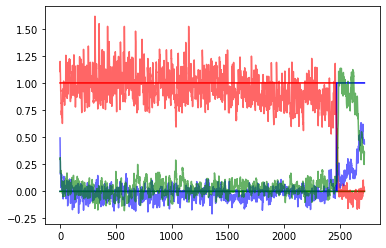

  6%|█████████▋                                                                                                                                                   | 184/3000 [55:08<13:37:42, 17.42s/it]

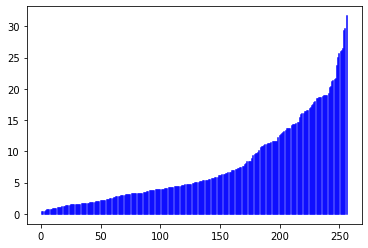

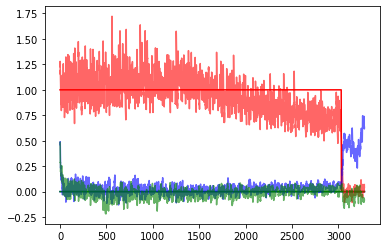

  6%|█████████▉                                                                                                                                                   | 189/3000 [56:38<13:10:00, 16.86s/it]

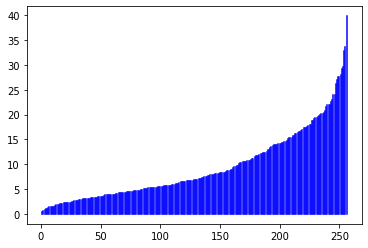

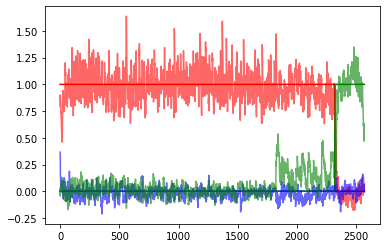

  6%|██████████▏                                                                                                                                                  | 194/3000 [58:13<13:47:10, 17.69s/it]

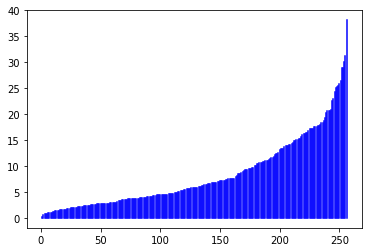

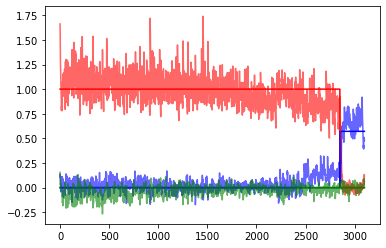

  7%|██████████▍                                                                                                                                                  | 199/3000 [59:36<12:44:46, 16.38s/it]

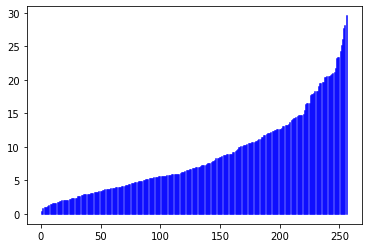

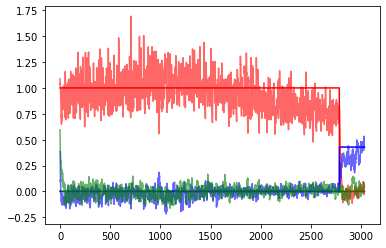

  7%|██████████▌                                                                                                                                                | 204/3000 [1:01:38<14:27:31, 18.62s/it]

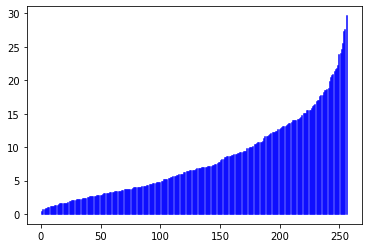

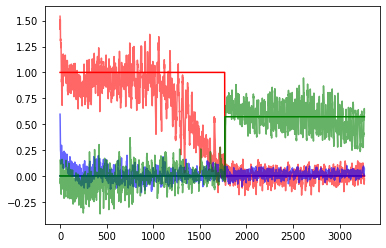

  7%|██████████▊                                                                                                                                                | 209/3000 [1:03:02<12:51:37, 16.59s/it]

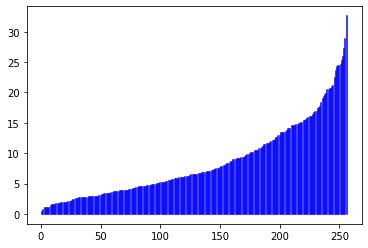

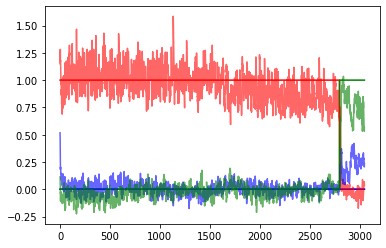

  7%|███████████                                                                                                                                                | 214/3000 [1:04:27<12:36:28, 16.29s/it]

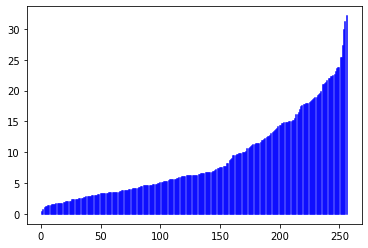

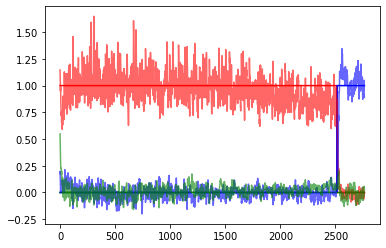

  7%|███████████▎                                                                                                                                               | 219/3000 [1:05:51<12:37:15, 16.34s/it]

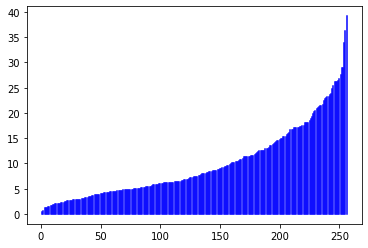

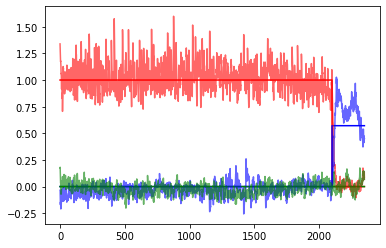

  7%|███████████▌                                                                                                                                               | 224/3000 [1:07:15<12:42:00, 16.47s/it]

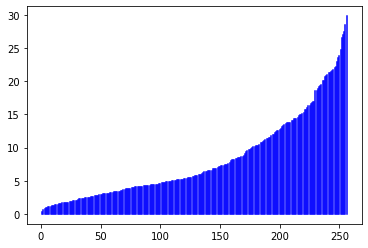

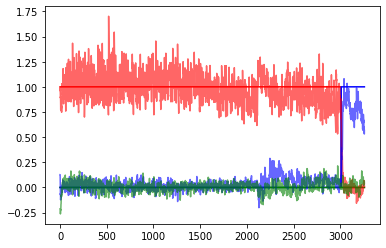

  8%|███████████▊                                                                                                                                               | 229/3000 [1:08:45<12:51:49, 16.71s/it]

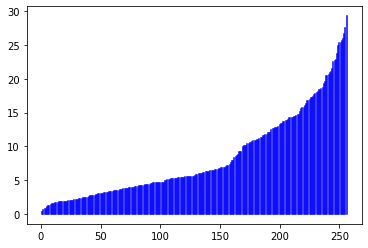

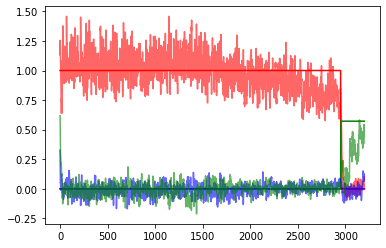

  8%|████████████                                                                                                                                               | 234/3000 [1:10:13<13:13:45, 17.22s/it]

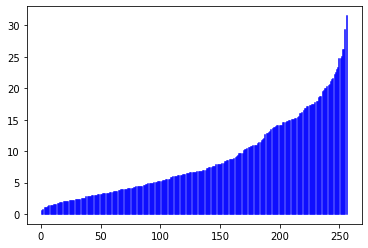

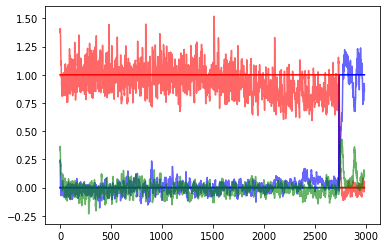

  8%|████████████▎                                                                                                                                              | 239/3000 [1:11:37<12:35:20, 16.41s/it]

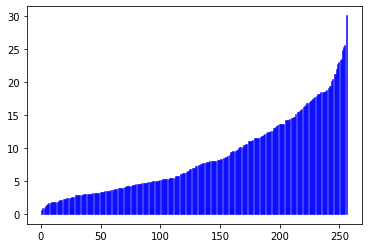

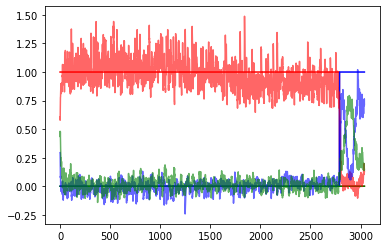

  8%|████████████▌                                                                                                                                              | 244/3000 [1:13:08<13:32:01, 17.68s/it]

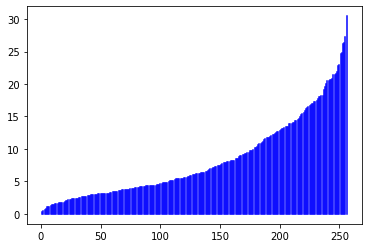

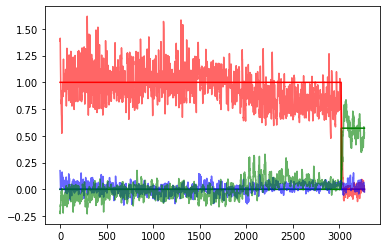

  8%|████████████▊                                                                                                                                              | 249/3000 [1:14:32<12:20:52, 16.16s/it]

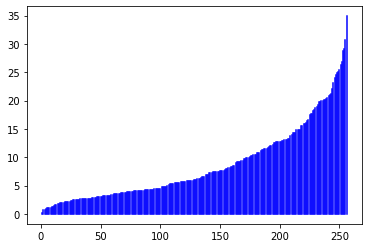

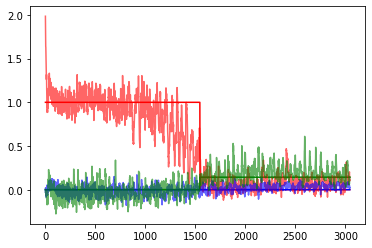

  8%|█████████████                                                                                                                                              | 254/3000 [1:16:34<14:26:21, 18.93s/it]

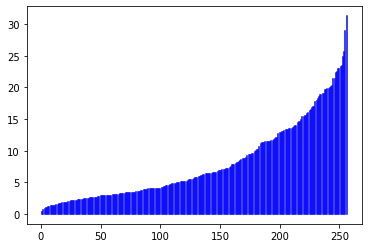

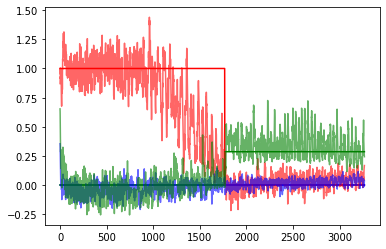

  9%|█████████████▍                                                                                                                                             | 259/3000 [1:17:57<12:31:21, 16.45s/it]

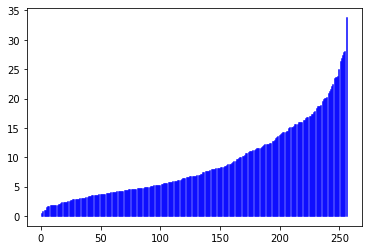

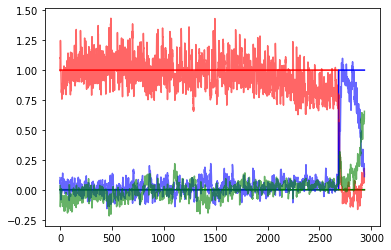

  9%|█████████████▋                                                                                                                                             | 264/3000 [1:19:16<11:42:08, 15.40s/it]

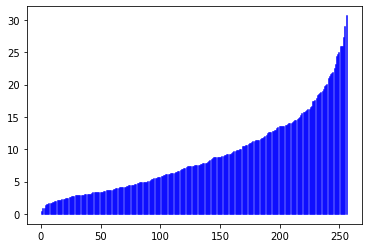

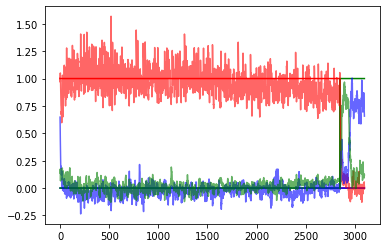

  9%|█████████████▉                                                                                                                                             | 269/3000 [1:20:38<12:02:13, 15.87s/it]

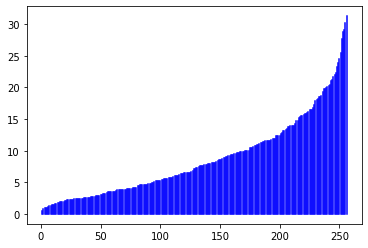

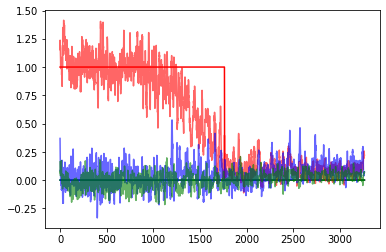

  9%|██████████████▏                                                                                                                                            | 274/3000 [1:22:00<12:10:18, 16.07s/it]

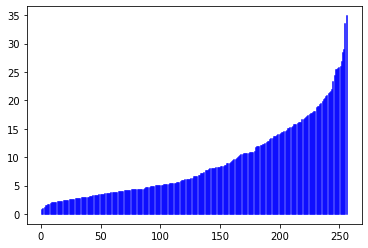

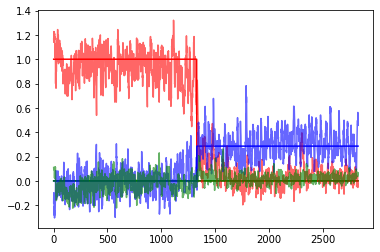

  9%|██████████████▍                                                                                                                                            | 279/3000 [1:23:23<12:15:12, 16.21s/it]

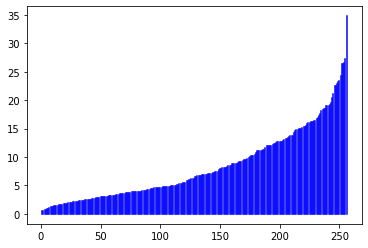

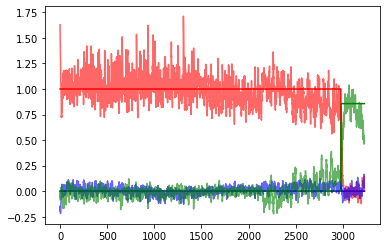

  9%|██████████████▋                                                                                                                                            | 284/3000 [1:24:48<12:12:37, 16.18s/it]

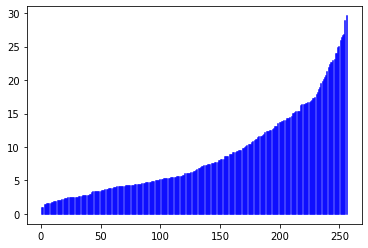

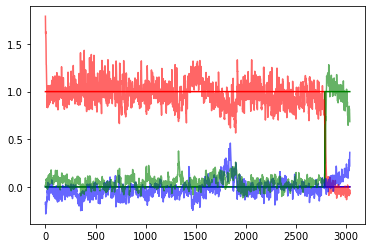

 10%|██████████████▉                                                                                                                                            | 289/3000 [1:26:07<11:41:10, 15.52s/it]

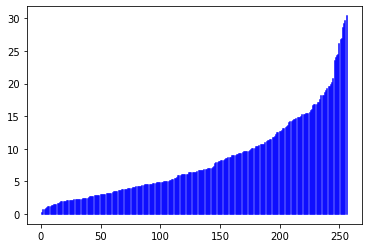

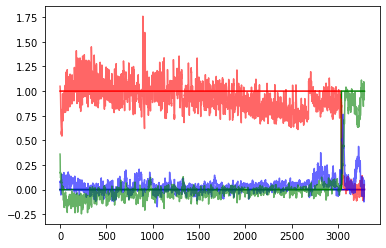

 10%|███████████████▏                                                                                                                                           | 294/3000 [1:27:29<11:47:52, 15.70s/it]

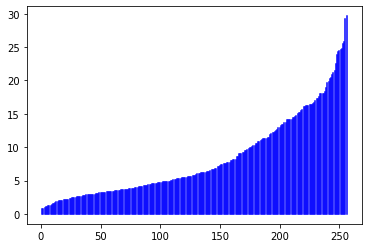

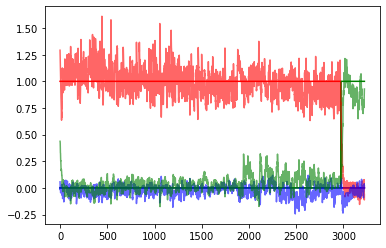

 10%|███████████████▍                                                                                                                                           | 299/3000 [1:28:51<11:56:35, 15.92s/it]

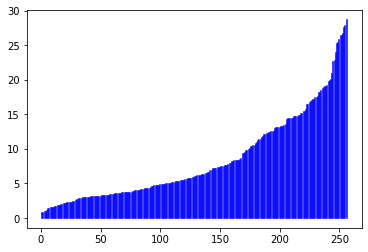

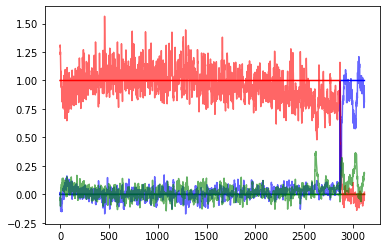

 10%|███████████████▋                                                                                                                                           | 304/3000 [1:30:46<13:19:39, 17.80s/it]

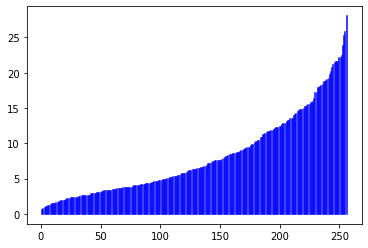

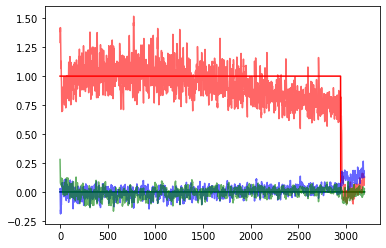

 10%|███████████████▉                                                                                                                                           | 309/3000 [1:32:08<11:56:45, 15.98s/it]

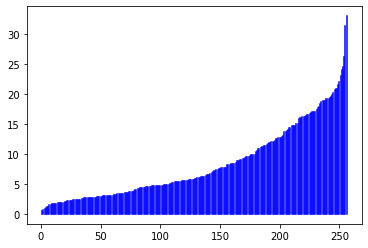

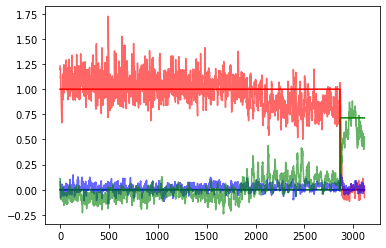

 10%|████████████████▏                                                                                                                                          | 314/3000 [1:33:27<11:39:38, 15.63s/it]

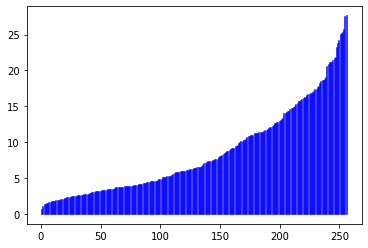

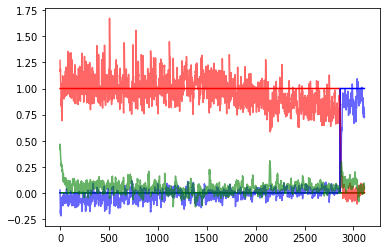

 11%|████████████████▍                                                                                                                                          | 319/3000 [1:35:07<13:51:29, 18.61s/it]

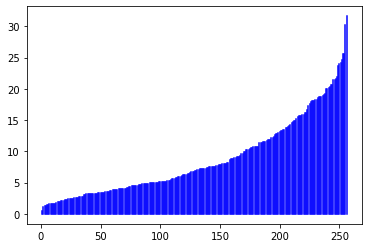

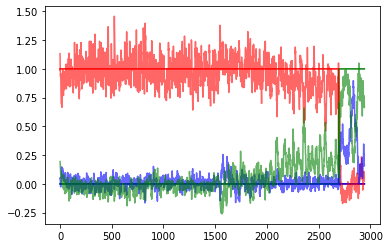

 11%|████████████████▋                                                                                                                                          | 324/3000 [1:36:34<12:34:47, 16.92s/it]

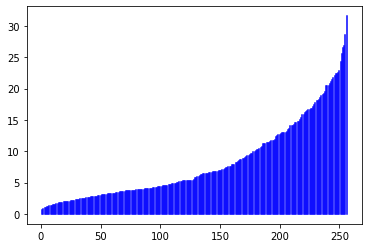

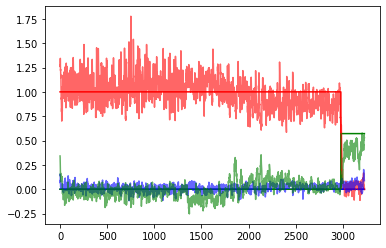

 11%|████████████████▉                                                                                                                                          | 329/3000 [1:37:58<12:20:29, 16.63s/it]

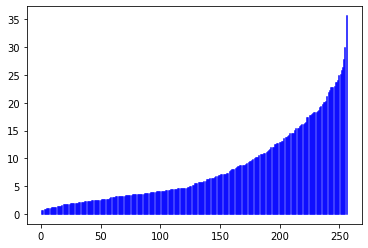

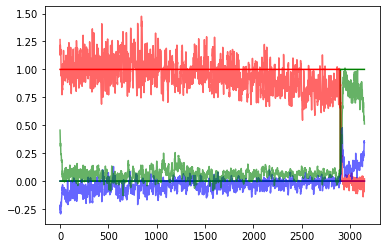

 11%|█████████████████▎                                                                                                                                         | 334/3000 [1:39:29<12:48:09, 17.29s/it]

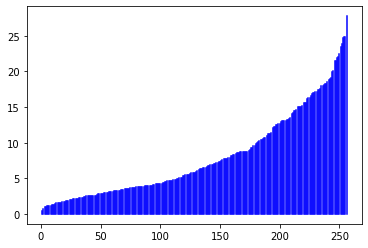

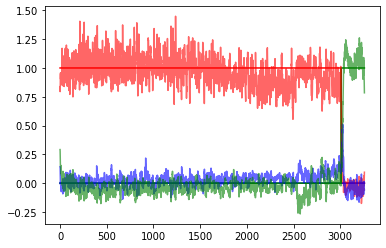

 11%|█████████████████▌                                                                                                                                         | 339/3000 [1:40:55<12:17:34, 16.63s/it]

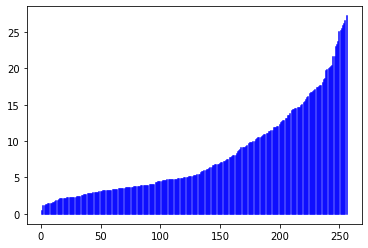

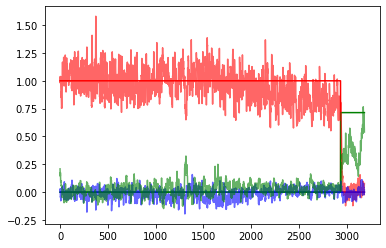

 11%|█████████████████▊                                                                                                                                         | 344/3000 [1:42:29<12:48:36, 17.36s/it]

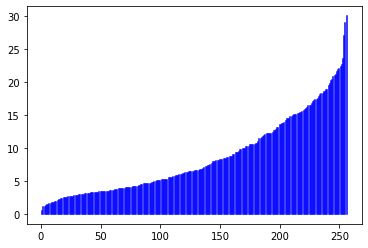

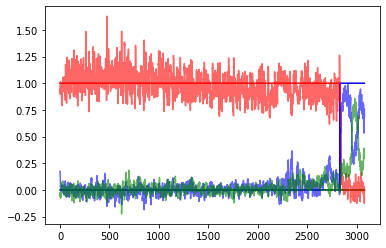

 12%|██████████████████                                                                                                                                         | 349/3000 [1:43:49<11:44:48, 15.95s/it]

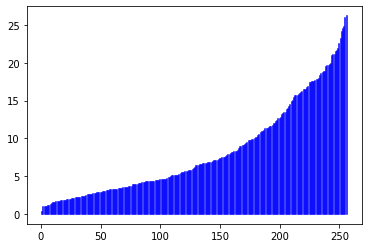

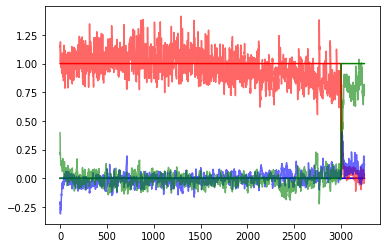

 12%|██████████████████▎                                                                                                                                        | 354/3000 [1:45:48<13:31:18, 18.40s/it]

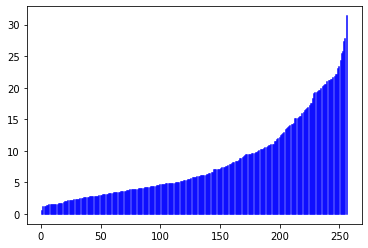

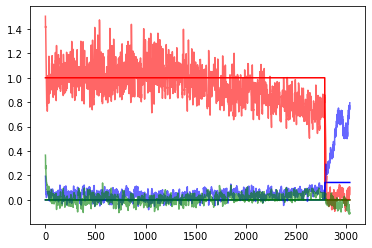

 12%|██████████████████▌                                                                                                                                        | 359/3000 [1:47:10<12:06:22, 16.50s/it]

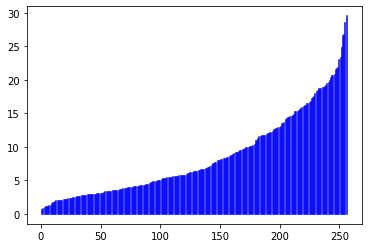

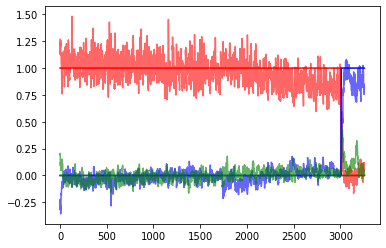

 12%|██████████████████▊                                                                                                                                        | 364/3000 [1:48:34<11:57:57, 16.34s/it]

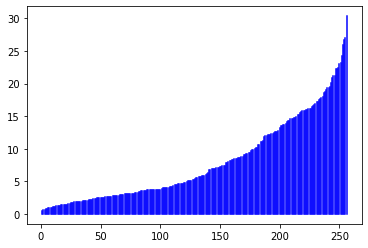

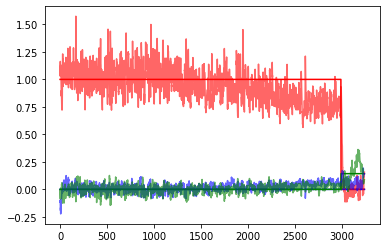

 12%|███████████████████                                                                                                                                        | 369/3000 [1:49:58<11:49:40, 16.18s/it]

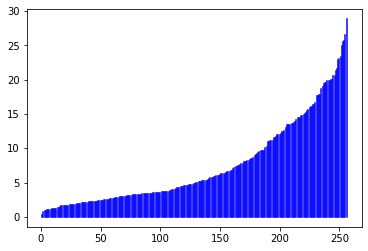

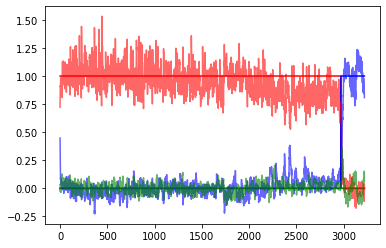

 12%|███████████████████▎                                                                                                                                       | 374/3000 [1:51:19<11:16:28, 15.46s/it]

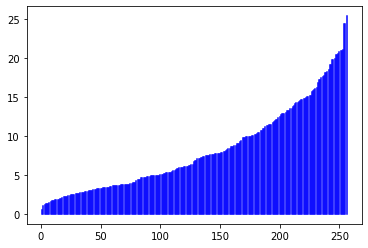

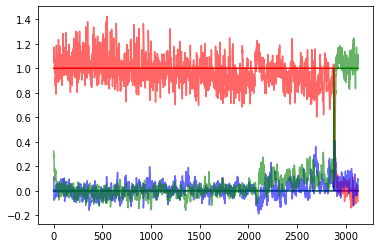

 13%|███████████████████▌                                                                                                                                       | 379/3000 [1:52:38<11:01:54, 15.15s/it]

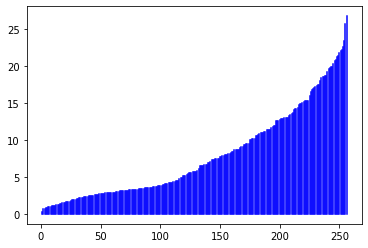

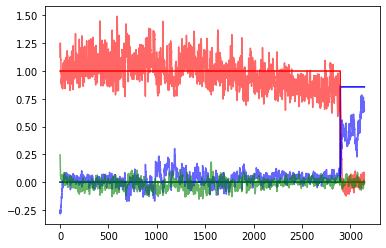

 13%|███████████████████▊                                                                                                                                       | 384/3000 [1:53:59<11:28:01, 15.78s/it]

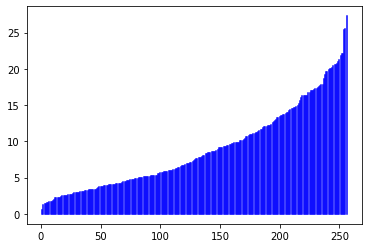

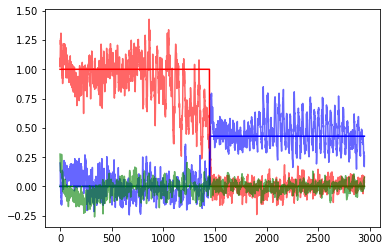

 13%|████████████████████                                                                                                                                       | 389/3000 [1:55:17<10:55:31, 15.06s/it]

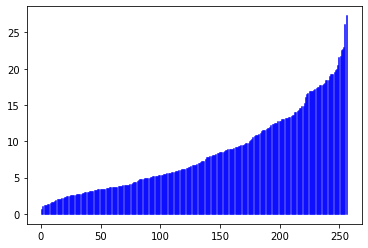

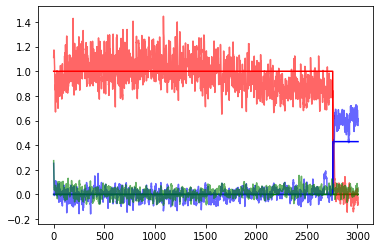

 13%|████████████████████▎                                                                                                                                      | 394/3000 [1:56:35<10:47:26, 14.91s/it]

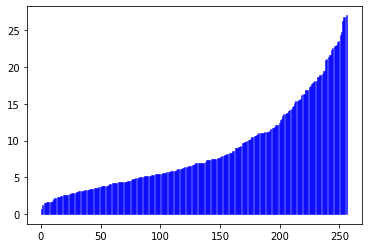

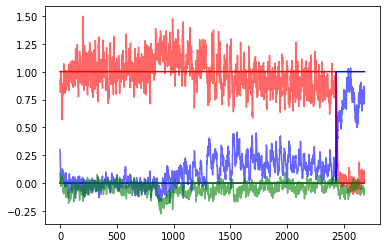

 13%|████████████████████▌                                                                                                                                      | 399/3000 [1:57:56<11:09:07, 15.44s/it]

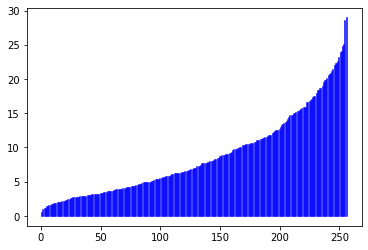

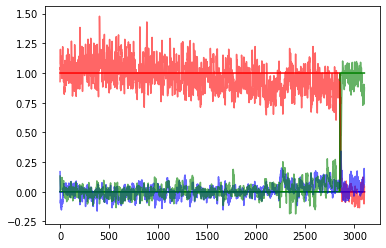

 13%|████████████████████▊                                                                                                                                      | 404/3000 [1:59:50<12:41:54, 17.61s/it]

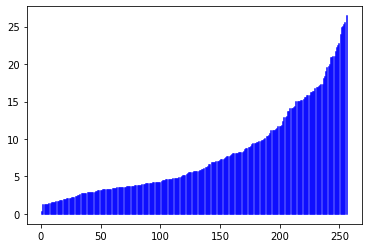

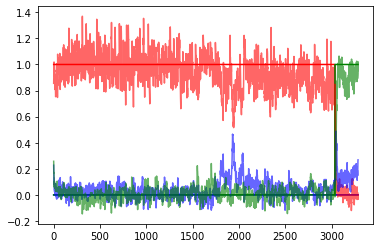

 14%|█████████████████████▏                                                                                                                                     | 409/3000 [2:01:10<11:23:20, 15.82s/it]

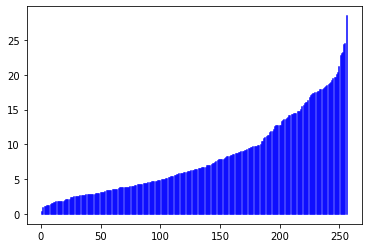

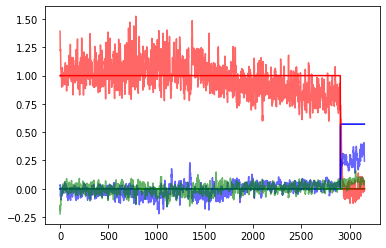

 14%|█████████████████████▍                                                                                                                                     | 414/3000 [2:02:27<10:49:41, 15.07s/it]

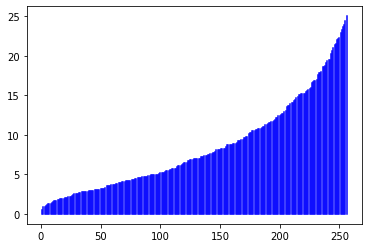

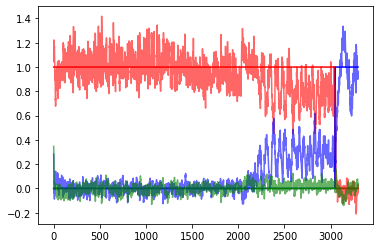

 14%|█████████████████████▋                                                                                                                                     | 419/3000 [2:03:47<11:04:01, 15.44s/it]

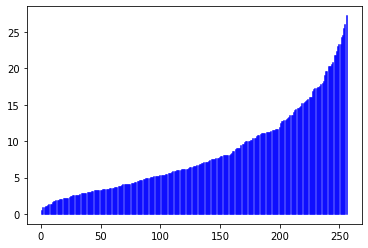

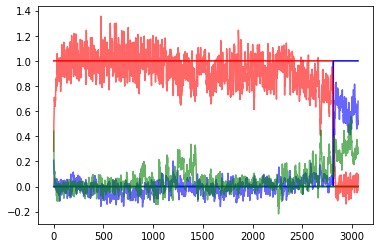

 14%|█████████████████████▉                                                                                                                                     | 424/3000 [2:05:03<10:33:19, 14.75s/it]

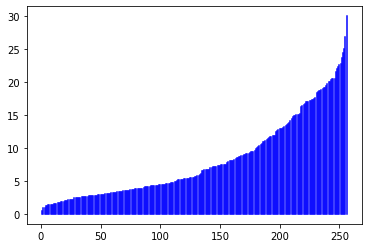

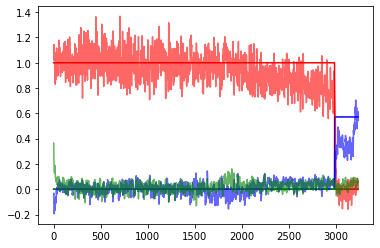

 14%|██████████████████████▏                                                                                                                                    | 429/3000 [2:06:20<10:37:12, 14.87s/it]

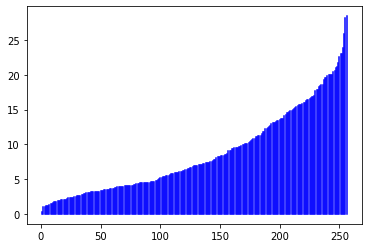

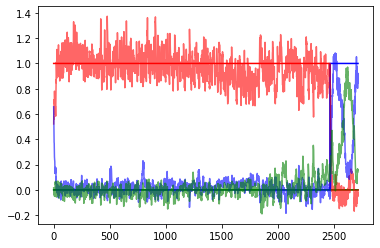

 14%|██████████████████████▍                                                                                                                                    | 434/3000 [2:07:38<10:40:00, 14.97s/it]

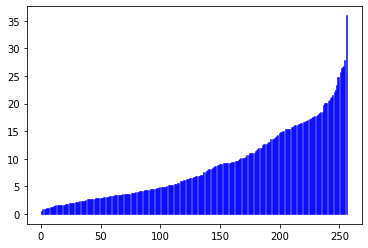

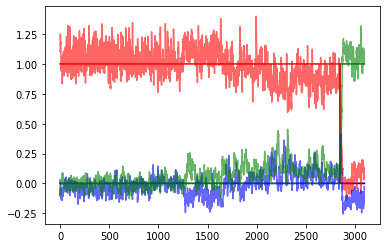

 15%|██████████████████████▋                                                                                                                                    | 439/3000 [2:08:56<10:42:22, 15.05s/it]

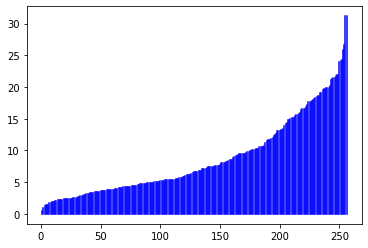

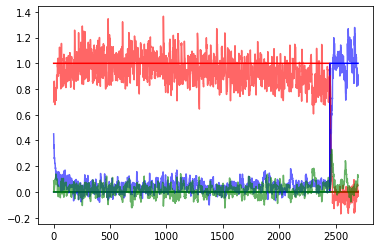

 15%|██████████████████████▉                                                                                                                                    | 444/3000 [2:10:14<10:47:22, 15.20s/it]

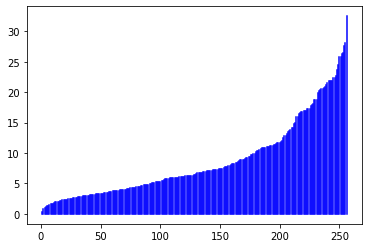

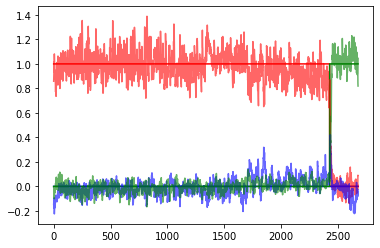

 15%|███████████████████████▏                                                                                                                                   | 449/3000 [2:11:34<11:02:21, 15.58s/it]

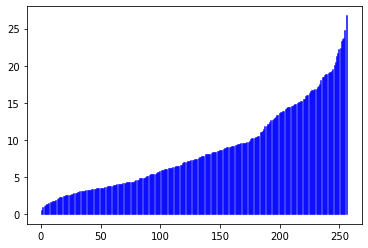

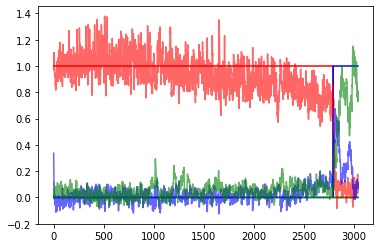

 15%|███████████████████████▍                                                                                                                                   | 454/3000 [2:13:34<13:09:19, 18.60s/it]

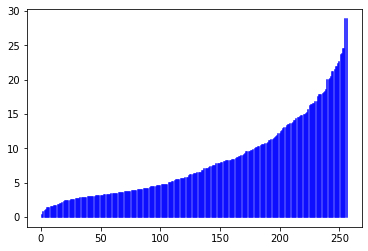

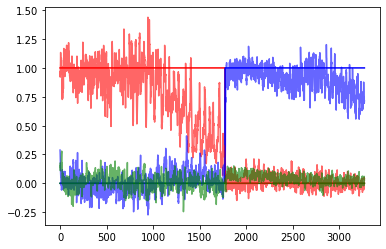

 15%|███████████████████████▋                                                                                                                                   | 459/3000 [2:14:57<11:32:17, 16.35s/it]

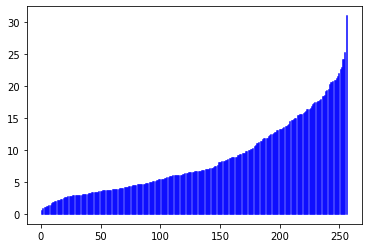

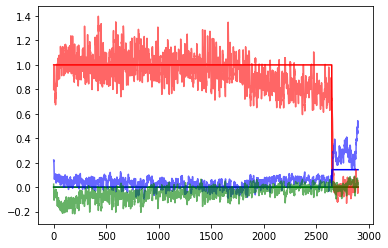

 15%|███████████████████████▉                                                                                                                                   | 464/3000 [2:16:16<10:55:24, 15.51s/it]

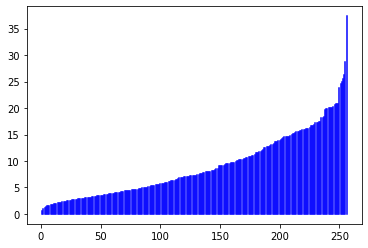

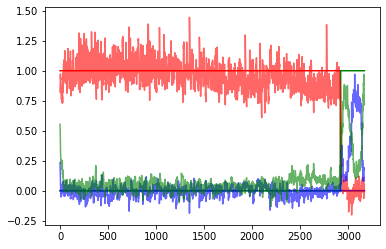

 16%|████████████████████████▏                                                                                                                                  | 469/3000 [2:17:38<11:13:35, 15.97s/it]

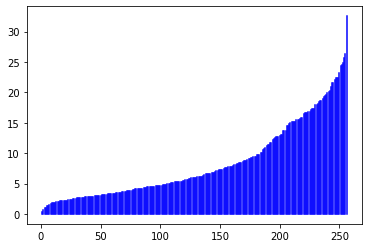

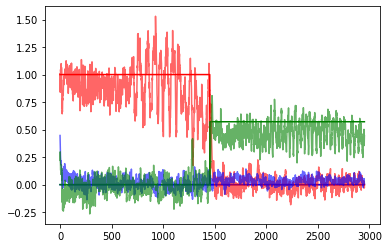

 16%|████████████████████████▍                                                                                                                                  | 474/3000 [2:18:59<10:54:20, 15.54s/it]

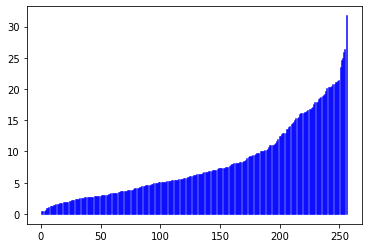

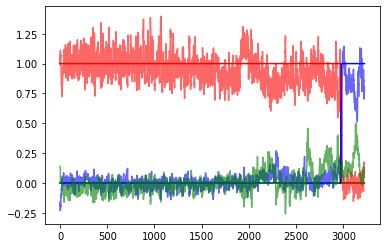

 16%|████████████████████████▋                                                                                                                                  | 479/3000 [2:20:22<11:14:27, 16.05s/it]

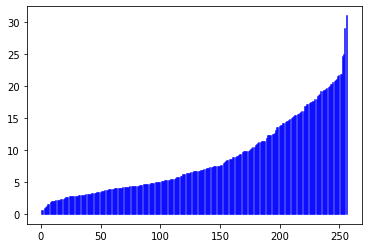

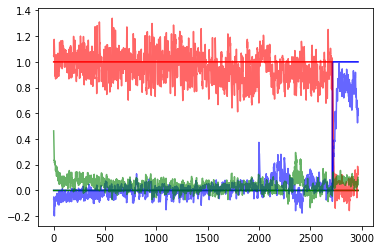

 16%|█████████████████████████                                                                                                                                  | 484/3000 [2:21:44<11:00:08, 15.74s/it]

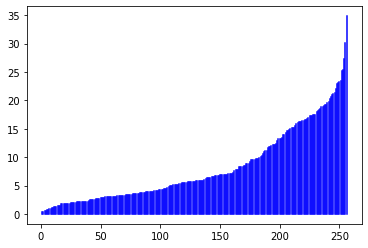

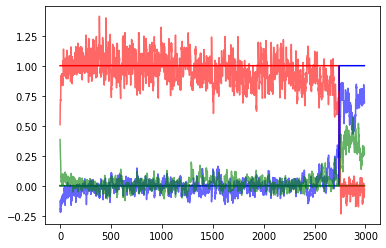

 16%|█████████████████████████▎                                                                                                                                 | 489/3000 [2:23:03<10:44:59, 15.41s/it]

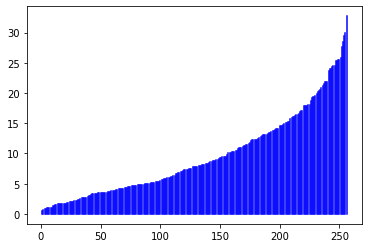

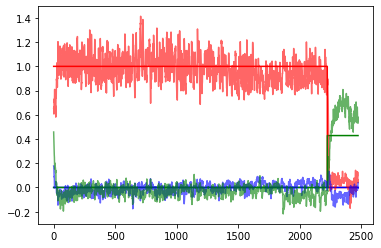

 16%|█████████████████████████▌                                                                                                                                 | 494/3000 [2:24:26<11:13:02, 16.11s/it]

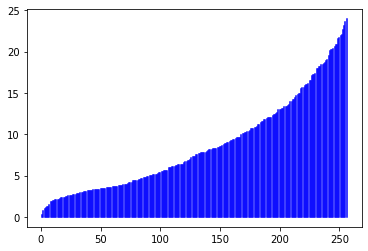

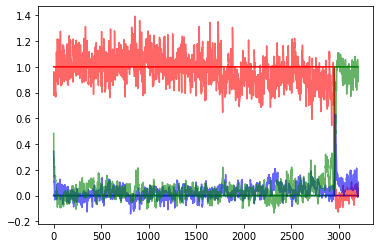

 17%|█████████████████████████▊                                                                                                                                 | 499/3000 [2:25:48<11:00:59, 15.86s/it]

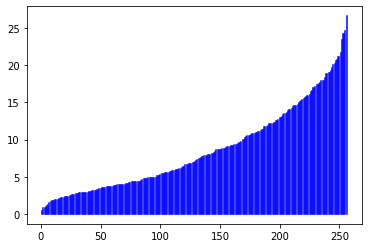

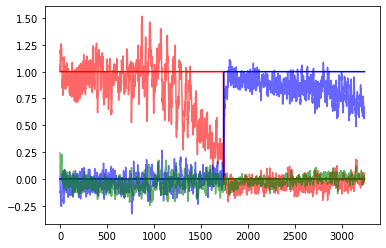

 17%|██████████████████████████                                                                                                                                 | 504/3000 [2:27:45<12:31:08, 18.06s/it]

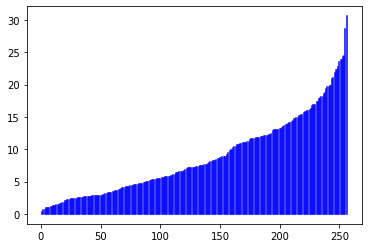

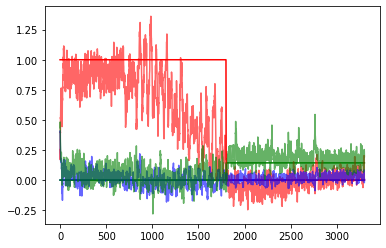

 17%|██████████████████████████▎                                                                                                                                | 509/3000 [2:29:05<11:06:41, 16.06s/it]

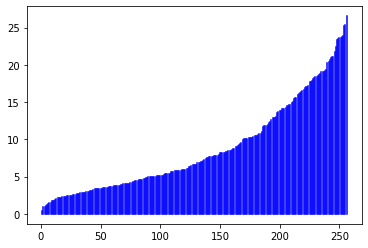

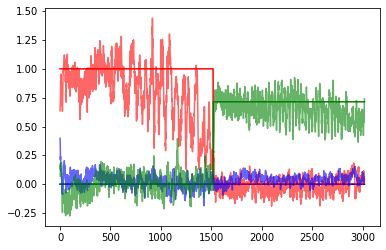

 17%|██████████████████████████▌                                                                                                                                | 514/3000 [2:30:23<10:33:24, 15.29s/it]

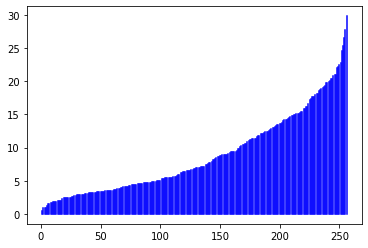

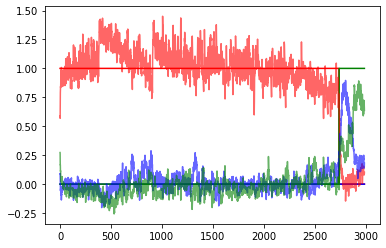

 17%|██████████████████████████▊                                                                                                                                | 519/3000 [2:31:44<10:40:29, 15.49s/it]

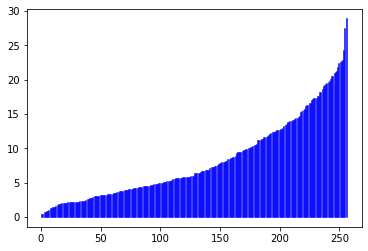

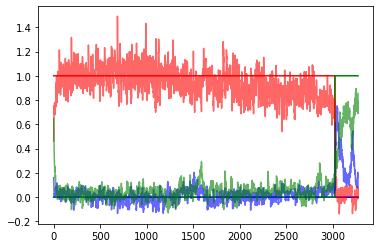

 17%|███████████████████████████                                                                                                                                | 524/3000 [2:33:07<10:55:57, 15.90s/it]

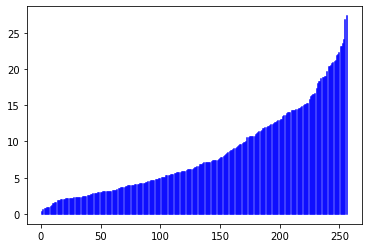

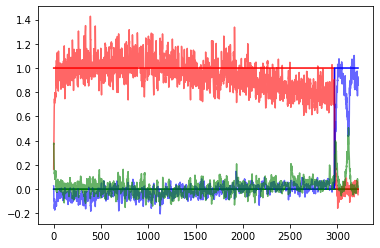

 18%|███████████████████████████▎                                                                                                                               | 529/3000 [2:34:25<10:23:49, 15.15s/it]

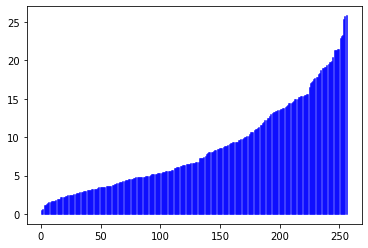

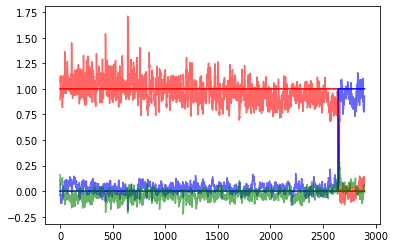

 18%|███████████████████████████▌                                                                                                                               | 534/3000 [2:35:48<10:46:12, 15.72s/it]

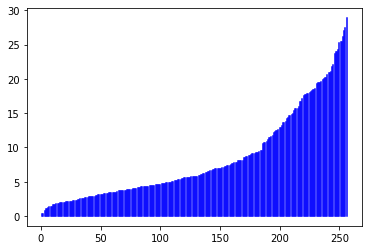

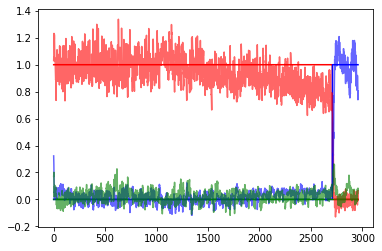

 18%|███████████████████████████▊                                                                                                                               | 539/3000 [2:37:08<10:40:12, 15.61s/it]

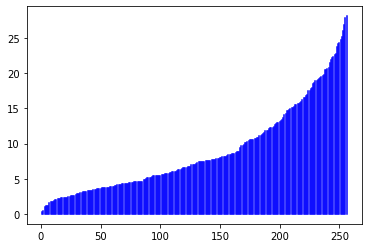

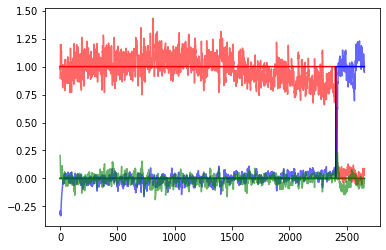

 18%|████████████████████████████                                                                                                                               | 544/3000 [2:38:27<10:41:26, 15.67s/it]

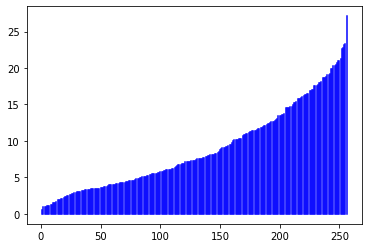

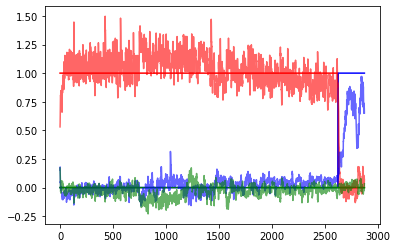

 18%|████████████████████████████▎                                                                                                                              | 549/3000 [2:39:48<10:45:53, 15.81s/it]

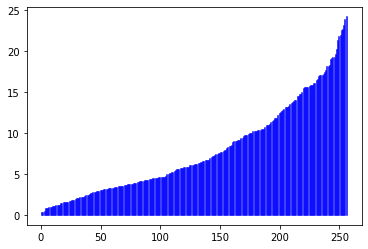

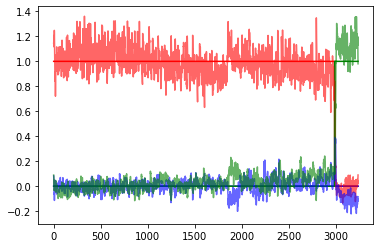

 18%|████████████████████████████▌                                                                                                                              | 554/3000 [2:41:46<12:27:14, 18.33s/it]

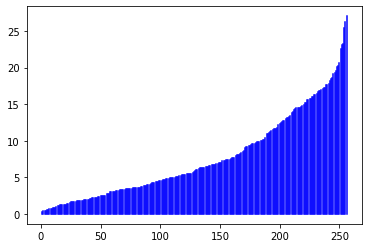

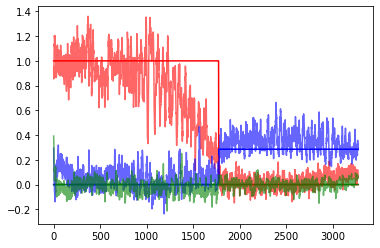

 19%|████████████████████████████▉                                                                                                                              | 559/3000 [2:43:07<10:56:00, 16.12s/it]

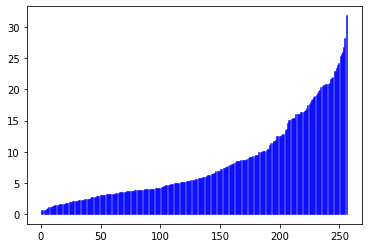

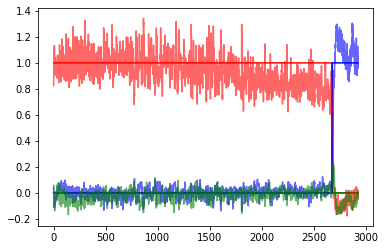

 19%|█████████████████████████████▏                                                                                                                             | 564/3000 [2:44:27<10:31:34, 15.56s/it]

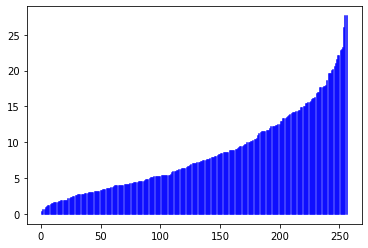

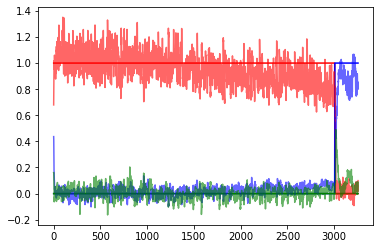

 19%|█████████████████████████████▍                                                                                                                             | 569/3000 [2:45:48<10:38:06, 15.75s/it]

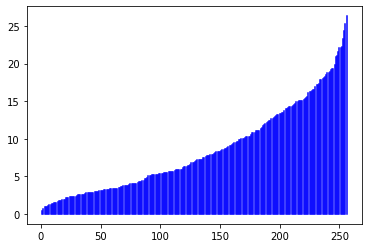

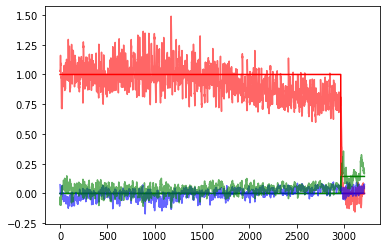

 19%|█████████████████████████████▋                                                                                                                             | 574/3000 [2:47:06<10:13:35, 15.18s/it]

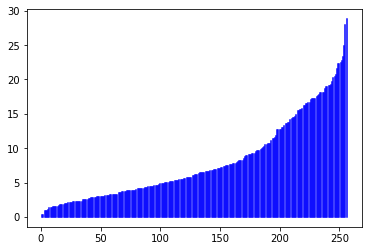

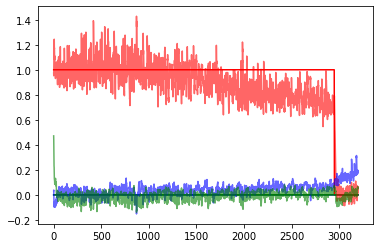

 19%|█████████████████████████████▉                                                                                                                             | 579/3000 [2:48:25<10:09:26, 15.10s/it]

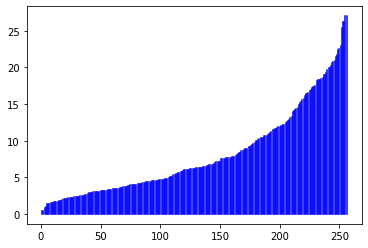

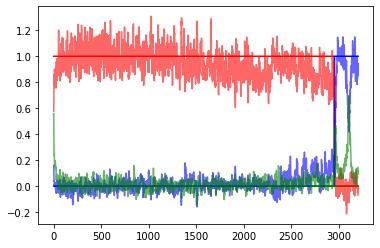

 19%|██████████████████████████████▏                                                                                                                            | 584/3000 [2:49:48<10:37:28, 15.83s/it]

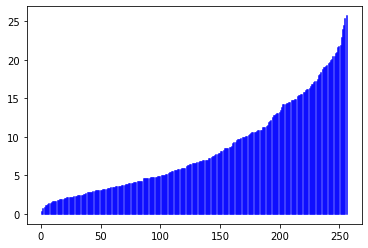

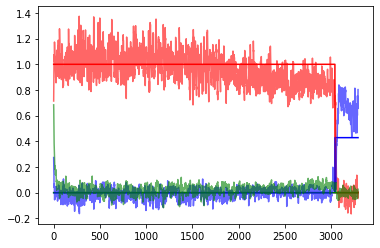

 20%|██████████████████████████████▍                                                                                                                            | 589/3000 [2:51:10<10:37:14, 15.86s/it]

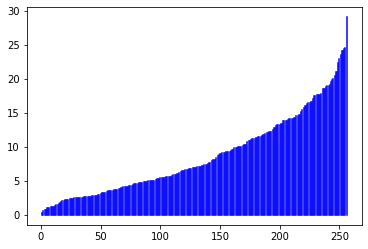

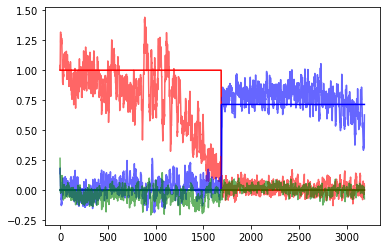

 20%|██████████████████████████████▋                                                                                                                            | 594/3000 [2:52:30<10:20:10, 15.47s/it]

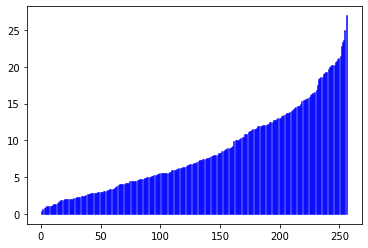

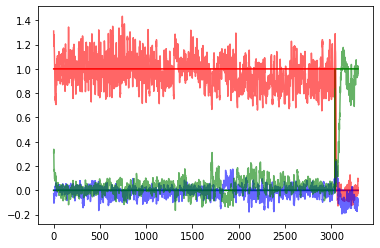

 20%|██████████████████████████████▉                                                                                                                            | 599/3000 [2:53:47<10:03:42, 15.09s/it]

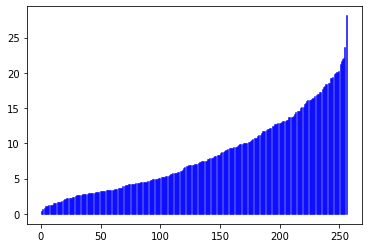

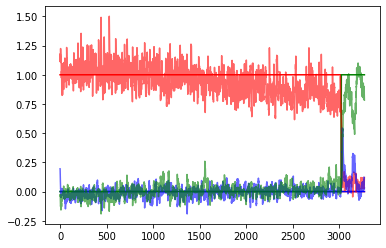

 20%|███████████████████████████████▏                                                                                                                           | 604/3000 [2:55:49<12:32:56, 18.85s/it]

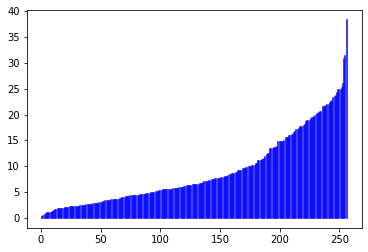

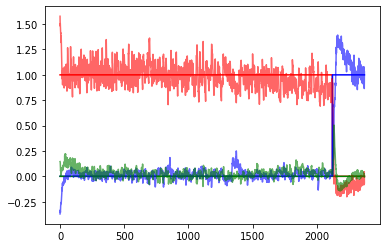

 20%|███████████████████████████████▍                                                                                                                           | 609/3000 [2:57:12<10:43:13, 16.14s/it]

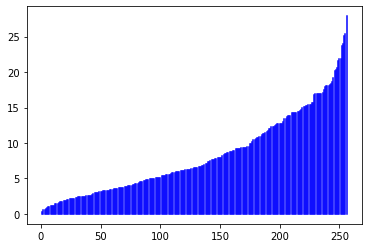

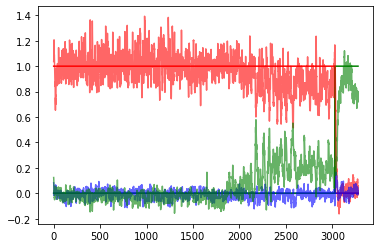

 20%|███████████████████████████████▋                                                                                                                           | 614/3000 [2:58:34<10:32:39, 15.91s/it]

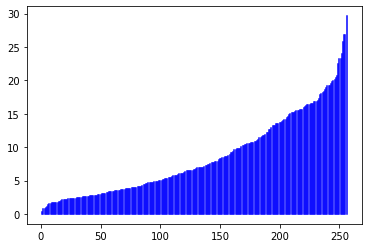

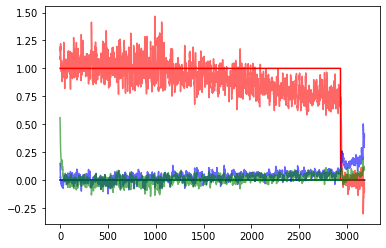

 21%|███████████████████████████████▉                                                                                                                           | 619/3000 [2:59:54<10:15:11, 15.50s/it]

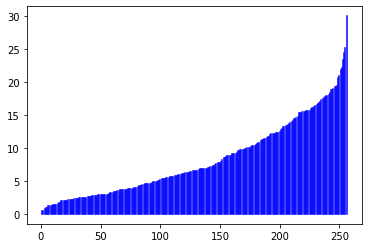

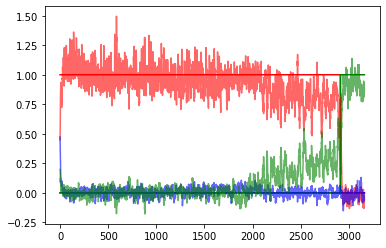

 21%|████████████████████████████████▏                                                                                                                          | 624/3000 [3:01:16<10:24:44, 15.78s/it]

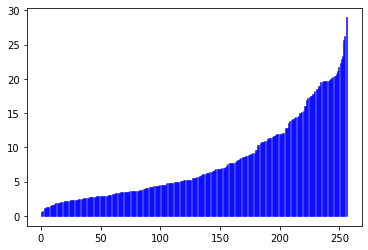

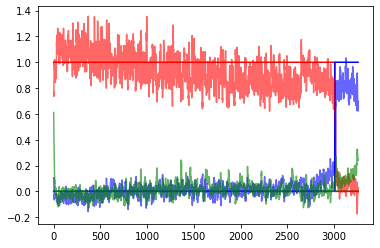

 21%|████████████████████████████████▍                                                                                                                          | 629/3000 [3:02:34<10:11:08, 15.47s/it]

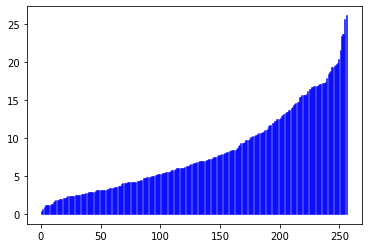

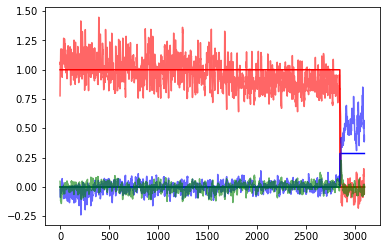

 21%|████████████████████████████████▊                                                                                                                          | 634/3000 [3:03:55<10:14:42, 15.59s/it]

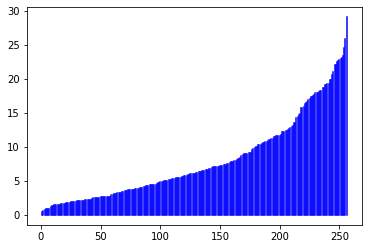

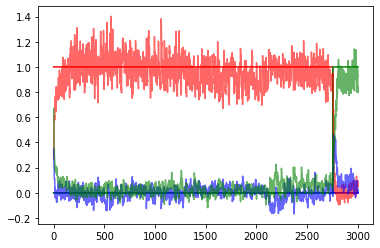

 21%|█████████████████████████████████                                                                                                                          | 639/3000 [3:05:14<10:05:15, 15.38s/it]

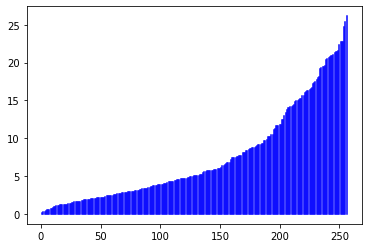

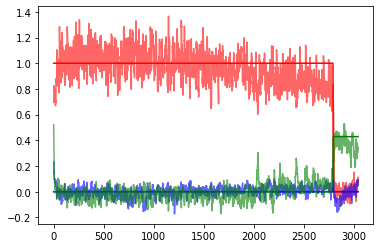

 21%|█████████████████████████████████▎                                                                                                                         | 644/3000 [3:06:32<10:01:16, 15.31s/it]

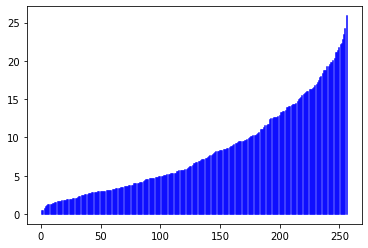

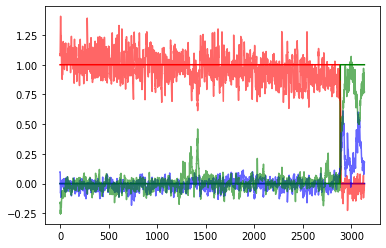

 22%|█████████████████████████████████▌                                                                                                                         | 649/3000 [3:07:52<10:06:33, 15.48s/it]

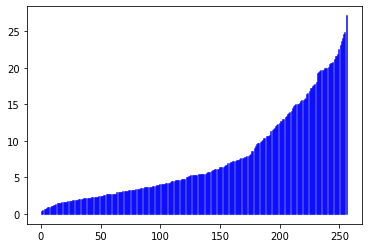

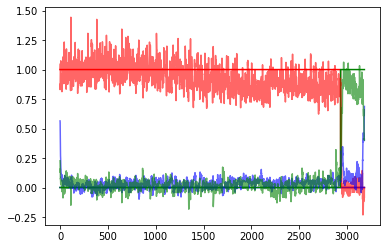

 22%|█████████████████████████████████▊                                                                                                                         | 654/3000 [3:09:49<11:53:18, 18.24s/it]

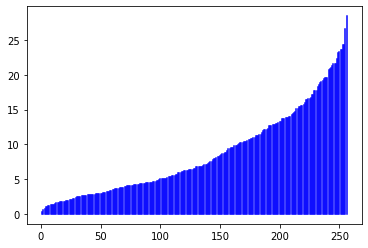

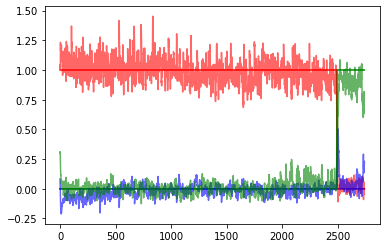

 22%|██████████████████████████████████▎                                                                                                                         | 659/3000 [3:11:07<9:59:59, 15.38s/it]

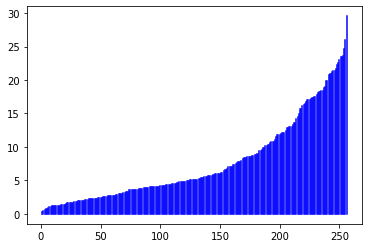

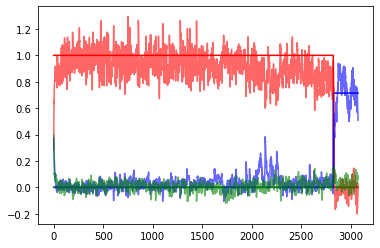

 22%|██████████████████████████████████▎                                                                                                                        | 664/3000 [3:12:27<10:07:18, 15.60s/it]

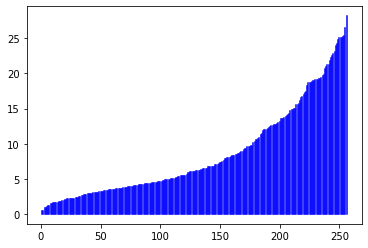

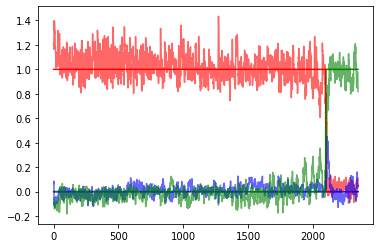

 22%|██████████████████████████████████▌                                                                                                                        | 669/3000 [3:13:47<10:01:12, 15.48s/it]

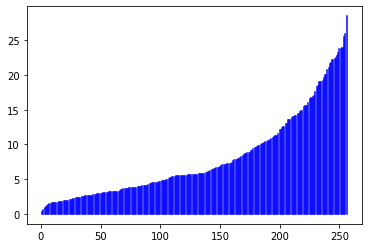

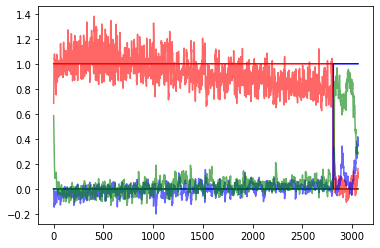

 22%|███████████████████████████████████                                                                                                                         | 674/3000 [3:15:07<9:57:34, 15.41s/it]

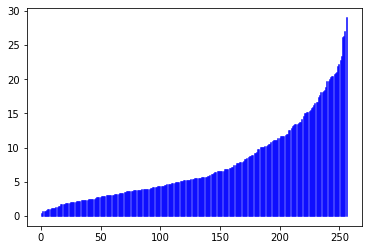

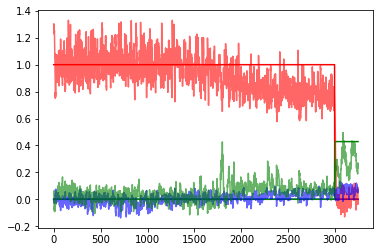

 23%|███████████████████████████████████▎                                                                                                                        | 679/3000 [3:16:27<9:52:51, 15.33s/it]

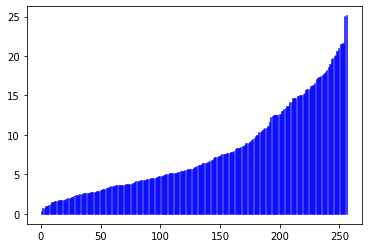

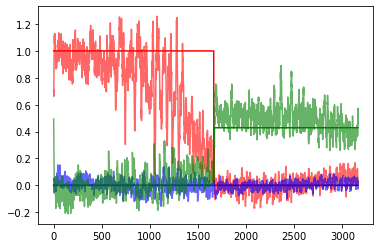

 23%|███████████████████████████████████▌                                                                                                                        | 684/3000 [3:17:47<9:58:26, 15.50s/it]

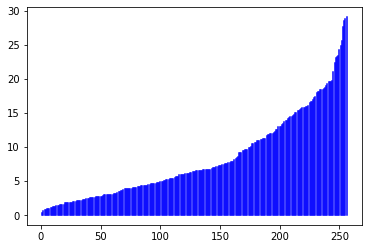

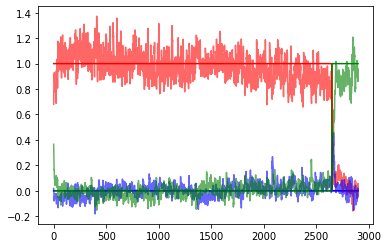

 23%|███████████████████████████████████▊                                                                                                                        | 689/3000 [3:19:07<9:55:12, 15.45s/it]

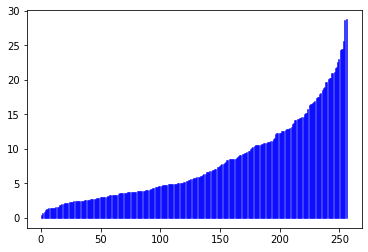

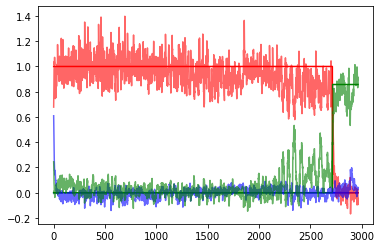

 23%|████████████████████████████████████                                                                                                                        | 694/3000 [3:20:26<9:52:56, 15.43s/it]

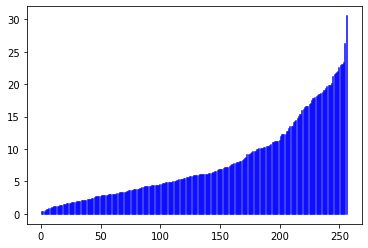

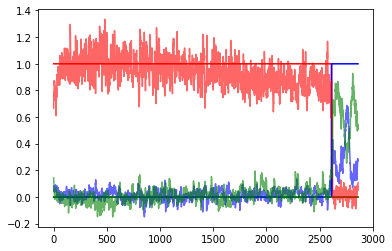

 23%|████████████████████████████████████                                                                                                                       | 699/3000 [3:21:47<10:02:56, 15.72s/it]

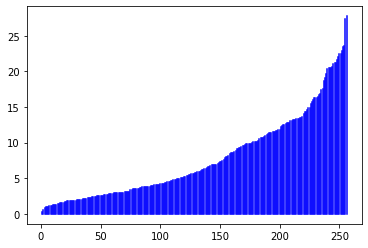

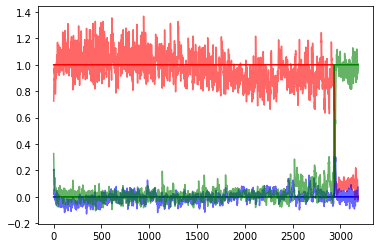

 23%|████████████████████████████████████▎                                                                                                                      | 704/3000 [3:23:47<11:55:52, 18.71s/it]

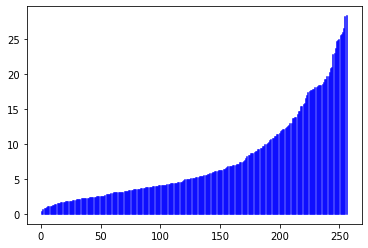

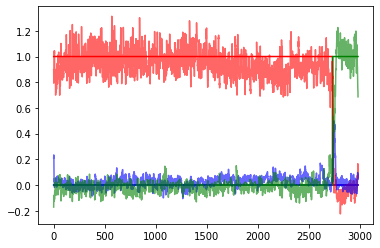

 24%|████████████████████████████████████▋                                                                                                                      | 709/3000 [3:25:05<10:05:36, 15.86s/it]

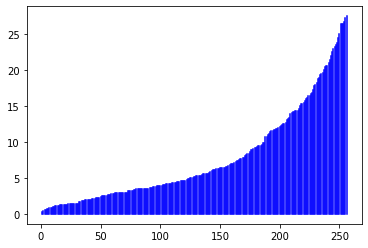

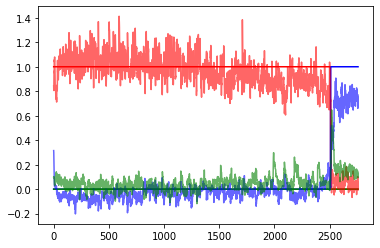

 24%|█████████████████████████████████████▏                                                                                                                      | 714/3000 [3:26:24<9:49:52, 15.48s/it]

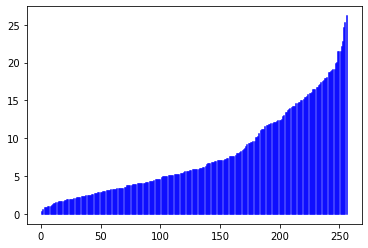

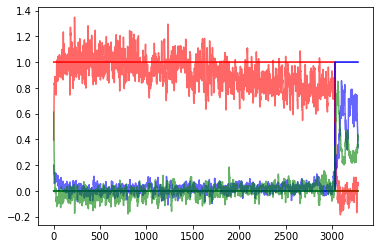

 24%|█████████████████████████████████████▍                                                                                                                      | 719/3000 [3:27:42<9:31:33, 15.03s/it]

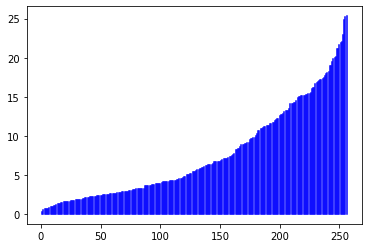

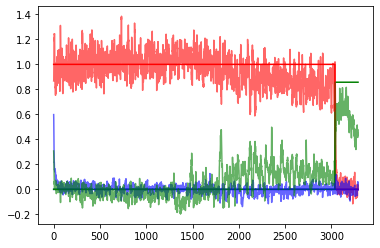

 24%|█████████████████████████████████████▋                                                                                                                      | 724/3000 [3:28:59<9:30:35, 15.04s/it]

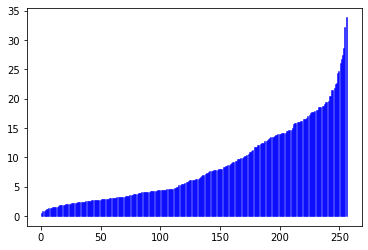

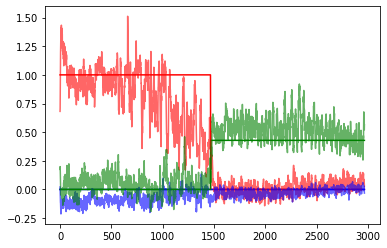

 24%|█████████████████████████████████████▉                                                                                                                      | 729/3000 [3:30:18<9:42:47, 15.40s/it]

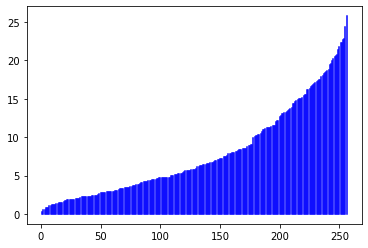

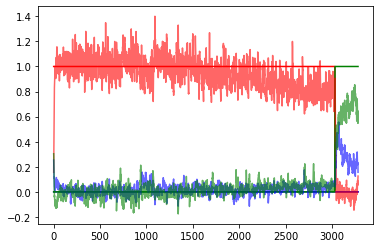

 24%|██████████████████████████████████████▏                                                                                                                     | 734/3000 [3:31:37<9:39:25, 15.34s/it]

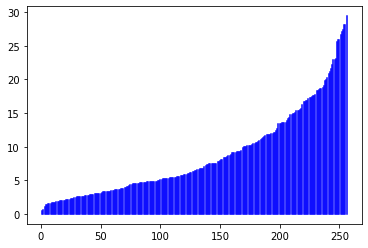

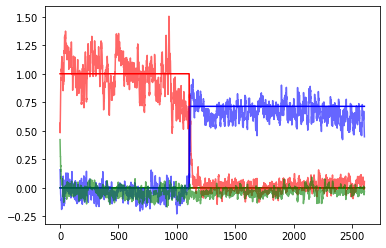

 25%|██████████████████████████████████████▍                                                                                                                     | 739/3000 [3:32:53<9:20:25, 14.87s/it]

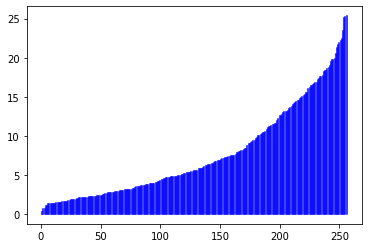

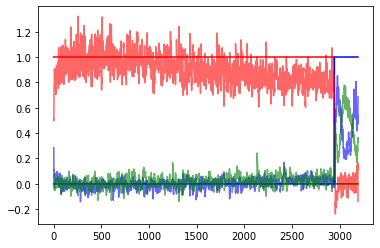

 25%|██████████████████████████████████████▋                                                                                                                     | 744/3000 [3:34:14<9:50:16, 15.70s/it]

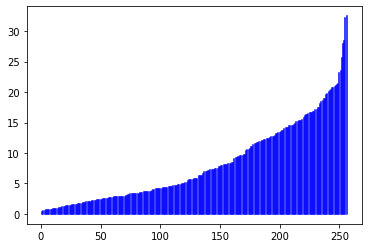

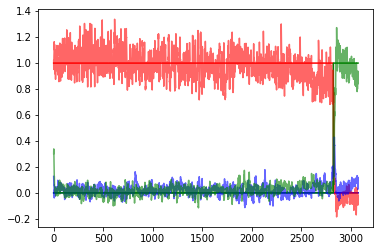

 25%|██████████████████████████████████████▋                                                                                                                    | 749/3000 [3:35:55<11:36:09, 18.56s/it]

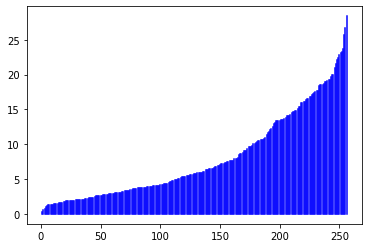

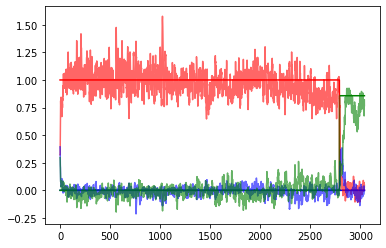

 25%|██████████████████████████████████████▉                                                                                                                    | 754/3000 [3:37:51<11:39:51, 18.70s/it]

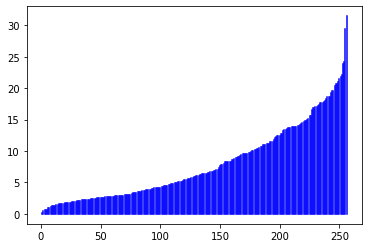

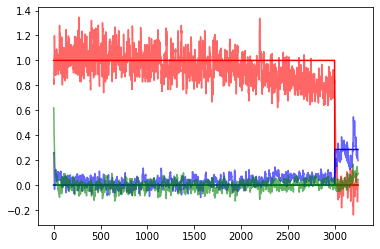

 25%|███████████████████████████████████████▍                                                                                                                    | 759/3000 [3:39:07<9:36:15, 15.43s/it]

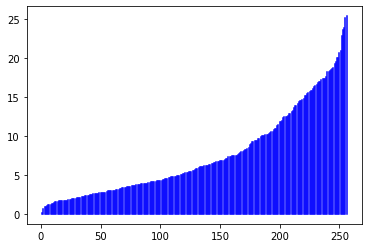

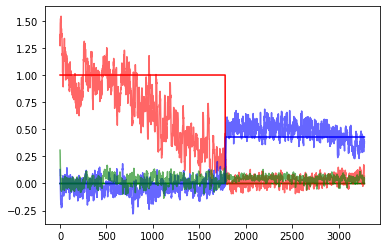

 25%|███████████████████████████████████████▋                                                                                                                    | 764/3000 [3:40:26<9:32:14, 15.36s/it]

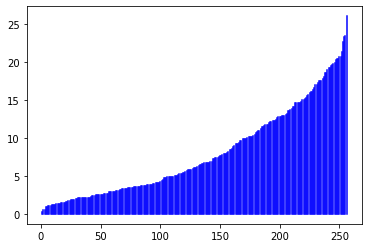

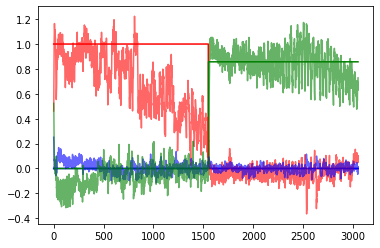

 26%|███████████████████████████████████████▉                                                                                                                    | 769/3000 [3:41:44<9:19:35, 15.05s/it]

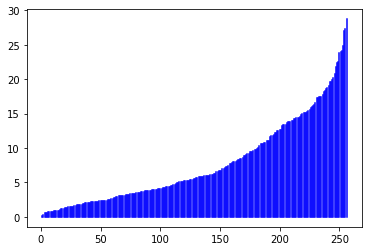

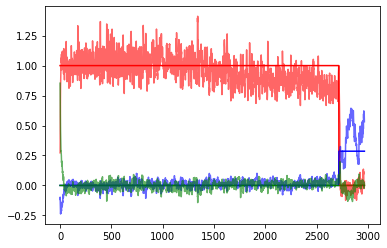

 26%|████████████████████████████████████████▏                                                                                                                   | 774/3000 [3:43:04<9:34:19, 15.48s/it]

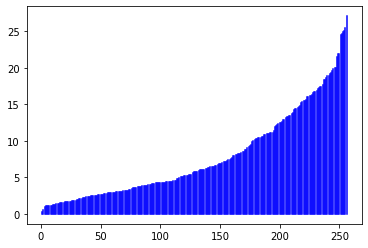

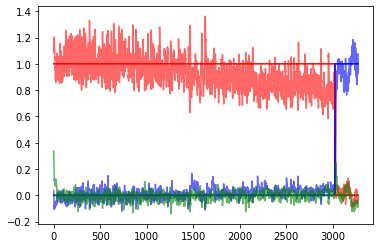

 26%|████████████████████████████████████████▌                                                                                                                   | 779/3000 [3:44:23<9:33:04, 15.48s/it]

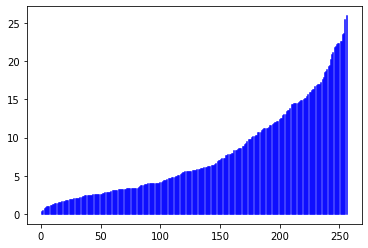

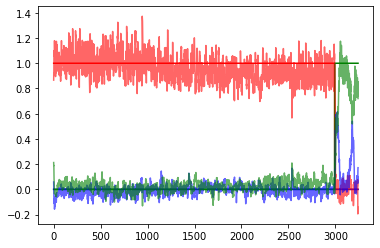

 26%|████████████████████████████████████████▊                                                                                                                   | 784/3000 [3:45:41<9:23:21, 15.25s/it]

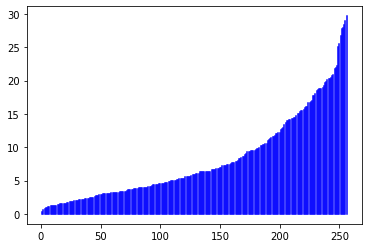

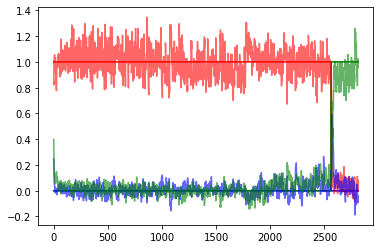

 26%|█████████████████████████████████████████                                                                                                                   | 789/3000 [3:47:01<9:31:07, 15.50s/it]

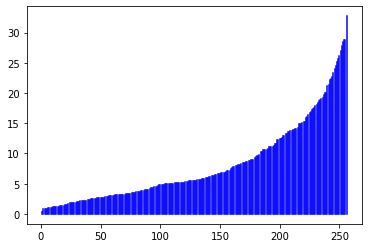

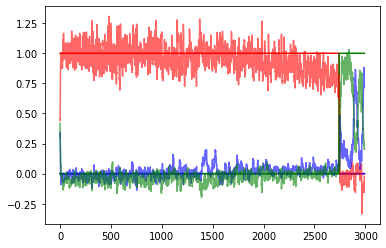

 26%|█████████████████████████████████████████▎                                                                                                                  | 794/3000 [3:48:19<9:12:12, 15.02s/it]

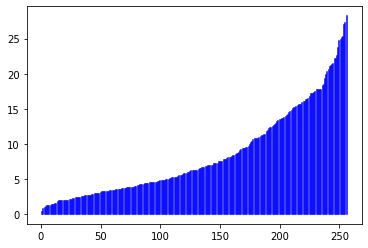

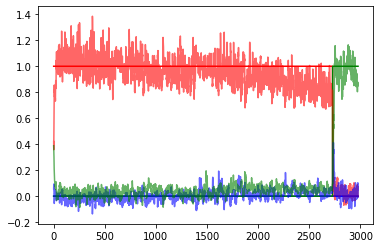

 27%|█████████████████████████████████████████▌                                                                                                                  | 799/3000 [3:49:37<9:14:27, 15.11s/it]

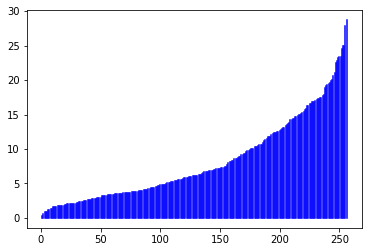

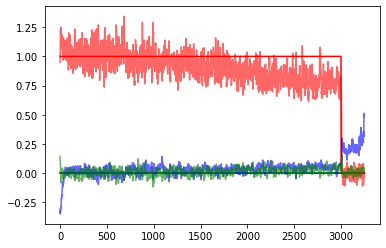

 27%|█████████████████████████████████████████▌                                                                                                                 | 804/3000 [3:51:29<10:40:20, 17.50s/it]

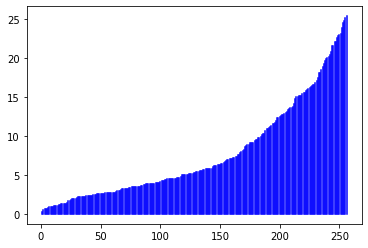

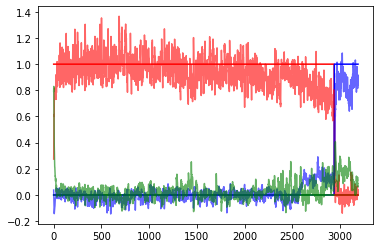

 27%|██████████████████████████████████████████                                                                                                                  | 809/3000 [3:52:51<9:38:55, 15.85s/it]

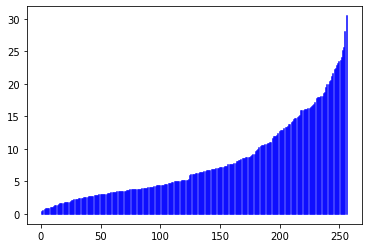

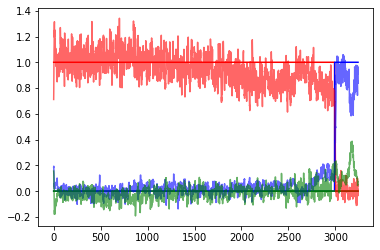

 27%|██████████████████████████████████████████▎                                                                                                                 | 814/3000 [3:54:11<9:13:10, 15.18s/it]

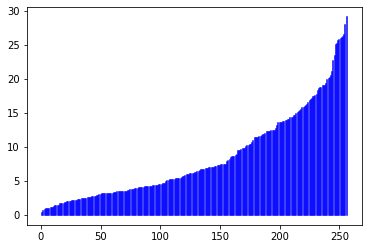

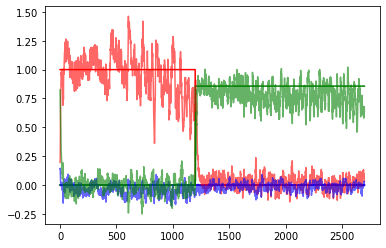

 27%|██████████████████████████████████████████▌                                                                                                                 | 819/3000 [3:55:29<9:16:17, 15.30s/it]

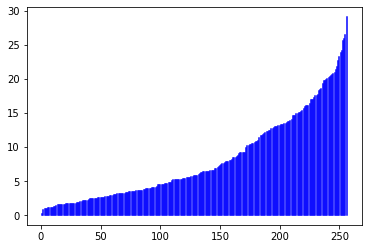

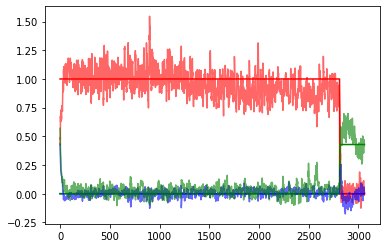

 27%|██████████████████████████████████████████▊                                                                                                                 | 824/3000 [3:56:50<9:27:09, 15.64s/it]

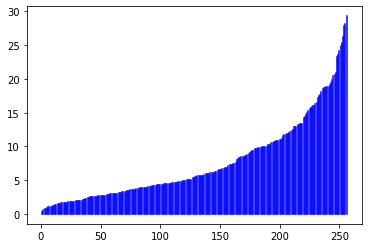

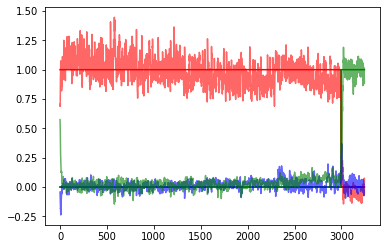

 28%|███████████████████████████████████████████                                                                                                                 | 829/3000 [3:58:13<9:37:19, 15.96s/it]

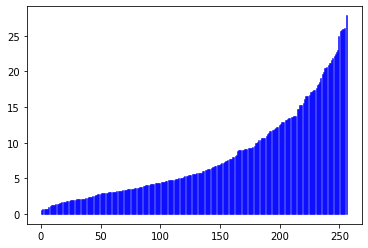

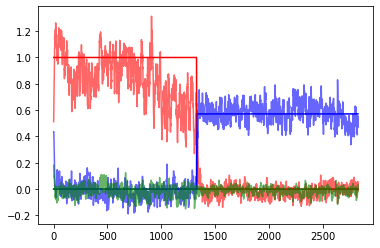

 28%|███████████████████████████████████████████▎                                                                                                                | 834/3000 [3:59:33<9:32:34, 15.86s/it]

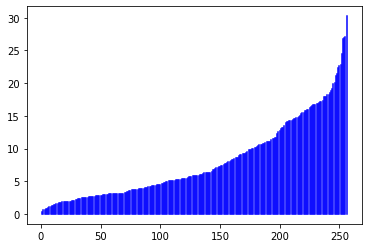

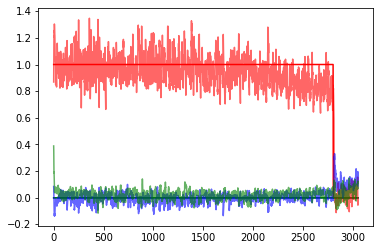

 28%|███████████████████████████████████████████▋                                                                                                                | 839/3000 [4:00:53<9:11:20, 15.31s/it]

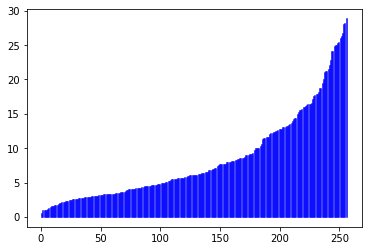

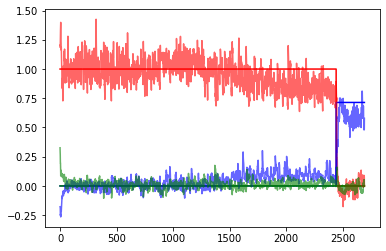

 28%|███████████████████████████████████████████▉                                                                                                                | 844/3000 [4:02:13<9:29:12, 15.84s/it]

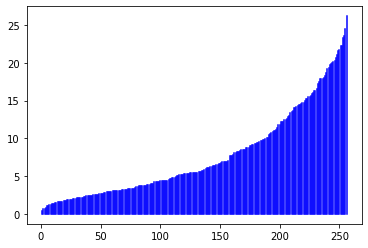

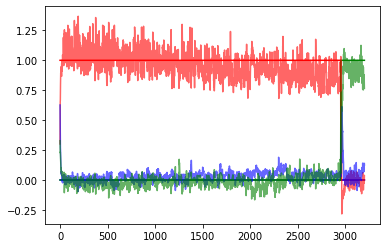

 28%|████████████████████████████████████████████▏                                                                                                               | 849/3000 [4:03:34<9:22:35, 15.69s/it]

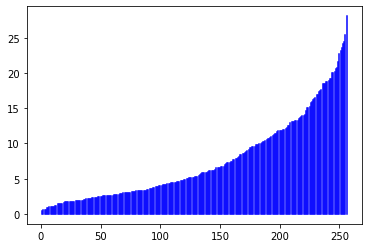

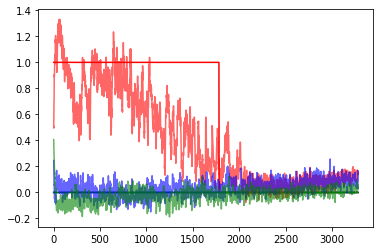

 28%|████████████████████████████████████████████                                                                                                               | 854/3000 [4:05:34<11:08:56, 18.70s/it]

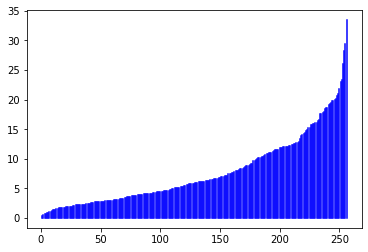

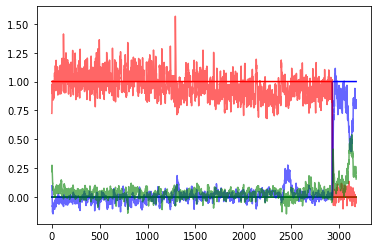

 29%|████████████████████████████████████████████▋                                                                                                               | 859/3000 [4:06:55<9:33:51, 16.08s/it]

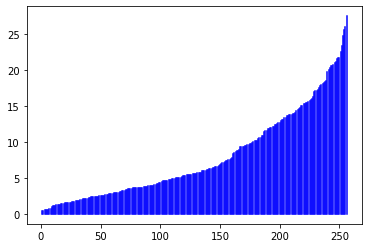

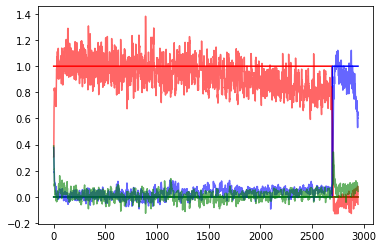

 29%|████████████████████████████████████████████▉                                                                                                               | 864/3000 [4:08:16<9:03:11, 15.26s/it]

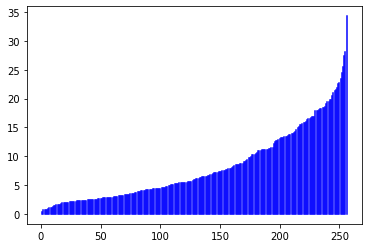

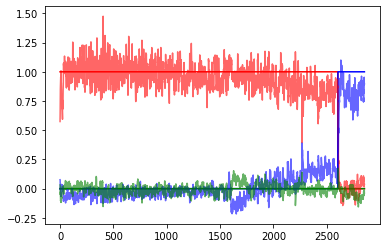

 29%|█████████████████████████████████████████████▏                                                                                                              | 869/3000 [4:09:35<9:06:40, 15.39s/it]

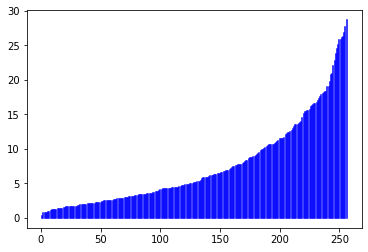

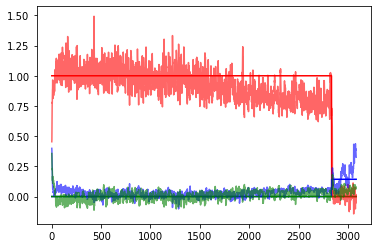

 29%|█████████████████████████████████████████████▍                                                                                                              | 874/3000 [4:10:51<8:47:56, 14.90s/it]

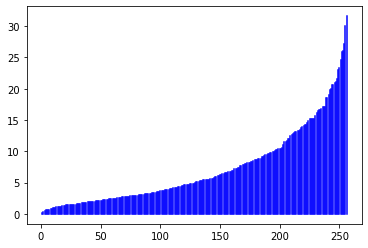

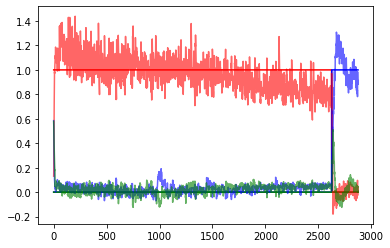

 29%|█████████████████████████████████████████████▋                                                                                                              | 879/3000 [4:12:10<8:54:13, 15.11s/it]

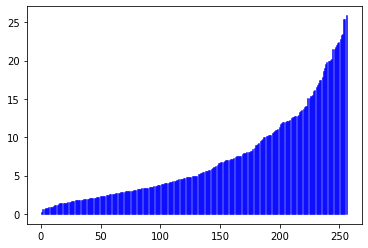

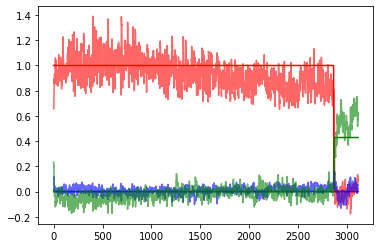

 29%|█████████████████████████████████████████████▉                                                                                                              | 884/3000 [4:13:31<9:06:22, 15.49s/it]

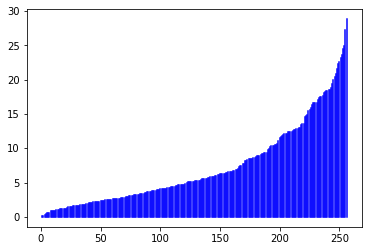

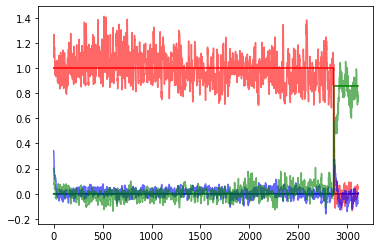

 30%|██████████████████████████████████████████████▏                                                                                                             | 889/3000 [4:14:48<8:50:55, 15.09s/it]

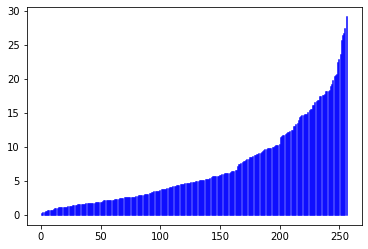

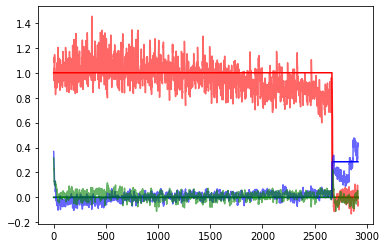

 30%|██████████████████████████████████████████████▍                                                                                                             | 894/3000 [4:16:07<8:57:50, 15.32s/it]

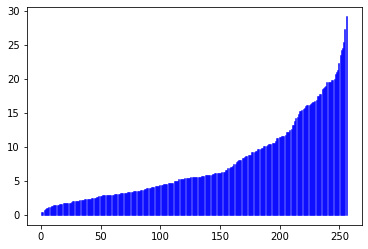

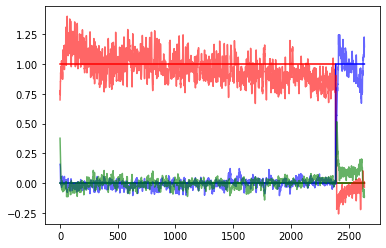

 30%|██████████████████████████████████████████████▋                                                                                                             | 899/3000 [4:17:23<8:43:16, 14.94s/it]

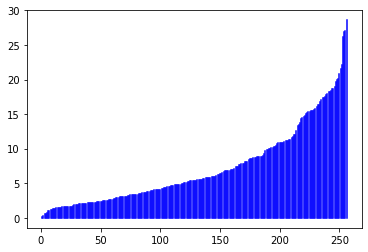

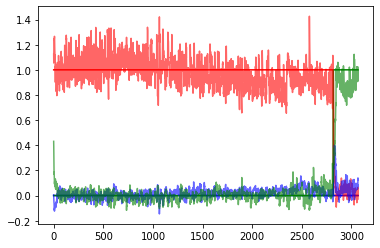

 30%|██████████████████████████████████████████████▋                                                                                                            | 904/3000 [4:19:18<10:20:01, 17.75s/it]

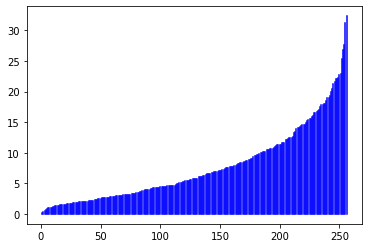

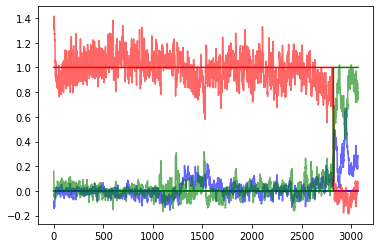

 30%|███████████████████████████████████████████████▎                                                                                                            | 909/3000 [4:20:39<9:20:40, 16.09s/it]

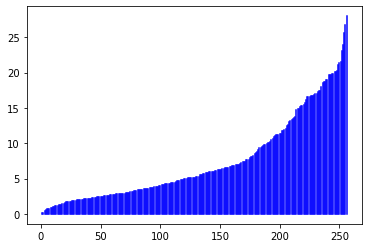

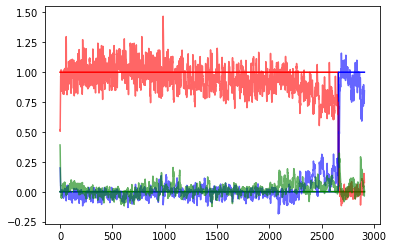

 30%|███████████████████████████████████████████████▌                                                                                                            | 914/3000 [4:21:58<9:01:32, 15.58s/it]

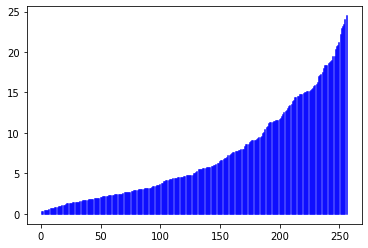

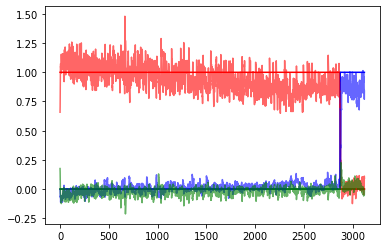

 31%|███████████████████████████████████████████████▊                                                                                                            | 919/3000 [4:23:17<8:55:38, 15.44s/it]

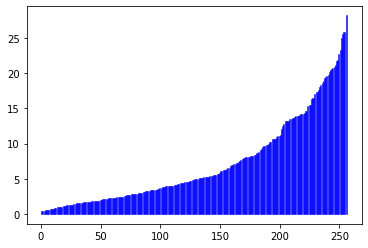

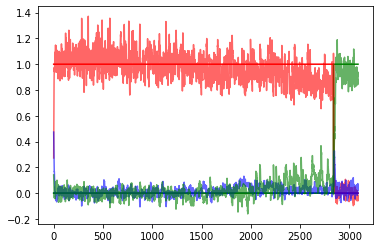

 31%|████████████████████████████████████████████████                                                                                                            | 924/3000 [4:24:41<9:14:37, 16.03s/it]

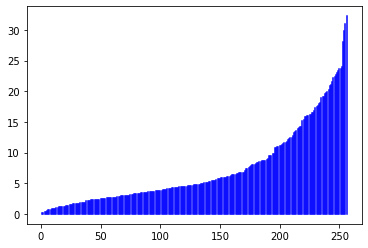

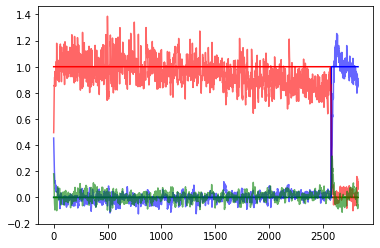

 31%|████████████████████████████████████████████████▎                                                                                                           | 929/3000 [4:26:00<8:46:51, 15.26s/it]

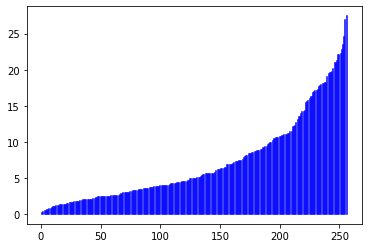

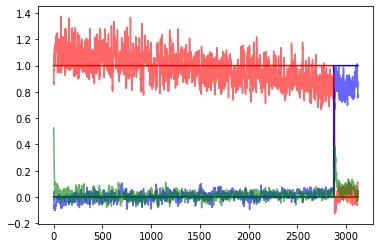

 31%|████████████████████████████████████████████████▌                                                                                                           | 934/3000 [4:27:18<8:49:54, 15.39s/it]

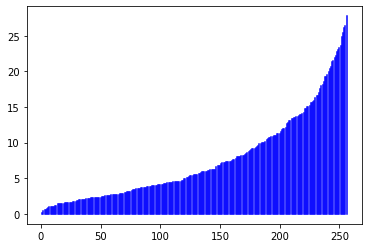

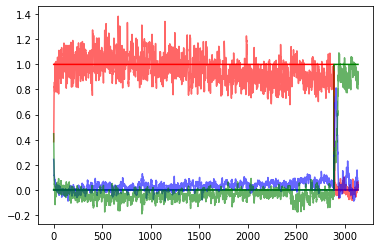

 31%|████████████████████████████████████████████████▊                                                                                                           | 939/3000 [4:28:38<8:43:03, 15.23s/it]

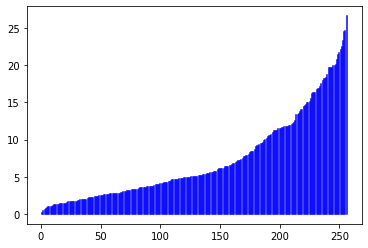

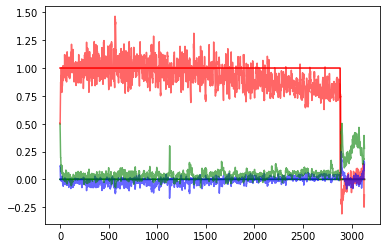

 31%|█████████████████████████████████████████████████                                                                                                           | 944/3000 [4:30:00<8:58:52, 15.73s/it]

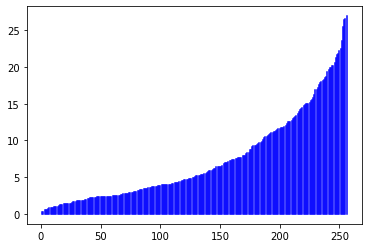

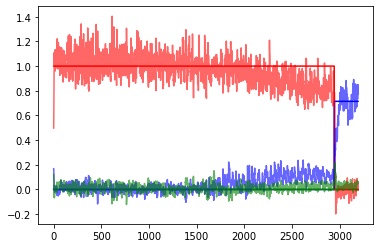

 32%|█████████████████████████████████████████████████▎                                                                                                          | 949/3000 [4:31:21<8:55:13, 15.66s/it]

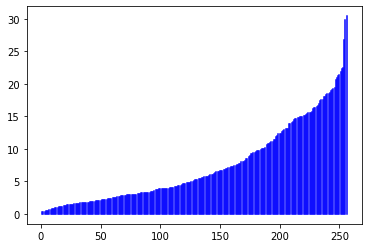

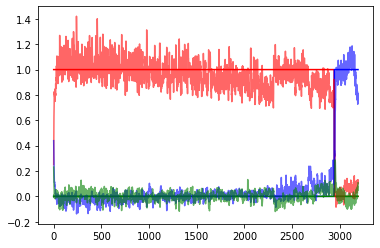

 32%|█████████████████████████████████████████████████▎                                                                                                         | 954/3000 [4:33:24<10:52:06, 19.12s/it]

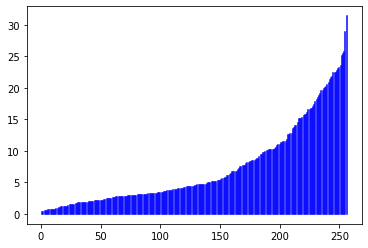

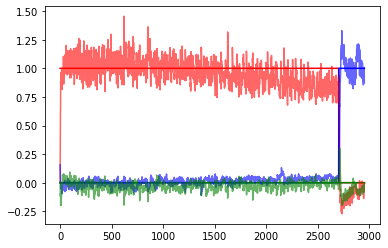

 32%|█████████████████████████████████████████████████▊                                                                                                          | 959/3000 [4:34:45<9:11:52, 16.22s/it]

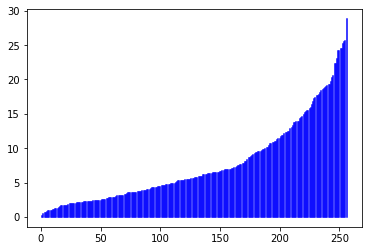

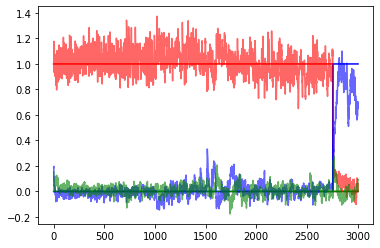

 32%|██████████████████████████████████████████████████▏                                                                                                         | 964/3000 [4:36:07<9:05:20, 16.07s/it]

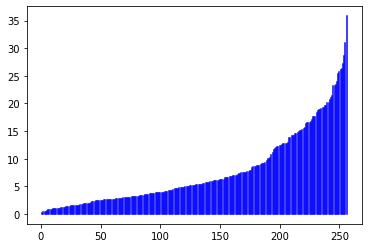

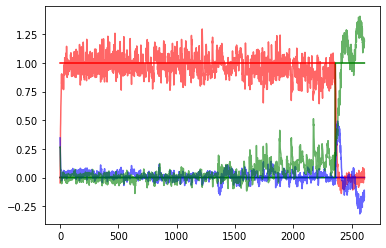

 32%|██████████████████████████████████████████████████▍                                                                                                         | 969/3000 [4:37:24<8:28:50, 15.03s/it]

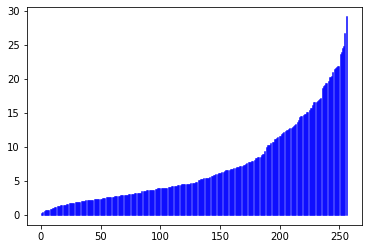

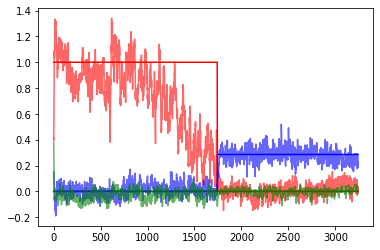

 32%|██████████████████████████████████████████████████▋                                                                                                         | 974/3000 [4:38:45<8:42:31, 15.47s/it]

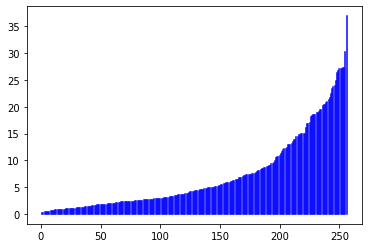

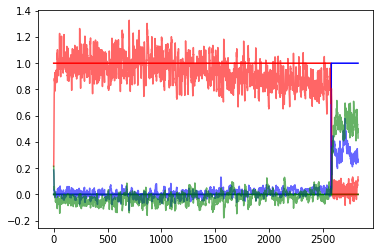

 33%|██████████████████████████████████████████████████▉                                                                                                         | 979/3000 [4:40:03<8:31:31, 15.19s/it]

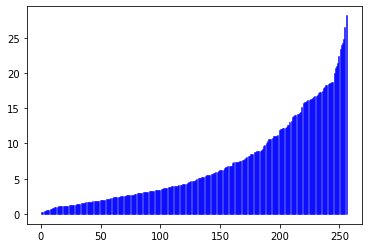

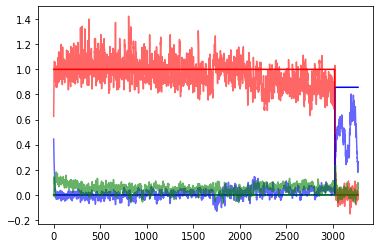

 33%|███████████████████████████████████████████████████▏                                                                                                        | 984/3000 [4:41:23<8:47:51, 15.71s/it]

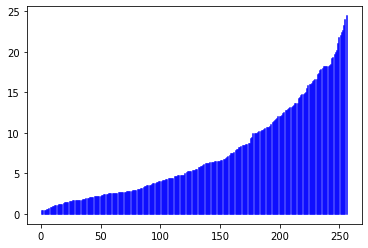

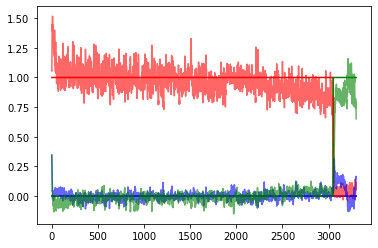

 33%|███████████████████████████████████████████████████▍                                                                                                        | 989/3000 [4:42:45<8:54:37, 15.95s/it]

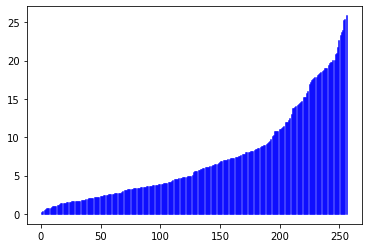

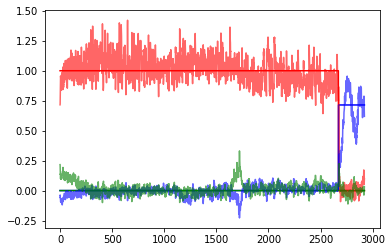

 33%|███████████████████████████████████████████████████▋                                                                                                        | 994/3000 [4:44:06<8:39:09, 15.53s/it]

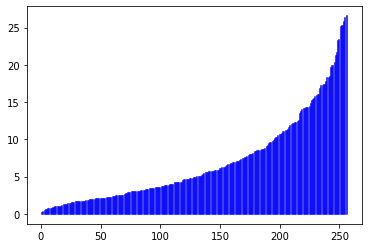

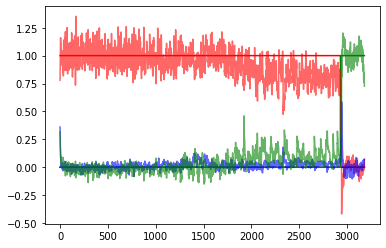

 33%|███████████████████████████████████████████████████▉                                                                                                        | 999/3000 [4:45:24<8:24:34, 15.13s/it]

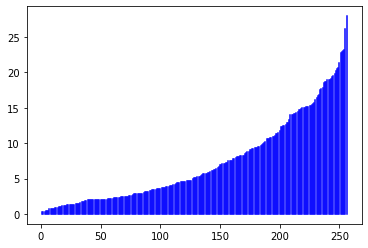

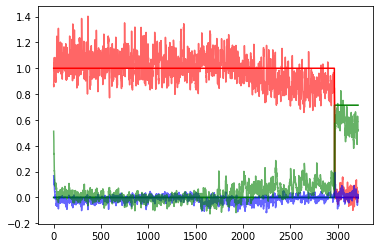

 33%|███████████████████████████████████████████████████▌                                                                                                      | 1004/3000 [4:47:23<10:14:04, 18.46s/it]

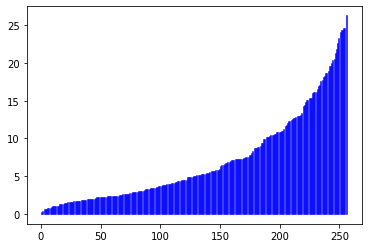

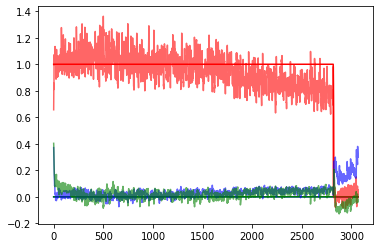

 34%|████████████████████████████████████████████████████▏                                                                                                      | 1009/3000 [4:48:41<8:46:50, 15.88s/it]

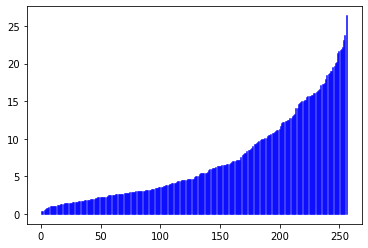

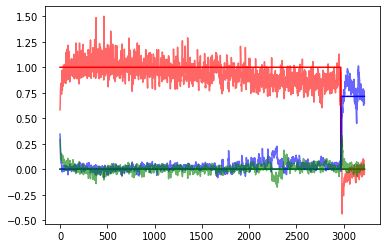

 34%|████████████████████████████████████████████████████▍                                                                                                      | 1014/3000 [4:50:00<8:24:59, 15.26s/it]

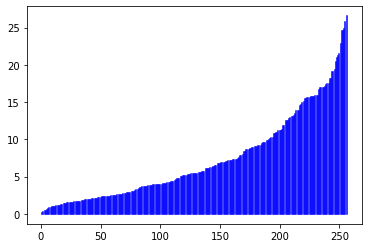

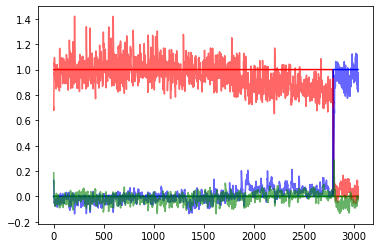

 34%|████████████████████████████████████████████████████▋                                                                                                      | 1019/3000 [4:51:27<9:20:28, 16.98s/it]

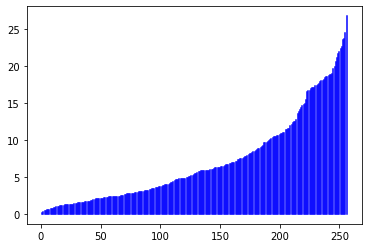

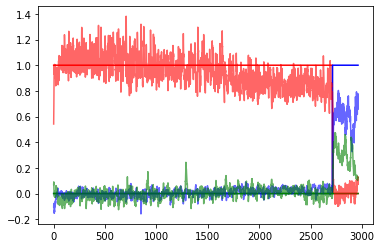

 34%|████████████████████████████████████████████████████▉                                                                                                      | 1024/3000 [4:52:49<8:51:45, 16.15s/it]

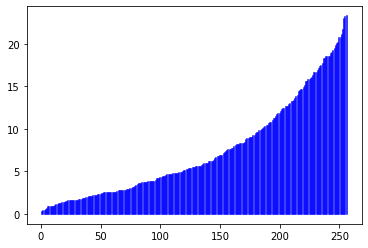

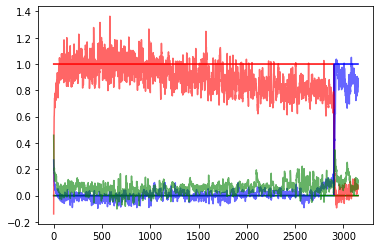

 34%|█████████████████████████████████████████████████████▏                                                                                                     | 1029/3000 [4:54:07<8:29:17, 15.50s/it]

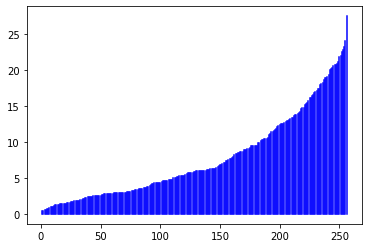

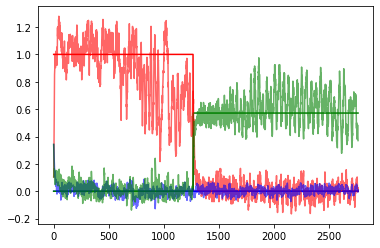

 34%|█████████████████████████████████████████████████████▍                                                                                                     | 1034/3000 [4:55:25<8:15:32, 15.12s/it]

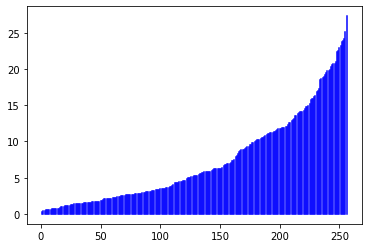

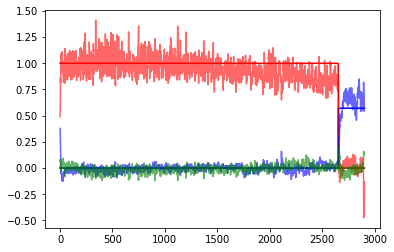

 35%|█████████████████████████████████████████████████████▋                                                                                                     | 1039/3000 [4:56:43<8:19:08, 15.27s/it]

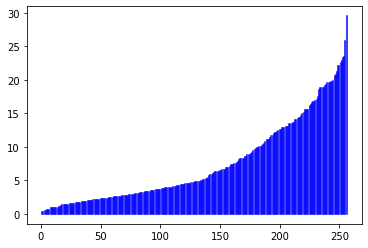

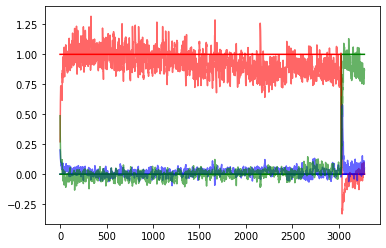

 35%|█████████████████████████████████████████████████████▉                                                                                                     | 1044/3000 [4:58:06<8:34:24, 15.78s/it]

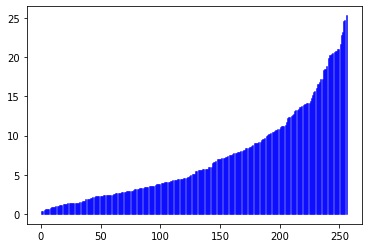

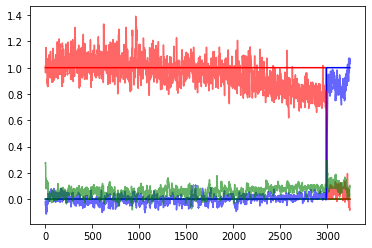

 35%|██████████████████████████████████████████████████████▏                                                                                                    | 1049/3000 [4:59:25<8:21:37, 15.43s/it]

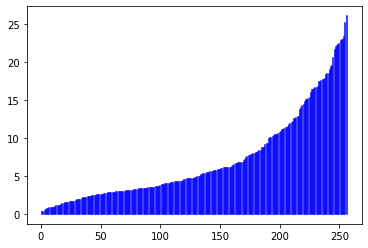

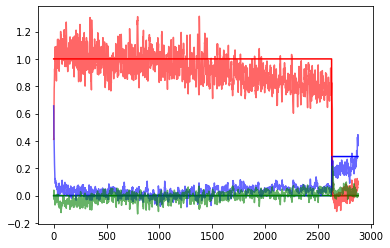

 35%|██████████████████████████████████████████████████████▍                                                                                                    | 1054/3000 [5:01:22<9:52:23, 18.26s/it]

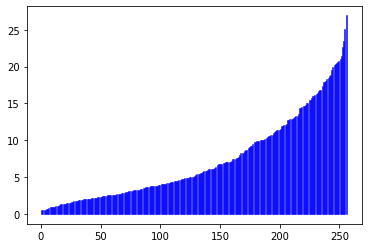

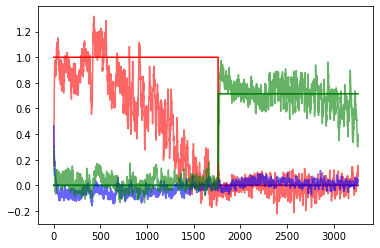

 35%|██████████████████████████████████████████████████████▎                                                                                                   | 1059/3000 [5:02:56<10:00:08, 18.55s/it]

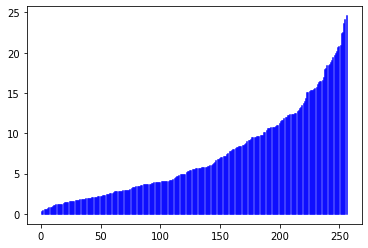

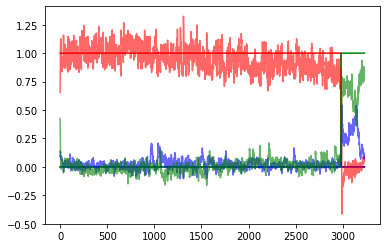

 35%|██████████████████████████████████████████████████████▉                                                                                                    | 1064/3000 [5:04:27<9:30:58, 17.70s/it]

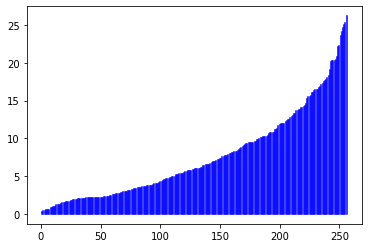

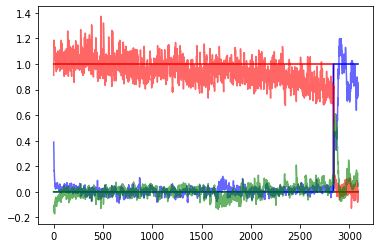

 36%|███████████████████████████████████████████████████████▏                                                                                                   | 1069/3000 [5:05:53<9:02:58, 16.87s/it]

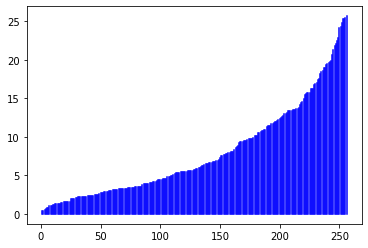

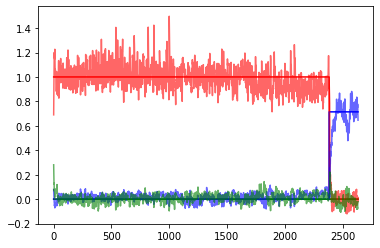

 36%|███████████████████████████████████████████████████████▍                                                                                                   | 1074/3000 [5:07:23<8:57:28, 16.74s/it]

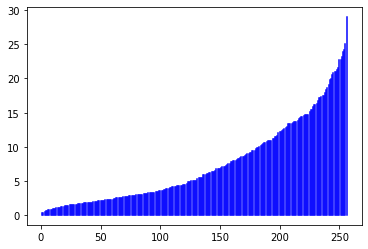

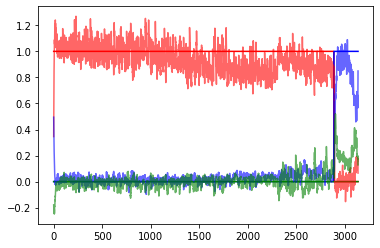

 36%|███████████████████████████████████████████████████████▋                                                                                                   | 1079/3000 [5:08:41<7:56:03, 14.87s/it]

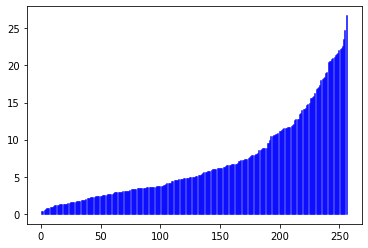

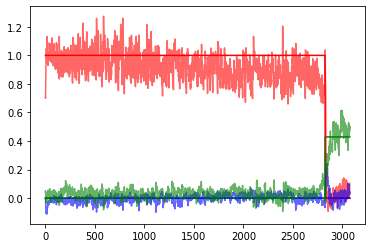

 36%|████████████████████████████████████████████████████████                                                                                                   | 1084/3000 [5:09:57<7:50:08, 14.72s/it]

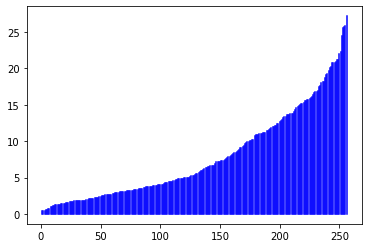

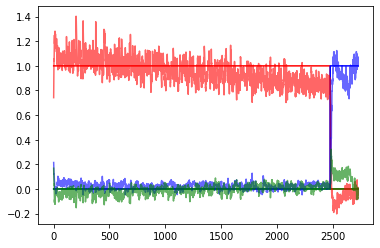

 36%|████████████████████████████████████████████████████████▎                                                                                                  | 1089/3000 [5:11:18<8:19:18, 15.68s/it]

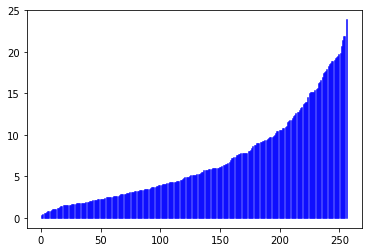

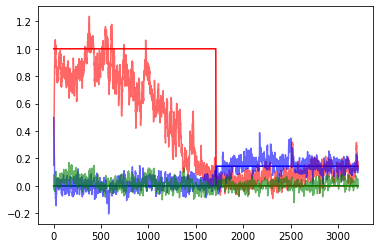

 36%|████████████████████████████████████████████████████████▌                                                                                                  | 1094/3000 [5:12:39<8:15:34, 15.60s/it]

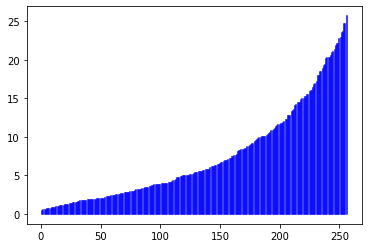

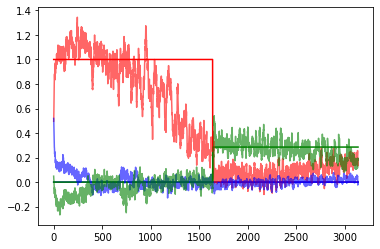

 37%|████████████████████████████████████████████████████████▊                                                                                                  | 1099/3000 [5:13:59<8:10:59, 15.50s/it]

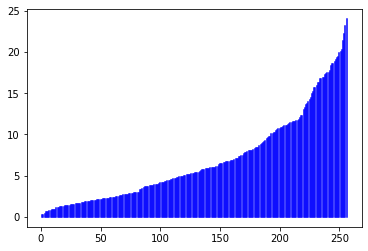

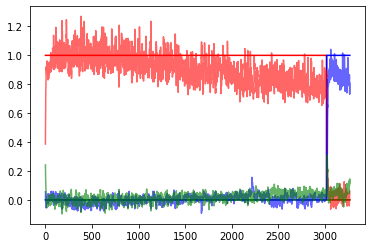

 37%|█████████████████████████████████████████████████████████                                                                                                  | 1104/3000 [5:15:54<9:27:46, 17.97s/it]

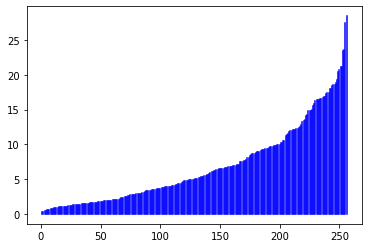

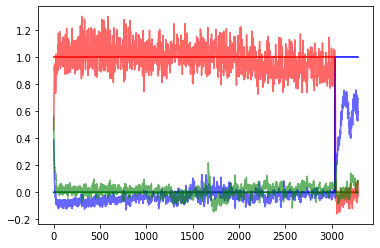

 37%|█████████████████████████████████████████████████████████▎                                                                                                 | 1109/3000 [5:17:10<8:03:46, 15.35s/it]

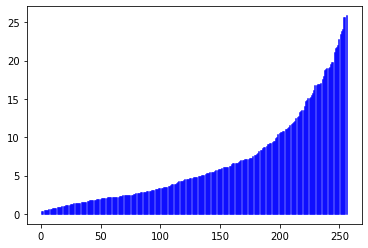

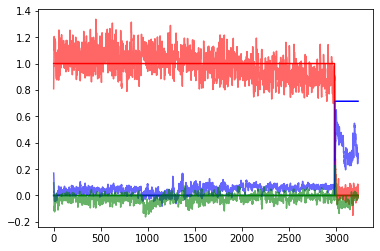

 37%|█████████████████████████████████████████████████████████▌                                                                                                 | 1114/3000 [5:18:31<8:03:16, 15.37s/it]

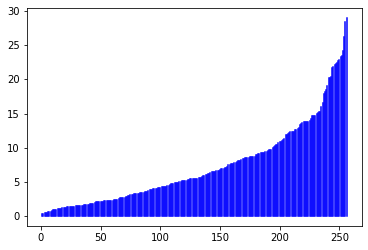

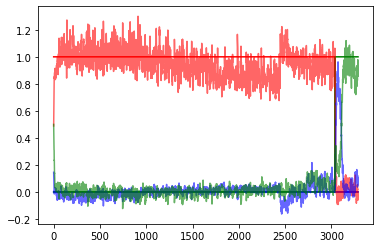

 37%|█████████████████████████████████████████████████████████▊                                                                                                 | 1119/3000 [5:19:51<8:08:38, 15.59s/it]

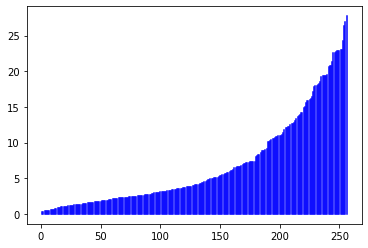

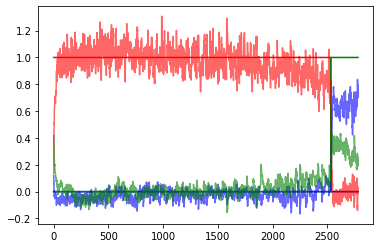

 37%|██████████████████████████████████████████████████████████                                                                                                 | 1124/3000 [5:21:11<8:10:26, 15.69s/it]

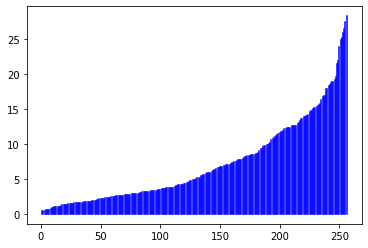

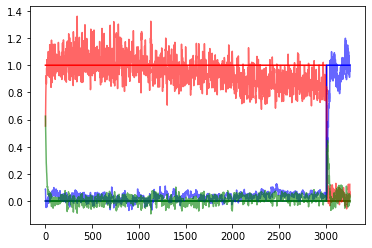

 38%|██████████████████████████████████████████████████████████▎                                                                                                | 1129/3000 [5:22:30<7:54:00, 15.20s/it]

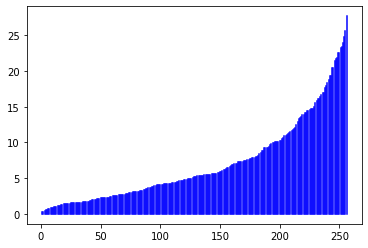

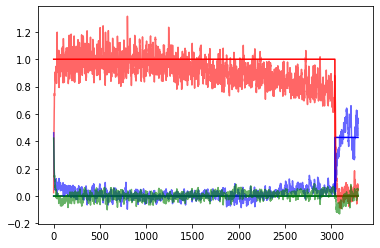

 38%|██████████████████████████████████████████████████████████▌                                                                                                | 1134/3000 [5:23:48<7:53:25, 15.22s/it]

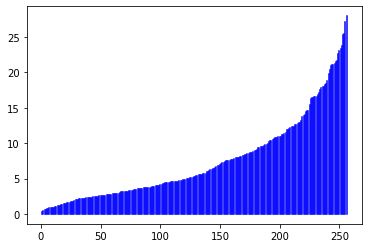

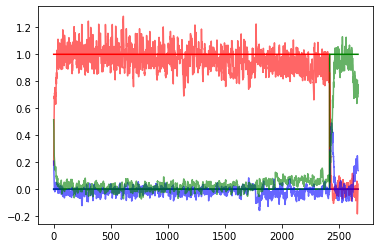

 38%|██████████████████████████████████████████████████████████▊                                                                                                | 1139/3000 [5:25:06<7:43:45, 14.95s/it]

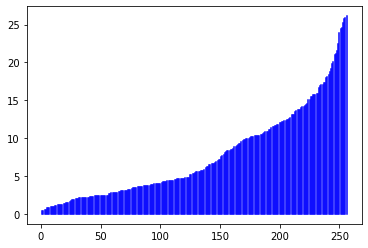

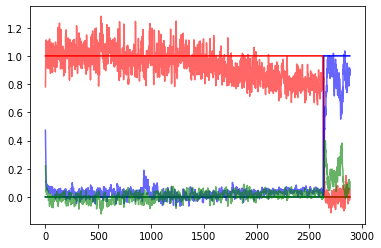

 38%|███████████████████████████████████████████████████████████                                                                                                | 1144/3000 [5:26:23<7:49:37, 15.18s/it]

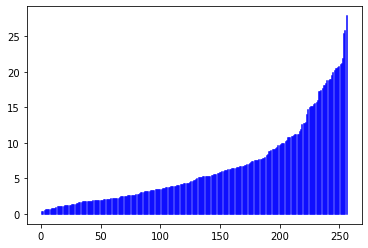

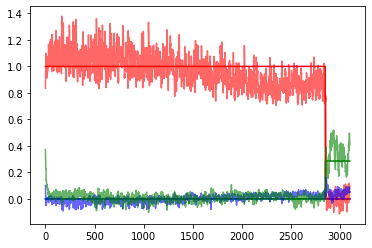

 38%|███████████████████████████████████████████████████████████▎                                                                                               | 1149/3000 [5:27:42<7:51:04, 15.27s/it]

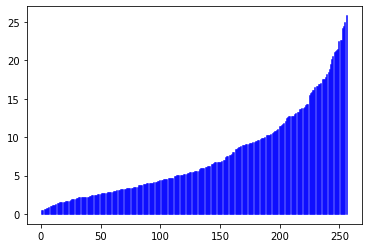

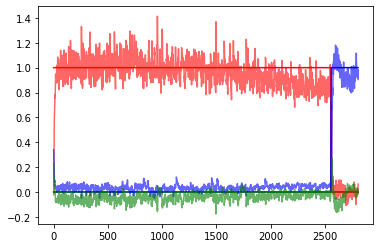

 38%|███████████████████████████████████████████████████████████▌                                                                                               | 1154/3000 [5:29:36<9:10:59, 17.91s/it]

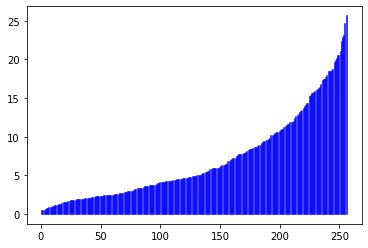

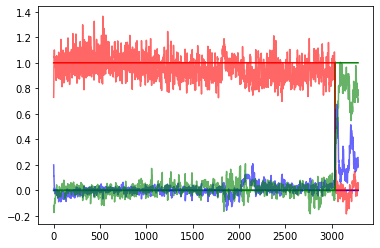

 39%|███████████████████████████████████████████████████████████▉                                                                                               | 1159/3000 [5:30:52<7:40:44, 15.02s/it]

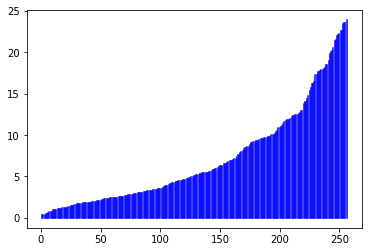

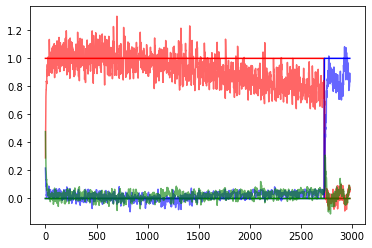

 39%|████████████████████████████████████████████████████████████▏                                                                                              | 1164/3000 [5:32:14<8:02:15, 15.76s/it]

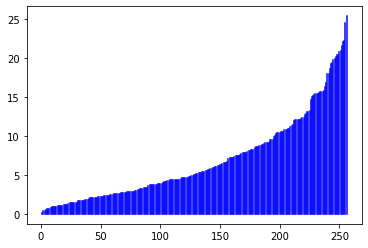

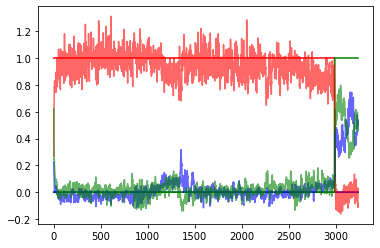

 39%|████████████████████████████████████████████████████████████▍                                                                                              | 1169/3000 [5:33:31<7:38:55, 15.04s/it]

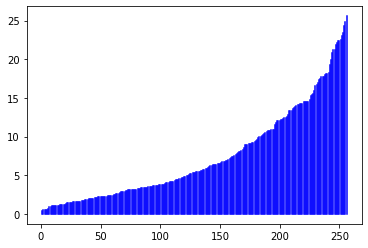

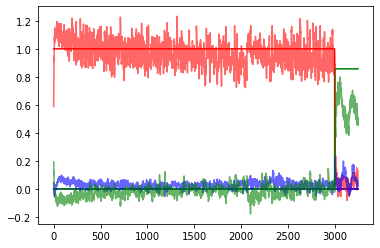

 39%|████████████████████████████████████████████████████████████▋                                                                                              | 1174/3000 [5:34:48<7:35:58, 14.98s/it]

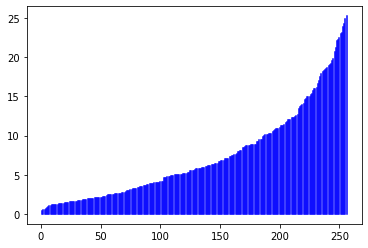

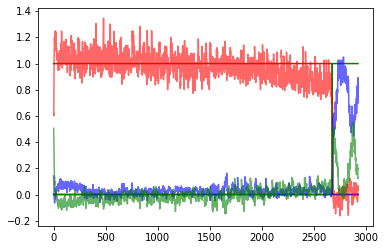

 39%|████████████████████████████████████████████████████████████▉                                                                                              | 1179/3000 [5:36:04<7:34:23, 14.97s/it]

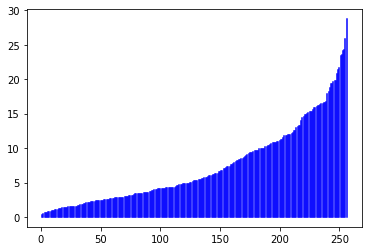

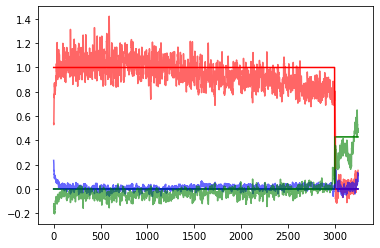

 39%|█████████████████████████████████████████████████████████████▏                                                                                             | 1184/3000 [5:37:20<7:28:25, 14.82s/it]

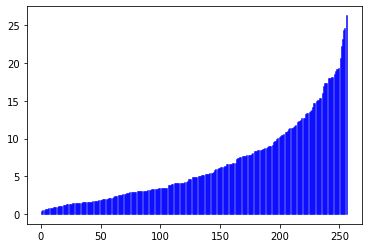

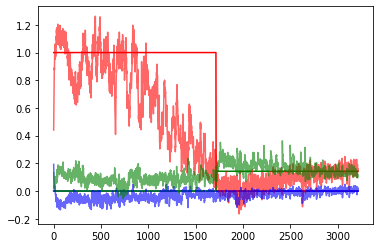

 40%|█████████████████████████████████████████████████████████████▍                                                                                             | 1189/3000 [5:38:37<7:30:55, 14.94s/it]

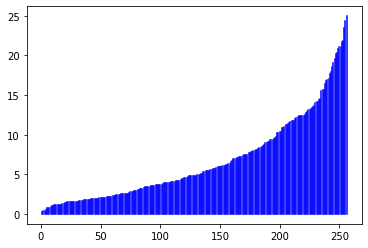

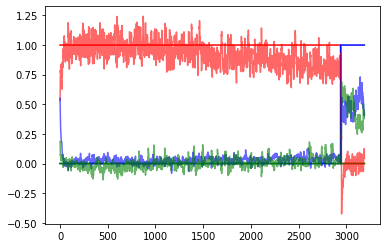

 40%|█████████████████████████████████████████████████████████████▋                                                                                             | 1194/3000 [5:39:57<7:39:55, 15.28s/it]

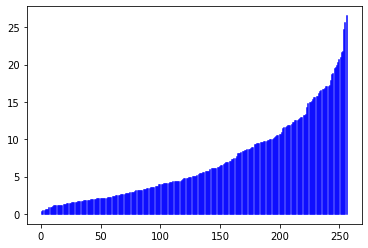

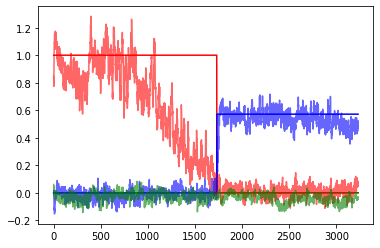

 40%|█████████████████████████████████████████████████████████████▉                                                                                             | 1199/3000 [5:41:14<7:26:28, 14.87s/it]

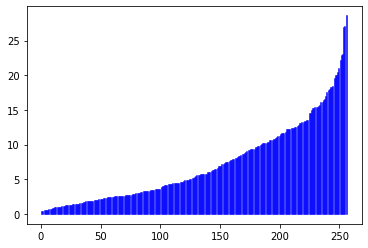

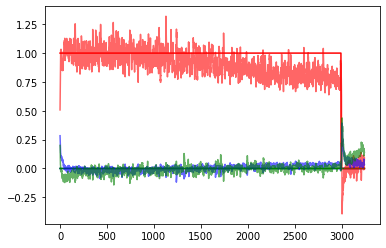

 40%|██████████████████████████████████████████████████████████████▏                                                                                            | 1204/3000 [5:43:09<8:52:17, 17.78s/it]

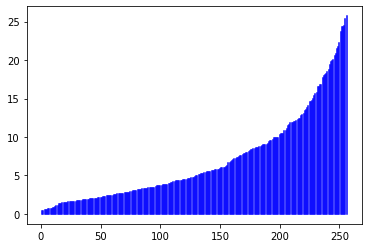

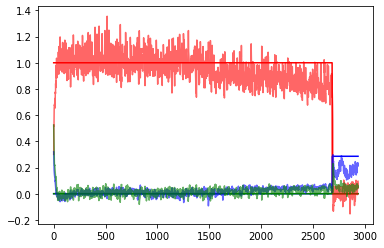

 40%|██████████████████████████████████████████████████████████████▍                                                                                            | 1209/3000 [5:44:29<7:58:15, 16.02s/it]

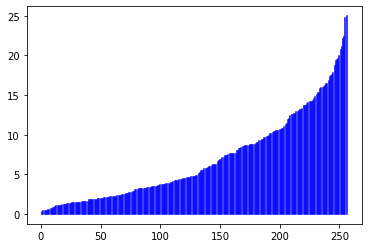

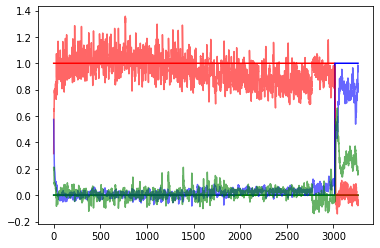

 40%|██████████████████████████████████████████████████████████████▋                                                                                            | 1214/3000 [5:45:49<7:41:29, 15.50s/it]

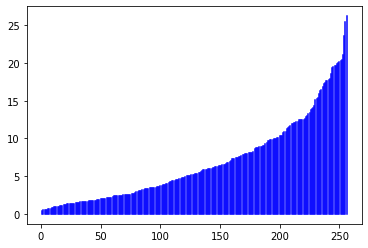

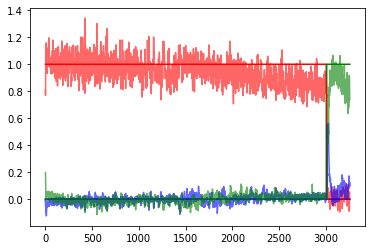

 41%|██████████████████████████████████████████████████████████████▉                                                                                            | 1219/3000 [5:47:07<7:34:47, 15.32s/it]

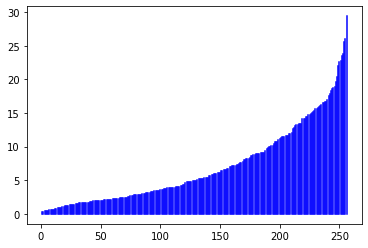

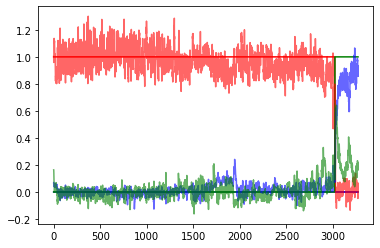

 41%|███████████████████████████████████████████████████████████████▏                                                                                           | 1224/3000 [5:48:27<7:37:18, 15.45s/it]

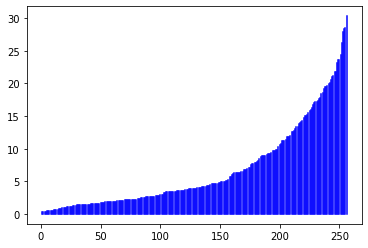

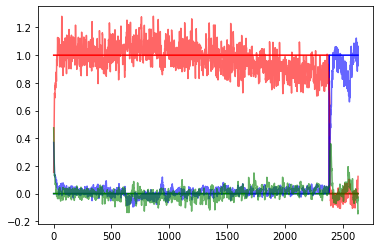

 41%|███████████████████████████████████████████████████████████████▍                                                                                           | 1229/3000 [5:49:44<7:29:25, 15.23s/it]

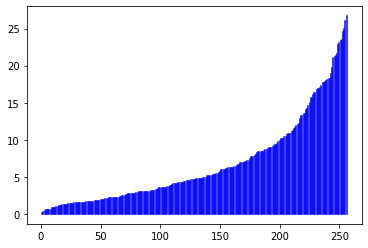

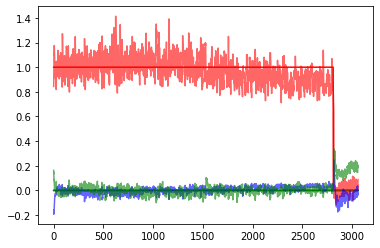

 41%|███████████████████████████████████████████████████████████████▊                                                                                           | 1234/3000 [5:51:05<7:30:11, 15.30s/it]

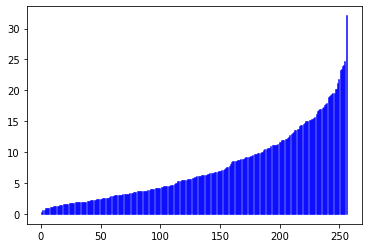

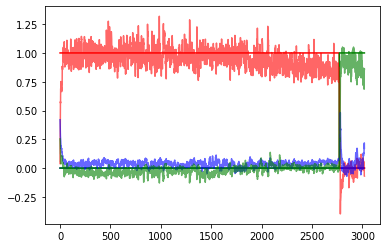

 41%|████████████████████████████████████████████████████████████████                                                                                           | 1239/3000 [5:52:26<7:32:11, 15.41s/it]

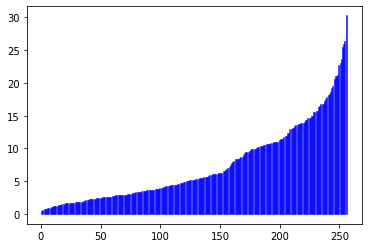

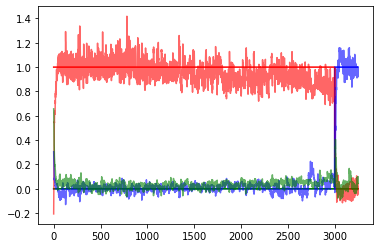

 41%|████████████████████████████████████████████████████████████████▎                                                                                          | 1244/3000 [5:53:45<7:24:54, 15.20s/it]

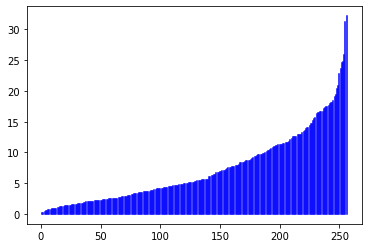

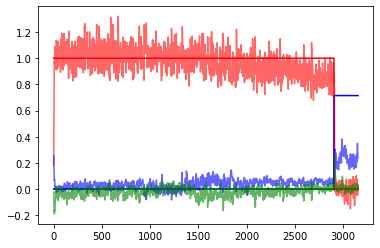

 42%|████████████████████████████████████████████████████████████████▌                                                                                          | 1249/3000 [5:55:05<7:25:15, 15.26s/it]

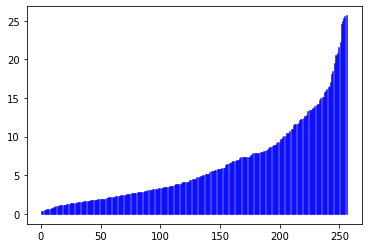

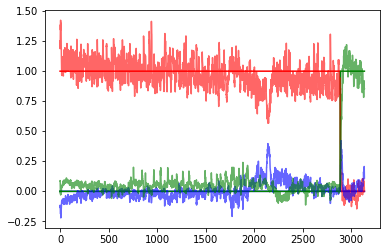

 42%|████████████████████████████████████████████████████████████████▊                                                                                          | 1254/3000 [5:57:04<8:51:28, 18.26s/it]

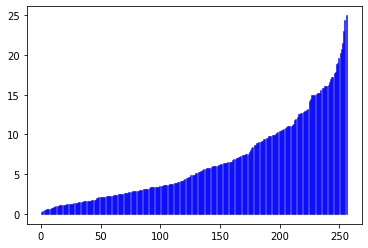

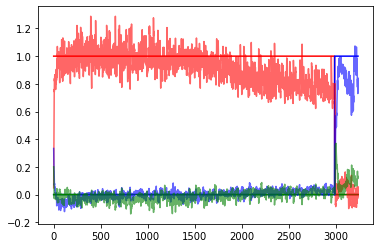

 42%|█████████████████████████████████████████████████████████████████                                                                                          | 1259/3000 [5:58:22<7:30:26, 15.52s/it]

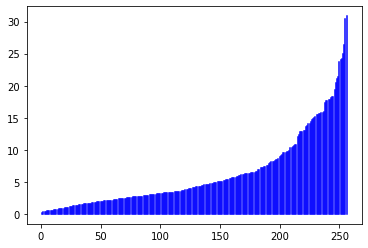

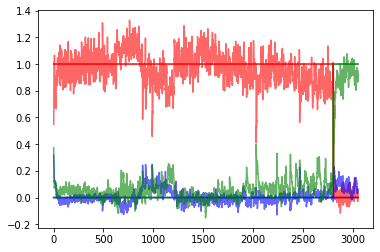

 42%|█████████████████████████████████████████████████████████████████▎                                                                                         | 1264/3000 [5:59:41<7:30:28, 15.57s/it]

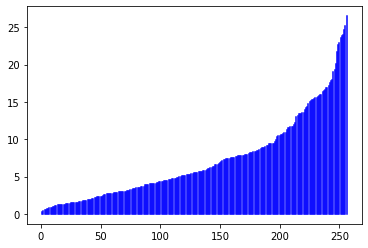

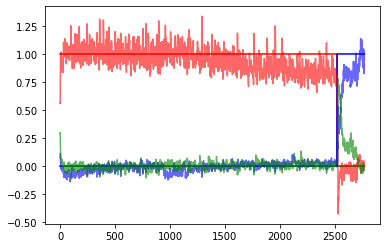

 42%|█████████████████████████████████████████████████████████████████▌                                                                                         | 1269/3000 [6:00:56<7:02:18, 14.64s/it]

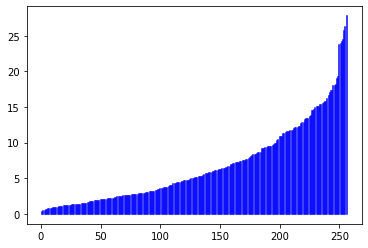

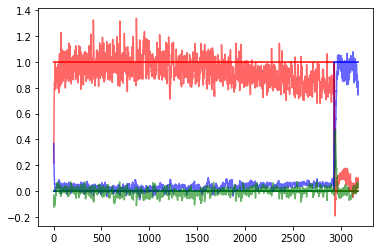

 42%|█████████████████████████████████████████████████████████████████▊                                                                                         | 1274/3000 [6:02:15<7:20:21, 15.31s/it]

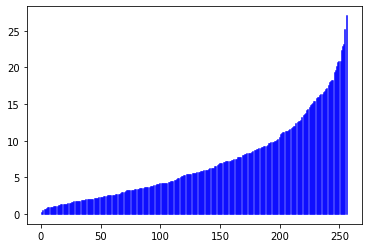

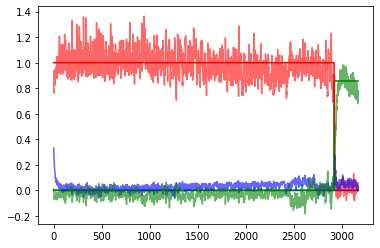

 43%|██████████████████████████████████████████████████████████████████                                                                                         | 1279/3000 [6:03:32<7:09:34, 14.98s/it]

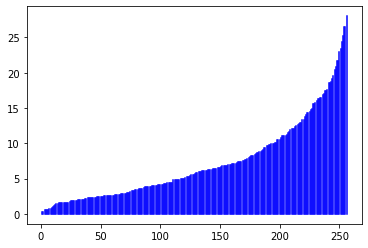

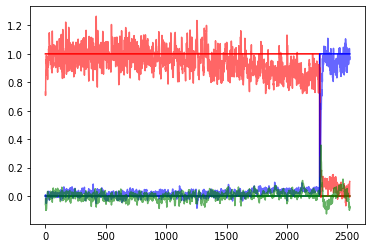

 43%|██████████████████████████████████████████████████████████████████▎                                                                                        | 1284/3000 [6:04:50<7:13:44, 15.17s/it]

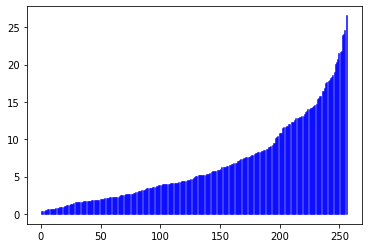

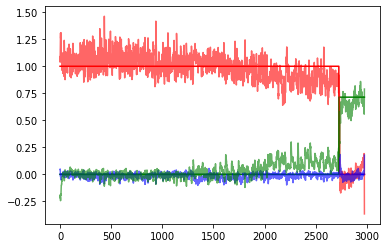

 43%|██████████████████████████████████████████████████████████████████▌                                                                                        | 1289/3000 [6:06:07<7:09:06, 15.05s/it]

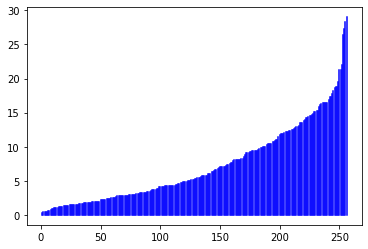

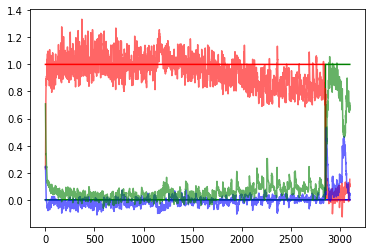

 43%|██████████████████████████████████████████████████████████████████▊                                                                                        | 1294/3000 [6:07:24<7:02:41, 14.87s/it]

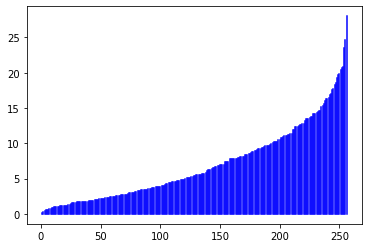

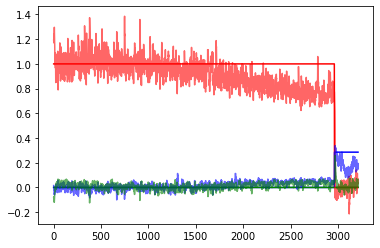

 43%|███████████████████████████████████████████████████████████████████                                                                                        | 1299/3000 [6:08:43<7:13:03, 15.28s/it]

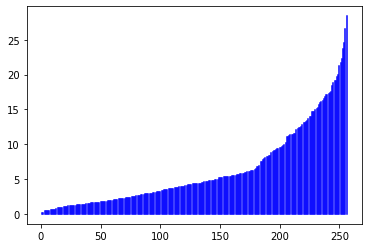

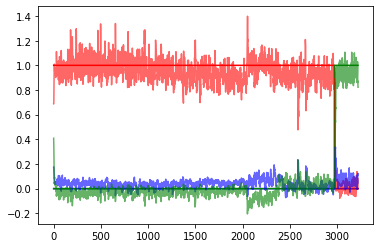

 43%|███████████████████████████████████████████████████████████████████▎                                                                                       | 1304/3000 [6:10:38<8:21:36, 17.75s/it]

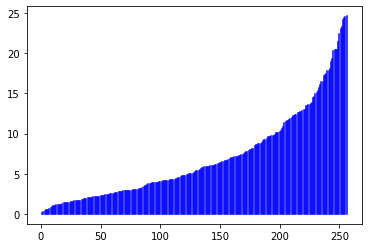

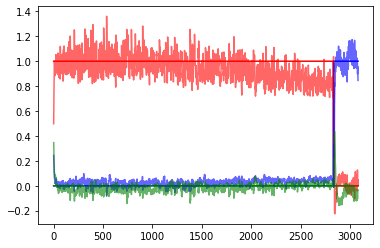

 44%|███████████████████████████████████████████████████████████████████▋                                                                                       | 1309/3000 [6:11:58<7:26:43, 15.85s/it]

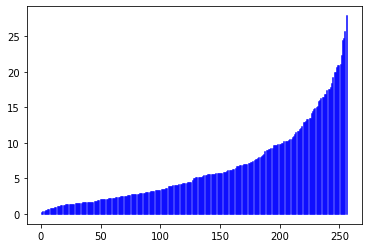

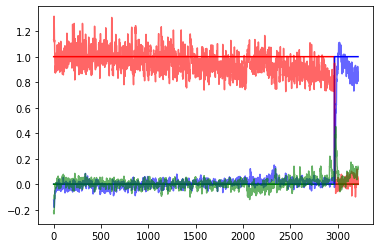

 44%|███████████████████████████████████████████████████████████████████▉                                                                                       | 1314/3000 [6:13:15<7:04:37, 15.11s/it]

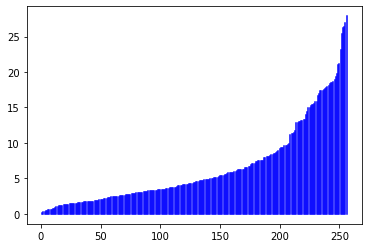

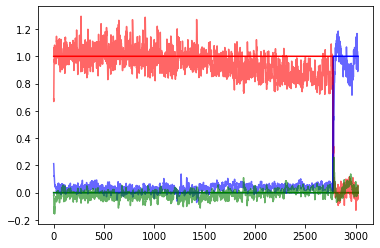

 44%|████████████████████████████████████████████████████████████████████▏                                                                                      | 1319/3000 [6:14:33<6:57:34, 14.90s/it]

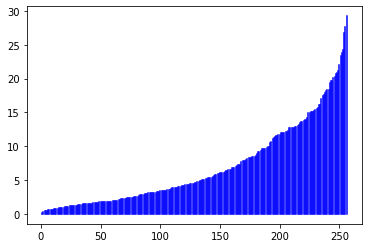

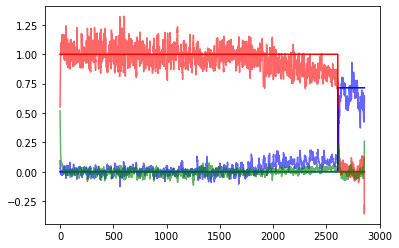

 44%|████████████████████████████████████████████████████████████████████▍                                                                                      | 1324/3000 [6:15:53<7:12:26, 15.48s/it]

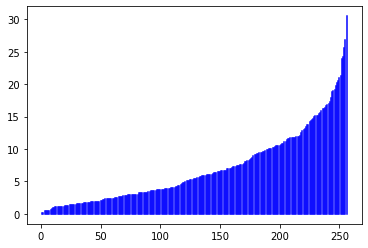

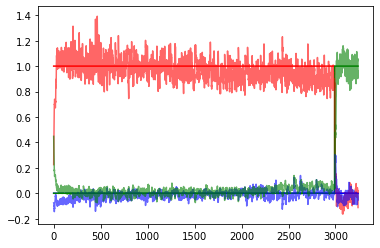

 44%|████████████████████████████████████████████████████████████████████▋                                                                                      | 1329/3000 [6:17:13<7:11:41, 15.50s/it]

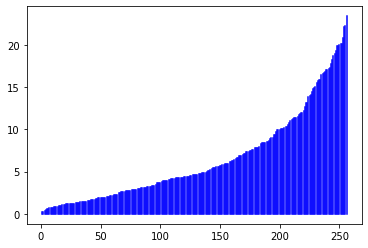

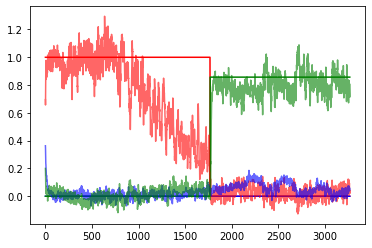

 44%|████████████████████████████████████████████████████████████████████▉                                                                                      | 1334/3000 [6:18:34<7:13:44, 15.62s/it]

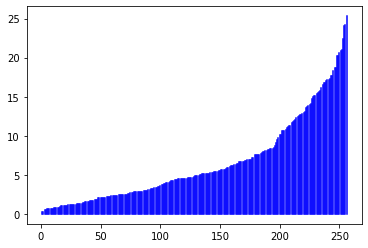

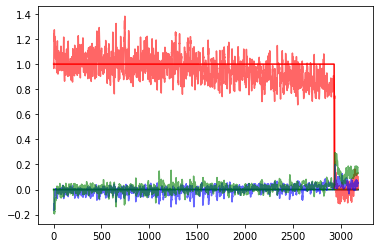

 45%|█████████████████████████████████████████████████████████████████████▏                                                                                     | 1339/3000 [6:19:56<7:13:16, 15.65s/it]

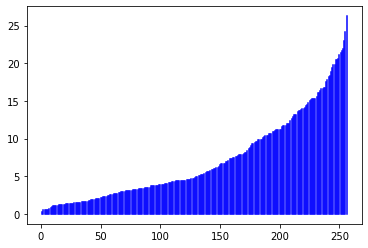

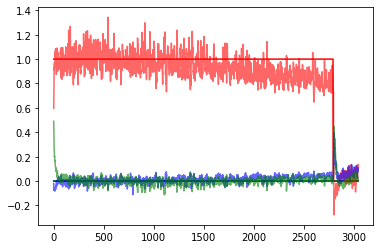

 45%|█████████████████████████████████████████████████████████████████████▍                                                                                     | 1344/3000 [6:21:13<6:57:59, 15.14s/it]

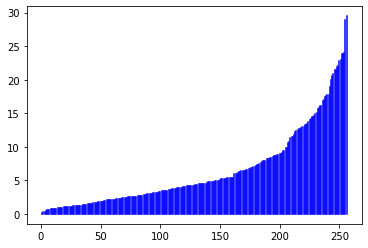

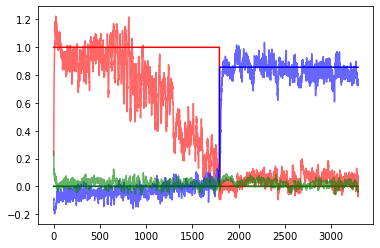

 45%|█████████████████████████████████████████████████████████████████████▋                                                                                     | 1349/3000 [6:22:30<6:43:37, 14.67s/it]

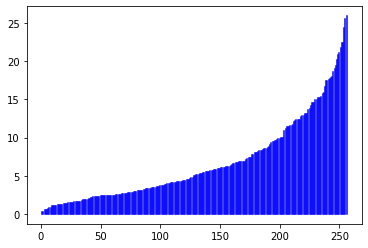

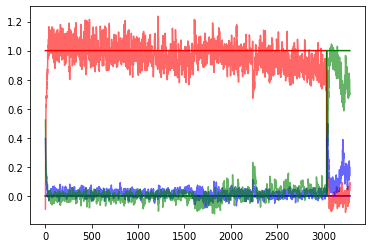

 45%|█████████████████████████████████████████████████████████████████████▉                                                                                     | 1354/3000 [6:24:25<8:11:58, 17.93s/it]

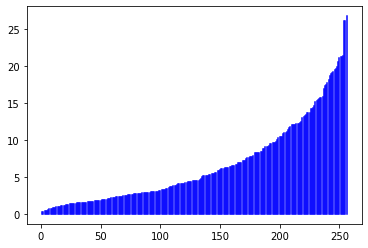

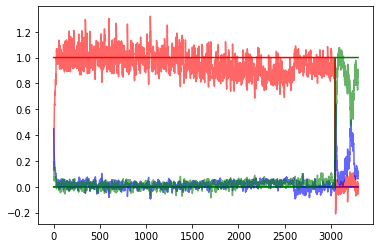

 45%|██████████████████████████████████████████████████████████████████████▏                                                                                    | 1359/3000 [6:25:44<7:04:05, 15.51s/it]

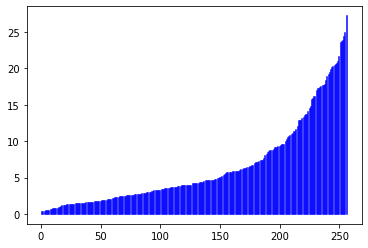

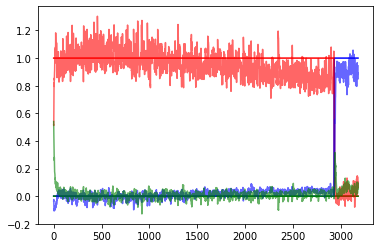

 45%|██████████████████████████████████████████████████████████████████████▍                                                                                    | 1364/3000 [6:27:04<6:59:39, 15.39s/it]

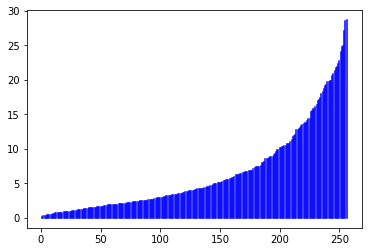

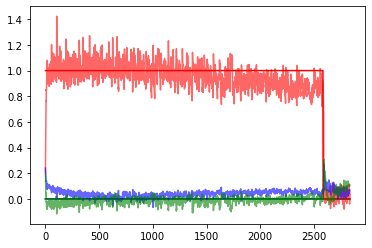

 46%|██████████████████████████████████████████████████████████████████████▋                                                                                    | 1369/3000 [6:28:22<6:51:11, 15.13s/it]

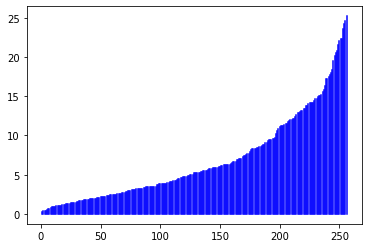

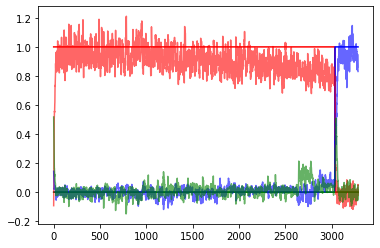

 46%|██████████████████████████████████████████████████████████████████████▉                                                                                    | 1374/3000 [6:29:41<6:53:35, 15.26s/it]

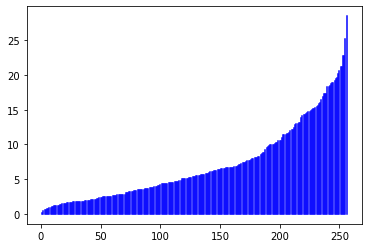

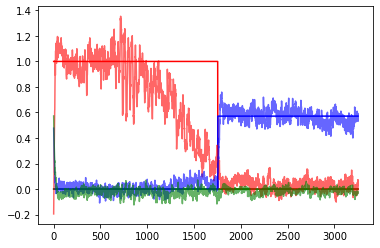

 46%|███████████████████████████████████████████████████████████████████████▏                                                                                   | 1379/3000 [6:31:03<7:02:28, 15.64s/it]

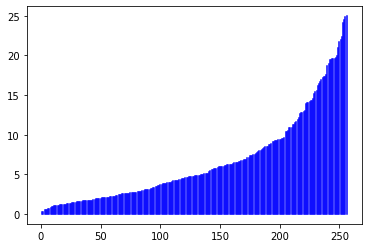

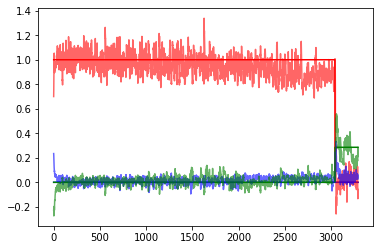

 46%|███████████████████████████████████████████████████████████████████████▌                                                                                   | 1384/3000 [6:32:24<7:06:08, 15.82s/it]

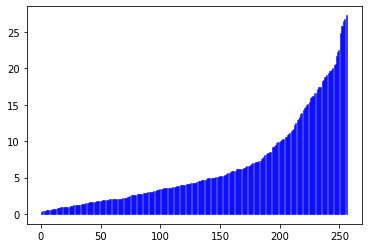

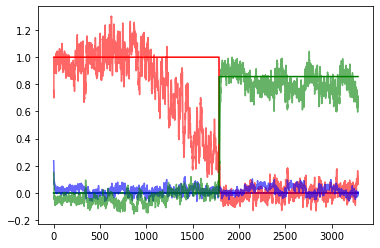

 46%|███████████████████████████████████████████████████████████████████████▊                                                                                   | 1389/3000 [6:33:45<7:01:47, 15.71s/it]

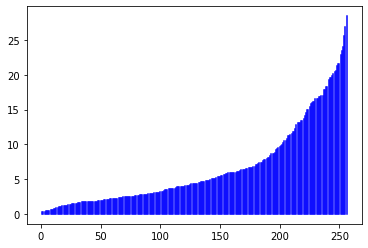

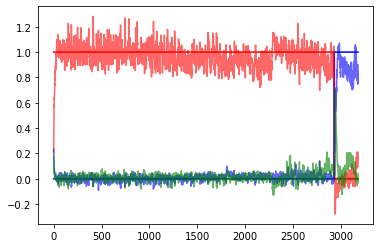

 46%|████████████████████████████████████████████████████████████████████████                                                                                   | 1394/3000 [6:35:04<6:44:52, 15.13s/it]

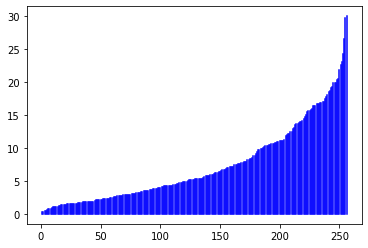

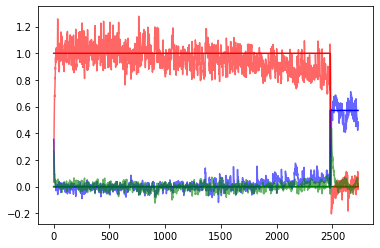

 47%|████████████████████████████████████████████████████████████████████████▎                                                                                  | 1399/3000 [6:36:22<6:44:54, 15.17s/it]

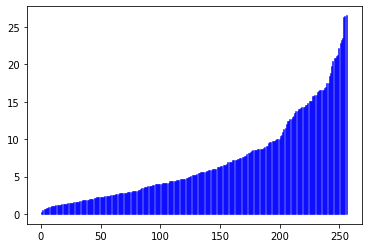

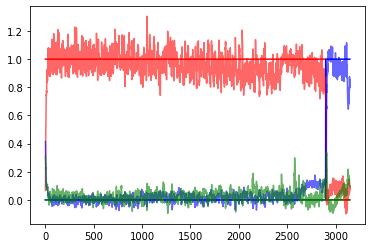

 47%|████████████████████████████████████████████████████████████████████████▌                                                                                  | 1404/3000 [6:38:20<8:14:54, 18.61s/it]

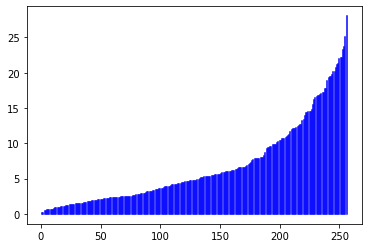

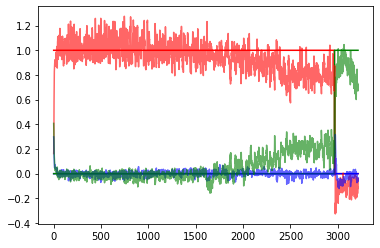

 47%|████████████████████████████████████████████████████████████████████████▊                                                                                  | 1409/3000 [6:39:40<7:03:18, 15.96s/it]

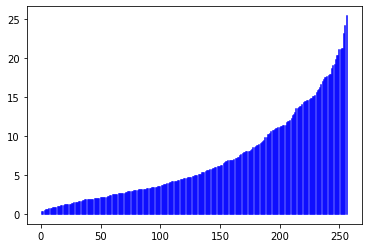

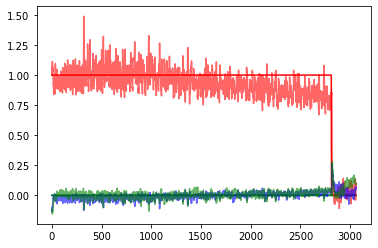

 47%|█████████████████████████████████████████████████████████████████████████                                                                                  | 1414/3000 [6:41:01<6:52:32, 15.61s/it]

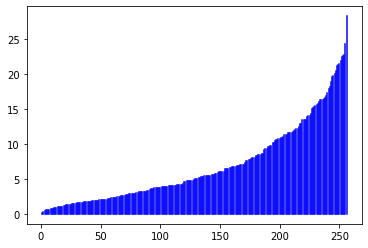

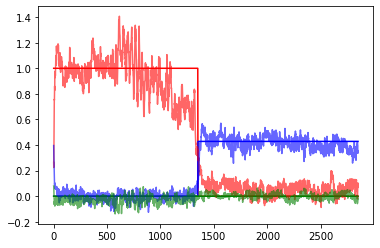

 47%|█████████████████████████████████████████████████████████████████████████▎                                                                                 | 1419/3000 [6:42:21<6:49:28, 15.54s/it]

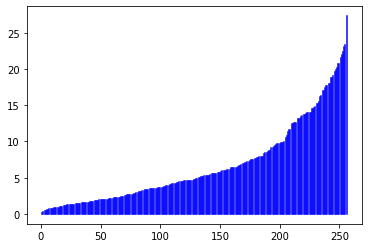

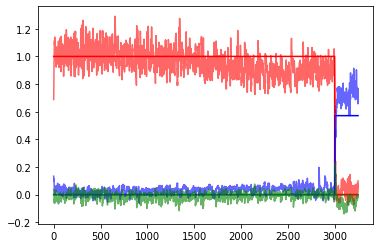

 47%|█████████████████████████████████████████████████████████████████████████▌                                                                                 | 1424/3000 [6:43:36<6:22:22, 14.56s/it]

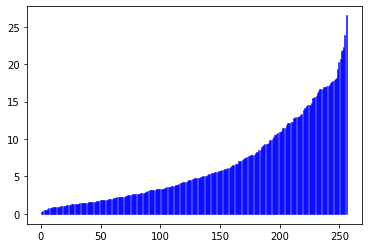

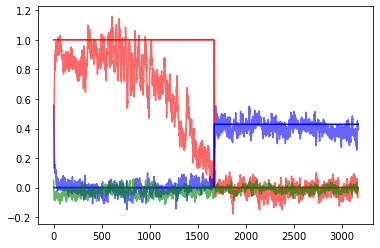

 48%|█████████████████████████████████████████████████████████████████████████▊                                                                                 | 1429/3000 [6:44:53<6:27:02, 14.78s/it]

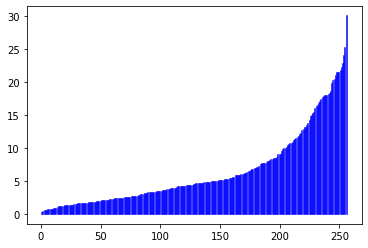

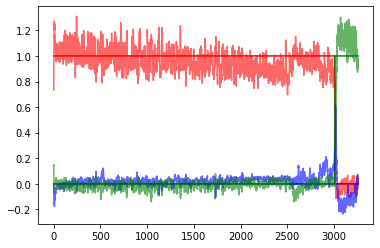

 48%|██████████████████████████████████████████████████████████████████████████                                                                                 | 1434/3000 [6:46:12<6:40:23, 15.34s/it]

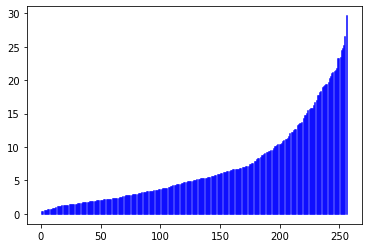

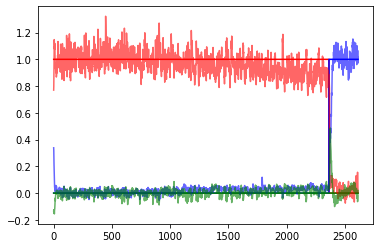

 48%|██████████████████████████████████████████████████████████████████████████▎                                                                                | 1439/3000 [6:47:30<6:38:08, 15.30s/it]

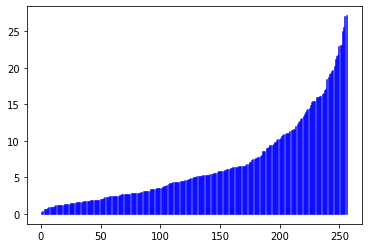

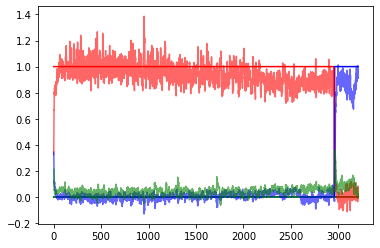

 48%|██████████████████████████████████████████████████████████████████████████▌                                                                                | 1444/3000 [6:48:49<6:38:25, 15.36s/it]

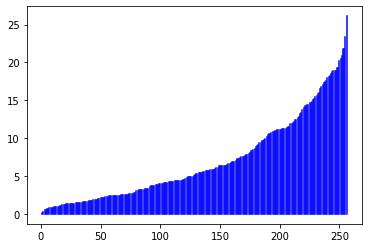

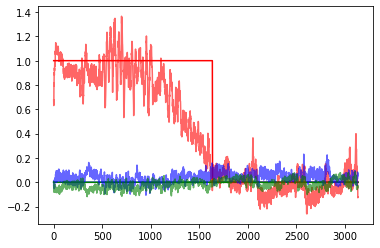

 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                | 1449/3000 [6:50:06<6:29:50, 15.08s/it]

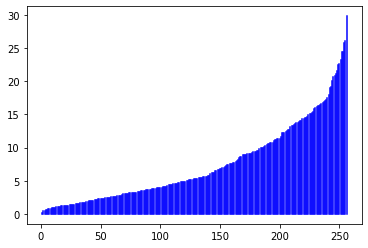

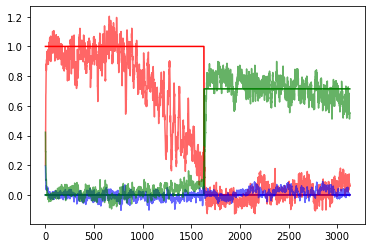

 48%|███████████████████████████████████████████████████████████████████████████                                                                                | 1454/3000 [6:52:04<7:51:22, 18.29s/it]

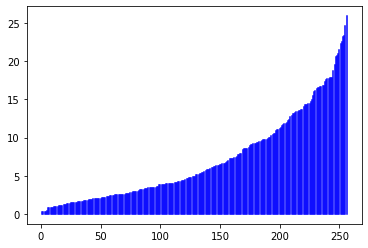

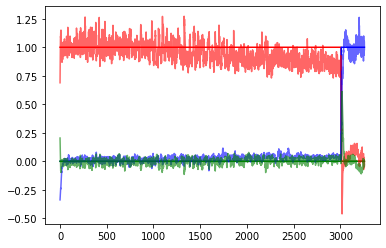

 49%|███████████████████████████████████████████████████████████████████████████▍                                                                               | 1459/3000 [6:53:26<6:54:21, 16.13s/it]

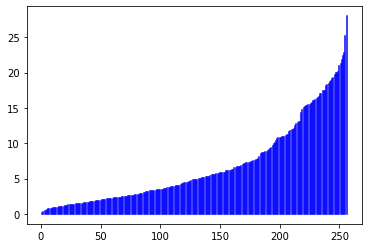

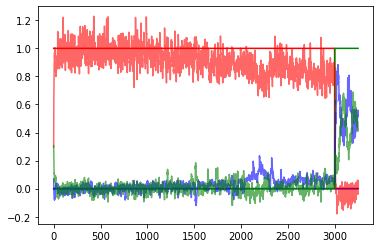

 49%|███████████████████████████████████████████████████████████████████████████▋                                                                               | 1464/3000 [6:54:47<6:52:07, 16.10s/it]

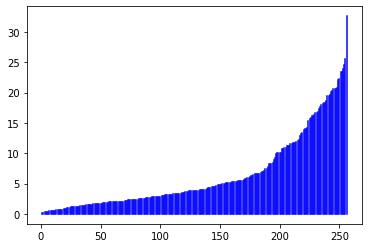

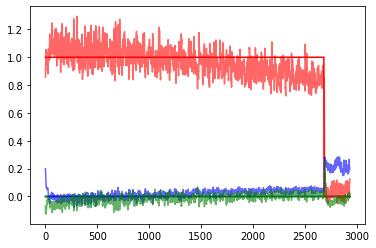

 49%|███████████████████████████████████████████████████████████████████████████▉                                                                               | 1469/3000 [6:56:03<6:15:26, 14.71s/it]

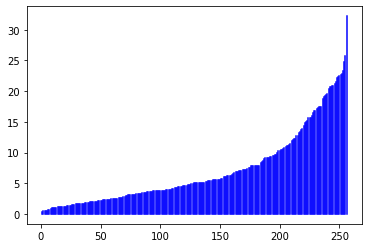

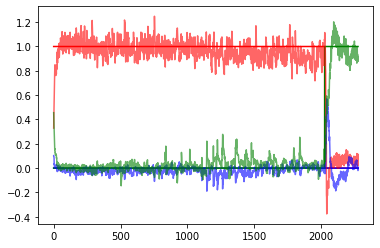

 49%|████████████████████████████████████████████████████████████████████████████▏                                                                              | 1474/3000 [6:57:19<6:22:16, 15.03s/it]

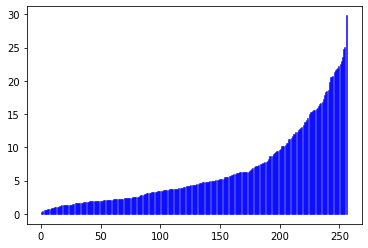

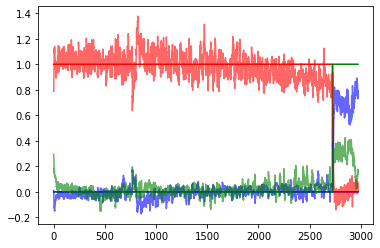

 49%|████████████████████████████████████████████████████████████████████████████▍                                                                              | 1479/3000 [6:58:43<6:45:55, 16.01s/it]

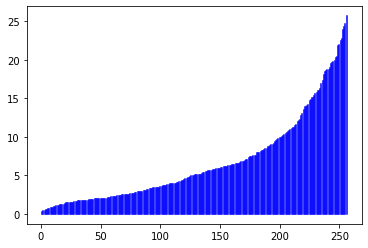

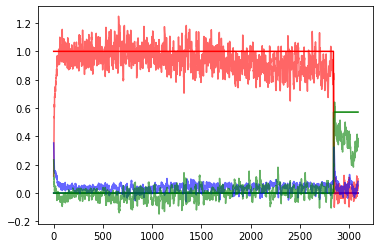

 49%|████████████████████████████████████████████████████████████████████████████▋                                                                              | 1484/3000 [7:00:02<6:30:41, 15.46s/it]

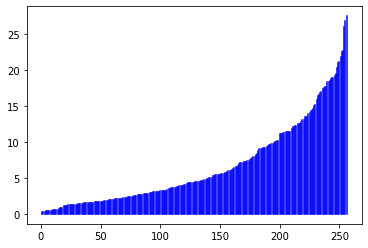

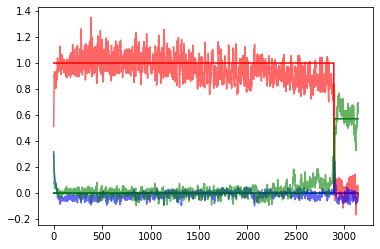

 50%|████████████████████████████████████████████████████████████████████████████▉                                                                              | 1489/3000 [7:01:23<6:32:39, 15.59s/it]

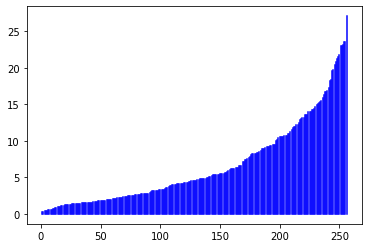

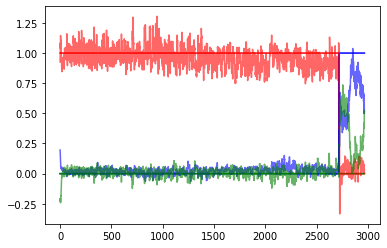

 50%|█████████████████████████████████████████████████████████████████████████████▏                                                                             | 1494/3000 [7:02:43<6:30:25, 15.55s/it]

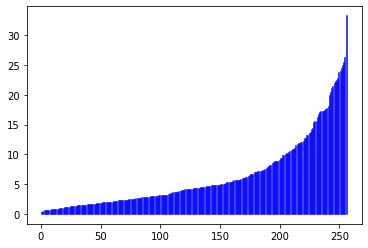

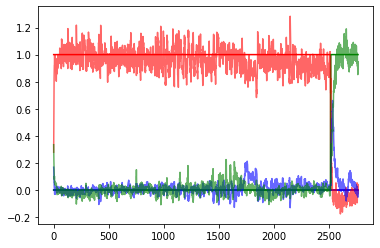

 50%|█████████████████████████████████████████████████████████████████████████████▍                                                                             | 1499/3000 [7:04:05<6:30:33, 15.61s/it]

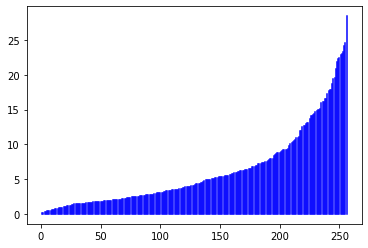

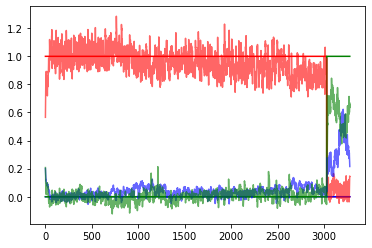

 50%|█████████████████████████████████████████████████████████████████████████████▋                                                                             | 1504/3000 [7:06:05<7:50:03, 18.85s/it]

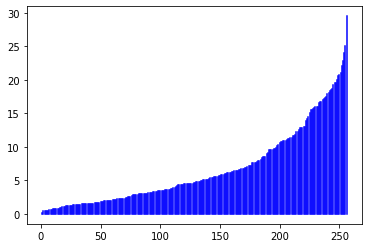

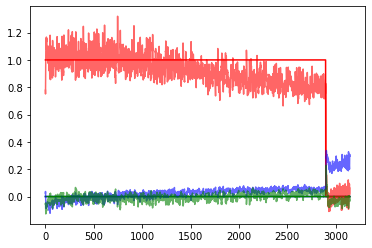

 50%|█████████████████████████████████████████████████████████████████████████████▉                                                                             | 1509/3000 [7:07:26<6:43:20, 16.23s/it]

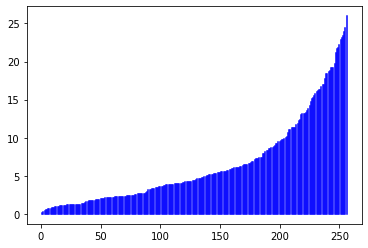

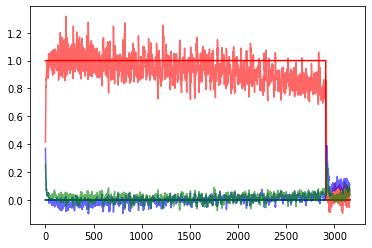

 50%|██████████████████████████████████████████████████████████████████████████████▏                                                                            | 1514/3000 [7:08:46<6:25:57, 15.58s/it]

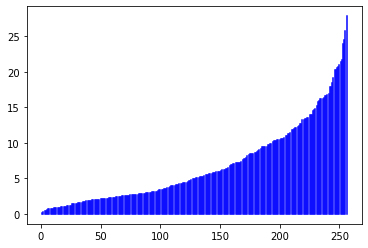

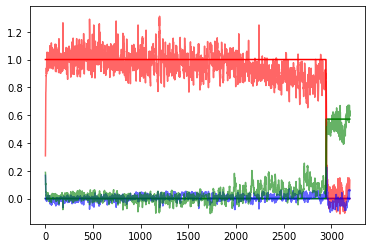

 51%|██████████████████████████████████████████████████████████████████████████████▍                                                                            | 1519/3000 [7:10:05<6:14:54, 15.19s/it]

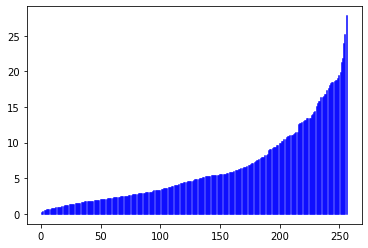

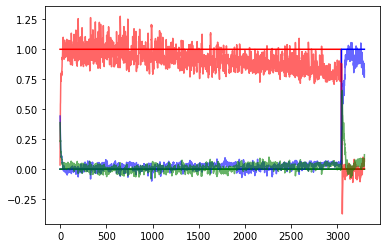

 51%|██████████████████████████████████████████████████████████████████████████████▋                                                                            | 1524/3000 [7:11:21<6:03:29, 14.78s/it]

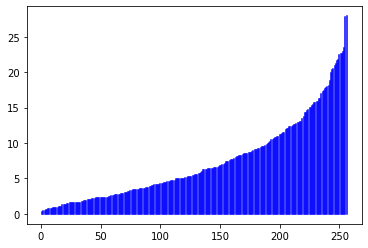

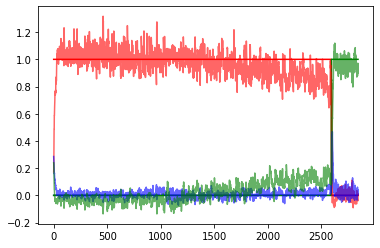

 51%|██████████████████████████████████████████████████████████████████████████████▉                                                                            | 1529/3000 [7:12:38<6:07:57, 15.01s/it]

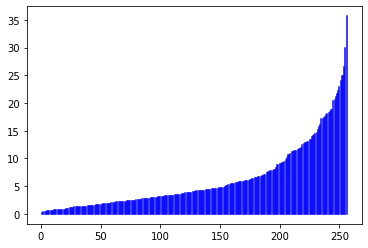

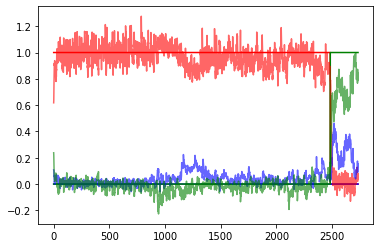

 51%|███████████████████████████████████████████████████████████████████████████████▎                                                                           | 1534/3000 [7:13:58<6:18:31, 15.49s/it]

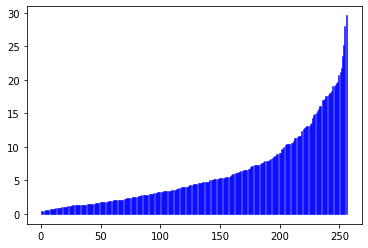

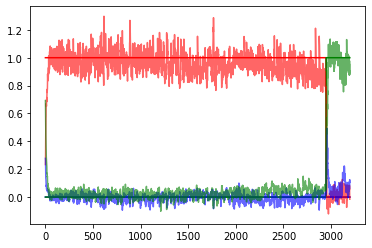

 51%|███████████████████████████████████████████████████████████████████████████████▌                                                                           | 1539/3000 [7:15:17<6:08:45, 15.14s/it]

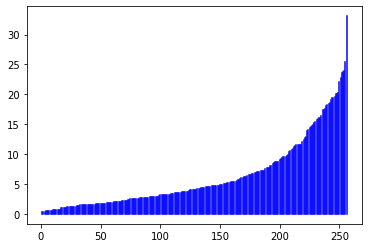

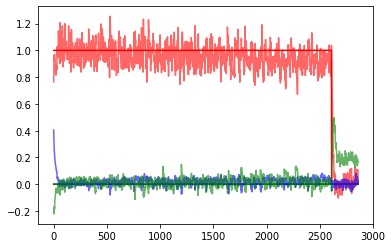

 51%|███████████████████████████████████████████████████████████████████████████████▊                                                                           | 1544/3000 [7:16:39<6:23:49, 15.82s/it]

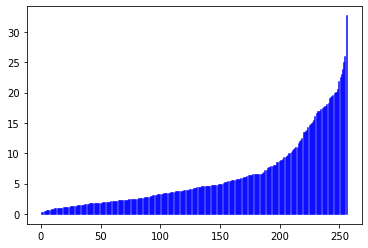

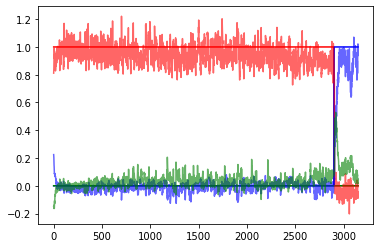

 52%|████████████████████████████████████████████████████████████████████████████████                                                                           | 1549/3000 [7:18:02<6:31:17, 16.18s/it]

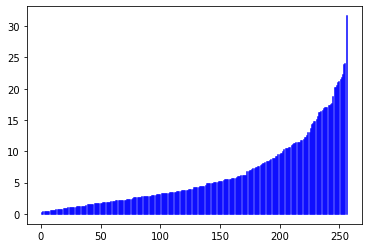

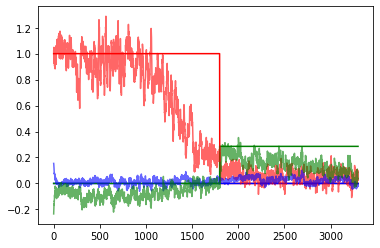

 52%|████████████████████████████████████████████████████████████████████████████████▎                                                                          | 1554/3000 [7:20:05<7:38:10, 19.01s/it]

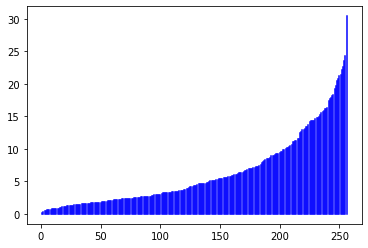

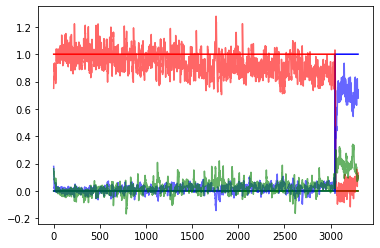

 52%|████████████████████████████████████████████████████████████████████████████████▌                                                                          | 1559/3000 [7:21:21<6:15:40, 15.64s/it]

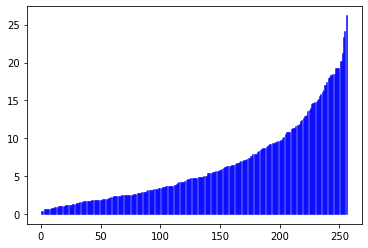

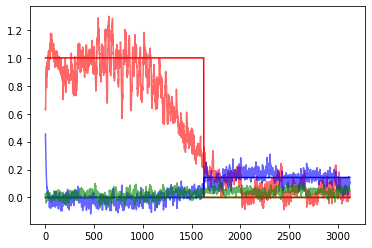

 52%|████████████████████████████████████████████████████████████████████████████████▊                                                                          | 1564/3000 [7:22:39<6:03:40, 15.20s/it]

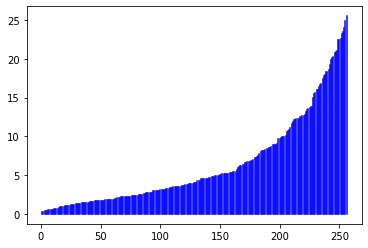

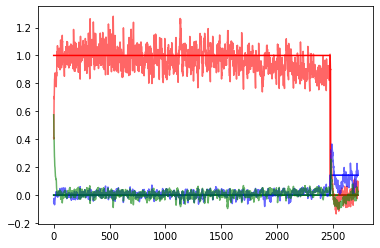

 52%|█████████████████████████████████████████████████████████████████████████████████                                                                          | 1569/3000 [7:23:58<6:07:44, 15.42s/it]

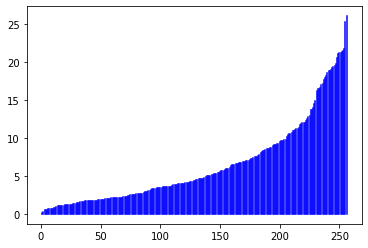

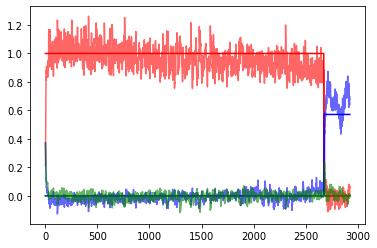

 52%|█████████████████████████████████████████████████████████████████████████████████▎                                                                         | 1574/3000 [7:25:17<6:01:12, 15.20s/it]

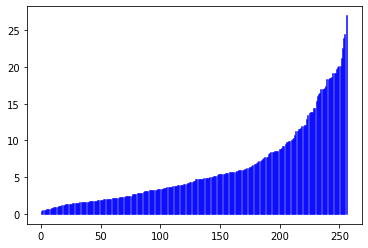

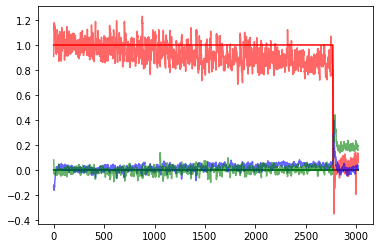

 53%|█████████████████████████████████████████████████████████████████████████████████▌                                                                         | 1579/3000 [7:26:36<6:02:25, 15.30s/it]

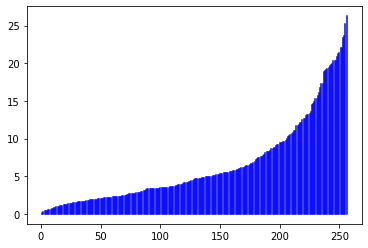

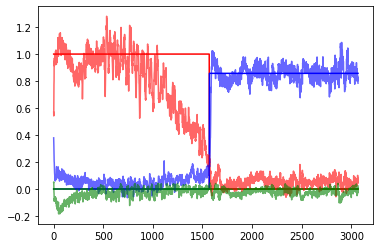

 53%|█████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1584/3000 [7:27:58<6:07:47, 15.58s/it]

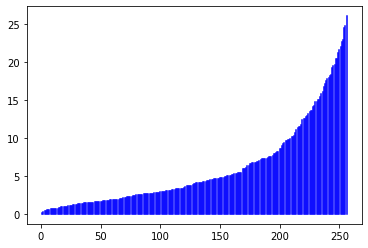

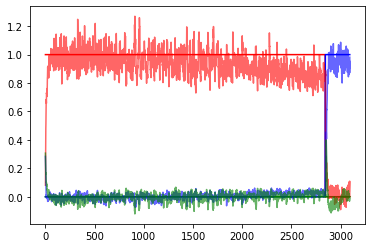

 53%|██████████████████████████████████████████████████████████████████████████████████                                                                         | 1589/3000 [7:29:20<6:12:05, 15.82s/it]

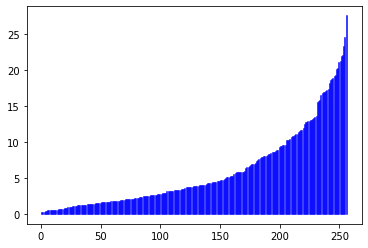

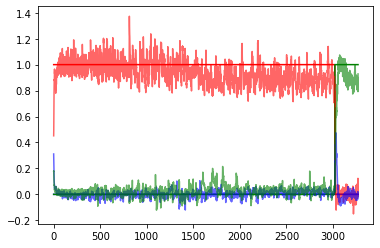

 53%|██████████████████████████████████████████████████████████████████████████████████▎                                                                        | 1594/3000 [7:30:40<6:04:19, 15.55s/it]

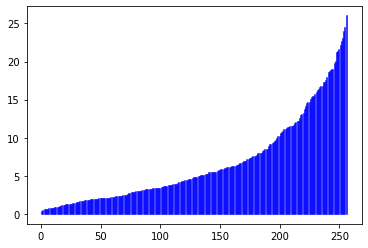

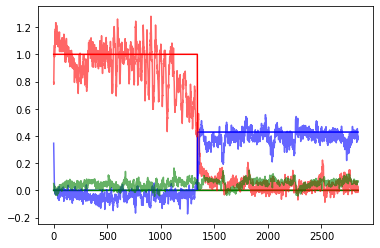

 53%|██████████████████████████████████████████████████████████████████████████████████▌                                                                        | 1599/3000 [7:32:01<6:02:35, 15.53s/it]

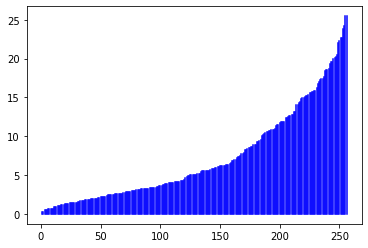

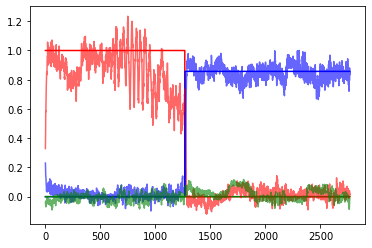

 53%|██████████████████████████████████████████████████████████████████████████████████▊                                                                        | 1604/3000 [7:33:58<7:08:05, 18.40s/it]

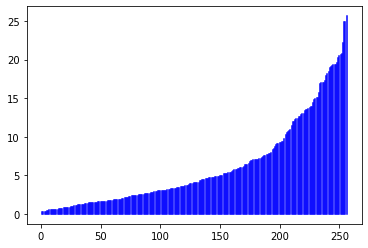

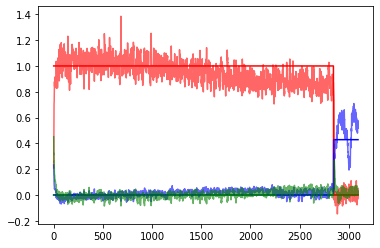

 54%|███████████████████████████████████████████████████████████████████████████████████▏                                                                       | 1609/3000 [7:35:24<6:32:25, 16.93s/it]

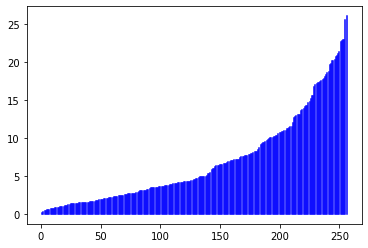

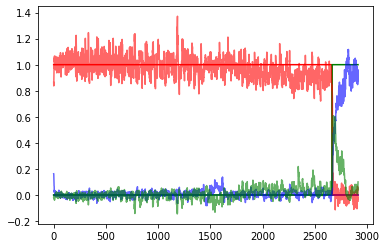

 54%|███████████████████████████████████████████████████████████████████████████████████▍                                                                       | 1614/3000 [7:36:42<5:54:56, 15.37s/it]

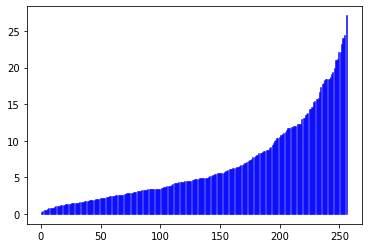

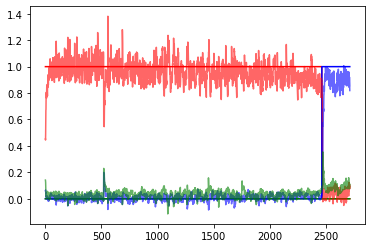

 54%|███████████████████████████████████████████████████████████████████████████████████▋                                                                       | 1619/3000 [7:38:02<5:55:22, 15.44s/it]

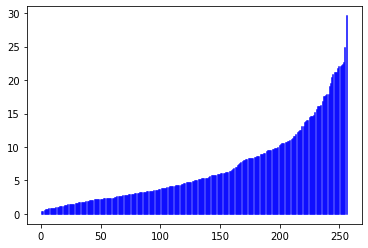

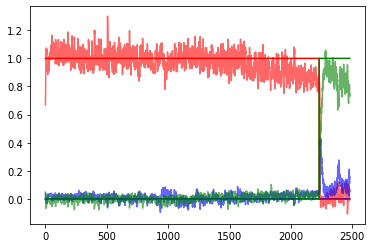

 54%|███████████████████████████████████████████████████████████████████████████████████▉                                                                       | 1624/3000 [7:39:19<5:49:32, 15.24s/it]

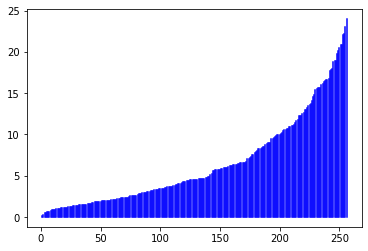

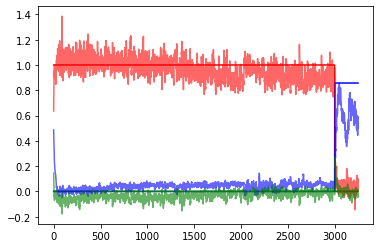

 54%|████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 1629/3000 [7:40:38<5:44:10, 15.06s/it]

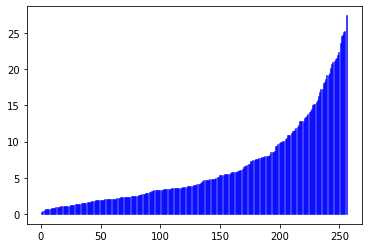

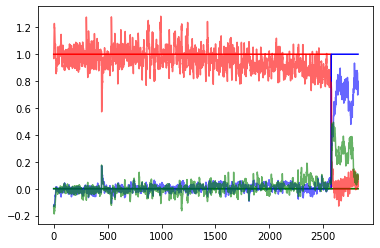

 54%|████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1634/3000 [7:41:57<5:51:01, 15.42s/it]

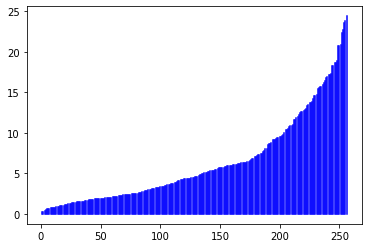

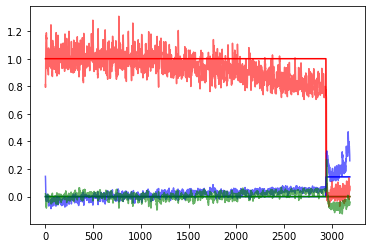

 55%|████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 1639/3000 [7:43:13<5:33:32, 14.70s/it]

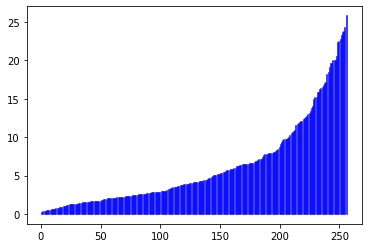

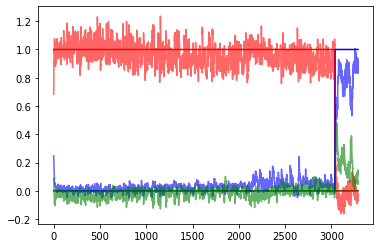

 55%|████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 1644/3000 [7:44:35<6:00:00, 15.93s/it]

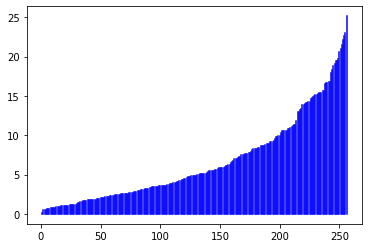

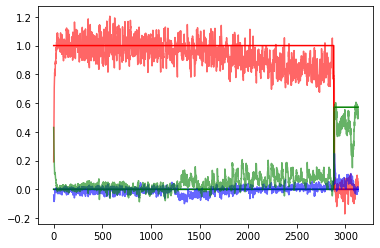

 55%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1649/3000 [7:45:54<5:45:51, 15.36s/it]

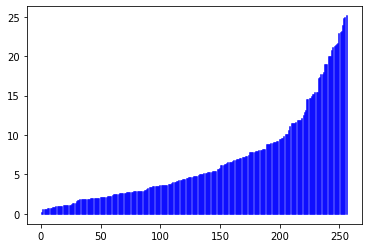

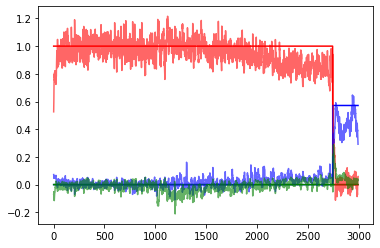

 55%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 1654/3000 [7:47:45<6:29:18, 17.35s/it]

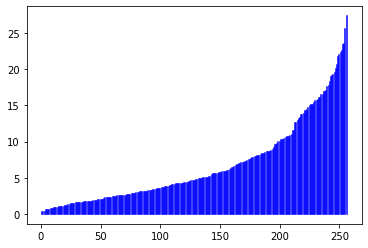

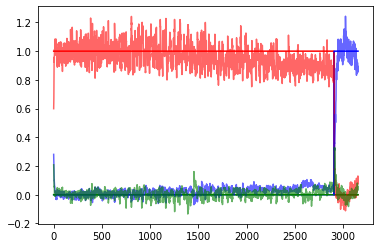

 55%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 1659/3000 [7:49:02<5:42:01, 15.30s/it]

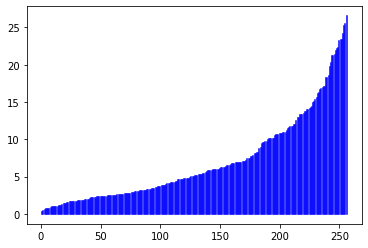

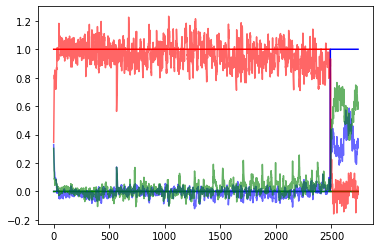

 55%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 1664/3000 [7:50:21<5:40:36, 15.30s/it]

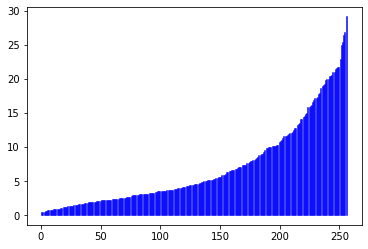

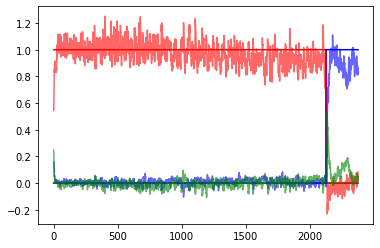

 56%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 1669/3000 [7:51:37<5:27:38, 14.77s/it]

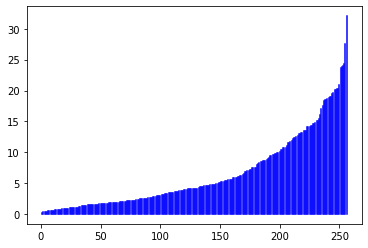

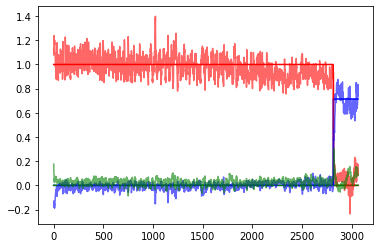

 56%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 1674/3000 [7:52:56<5:41:27, 15.45s/it]

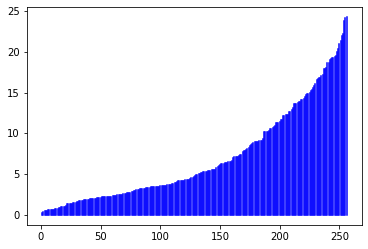

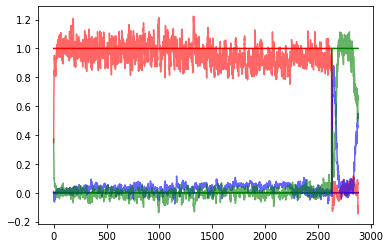

 56%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 1679/3000 [7:54:16<5:40:37, 15.47s/it]

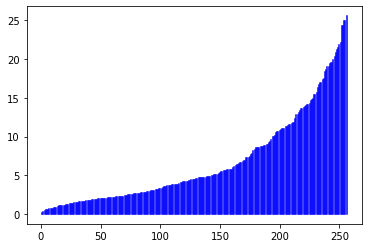

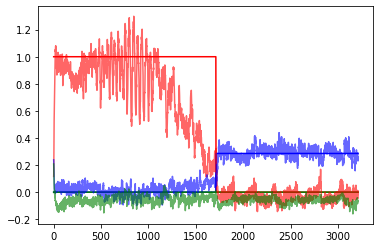

 56%|███████████████████████████████████████████████████████████████████████████████████████                                                                    | 1684/3000 [7:55:35<5:38:53, 15.45s/it]

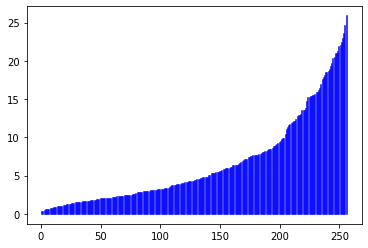

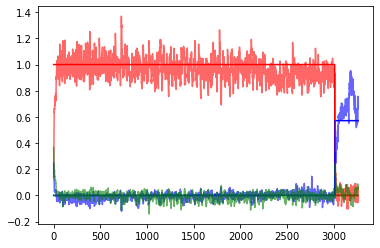

 56%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 1689/3000 [7:56:57<5:44:46, 15.78s/it]

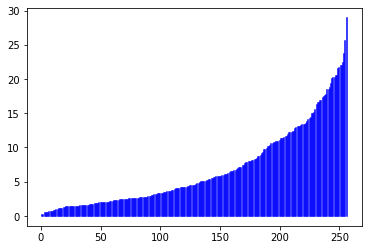

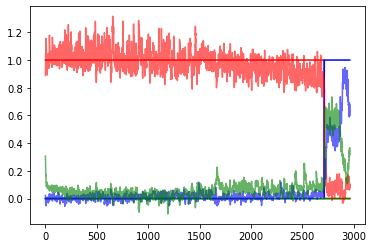

 56%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 1694/3000 [7:58:15<5:34:10, 15.35s/it]

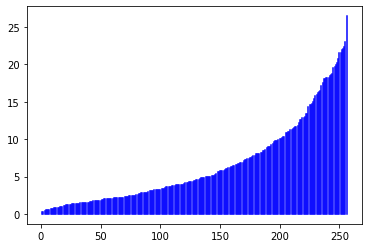

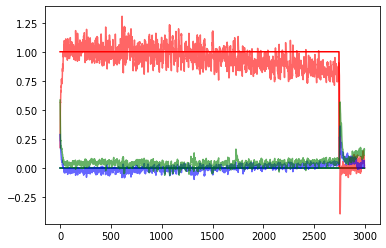

 57%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1699/3000 [7:59:32<5:21:58, 14.85s/it]

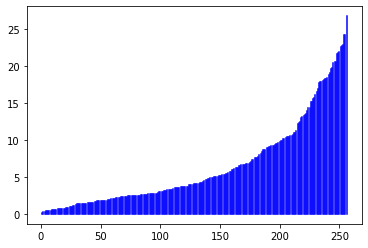

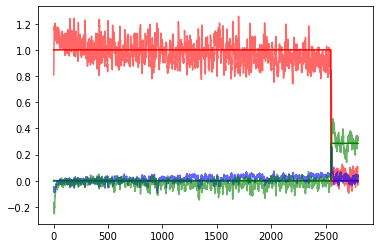

 57%|████████████████████████████████████████████████████████████████████████████████████████                                                                   | 1704/3000 [8:01:28<6:23:06, 17.74s/it]

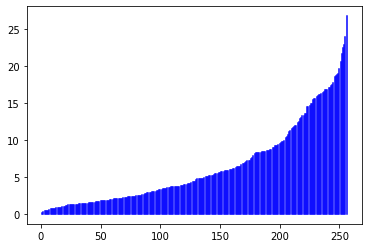

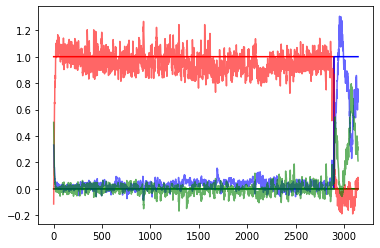

 57%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 1709/3000 [8:02:45<5:28:17, 15.26s/it]

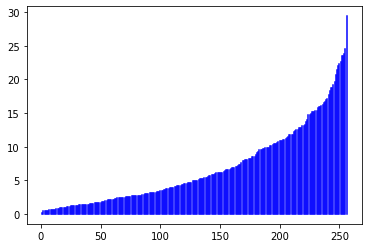

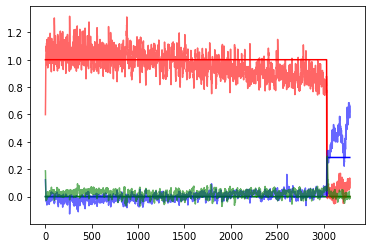

 57%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 1714/3000 [8:04:00<5:08:40, 14.40s/it]

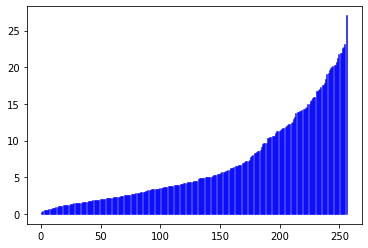

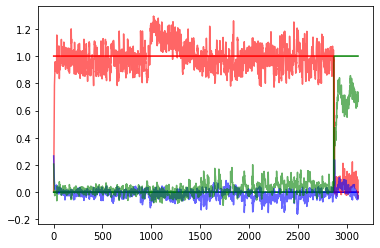

 57%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 1719/3000 [8:05:19<5:27:22, 15.33s/it]

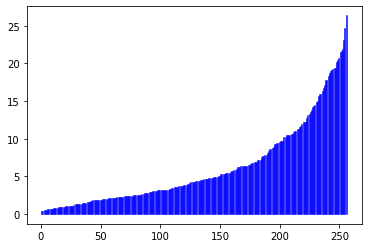

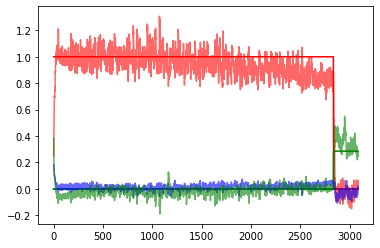

 57%|█████████████████████████████████████████████████████████████████████████████████████████                                                                  | 1724/3000 [8:06:36<5:14:28, 14.79s/it]

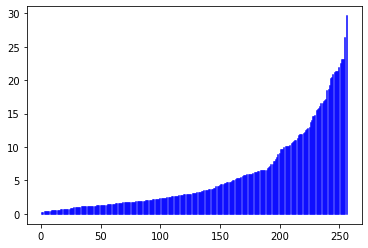

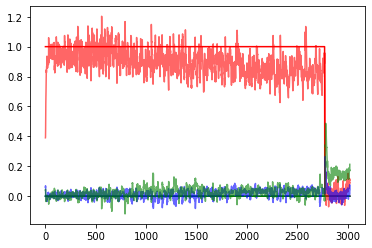

 58%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1729/3000 [8:07:54<5:15:38, 14.90s/it]

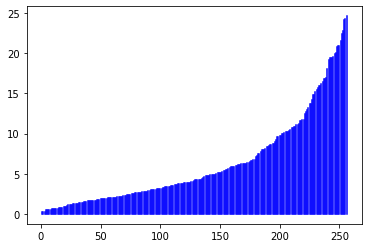

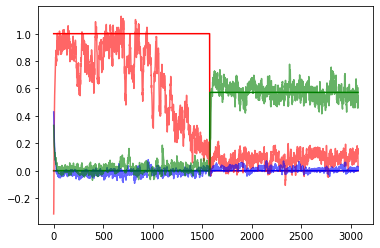

 58%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1734/3000 [8:09:13<5:23:15, 15.32s/it]

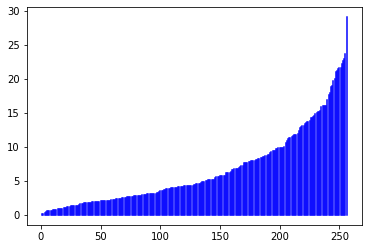

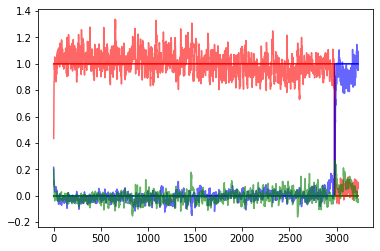

 58%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1739/3000 [8:10:31<5:21:50, 15.31s/it]

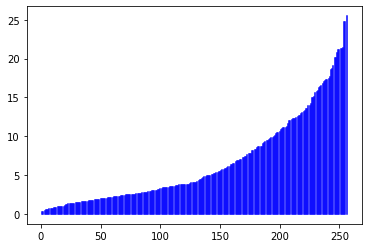

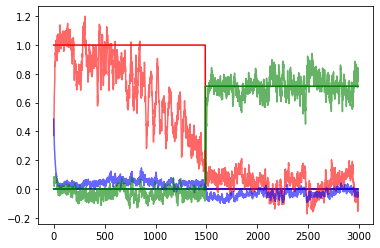

 58%|██████████████████████████████████████████████████████████████████████████████████████████                                                                 | 1744/3000 [8:11:48<5:16:37, 15.13s/it]

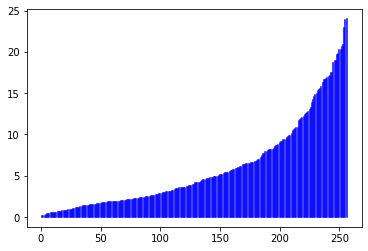

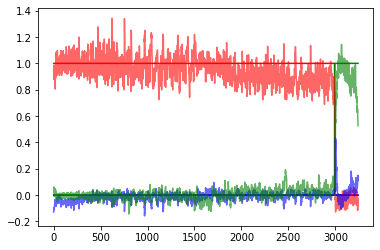

 58%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1749/3000 [8:13:08<5:24:23, 15.56s/it]

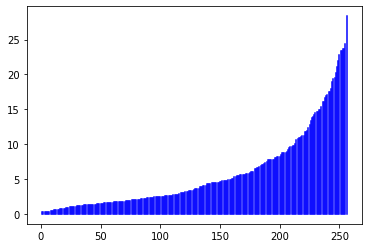

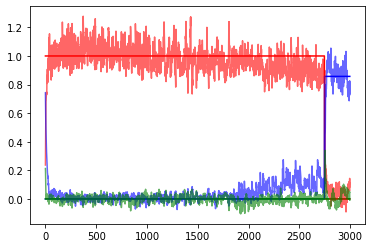

 58%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 1754/3000 [8:15:02<6:14:13, 18.02s/it]

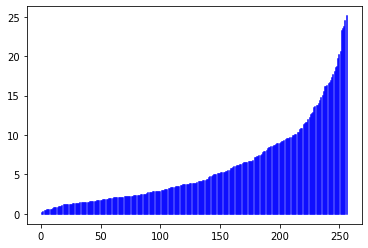

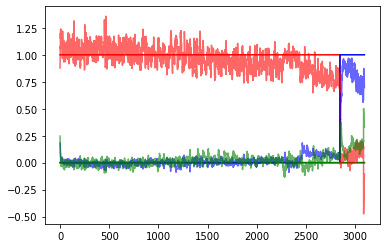

 59%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 1759/3000 [8:16:18<5:08:22, 14.91s/it]

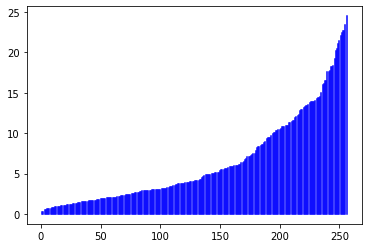

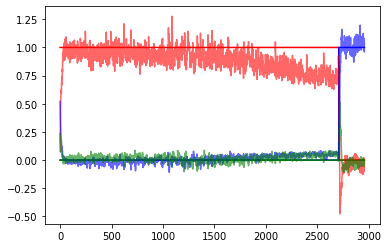

 59%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1764/3000 [8:17:34<5:03:51, 14.75s/it]

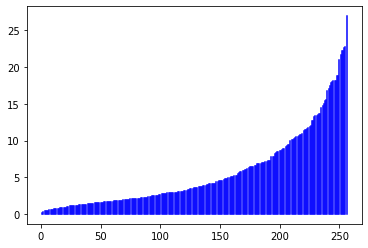

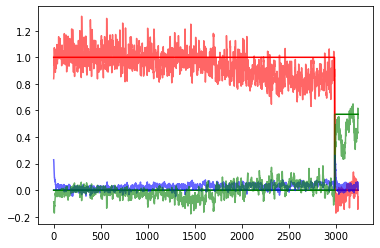

 59%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 1769/3000 [8:18:52<5:10:11, 15.12s/it]

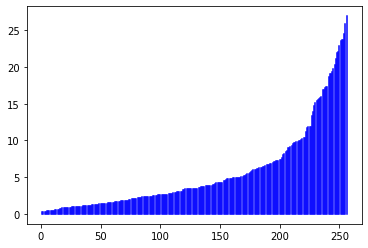

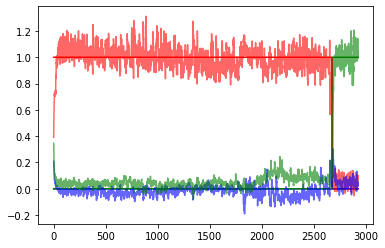

 59%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 1774/3000 [8:20:11<5:10:08, 15.18s/it]

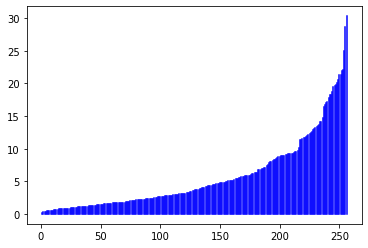

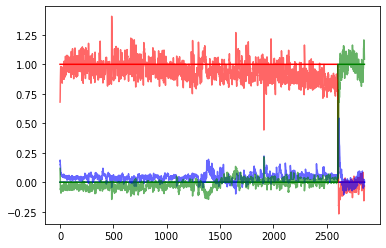

 59%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 1779/3000 [8:21:28<5:06:42, 15.07s/it]

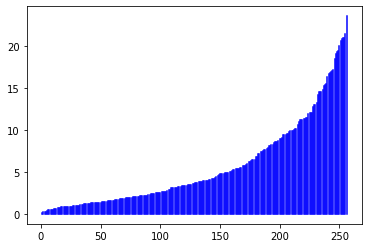

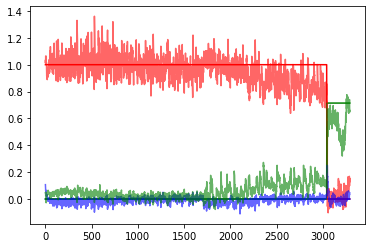

 59%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 1784/3000 [8:22:48<5:08:13, 15.21s/it]

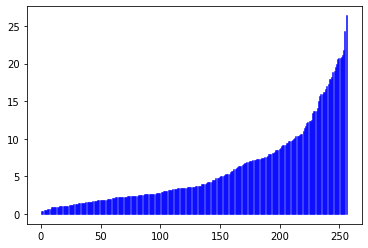

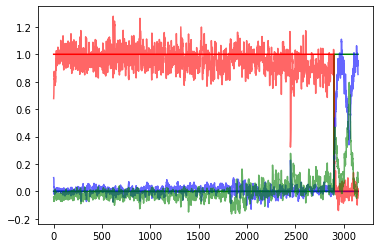

 60%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 1789/3000 [8:24:09<5:16:18, 15.67s/it]

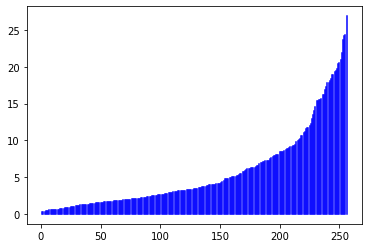

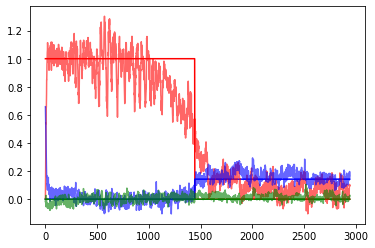

 60%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 1794/3000 [8:25:30<5:14:37, 15.65s/it]

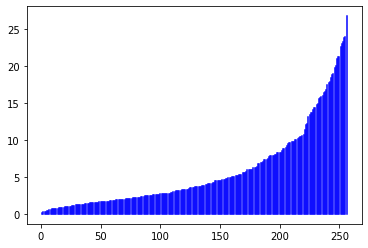

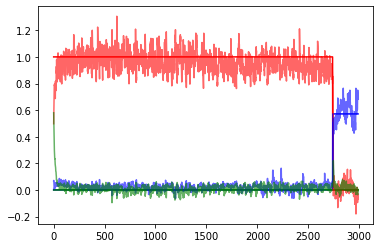

 60%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1799/3000 [8:26:51<5:13:36, 15.67s/it]

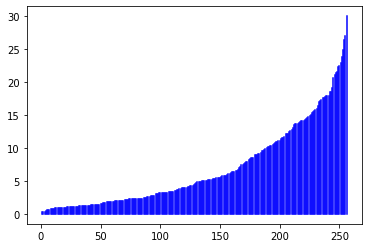

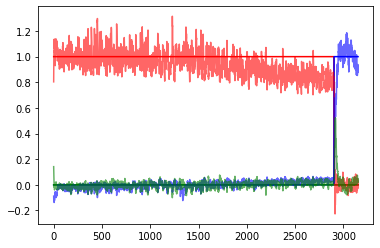

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 1804/3000 [8:28:46<5:56:12, 17.87s/it]

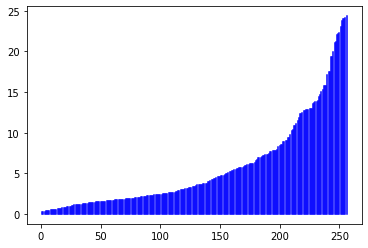

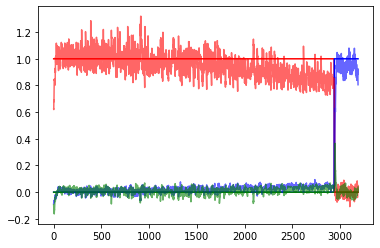

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1809/3000 [8:30:07<5:17:40, 16.00s/it]

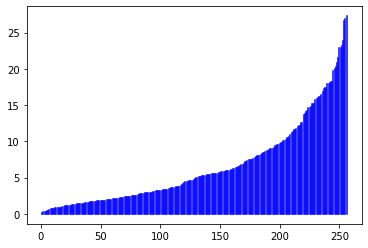

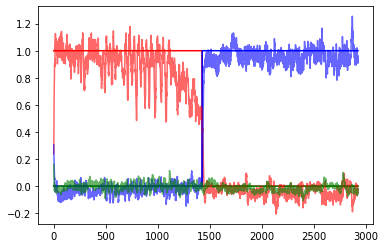

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 1814/3000 [8:31:28<5:10:37, 15.71s/it]

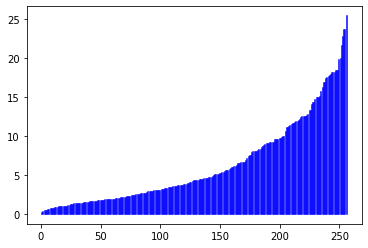

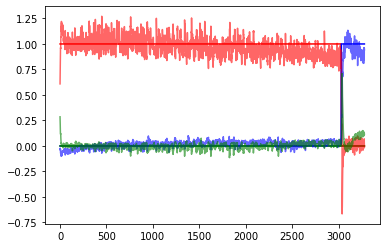

 61%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 1819/3000 [8:32:50<5:07:09, 15.60s/it]

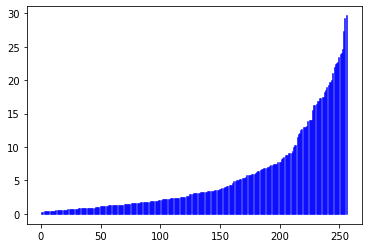

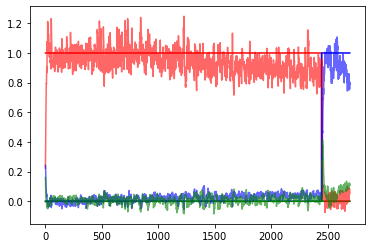

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 1824/3000 [8:34:06<4:51:57, 14.90s/it]

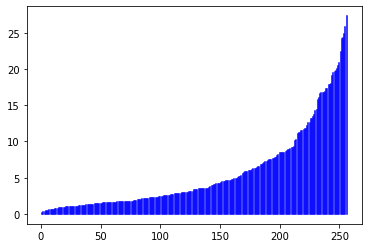

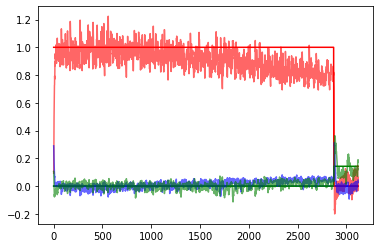

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 1829/3000 [8:35:24<4:55:48, 15.16s/it]

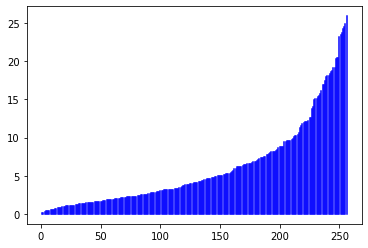

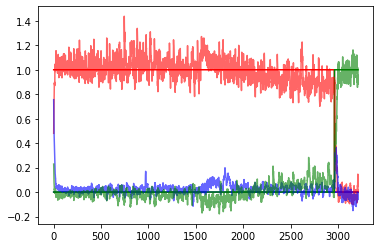

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 1834/3000 [8:36:48<5:16:04, 16.26s/it]

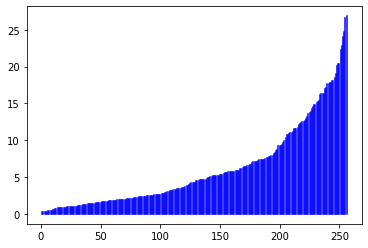

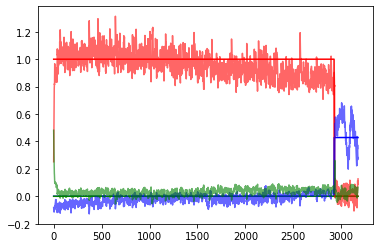

 61%|███████████████████████████████████████████████████████████████████████████████████████████████                                                            | 1839/3000 [8:38:07<5:02:16, 15.62s/it]

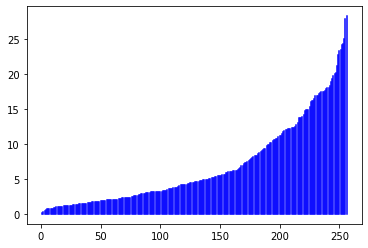

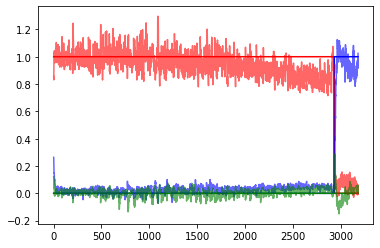

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 1844/3000 [8:39:30<5:06:09, 15.89s/it]

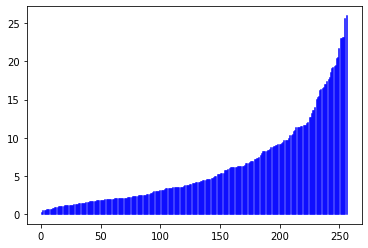

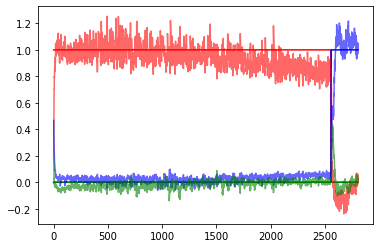

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1849/3000 [8:40:49<4:52:34, 15.25s/it]

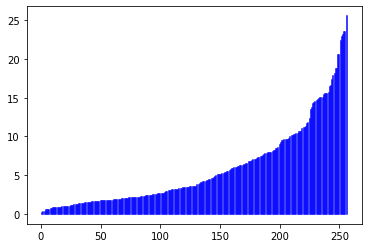

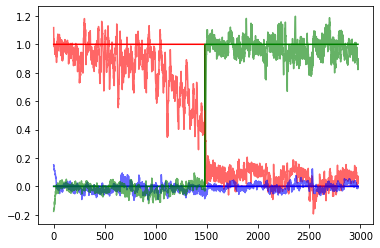

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 1854/3000 [8:42:43<5:37:27, 17.67s/it]

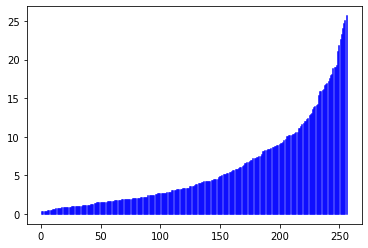

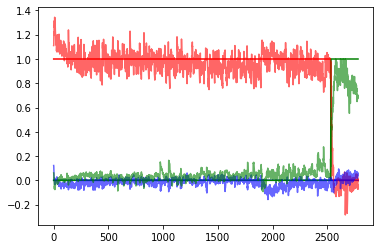

 62%|████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 1859/3000 [8:44:02<4:59:25, 15.75s/it]

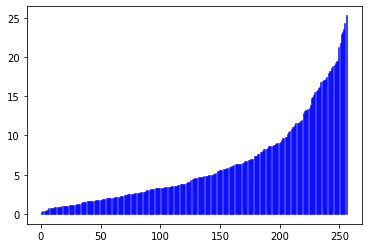

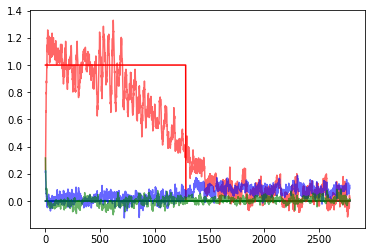

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1864/3000 [8:45:19<4:44:56, 15.05s/it]

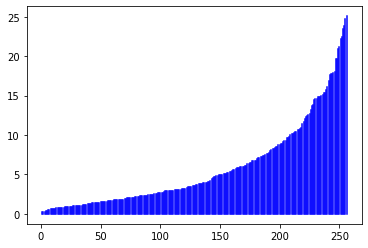

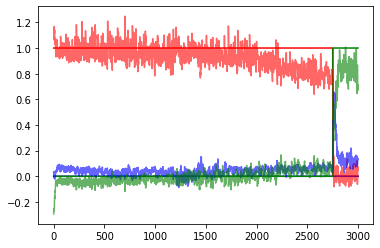

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1869/3000 [8:46:38<4:51:13, 15.45s/it]

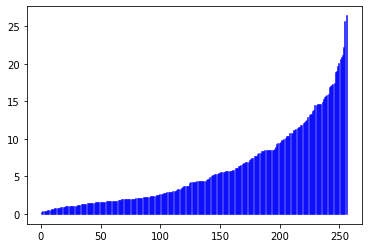

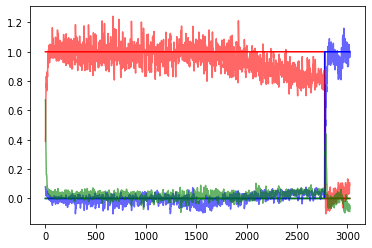

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 1874/3000 [8:48:00<4:55:55, 15.77s/it]

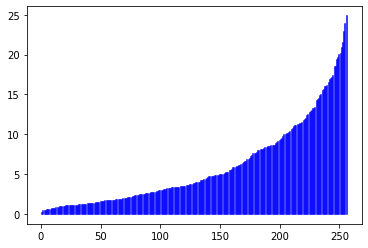

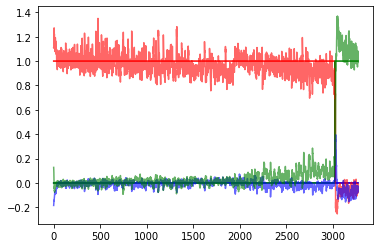

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 1879/3000 [8:49:20<4:52:16, 15.64s/it]

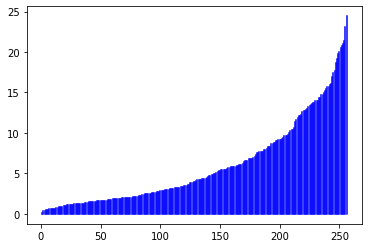

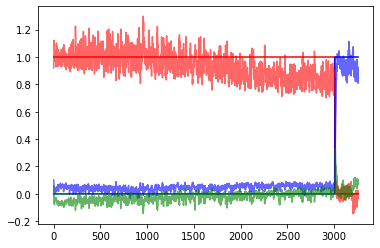

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 1884/3000 [8:50:43<4:54:40, 15.84s/it]

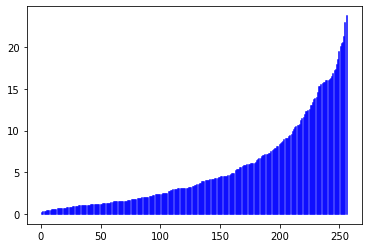

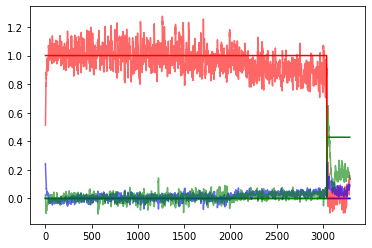

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 1889/3000 [8:52:00<4:41:52, 15.22s/it]

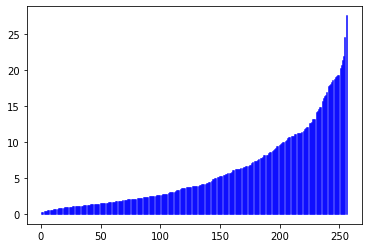

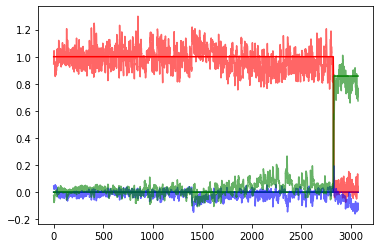

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1894/3000 [8:53:18<4:38:35, 15.11s/it]

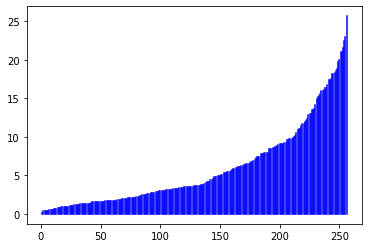

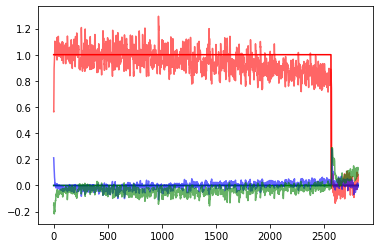

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1899/3000 [8:54:34<4:30:56, 14.77s/it]

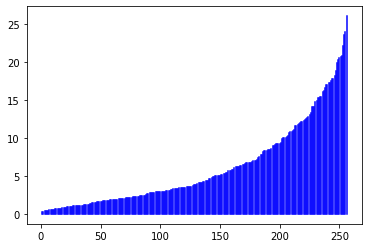

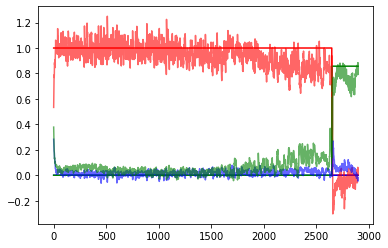

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 1904/3000 [8:56:33<5:31:57, 18.17s/it]

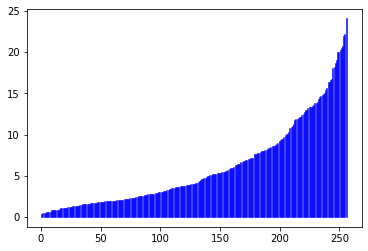

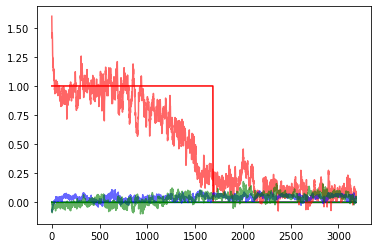

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1909/3000 [8:57:53<4:48:21, 15.86s/it]

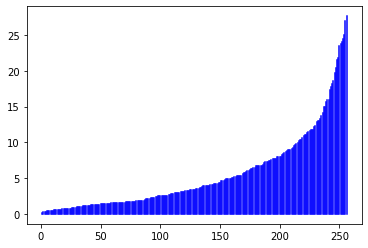

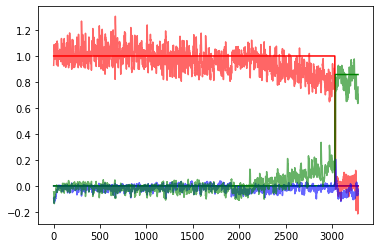

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1914/3000 [8:59:09<4:29:34, 14.89s/it]

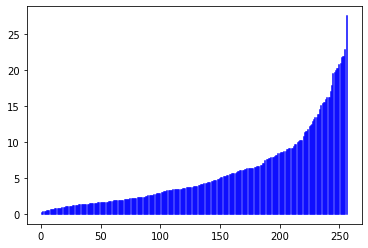

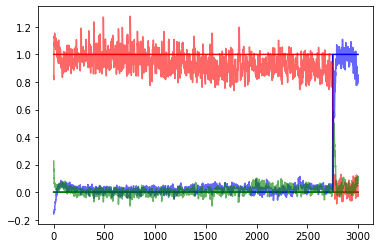

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1919/3000 [9:00:26<4:31:27, 15.07s/it]

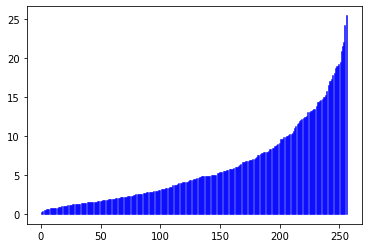

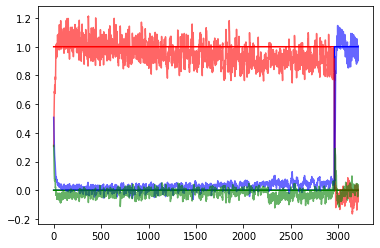

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 1924/3000 [9:01:47<4:41:05, 15.67s/it]

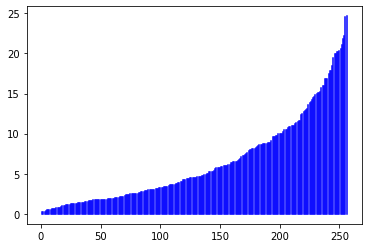

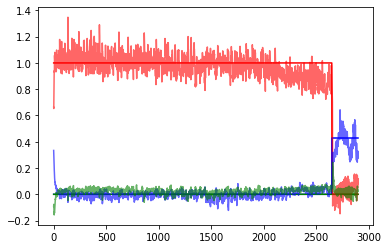

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1929/3000 [9:03:09<4:42:41, 15.84s/it]

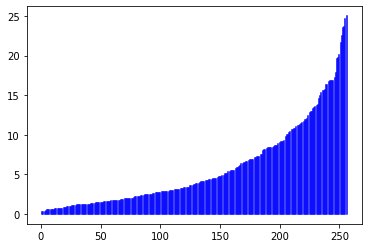

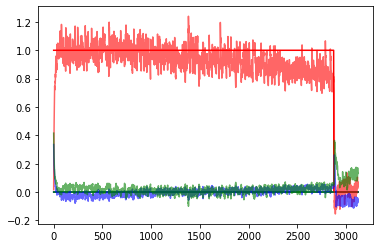

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 1934/3000 [9:04:29<4:36:47, 15.58s/it]

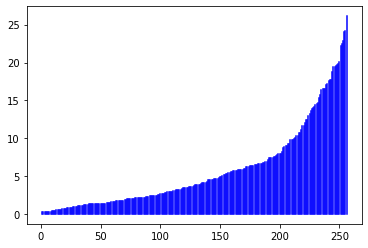

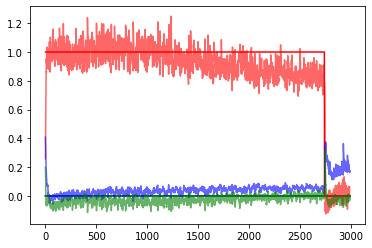

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 1939/3000 [9:05:48<4:32:08, 15.39s/it]

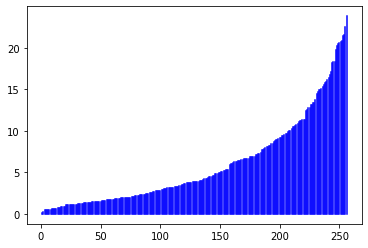

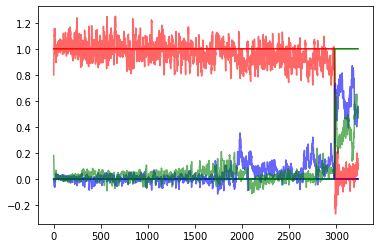

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 1944/3000 [9:07:07<4:24:46, 15.04s/it]

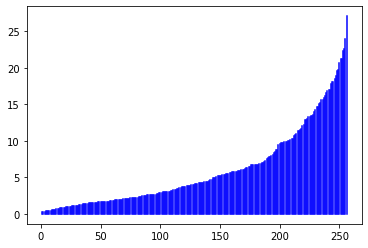

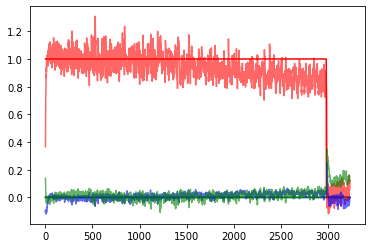

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 1949/3000 [9:08:26<4:27:35, 15.28s/it]

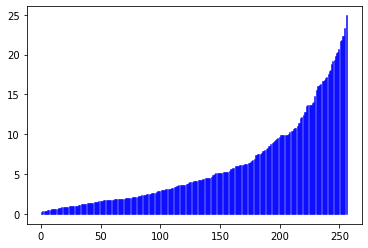

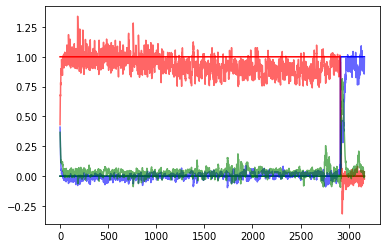

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 1954/3000 [9:10:24<5:15:52, 18.12s/it]

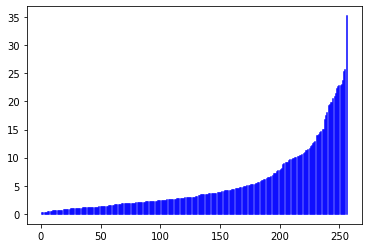

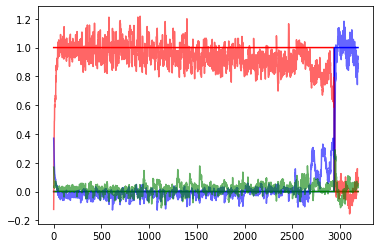

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 1959/3000 [9:11:44<4:36:47, 15.95s/it]

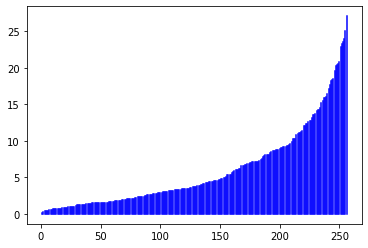

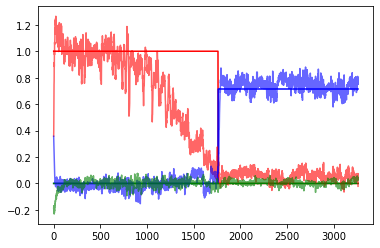

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1964/3000 [9:13:02<4:21:37, 15.15s/it]

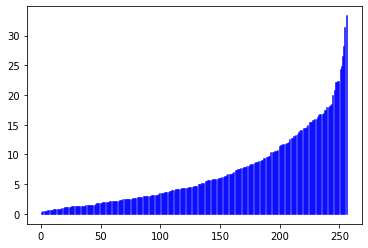

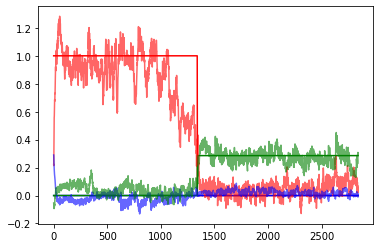

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 1969/3000 [9:14:22<4:26:29, 15.51s/it]

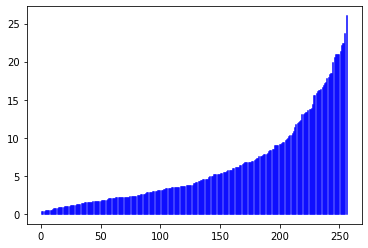

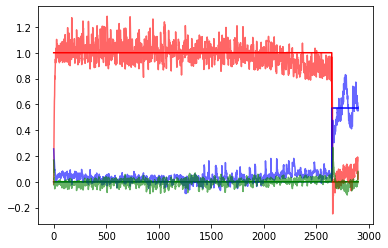

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 1974/3000 [9:15:37<4:08:32, 14.54s/it]

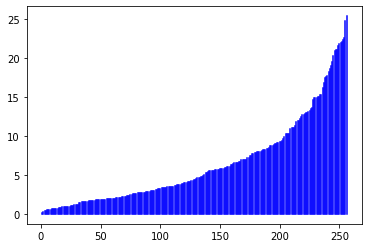

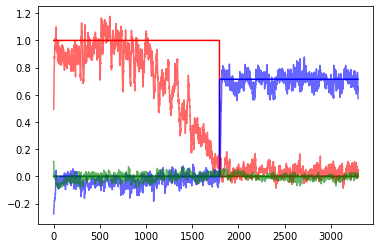

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 1979/3000 [9:16:56<4:18:13, 15.17s/it]

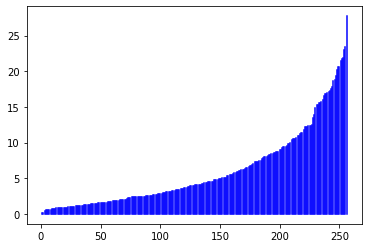

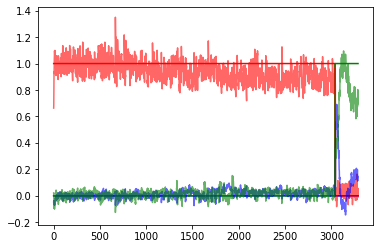

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 1984/3000 [9:18:16<4:16:03, 15.12s/it]

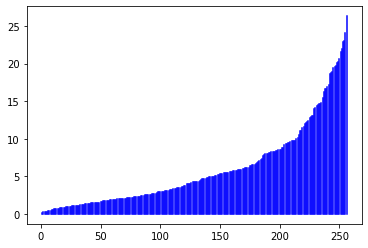

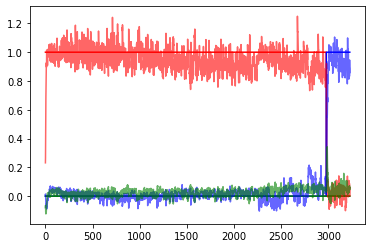

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 1989/3000 [9:19:33<4:15:45, 15.18s/it]

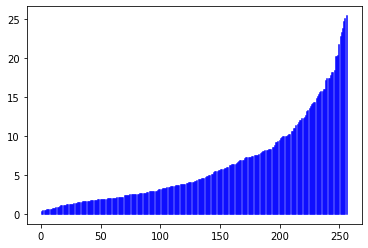

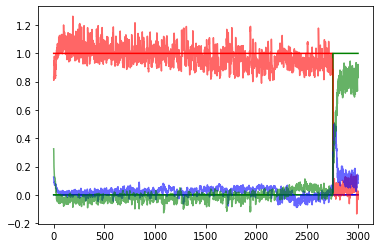

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 1994/3000 [9:20:53<4:16:41, 15.31s/it]

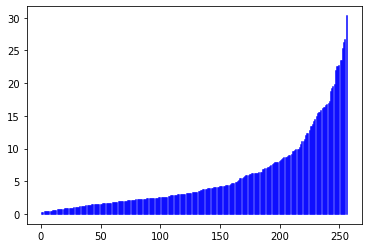

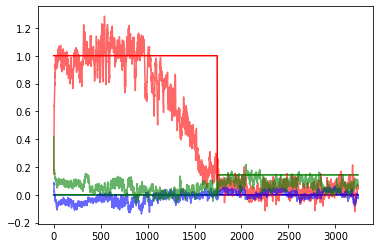

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 1999/3000 [9:22:15<4:20:05, 15.59s/it]

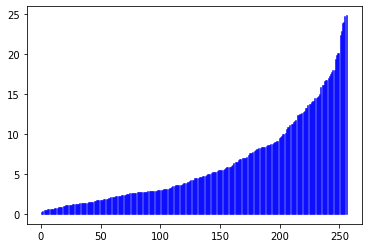

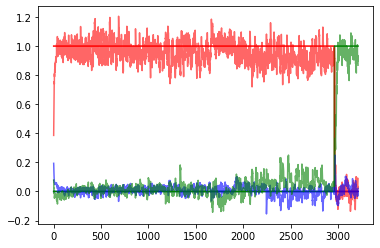

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2004/3000 [9:24:13<5:06:25, 18.46s/it]

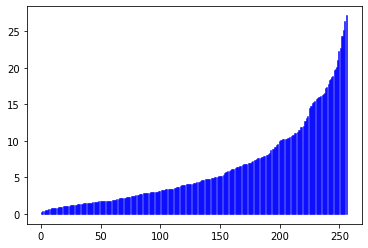

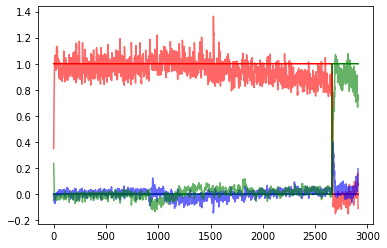

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 2009/3000 [9:25:31<4:16:56, 15.56s/it]

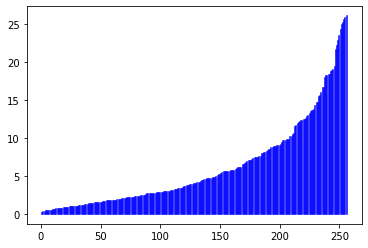

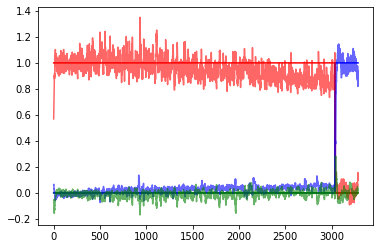

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2014/3000 [9:26:52<4:19:14, 15.78s/it]

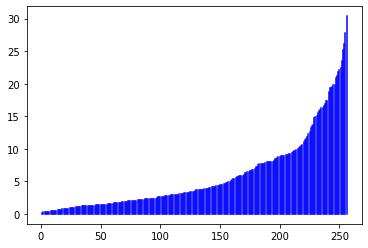

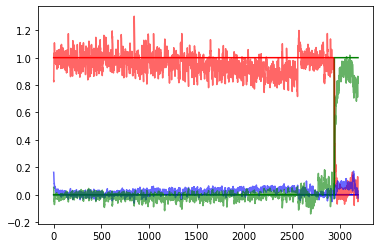

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 2019/3000 [9:28:12<4:11:41, 15.39s/it]

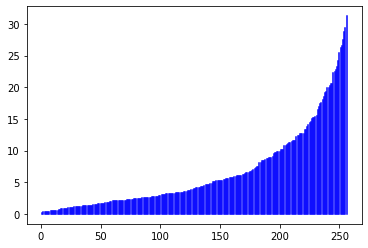

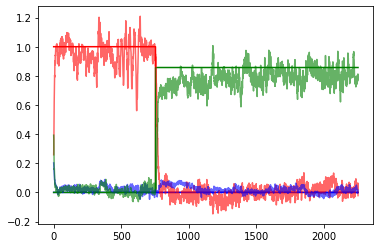

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2024/3000 [9:29:29<4:01:47, 14.86s/it]

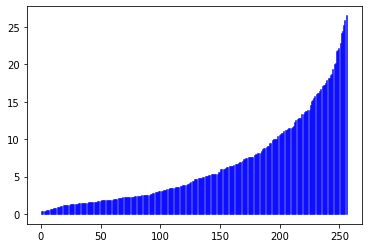

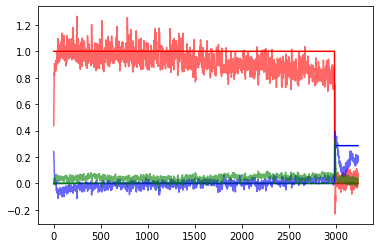

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2029/3000 [9:30:49<4:07:26, 15.29s/it]

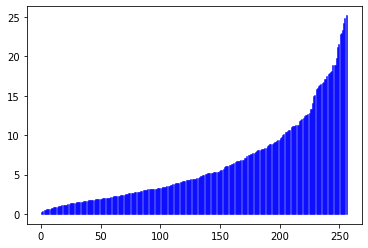

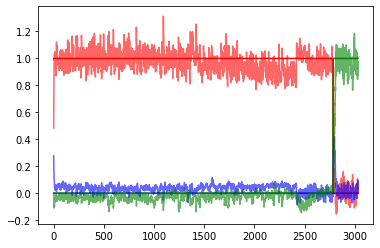

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 2034/3000 [9:32:08<4:04:07, 15.16s/it]

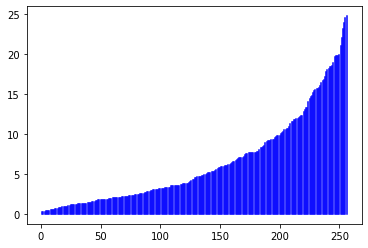

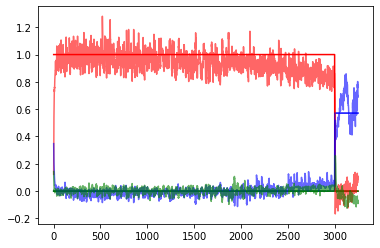

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 2039/3000 [9:33:24<3:52:45, 14.53s/it]

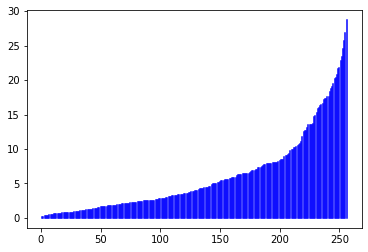

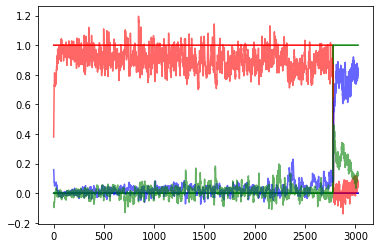

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 2044/3000 [9:34:44<4:10:35, 15.73s/it]

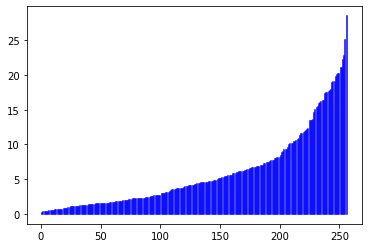

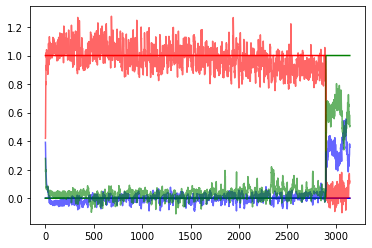

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 2049/3000 [9:36:09<4:11:36, 15.87s/it]

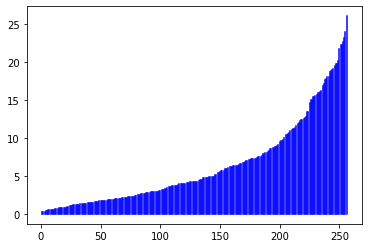

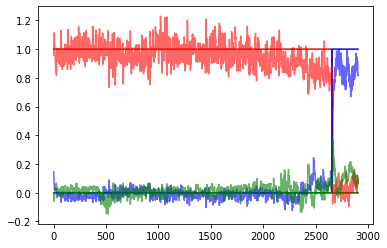

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2054/3000 [9:38:03<4:41:41, 17.87s/it]

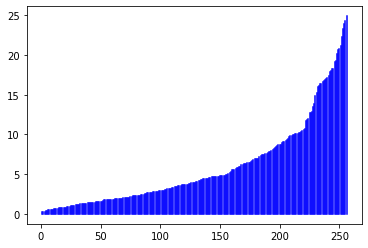

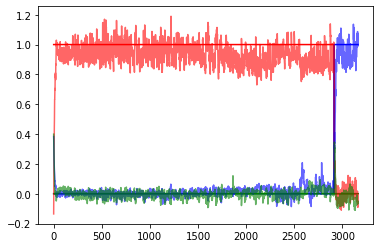

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 2059/3000 [9:39:20<4:04:17, 15.58s/it]

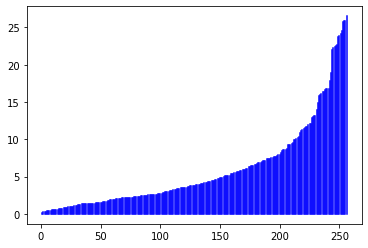

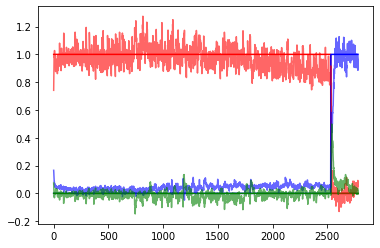

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2064/3000 [9:40:40<4:02:21, 15.54s/it]

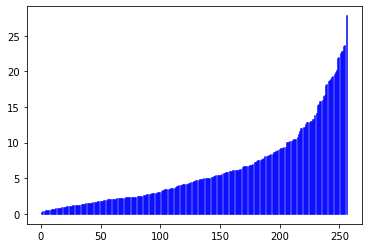

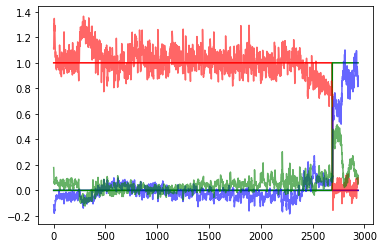

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 2069/3000 [9:41:59<3:57:12, 15.29s/it]

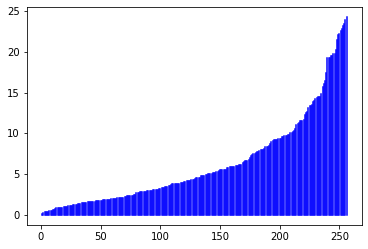

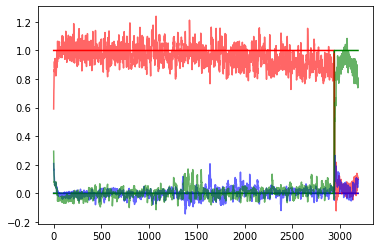

 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2074/3000 [9:43:19<3:55:31, 15.26s/it]

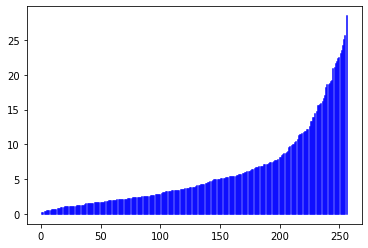

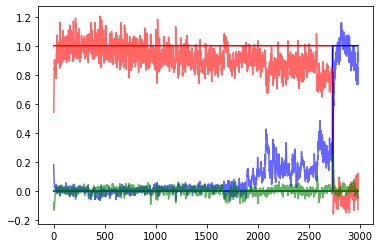

 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2079/3000 [9:44:36<3:50:10, 15.00s/it]

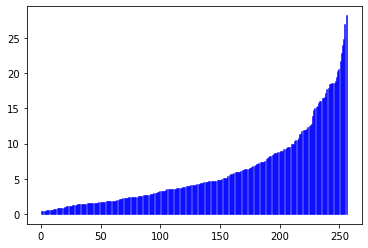

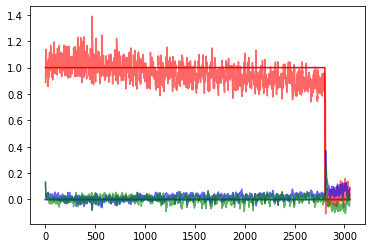

 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2084/3000 [9:45:56<3:55:35, 15.43s/it]

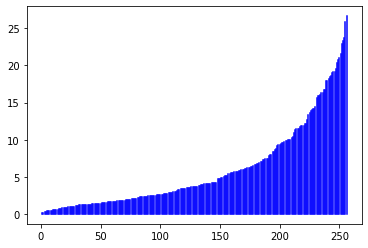

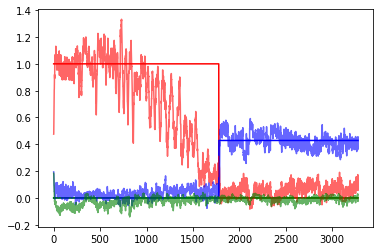

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2089/3000 [9:47:22<4:13:30, 16.70s/it]

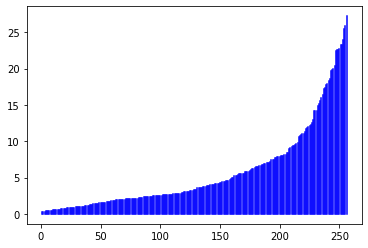

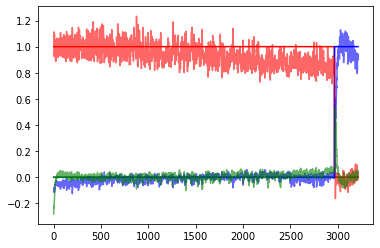

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 2094/3000 [9:48:44<4:02:27, 16.06s/it]

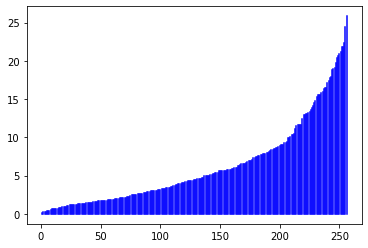

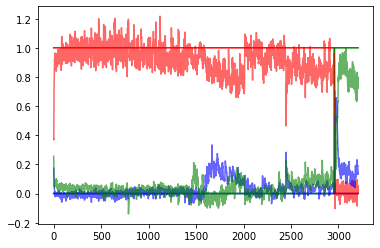

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2099/3000 [9:50:04<3:54:56, 15.64s/it]

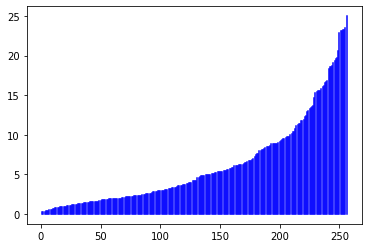

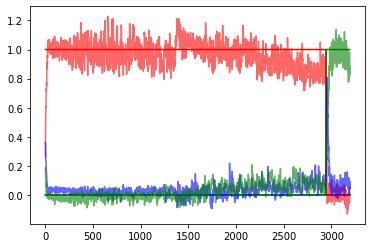

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 2104/3000 [9:51:57<4:24:16, 17.70s/it]

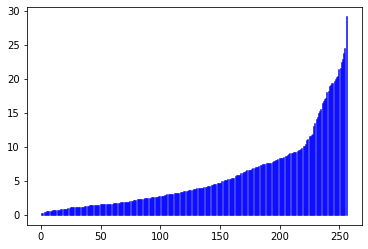

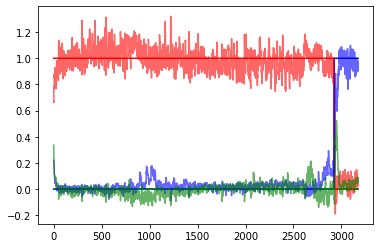

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 2109/3000 [9:53:18<3:55:24, 15.85s/it]

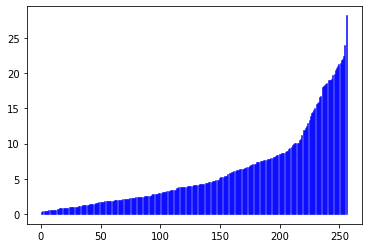

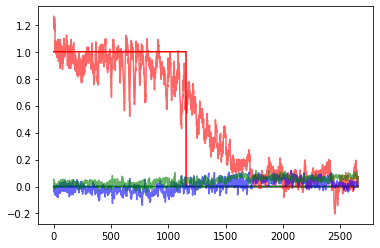

 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2114/3000 [9:54:33<3:35:14, 14.58s/it]

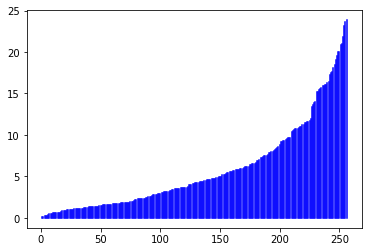

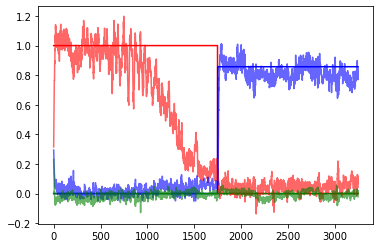

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 2119/3000 [9:55:48<3:34:20, 14.60s/it]

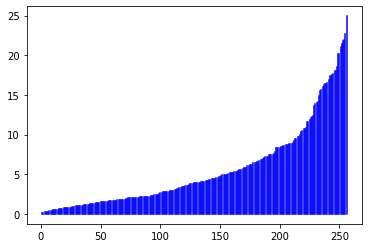

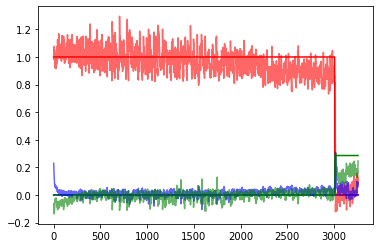

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 2124/3000 [9:57:02<3:29:51, 14.37s/it]

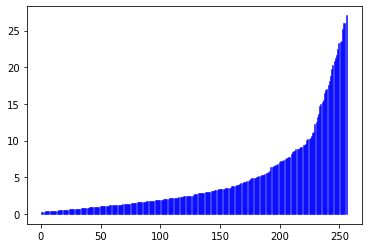

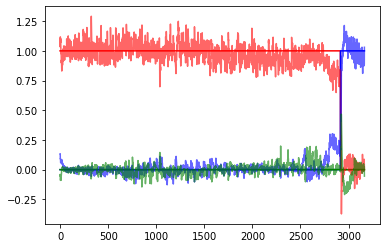

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2129/3000 [9:58:21<3:38:00, 15.02s/it]

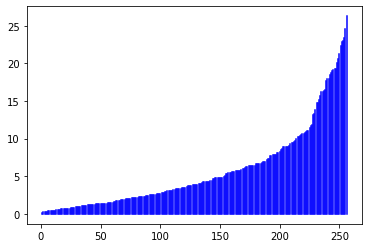

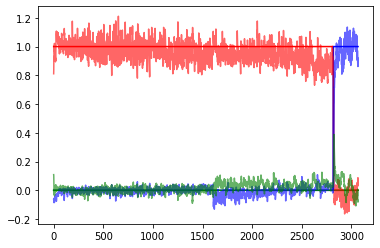

 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 2134/3000 [9:59:39<3:40:00, 15.24s/it]

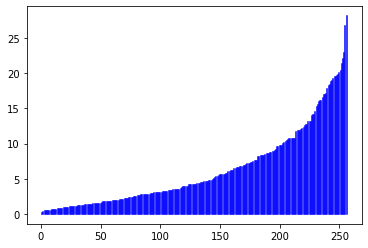

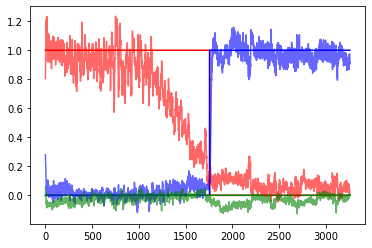

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2139/3000 [10:01:01<3:46:23, 15.78s/it]

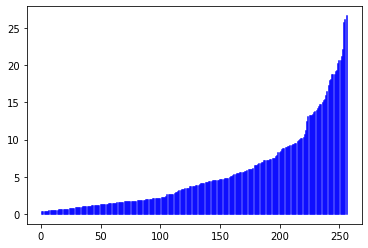

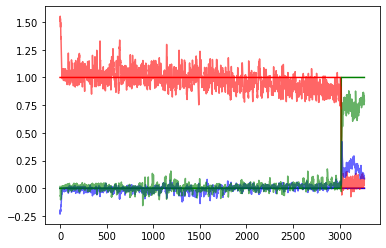

 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2144/3000 [10:02:25<3:49:32, 16.09s/it]

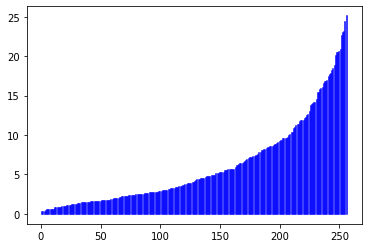

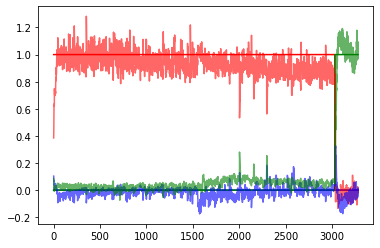

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 2149/3000 [10:03:48<3:49:29, 16.18s/it]

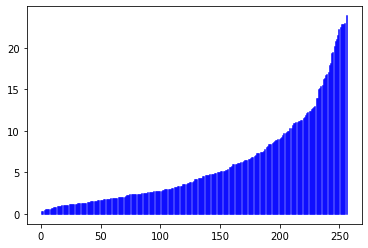

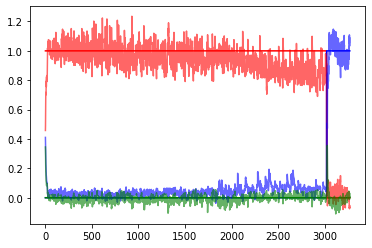

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2154/3000 [10:05:46<4:18:49, 18.36s/it]

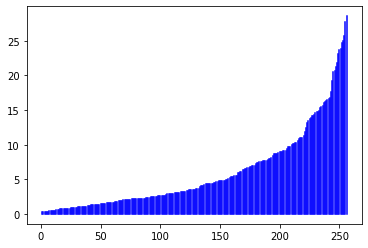

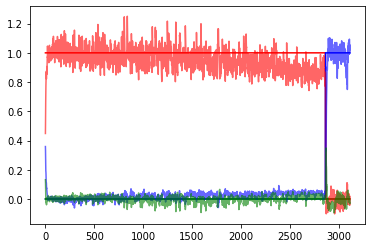

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2159/3000 [10:07:04<3:42:20, 15.86s/it]

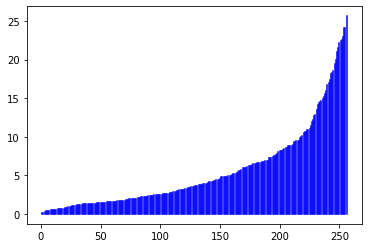

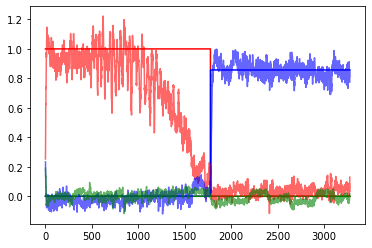

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 2164/3000 [10:08:26<3:39:45, 15.77s/it]

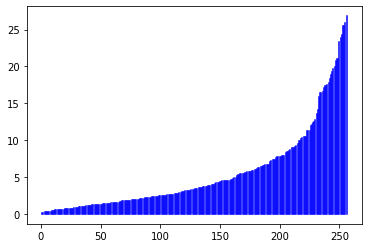

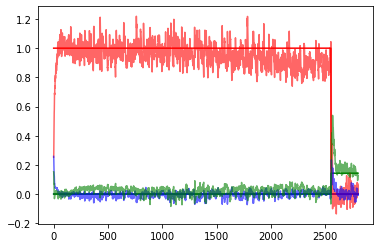

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2169/3000 [10:09:46<3:35:25, 15.55s/it]

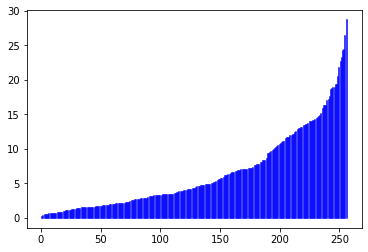

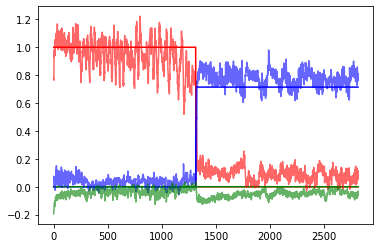

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 2174/3000 [10:11:03<3:24:51, 14.88s/it]

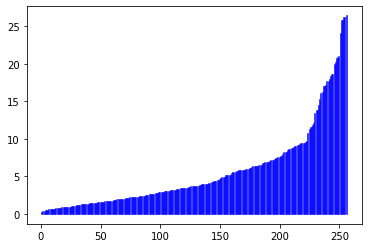

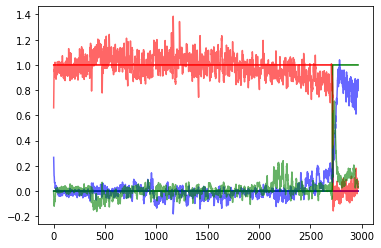

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2179/3000 [10:12:22<3:31:51, 15.48s/it]

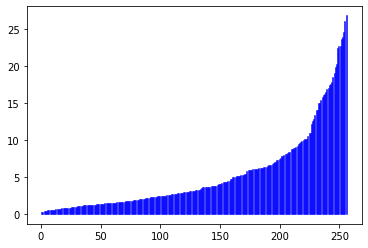

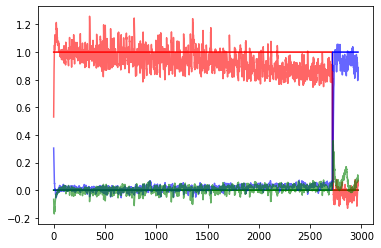

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2184/3000 [10:13:41<3:29:46, 15.42s/it]

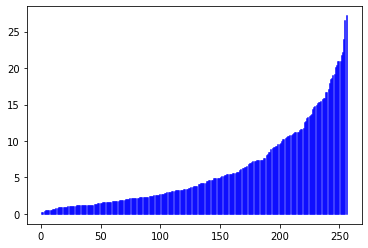

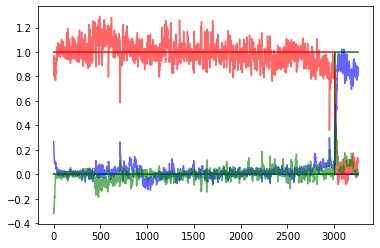

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2189/3000 [10:14:59<3:23:35, 15.06s/it]

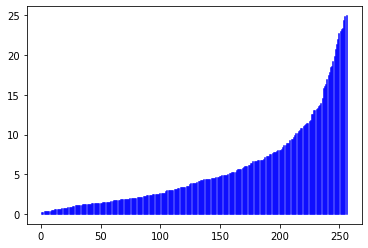

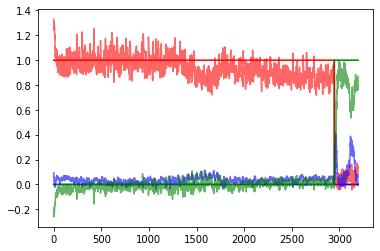

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2194/3000 [10:16:18<3:25:01, 15.26s/it]

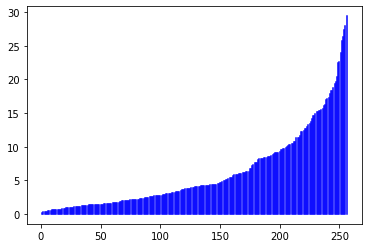

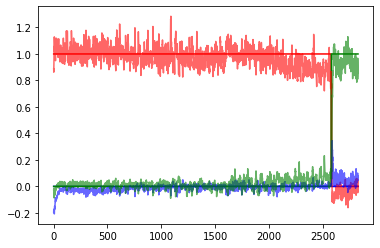

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2199/3000 [10:17:40<3:32:29, 15.92s/it]

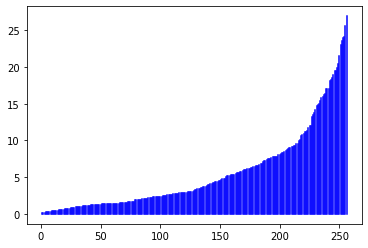

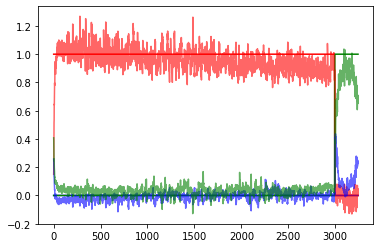

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 2204/3000 [10:19:35<3:57:23, 17.89s/it]

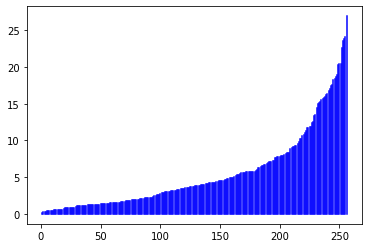

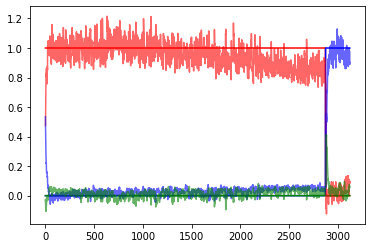

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 2209/3000 [10:20:56<3:26:32, 15.67s/it]

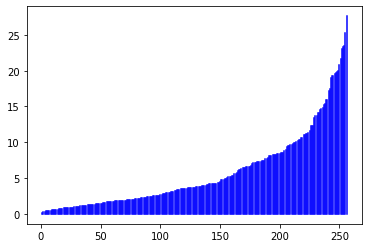

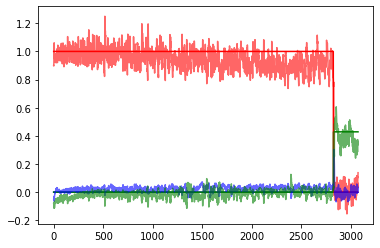

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2214/3000 [10:22:15<3:17:37, 15.09s/it]

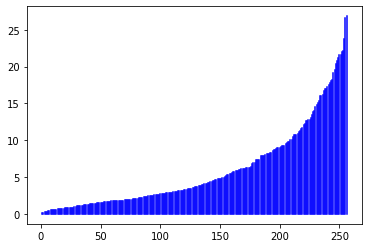

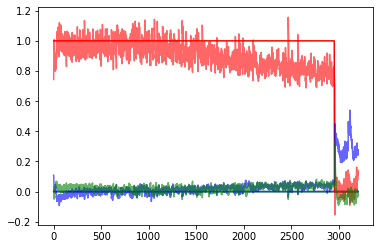

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 2219/3000 [10:23:32<3:15:03, 14.99s/it]

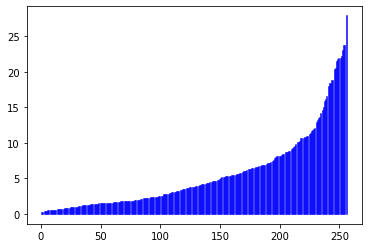

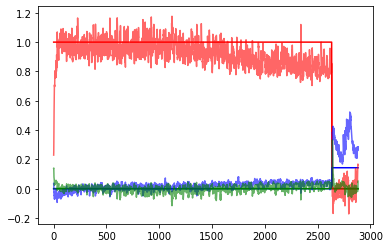

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2224/3000 [10:24:54<3:25:47, 15.91s/it]

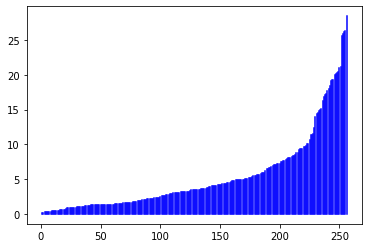

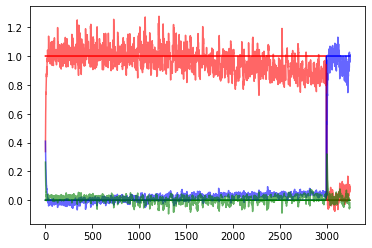

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2229/3000 [10:26:21<3:40:05, 17.13s/it]

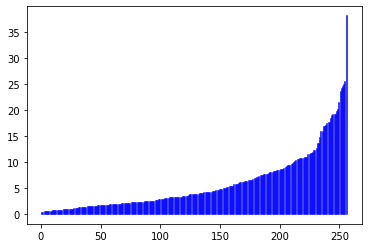

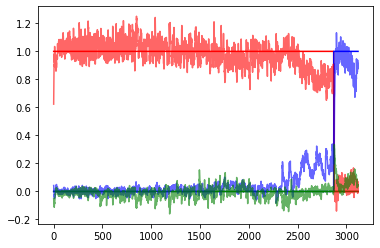

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 2234/3000 [10:27:43<3:23:36, 15.95s/it]

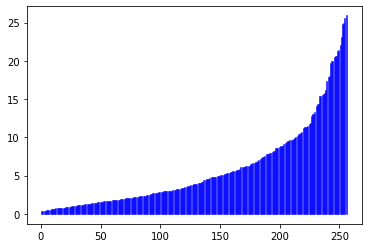

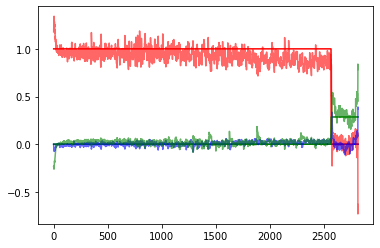

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2239/3000 [10:29:03<3:20:59, 15.85s/it]

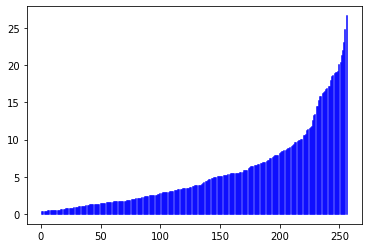

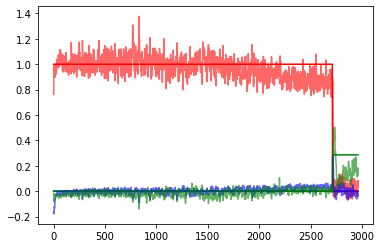

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 2244/3000 [10:30:24<3:15:41, 15.53s/it]

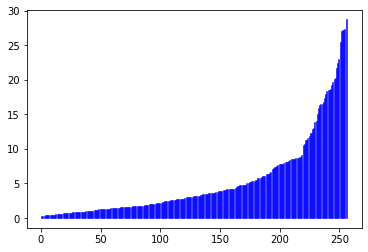

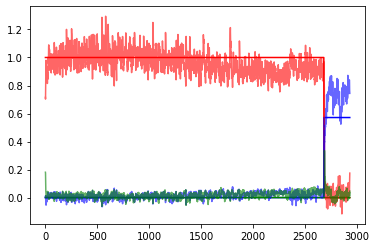

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2249/3000 [10:31:41<3:08:46, 15.08s/it]

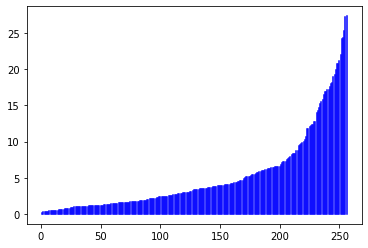

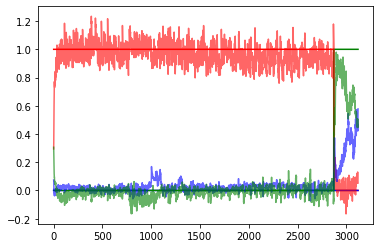

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 2254/3000 [10:33:37<3:38:44, 17.59s/it]

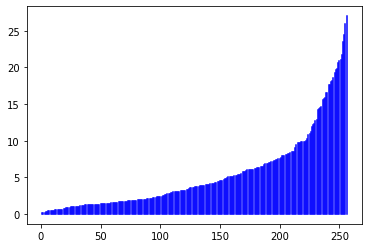

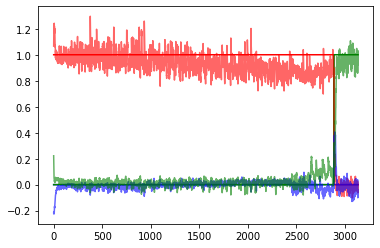

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2259/3000 [10:34:55<3:13:03, 15.63s/it]

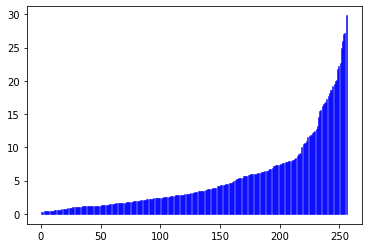

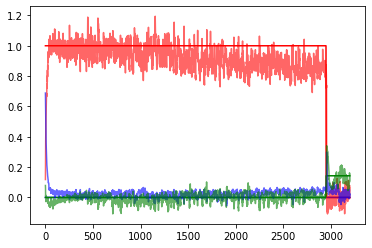

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 2264/3000 [10:36:14<3:12:40, 15.71s/it]

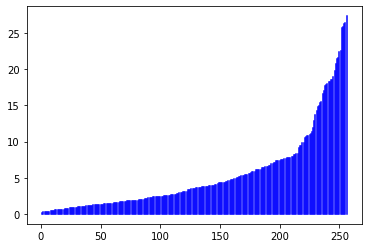

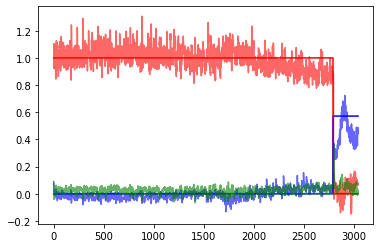

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2269/3000 [10:37:37<3:14:55, 16.00s/it]

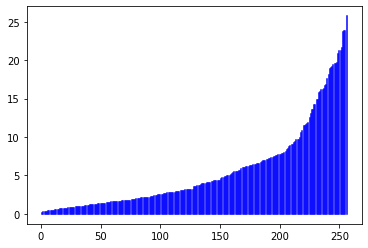

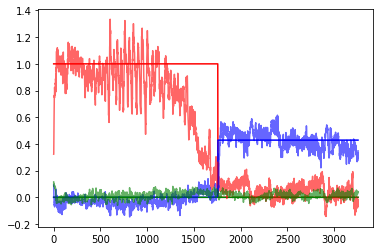

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2274/3000 [10:38:56<3:02:04, 15.05s/it]

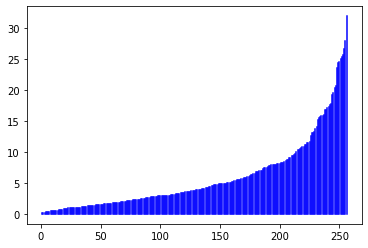

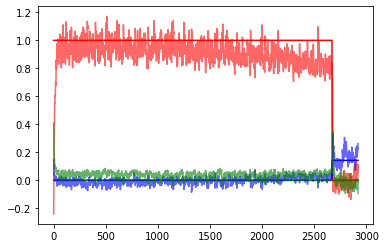

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2279/3000 [10:40:15<3:04:26, 15.35s/it]

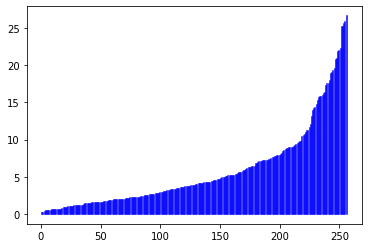

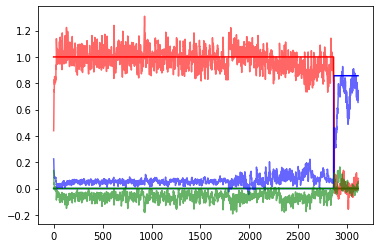

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 2284/3000 [10:41:36<3:05:43, 15.56s/it]

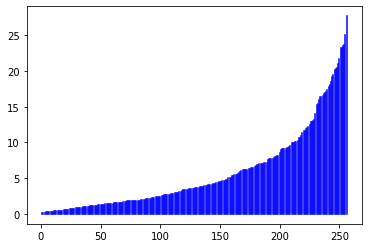

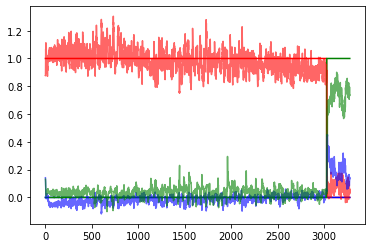

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2289/3000 [10:42:55<3:02:23, 15.39s/it]

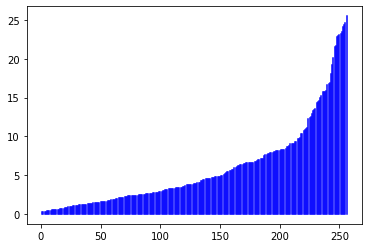

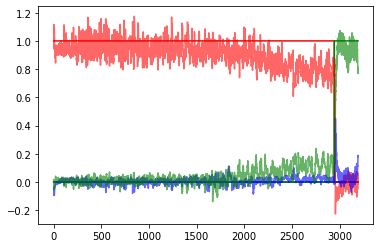

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2294/3000 [10:44:16<3:03:55, 15.63s/it]

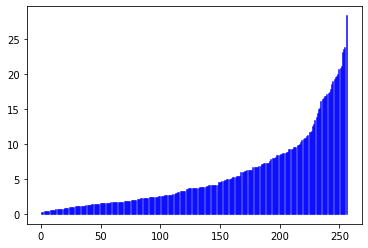

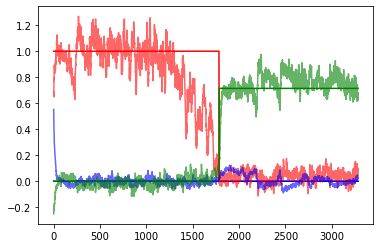

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2299/3000 [10:45:33<2:52:59, 14.81s/it]

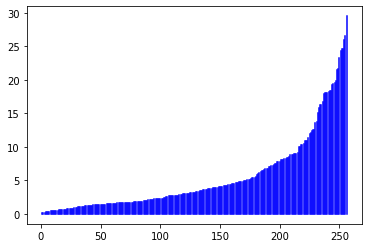

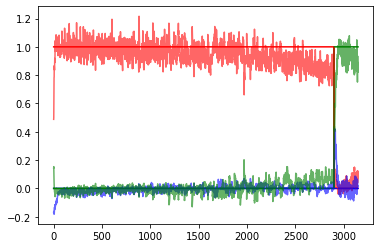

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 2304/3000 [10:47:29<3:29:13, 18.04s/it]

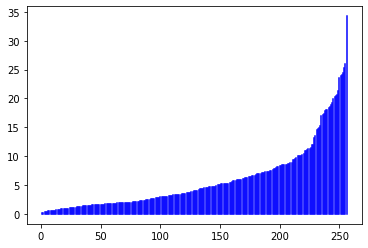

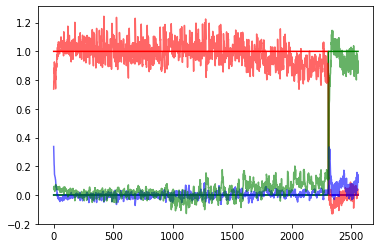

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2309/3000 [10:48:49<3:04:14, 16.00s/it]

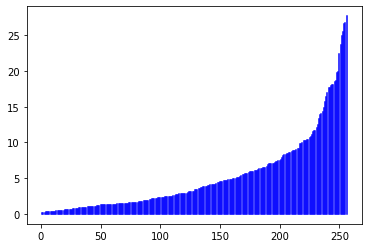

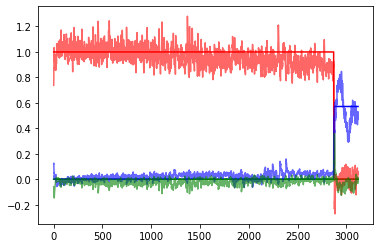

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 2314/3000 [10:50:09<2:57:01, 15.48s/it]

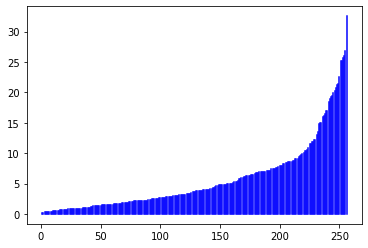

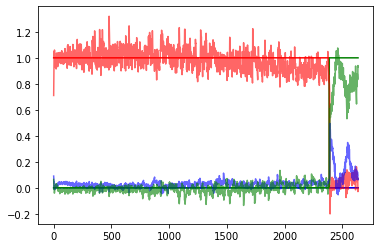

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2319/3000 [10:51:29<2:55:26, 15.46s/it]

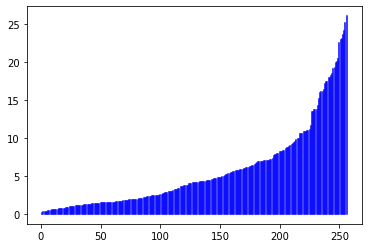

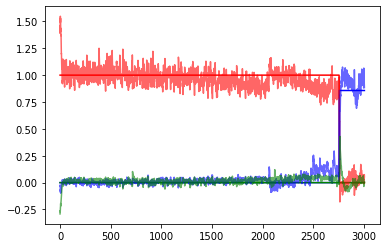

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 2324/3000 [10:52:54<3:02:31, 16.20s/it]

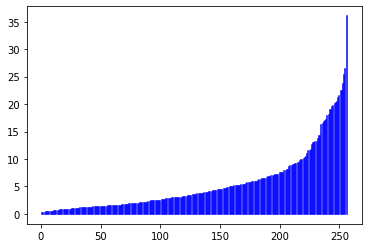

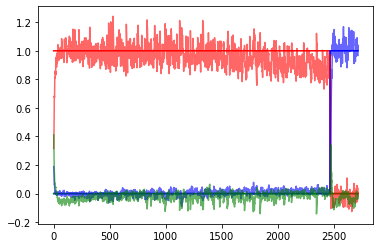

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2329/3000 [10:54:17<2:58:31, 15.96s/it]

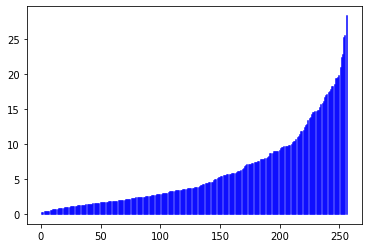

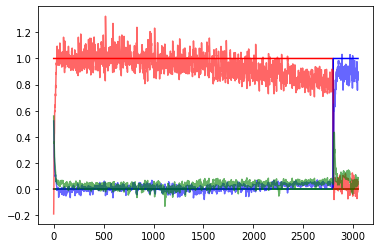

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2334/3000 [10:55:40<2:54:51, 15.75s/it]

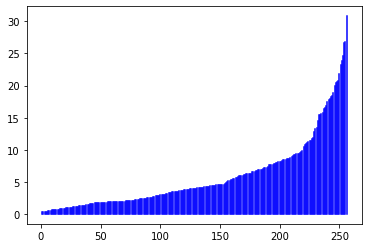

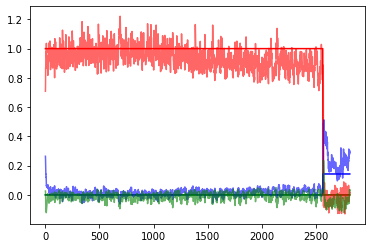

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2339/3000 [10:57:00<2:52:14, 15.63s/it]

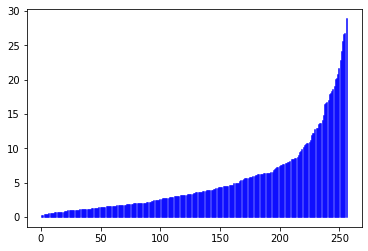

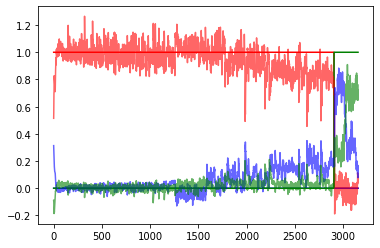

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2344/3000 [10:58:19<2:47:01, 15.28s/it]

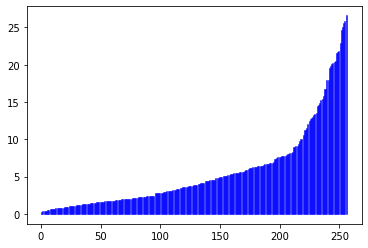

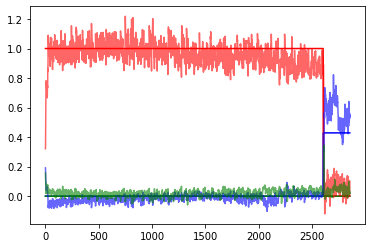

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 2349/3000 [10:59:39<2:49:11, 15.59s/it]

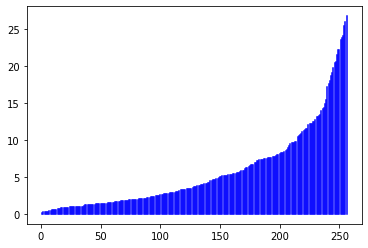

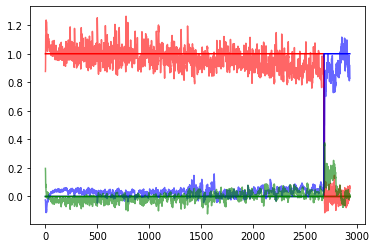

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2354/3000 [11:01:38<3:16:32, 18.26s/it]

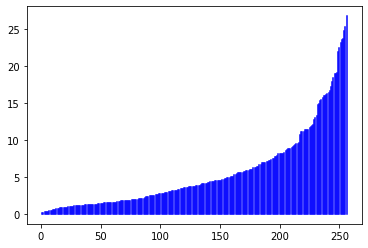

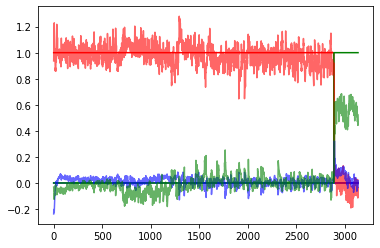

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 2359/3000 [11:03:01<2:53:28, 16.24s/it]

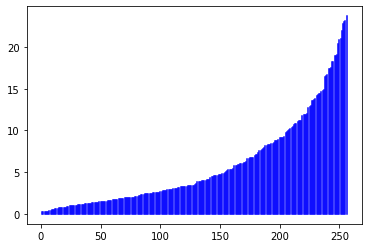

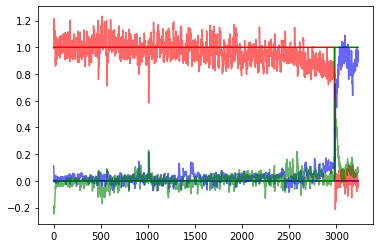

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2364/3000 [11:04:23<2:47:13, 15.78s/it]

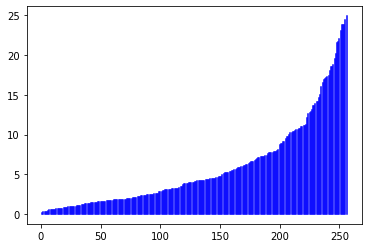

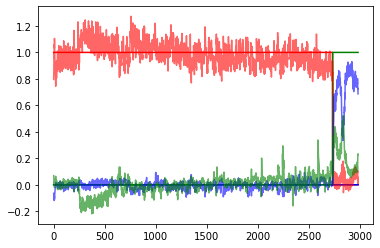

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2369/3000 [11:05:44<2:46:32, 15.84s/it]

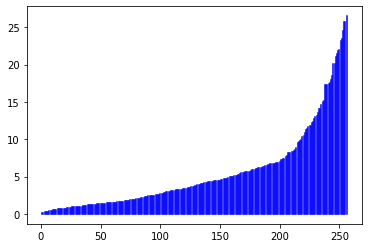

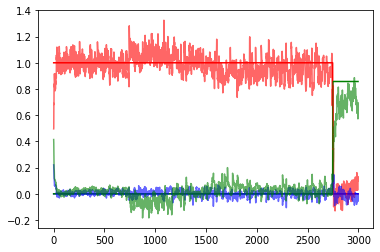

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2374/3000 [11:07:10<2:57:53, 17.05s/it]

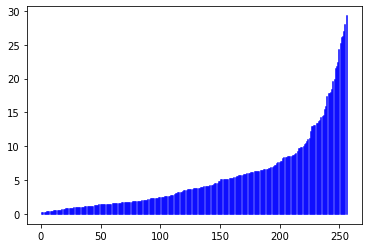

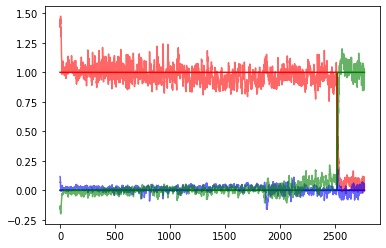

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 2379/3000 [11:08:29<2:41:41, 15.62s/it]

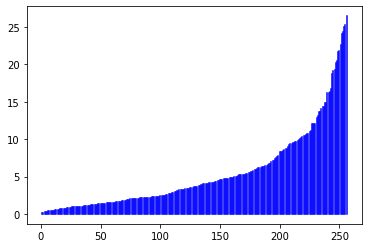

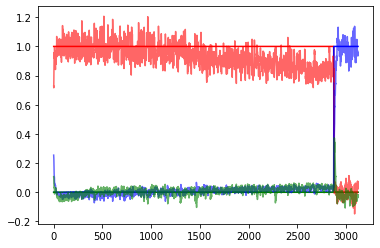

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2384/3000 [11:09:48<2:37:46, 15.37s/it]

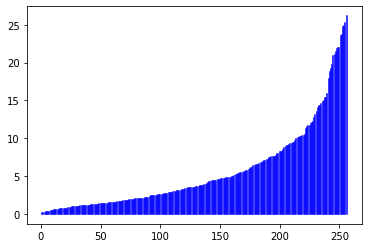

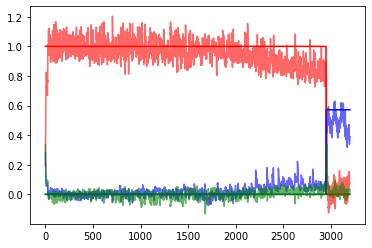

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2389/3000 [11:11:05<2:30:22, 14.77s/it]

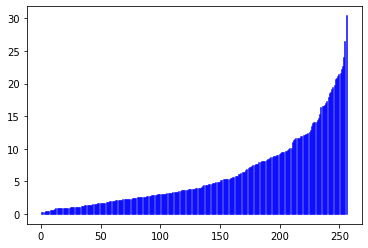

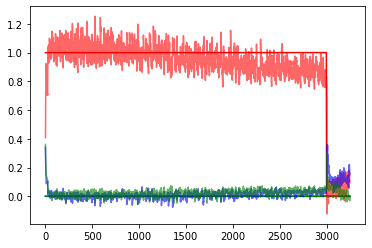

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 2394/3000 [11:12:27<2:38:01, 15.65s/it]

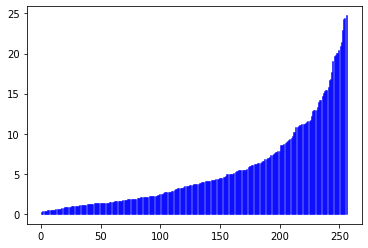

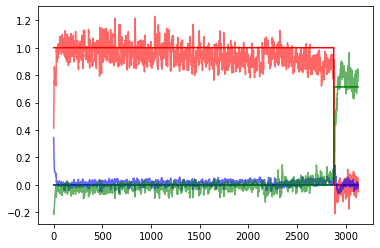

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2399/3000 [11:13:47<2:34:13, 15.40s/it]

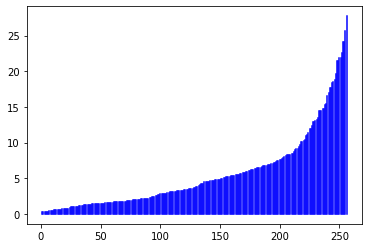

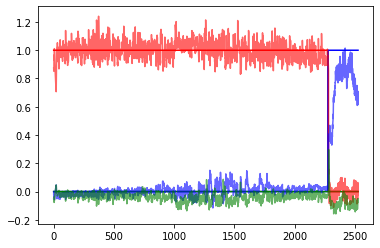

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2404/3000 [11:15:45<3:01:15, 18.25s/it]

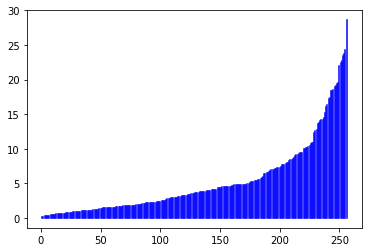

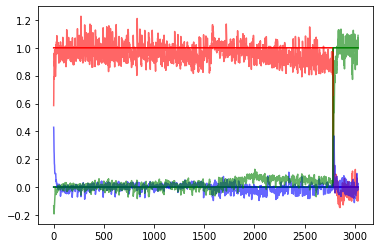

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 2409/3000 [11:17:06<2:40:07, 16.26s/it]

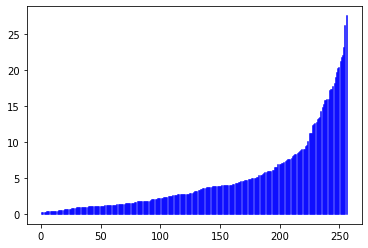

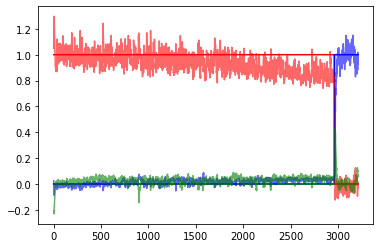

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2414/3000 [11:18:29<2:37:12, 16.10s/it]

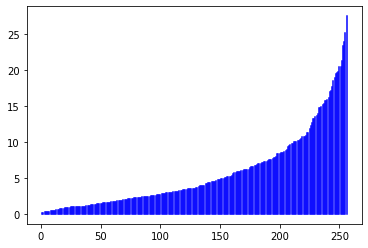

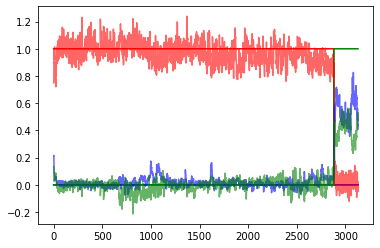

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 2419/3000 [11:19:50<2:32:24, 15.74s/it]

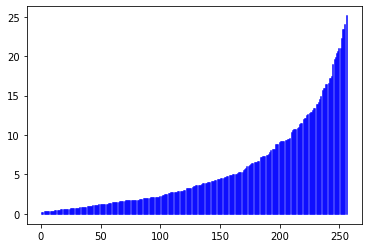

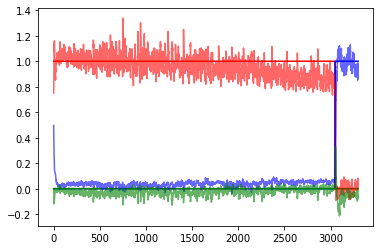

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2424/3000 [11:21:12<2:33:33, 16.00s/it]

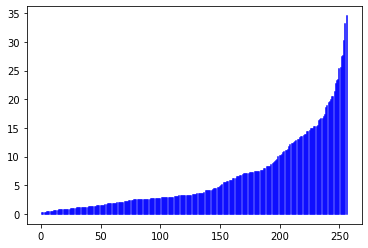

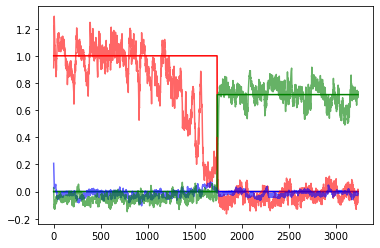

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 2429/3000 [11:22:30<2:24:39, 15.20s/it]

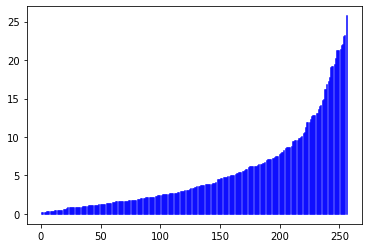

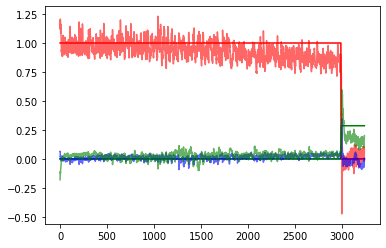

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2434/3000 [11:23:49<2:24:39, 15.33s/it]

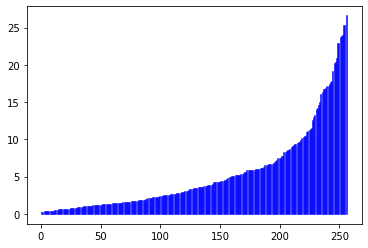

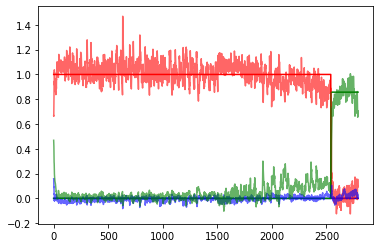

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2439/3000 [11:25:04<2:16:06, 14.56s/it]

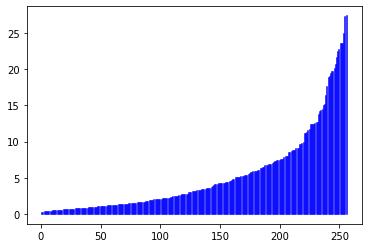

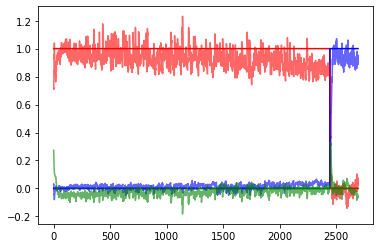

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 2444/3000 [11:26:21<2:18:18, 14.93s/it]

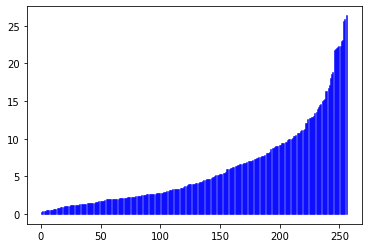

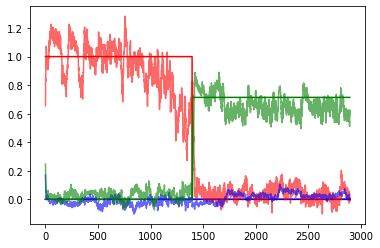

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 2449/3000 [11:27:39<2:18:41, 15.10s/it]

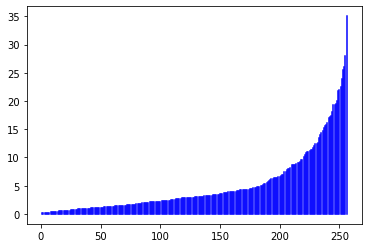

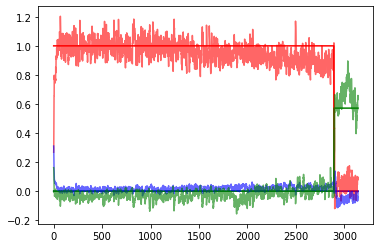

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 2454/3000 [11:29:32<2:40:58, 17.69s/it]

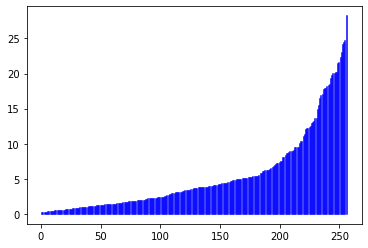

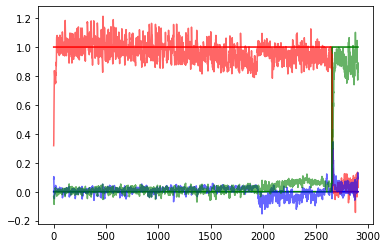

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 2459/3000 [11:30:53<2:24:29, 16.02s/it]

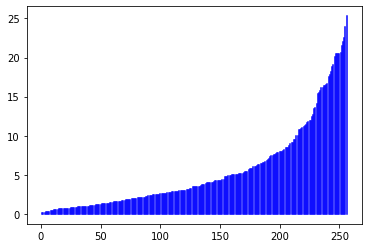

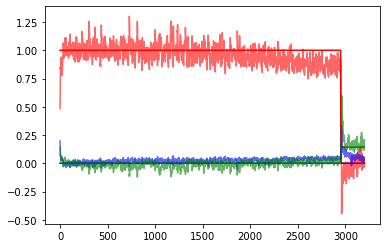

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 2464/3000 [11:32:15<2:21:09, 15.80s/it]

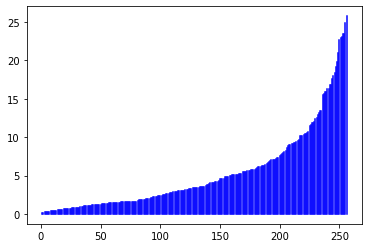

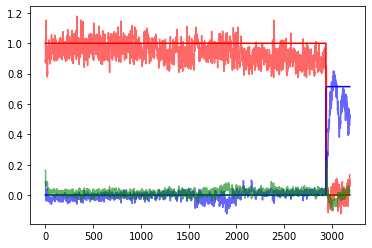

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2469/3000 [11:33:38<2:21:31, 15.99s/it]

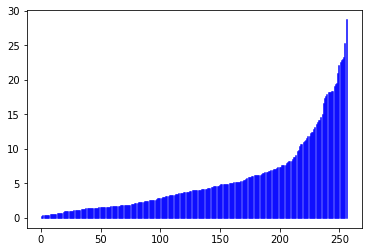

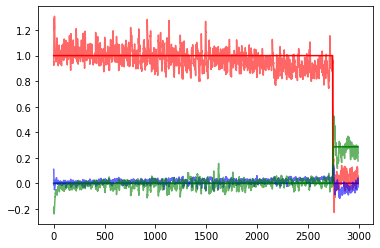

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 2474/3000 [11:34:58<2:17:17, 15.66s/it]

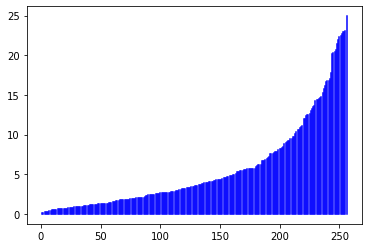

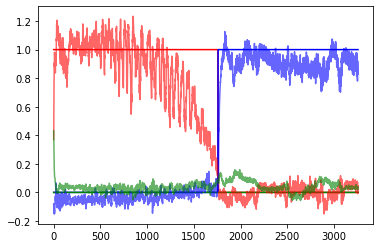

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 2479/3000 [11:36:18<2:13:33, 15.38s/it]

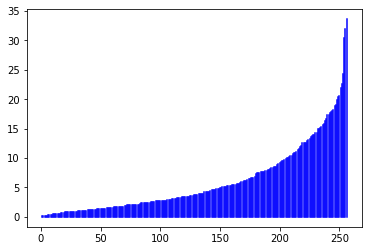

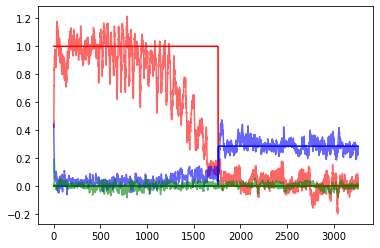

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2484/3000 [11:37:41<2:17:20, 15.97s/it]

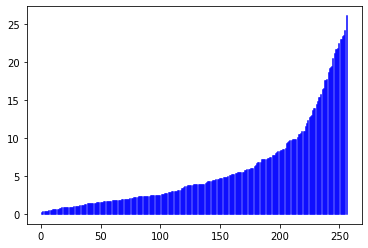

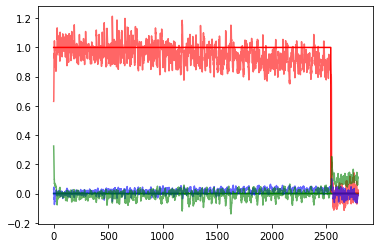

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2489/3000 [11:39:01<2:12:57, 15.61s/it]

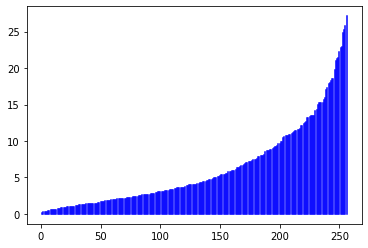

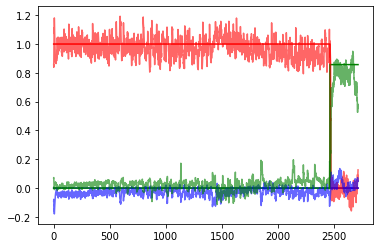

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2494/3000 [11:40:20<2:07:31, 15.12s/it]

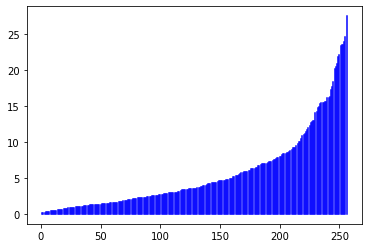

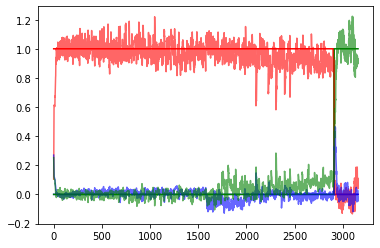

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2499/3000 [11:41:39<2:05:18, 15.01s/it]

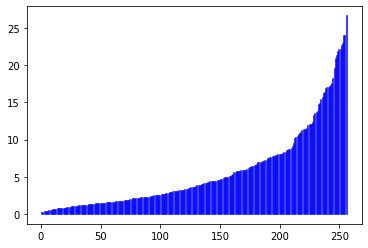

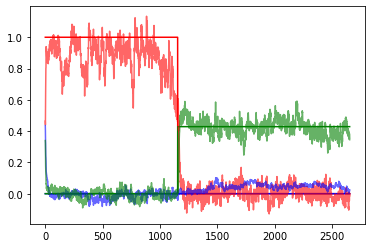

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 2504/3000 [11:43:35<2:29:35, 18.10s/it]

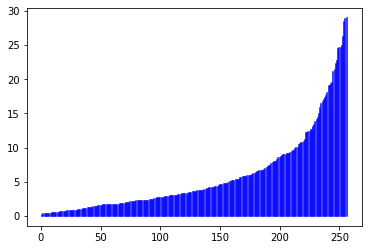

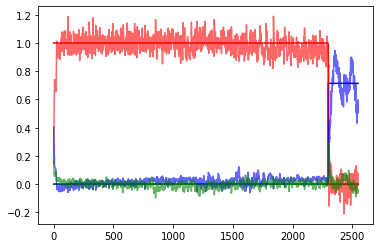

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 2509/3000 [11:44:56<2:13:07, 16.27s/it]

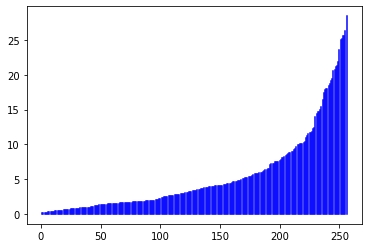

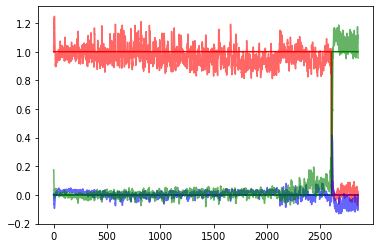

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 2514/3000 [11:46:37<2:35:58, 19.26s/it]

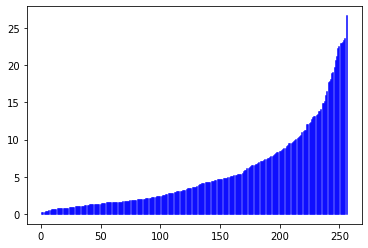

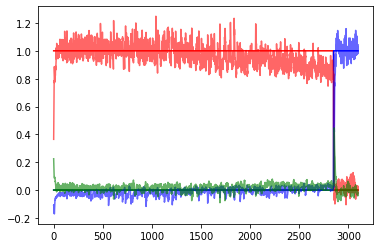

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2519/3000 [11:48:12<2:22:24, 17.77s/it]

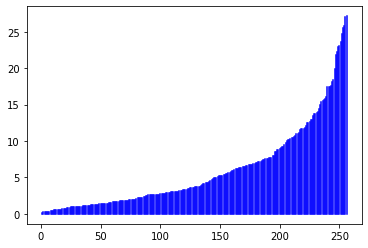

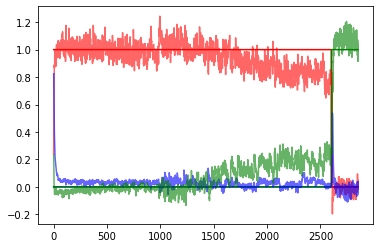

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 2524/3000 [11:49:43<2:14:57, 17.01s/it]

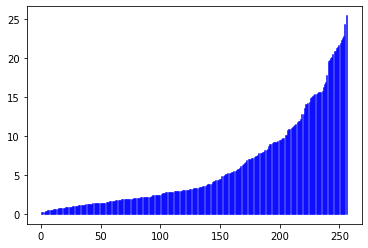

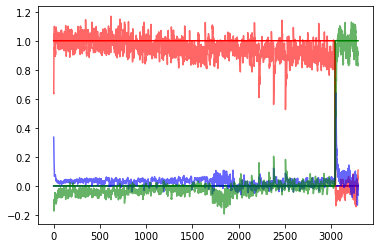

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 2529/3000 [11:51:05<2:05:51, 16.03s/it]

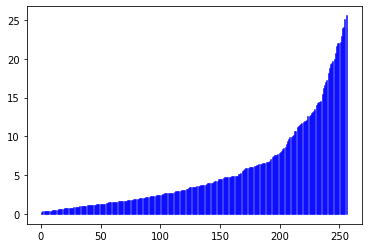

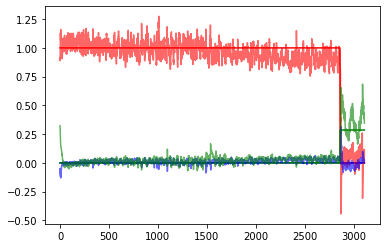

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 2534/3000 [11:52:23<1:57:50, 15.17s/it]

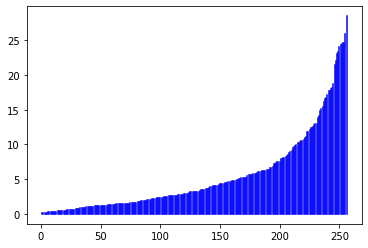

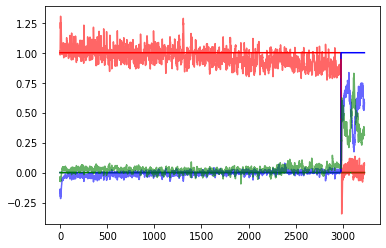

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2539/3000 [11:53:42<1:58:05, 15.37s/it]

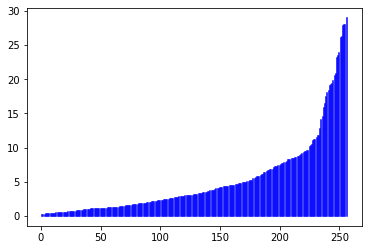

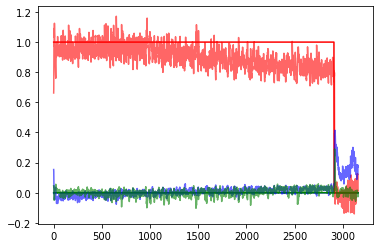

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2544/3000 [11:55:03<1:59:29, 15.72s/it]

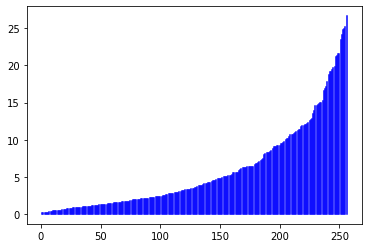

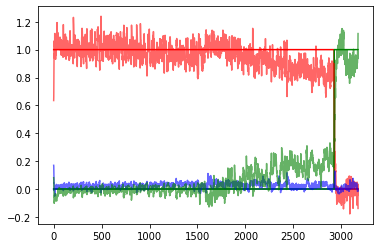

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 2549/3000 [11:56:24<1:57:16, 15.60s/it]

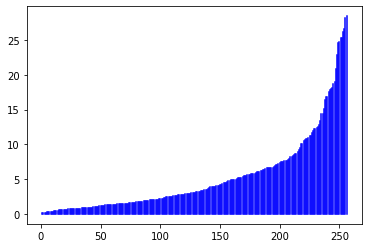

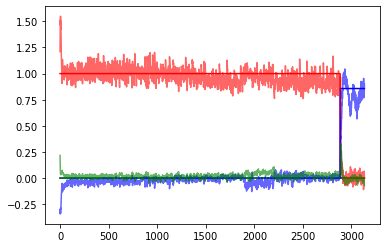

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2554/3000 [11:58:28<2:24:16, 19.41s/it]

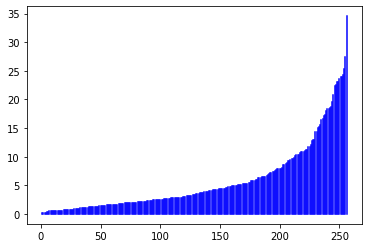

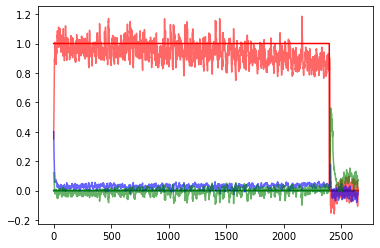

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 2559/3000 [11:59:52<2:03:43, 16.83s/it]

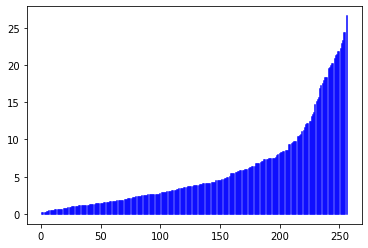

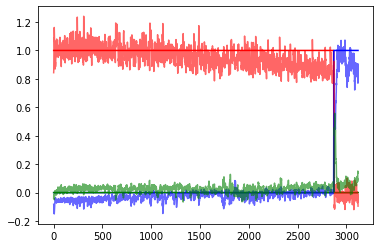

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2564/3000 [12:01:27<2:12:24, 18.22s/it]

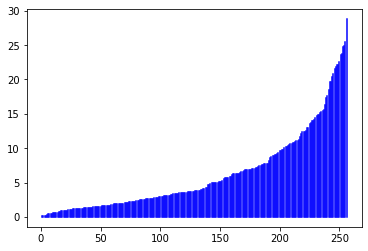

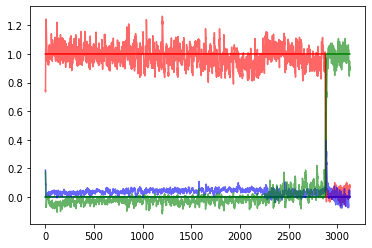

 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2569/3000 [12:02:54<2:03:28, 17.19s/it]

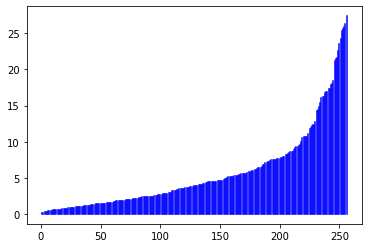

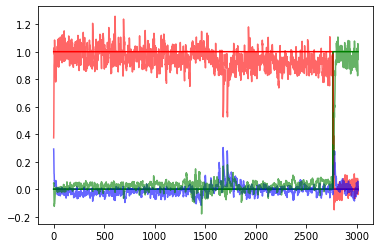

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 2574/3000 [12:04:15<1:51:55, 15.76s/it]

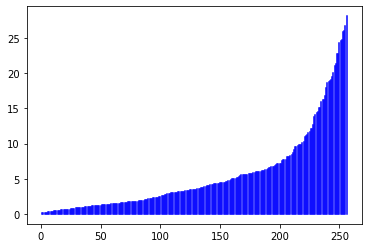

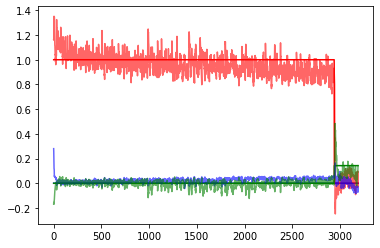

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2579/3000 [12:05:35<1:50:15, 15.71s/it]

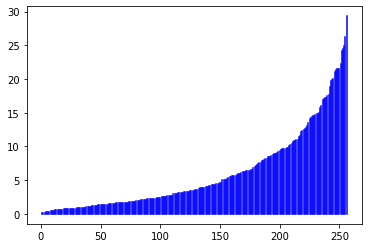

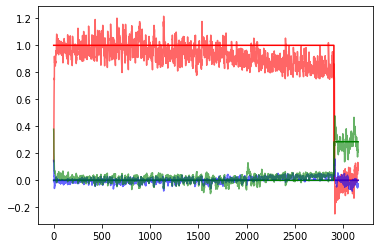

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 2584/3000 [12:06:58<1:51:35, 16.10s/it]

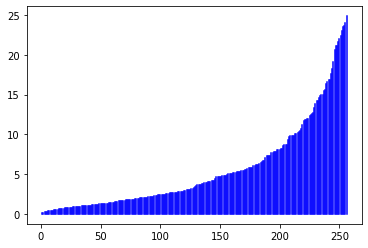

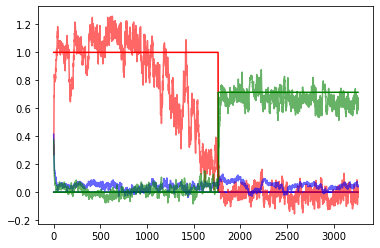

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 2589/3000 [12:08:20<1:47:40, 15.72s/it]

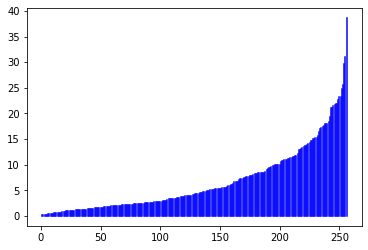

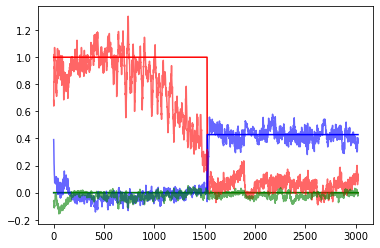

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 2594/3000 [12:09:39<1:44:50, 15.49s/it]

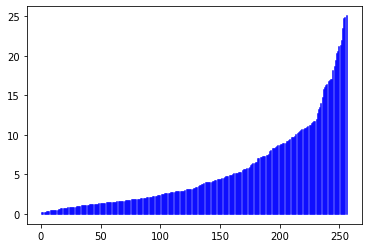

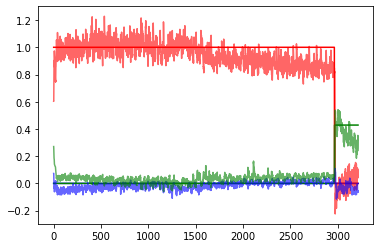

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2599/3000 [12:11:02<1:47:00, 16.01s/it]

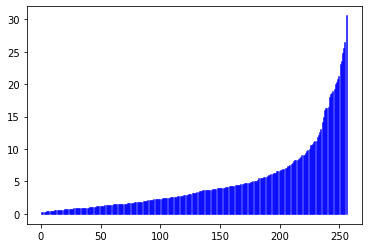

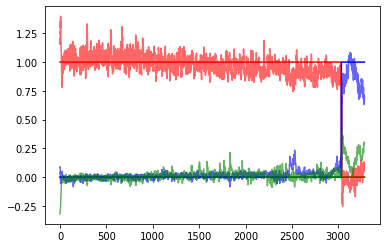

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2604/3000 [12:13:00<1:59:36, 18.12s/it]

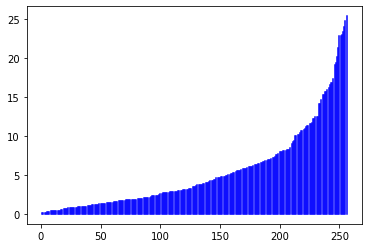

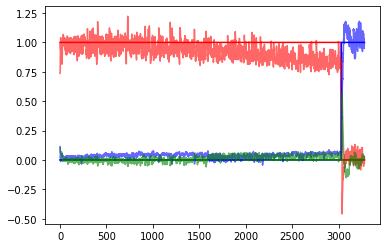

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 2609/3000 [12:14:21<1:43:48, 15.93s/it]

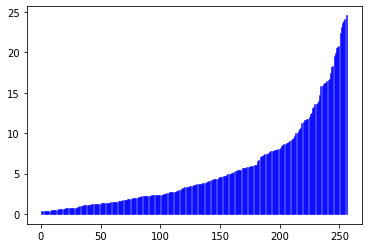

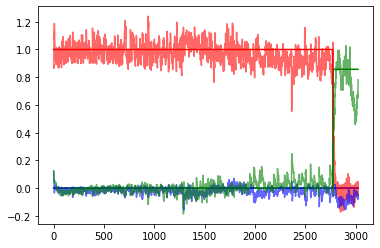

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 2614/3000 [12:15:45<1:44:18, 16.21s/it]

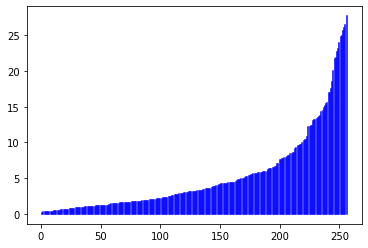

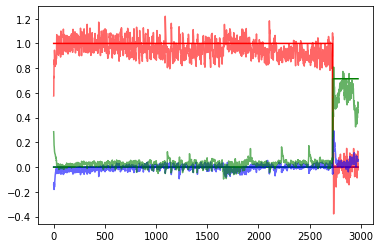

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 2619/3000 [12:17:08<1:42:10, 16.09s/it]

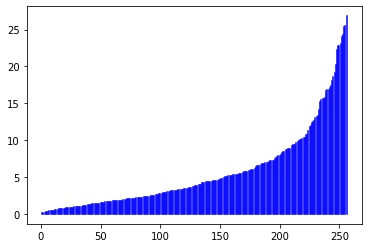

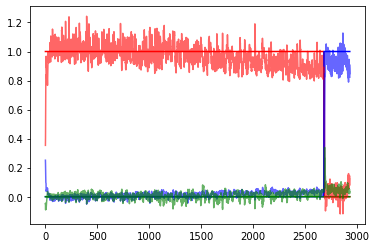

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2624/3000 [12:18:25<1:36:56, 15.47s/it]

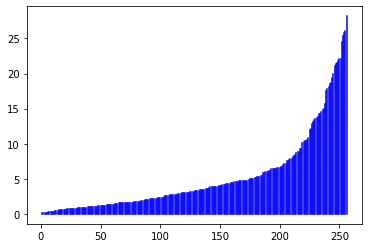

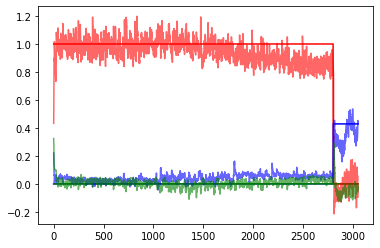

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 2629/3000 [12:19:43<1:32:12, 14.91s/it]

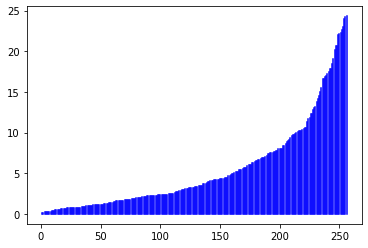

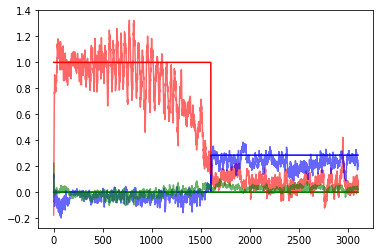

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2634/3000 [12:21:01<1:31:29, 15.00s/it]

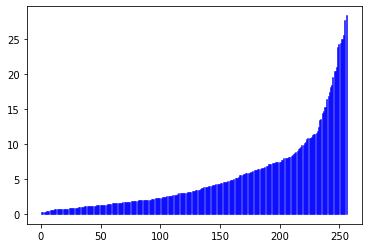

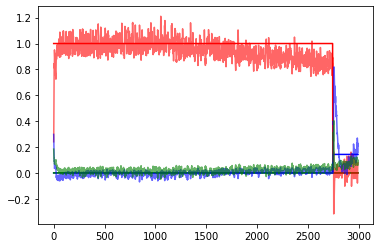

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 2639/3000 [12:22:23<1:34:33, 15.72s/it]

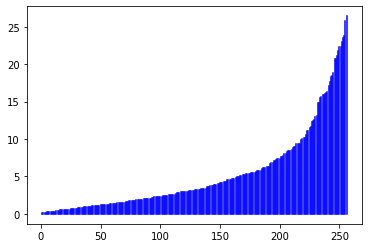

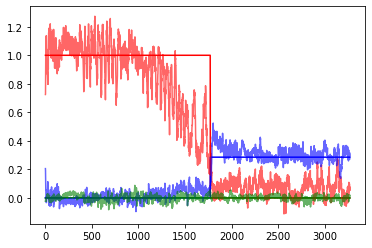

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 2644/3000 [12:23:42<1:31:09, 15.36s/it]

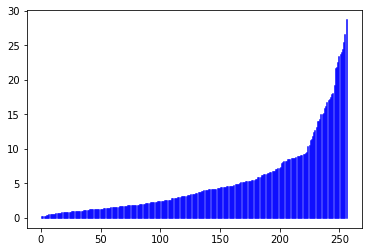

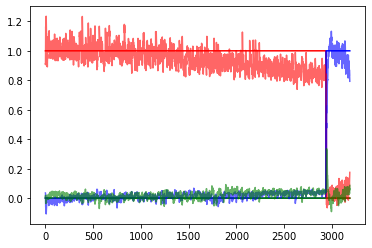

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2649/3000 [12:25:01<1:28:34, 15.14s/it]

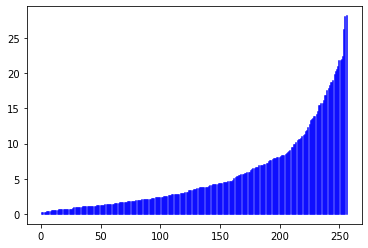

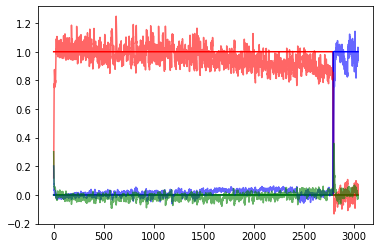

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 2654/3000 [12:26:56<1:41:52, 17.67s/it]

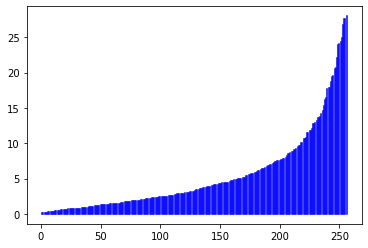

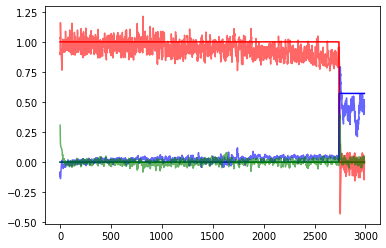

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2659/3000 [12:28:14<1:28:09, 15.51s/it]

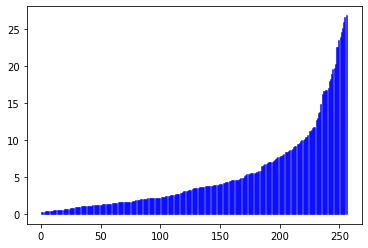

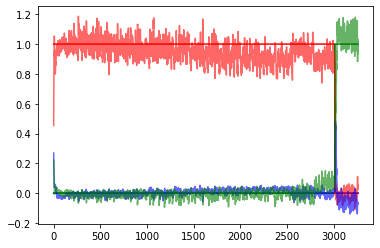

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2664/3000 [12:29:32<1:25:53, 15.34s/it]

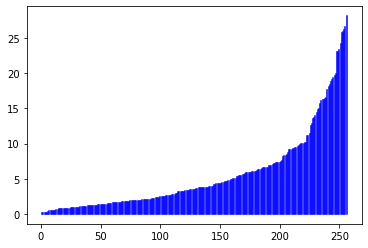

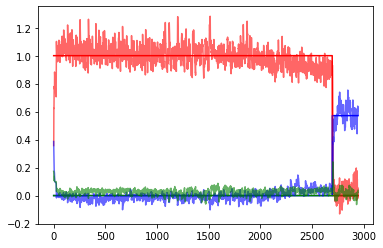

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 2669/3000 [12:30:51<1:22:55, 15.03s/it]

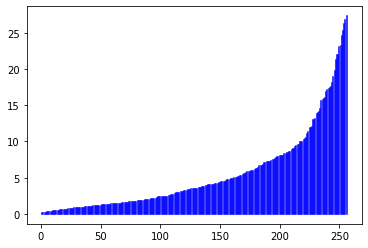

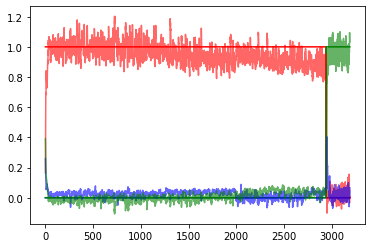

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2674/3000 [12:32:12<1:23:48, 15.42s/it]

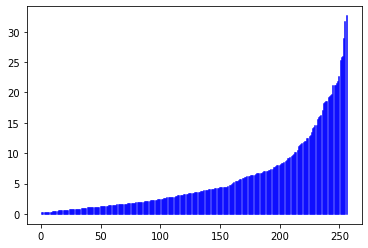

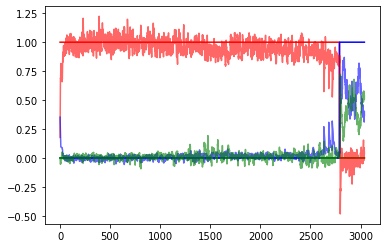

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 2679/3000 [12:33:31<1:21:52, 15.30s/it]

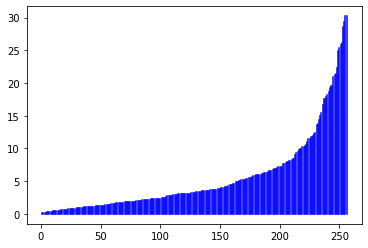

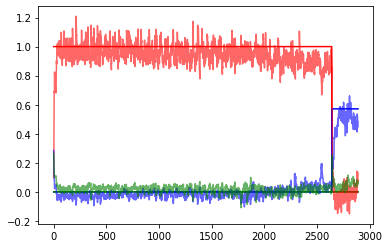

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 2684/3000 [12:34:48<1:20:36, 15.30s/it]

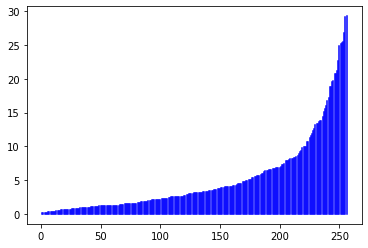

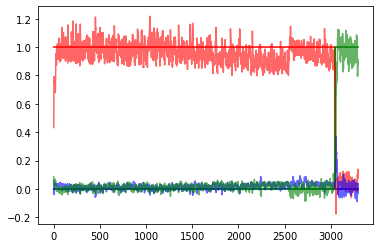

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 2689/3000 [12:36:05<1:18:32, 15.15s/it]

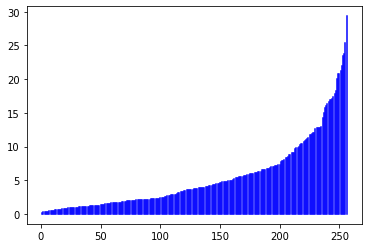

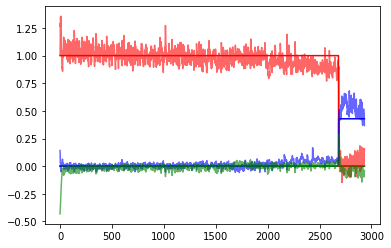

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2694/3000 [12:37:25<1:18:07, 15.32s/it]

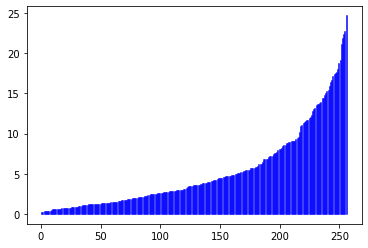

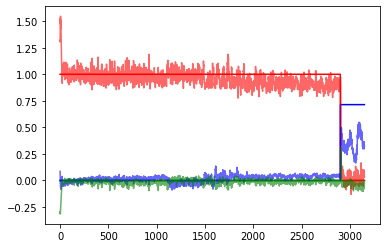

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 2699/3000 [12:38:44<1:16:41, 15.29s/it]

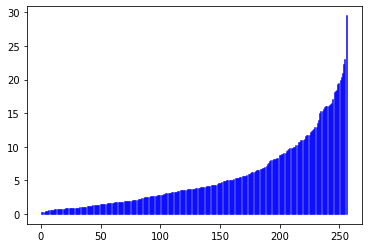

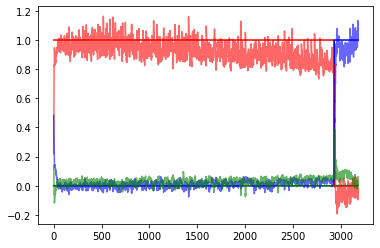

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 2704/3000 [12:40:39<1:27:27, 17.73s/it]

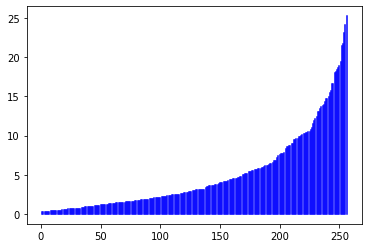

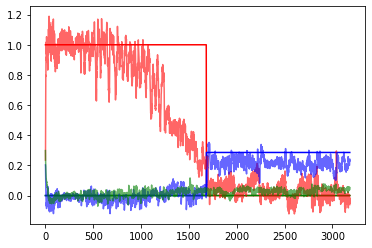

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2709/3000 [12:41:58<1:15:58, 15.67s/it]

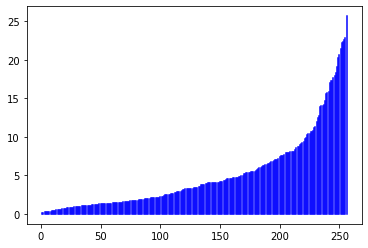

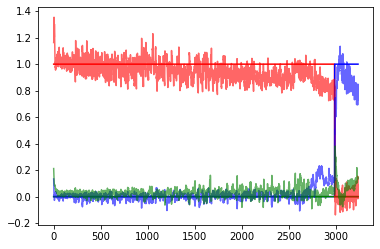

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 2714/3000 [12:43:18<1:14:40, 15.67s/it]

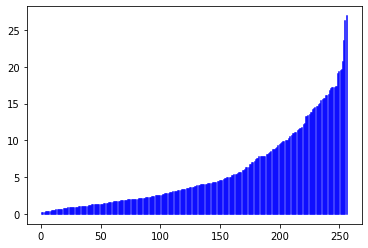

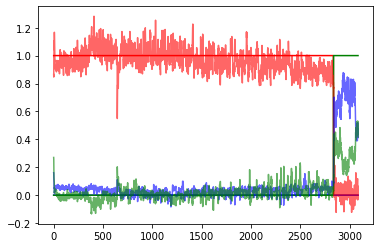

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2719/3000 [12:44:39<1:13:49, 15.76s/it]

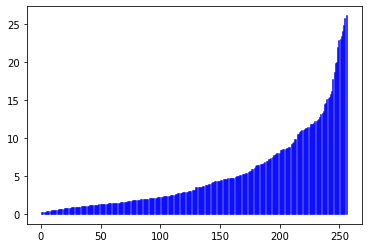

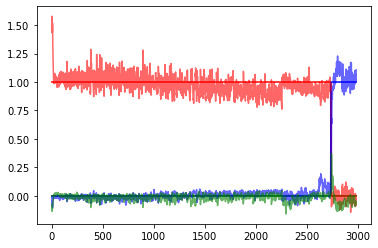

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2724/3000 [12:45:58<1:11:14, 15.49s/it]

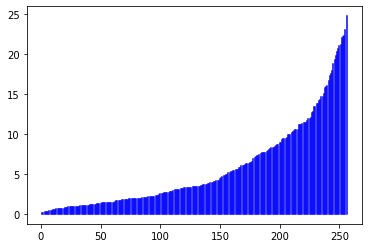

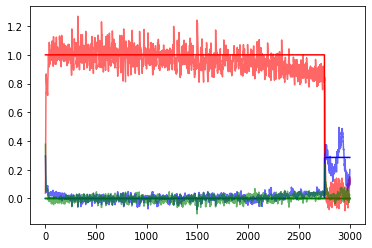

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2729/3000 [12:47:19<1:11:19, 15.79s/it]

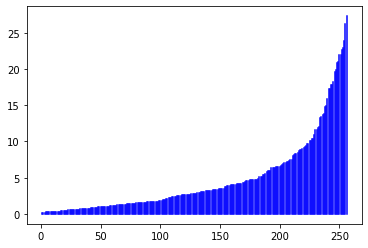

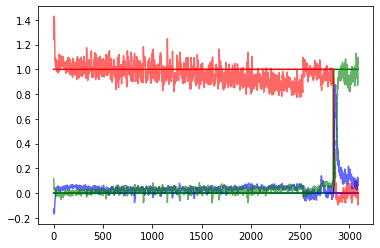

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2734/3000 [12:48:38<1:07:36, 15.25s/it]

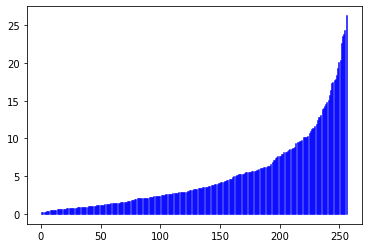

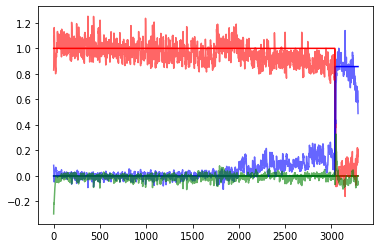

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2739/3000 [12:49:56<1:06:34, 15.30s/it]

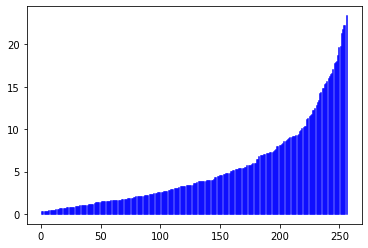

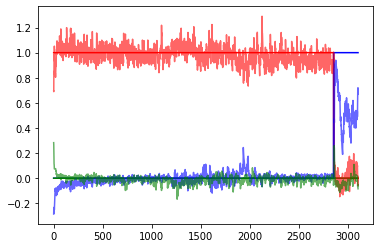

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2744/3000 [12:51:14<1:05:06, 15.26s/it]

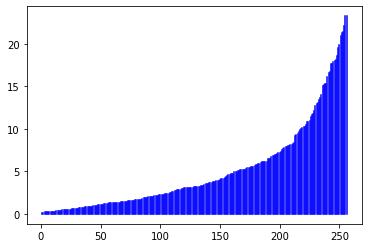

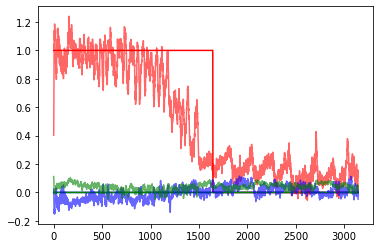

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 2749/3000 [12:52:33<1:04:33, 15.43s/it]

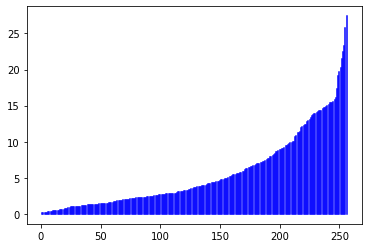

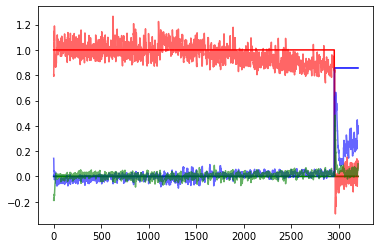

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2754/3000 [12:54:28<1:13:21, 17.89s/it]

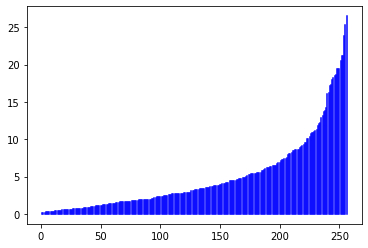

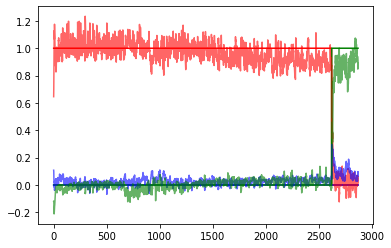

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2759/3000 [12:55:51<1:05:53, 16.40s/it]

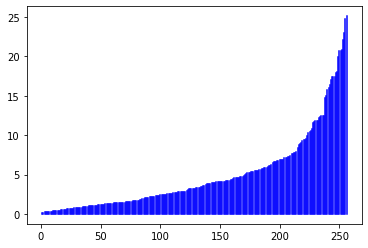

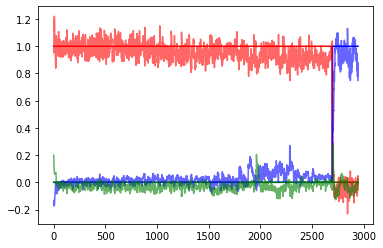

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 2764/3000 [12:57:13<1:03:21, 16.11s/it]

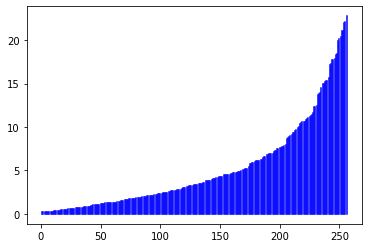

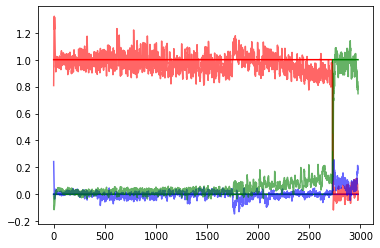

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2769/3000 [12:58:40<1:03:28, 16.49s/it]

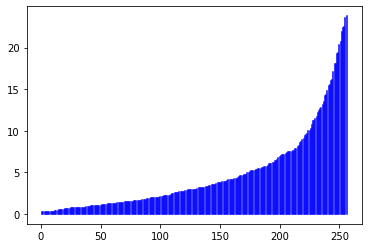

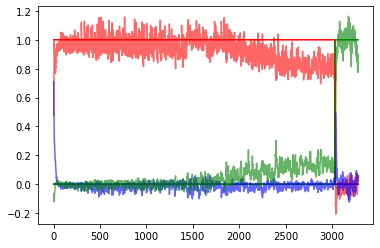

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2774/3000 [13:00:00<59:03, 15.68s/it]

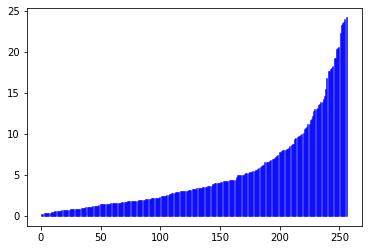

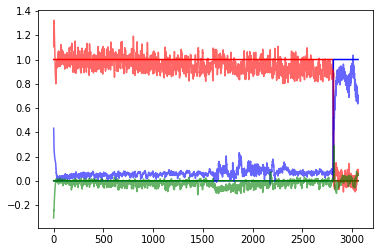

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 2779/3000 [13:01:20<57:10, 15.52s/it]

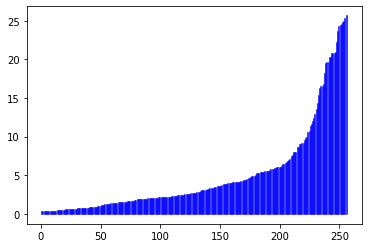

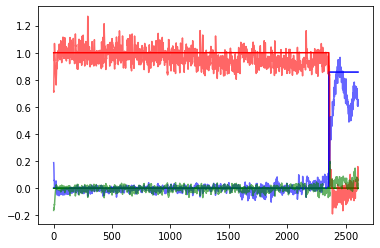

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 2784/3000 [13:02:40<56:02, 15.57s/it]

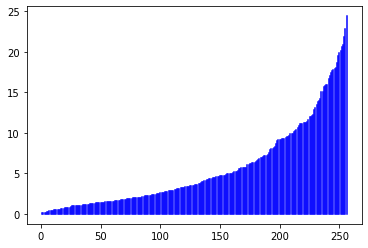

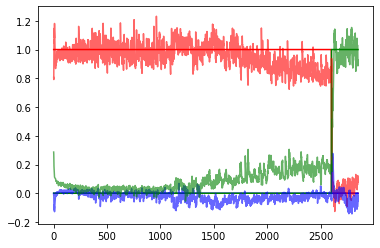

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 2789/3000 [13:03:59<53:13, 15.14s/it]

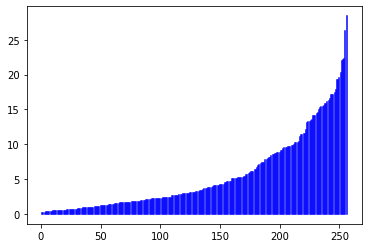

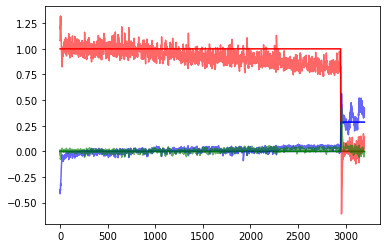

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 2794/3000 [13:05:20<53:47, 15.67s/it]

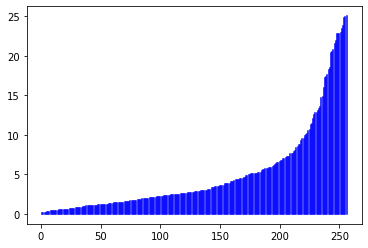

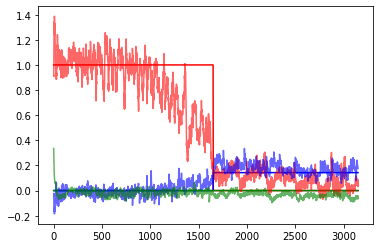

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 2799/3000 [13:06:38<51:03, 15.24s/it]

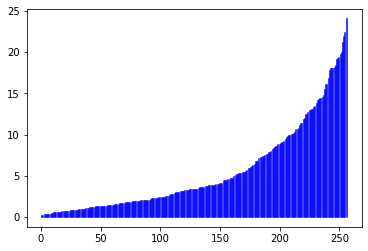

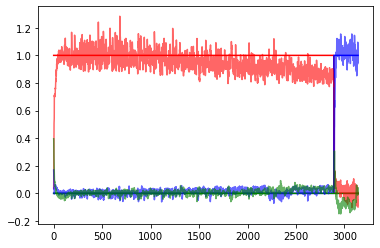

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 2804/3000 [13:08:35<57:59, 17.75s/it]

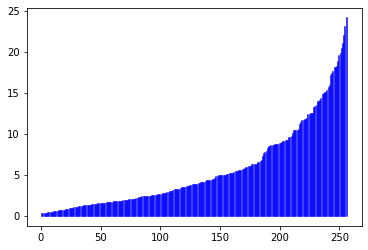

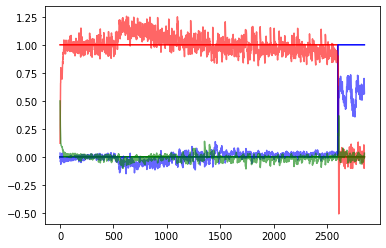

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 2809/3000 [13:09:55<50:51, 15.98s/it]

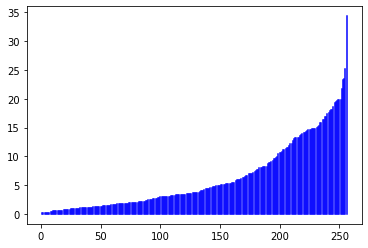

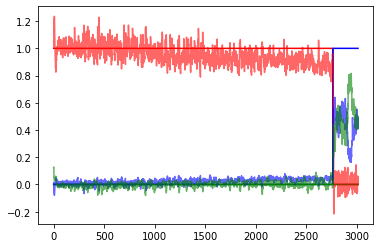

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 2814/3000 [13:11:14<47:19, 15.27s/it]

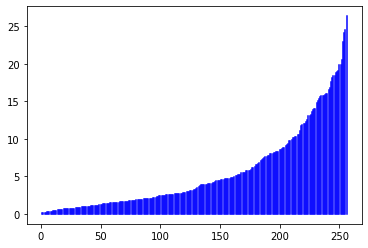

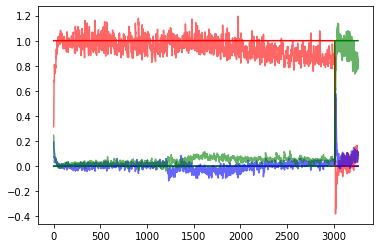

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2819/3000 [13:12:34<45:59, 15.24s/it]

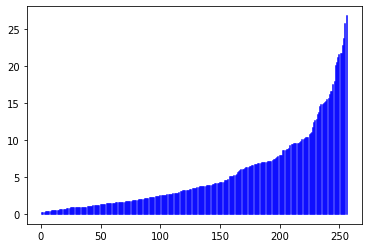

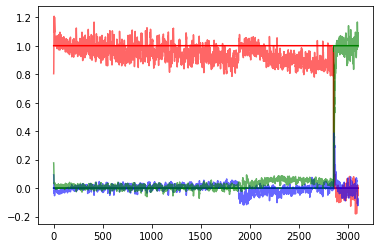

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2824/3000 [13:13:51<44:37, 15.21s/it]

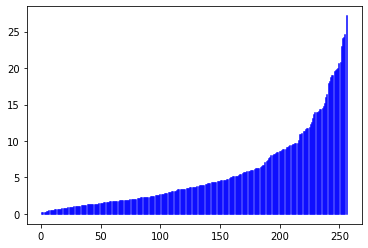

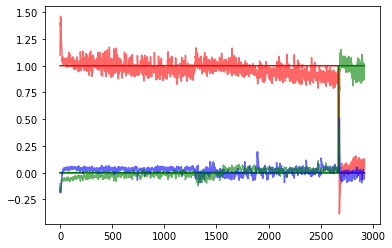

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 2829/3000 [13:15:12<44:35, 15.64s/it]

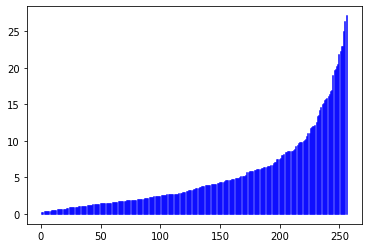

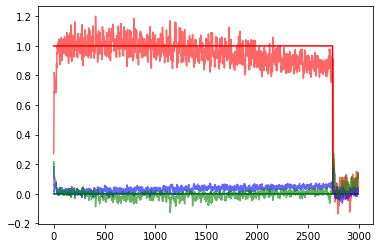

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 2834/3000 [13:16:30<41:51, 15.13s/it]

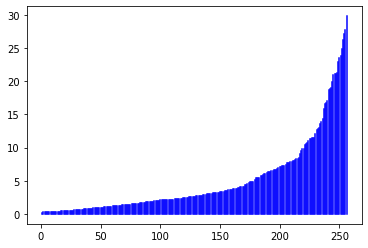

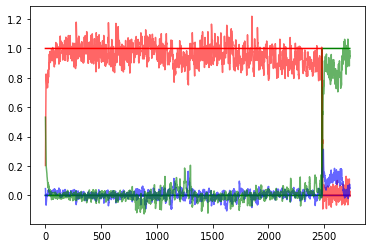

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 2839/3000 [13:17:50<41:16, 15.38s/it]

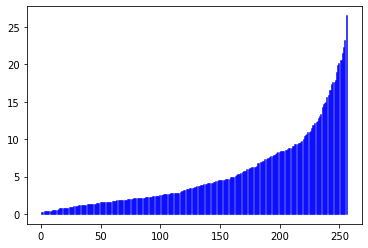

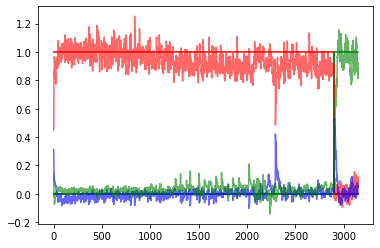

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 2844/3000 [13:19:09<40:18, 15.51s/it]

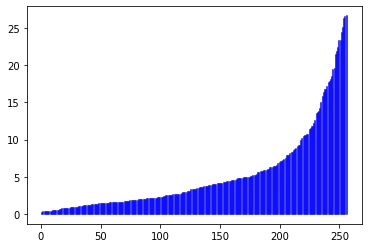

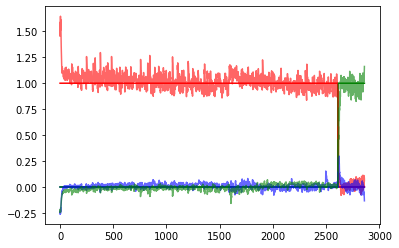

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 2849/3000 [13:20:27<37:58, 15.09s/it]

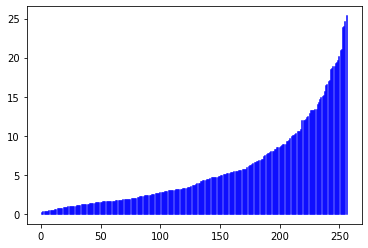

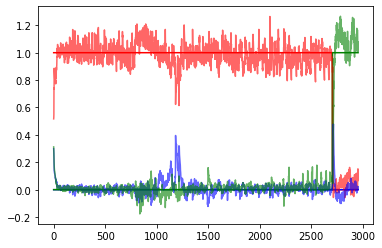

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 2854/3000 [13:22:25<44:14, 18.18s/it]

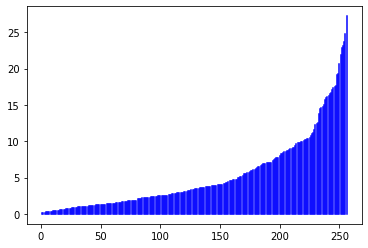

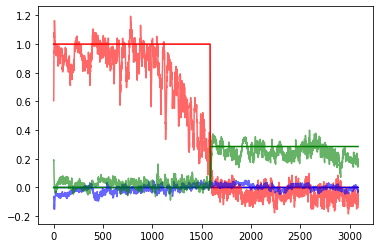

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 2859/3000 [13:23:45<37:01, 15.75s/it]

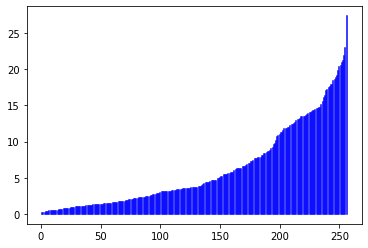

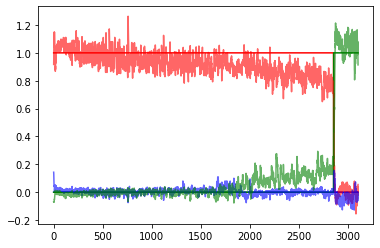

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 2864/3000 [13:25:01<34:27, 15.20s/it]

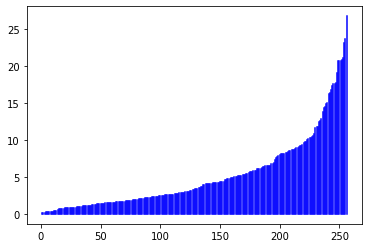

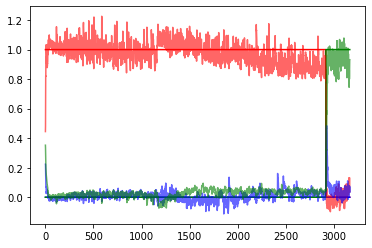

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 2869/3000 [13:26:20<33:39, 15.42s/it]

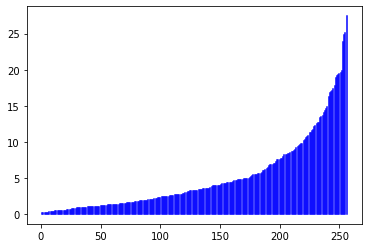

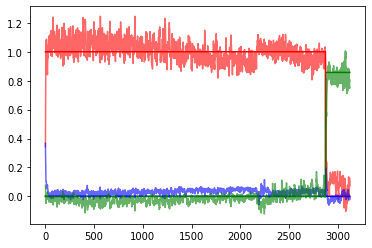

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 2874/3000 [13:27:38<31:45, 15.12s/it]

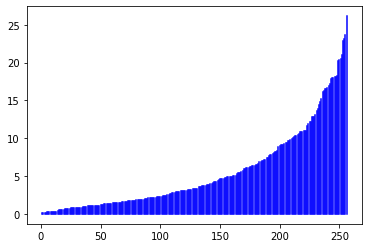

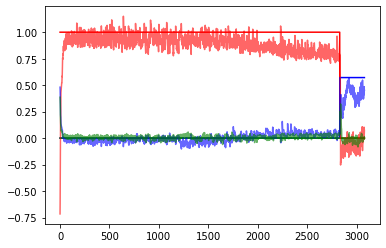

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 2879/3000 [13:28:54<29:52, 14.82s/it]

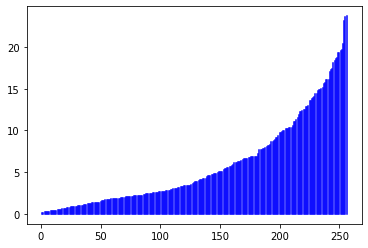

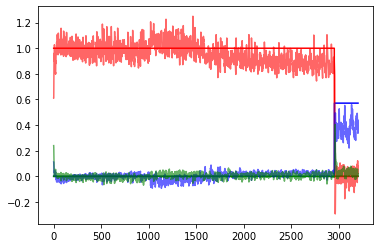

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 2884/3000 [13:30:09<28:18, 14.64s/it]

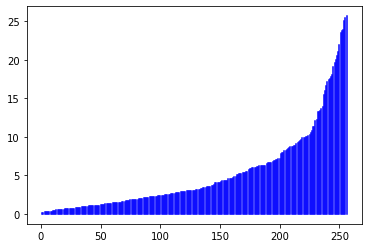

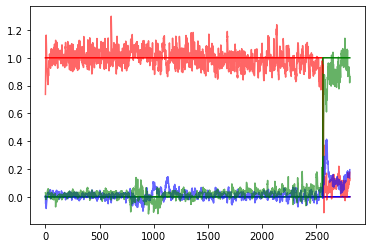

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 2889/3000 [13:31:25<26:55, 14.56s/it]

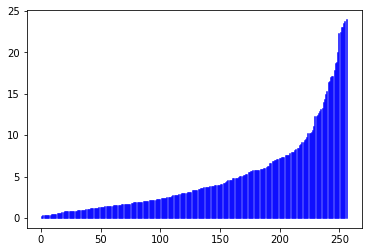

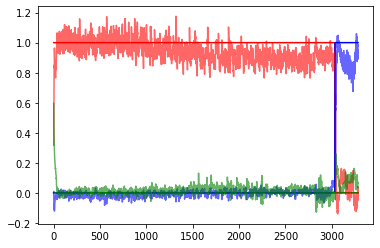

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 2894/3000 [13:32:41<26:15, 14.86s/it]

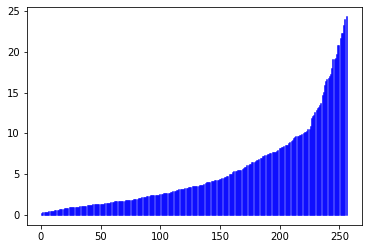

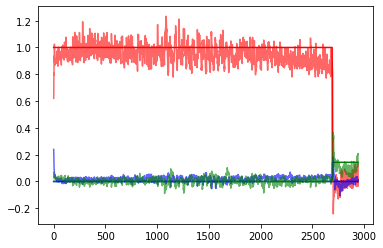

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 2899/3000 [13:33:59<25:27, 15.12s/it]

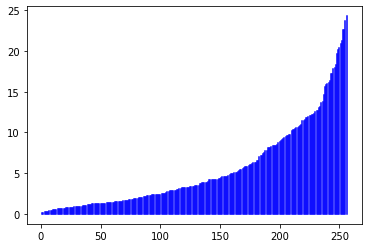

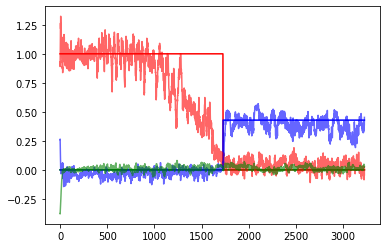

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 2904/3000 [13:35:58<28:50, 18.02s/it]

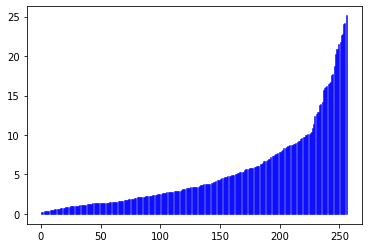

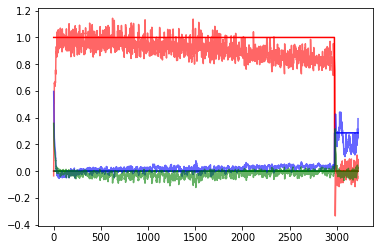

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 2909/3000 [13:37:21<24:55, 16.43s/it]

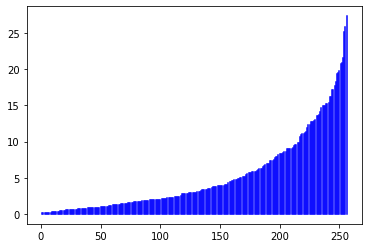

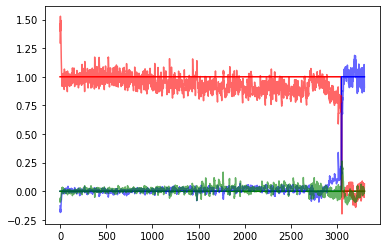

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 2914/3000 [13:38:43<22:57, 16.02s/it]

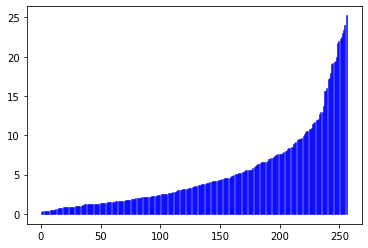

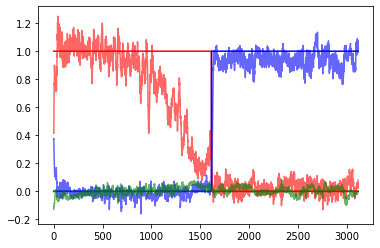

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 2919/3000 [13:40:08<21:55, 16.24s/it]

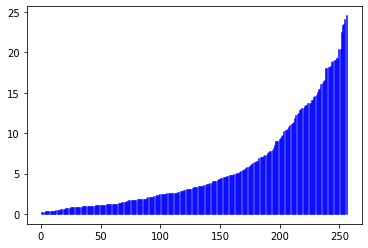

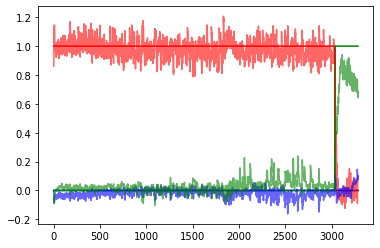

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 2924/3000 [13:41:32<20:39, 16.31s/it]

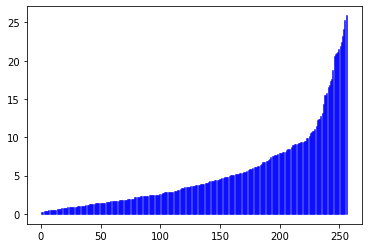

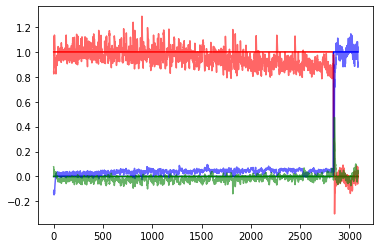

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 2929/3000 [13:42:54<19:06, 16.15s/it]

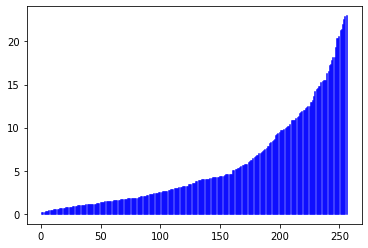

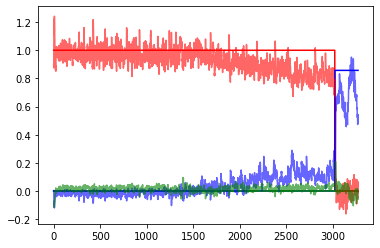

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 2934/3000 [13:44:19<17:57, 16.33s/it]

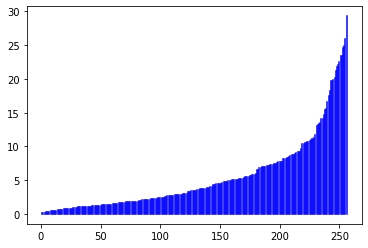

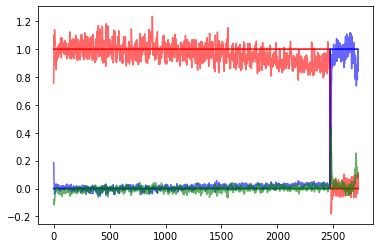

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 2939/3000 [13:45:44<16:37, 16.36s/it]

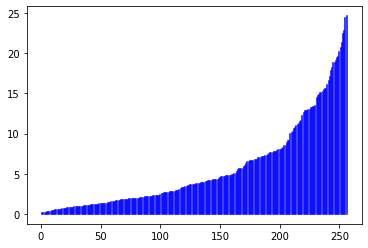

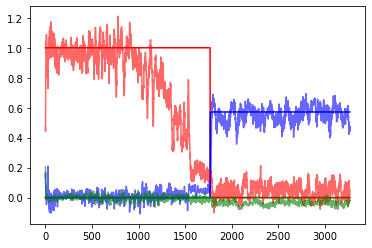

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 2944/3000 [13:47:06<14:55, 15.99s/it]

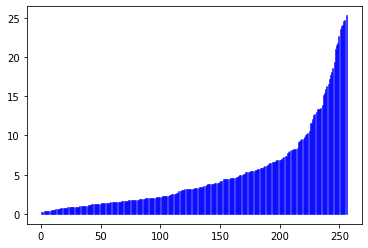

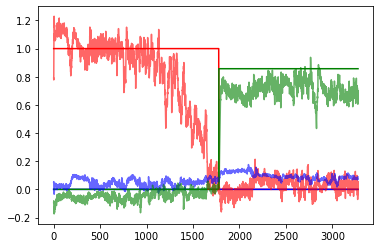

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 2949/3000 [13:48:30<13:41, 16.11s/it]

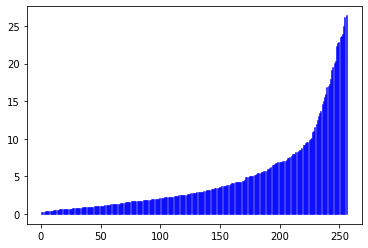

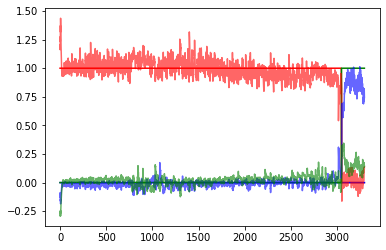

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 2954/3000 [13:50:32<14:32, 18.96s/it]

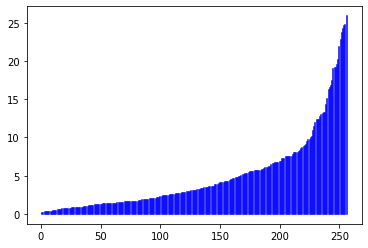

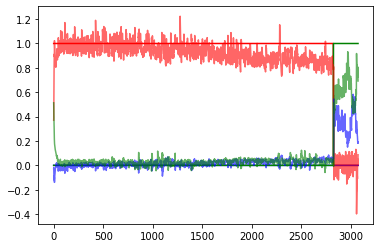

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 2959/3000 [13:51:58<11:38, 17.04s/it]

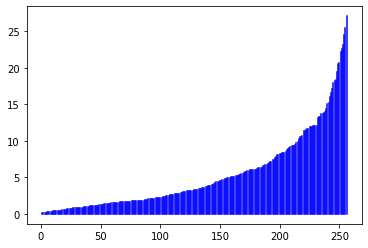

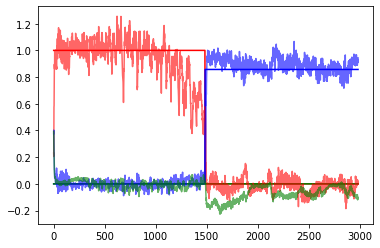

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 2964/3000 [13:53:20<09:45, 16.25s/it]

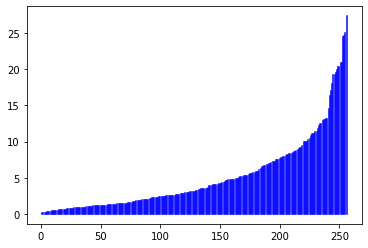

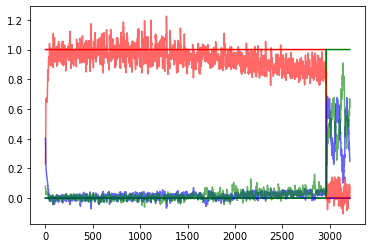

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 2969/3000 [13:54:45<08:18, 16.07s/it]

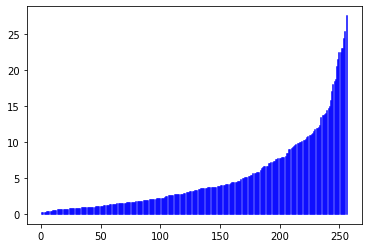

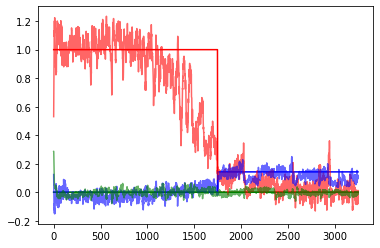

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 2974/3000 [13:56:08<06:51, 15.84s/it]

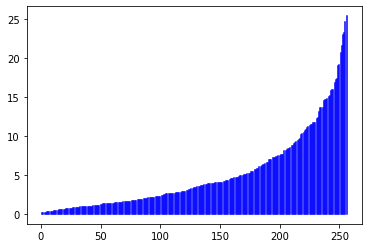

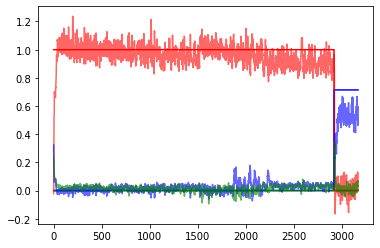

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 2979/3000 [13:57:28<05:23, 15.39s/it]

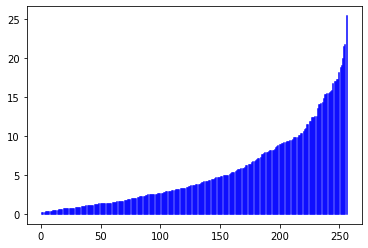

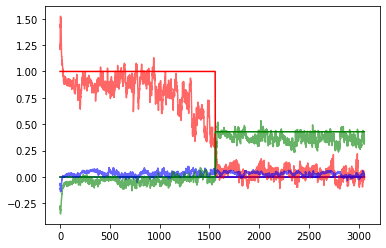

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 2984/3000 [13:58:49<04:08, 15.55s/it]

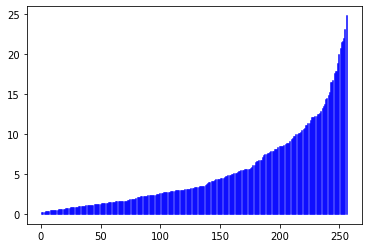

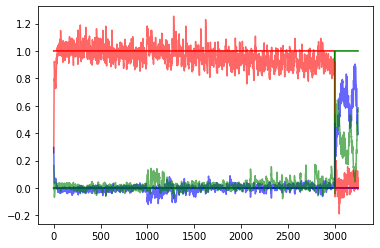

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 2989/3000 [14:00:09<02:51, 15.58s/it]

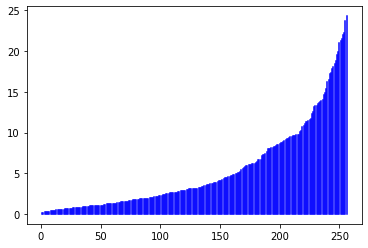

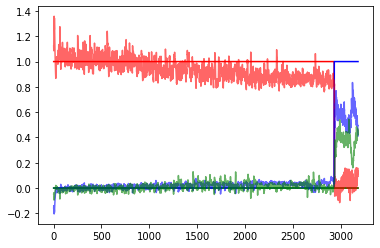

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 2994/3000 [14:01:30<01:34, 15.76s/it]

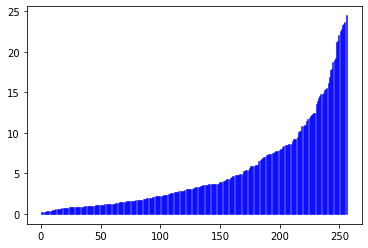

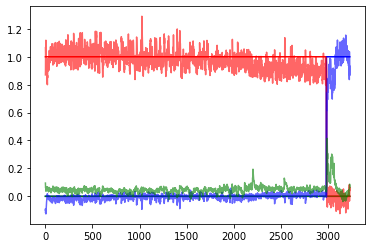

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 2999/3000 [14:02:51<00:15, 15.27s/it]

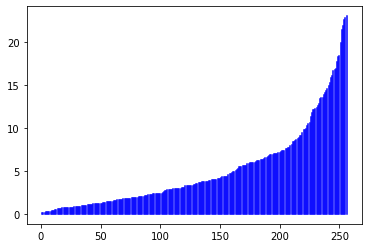

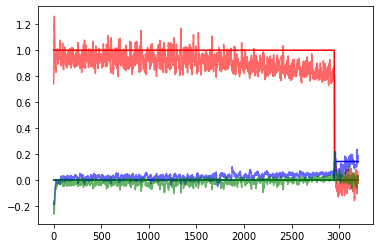

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3000/3000 [14:03:47<00:00, 16.88s/it]

Finished Training


In [14]:
from cgtasknet.instruments.instrument_accuracy_network import correct_answer
from norse.torch import LIFAdExState
name = f"weights/weights_{neuron_parameters.alpha}_N_{hidden_size}_without_square"
running_loss = 0
sigma = 0

for i in tqdm(range(number_of_epochs)):
    if i == 500:
        sigma = 0.2
    if i == 1000:
        sigma = 0.5
    inputs, target_outputs = Task.dataset(number_of_tasks)

    inputs[:, :, 1:3] += every_bath_generator(
        0, sigma, inputs.shape[0], inputs.shape[1], 2
    )
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    loss_mask = torch.zeros_like(target_outputs)
    mask_indexes_signes = torch.where(target_outputs[:, :, 0] == 1)
    mask_indexes_zeros = torch.where(target_outputs[:, :, 0] == 0)
    loss_mask[mask_indexes_signes[0], mask_indexes_signes[1], :] = .1
    loss_mask[mask_indexes_zeros[0], mask_indexes_zeros[1], :] = 1
    optimizer.zero_grad()
    init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
    # forward + backward + optimize
    outputs, _, state = model(
        inputs,
        init_state,
    )

    loss = criterion(outputs, target_outputs, loss_mask, state)
    loss.backward()
    optimizer.step()

    # print statistics
    running_loss = loss.item()
    if i % 50 == 49:
        with open("log_multy.txt", "a") as f:
            f.write("epoch: {:d} loss: {:0.5f}\n".format(i + 1, running_loss / 10))
        running_loss = 0.0
        with torch.no_grad():
            torch.save(
                model.state_dict(),
                name + f'_{i}_',
            )
    if i % 50== 49:

        result = 0
        for j in range(10):
            try:
                del inputs
            except:
                pass
            try:
                del target_outputs
            except:
                pass
            try:
                del outputs
            except:
                pass
            torch.cuda.empty_cache()
            inputs, target_outputs = Task.dataset(1, delay_between=0)
            inputs[:, :, 1:3] += every_bath_generator(
                0, 0.01, inputs.shape[0], inputs.shape[1], 2
            )
            inputs = torch.from_numpy(inputs).type(torch.float).to(device)
            target_outputs = (
                torch.from_numpy(target_outputs).type(torch.float).to(device)
            )
            outputs = model(
                inputs,
                init_state,
            )[0]
            type_tasks = list(
                np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1]
            )
            answers = can.run(
                target_outputs[50:, :, 0].cpu(),
                outputs[50:, :, 0].cpu(),
                target_outputs[50:, :, 1:].cpu(),
                outputs[50:, :, 1:].cpu(),
                type_tasks,
            )
            result += answers

        accuracy = result / batch_size / 10 * 100
        with open("accuracy_multy.txt", "a") as f:
            f.write(f"ecpoch = {i}; correct/all = {accuracy}\n")
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
        del states
    except:
        pass
    if i % 5 == 4:
        check_mean_fr()
    torch.cuda.empty_cache()
print("Finished Training")

0


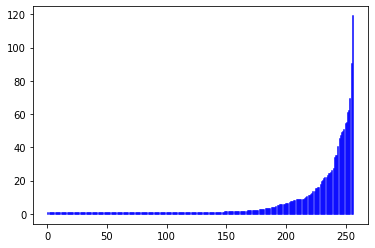

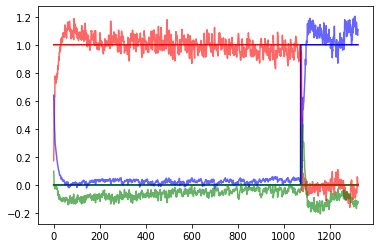

1


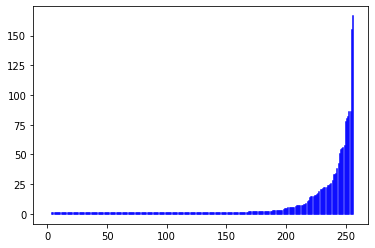

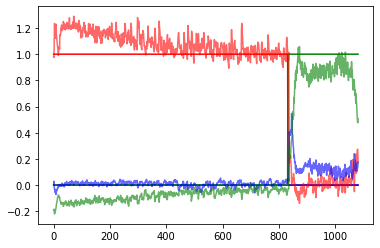

2


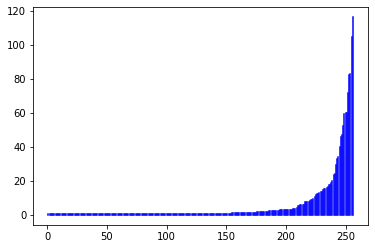

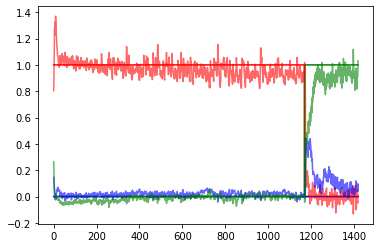

3


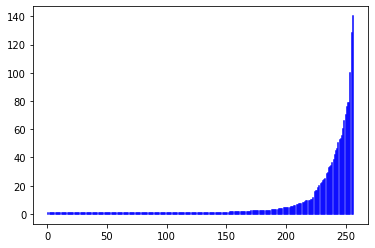

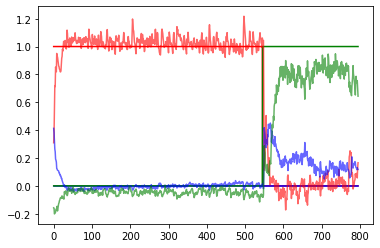

4


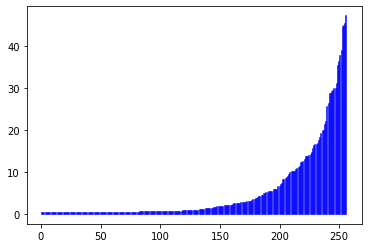

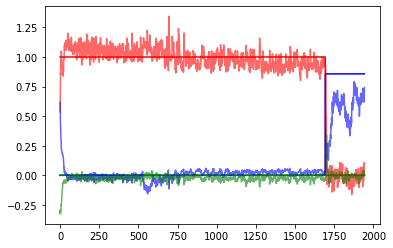

5


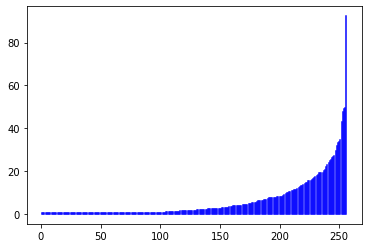

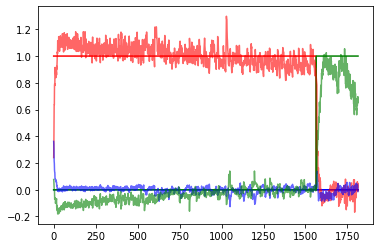

6


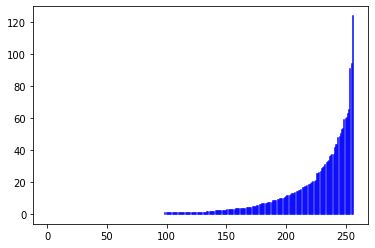

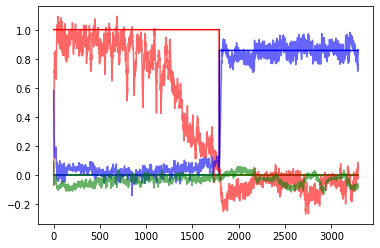

7


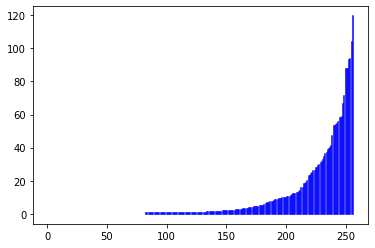

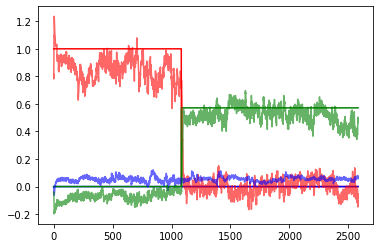

8


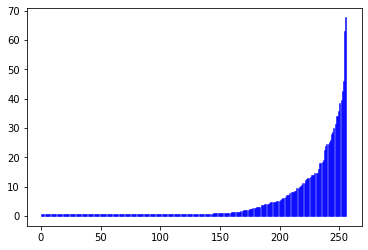

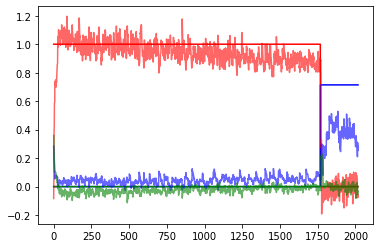

9


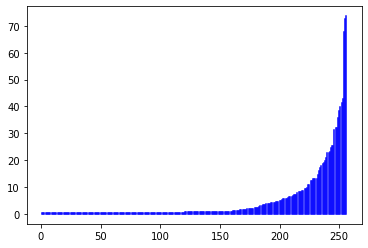

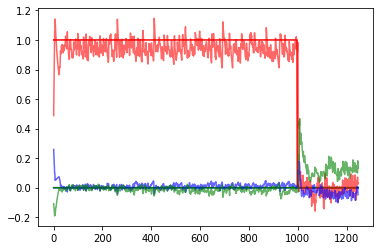

10


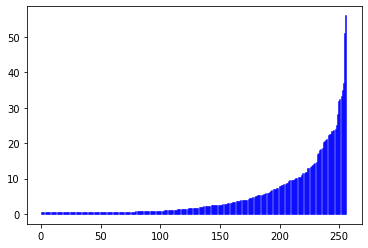

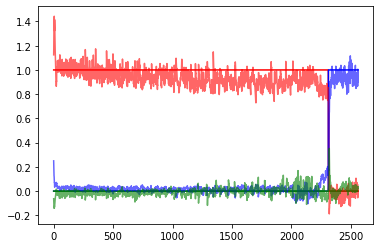

11


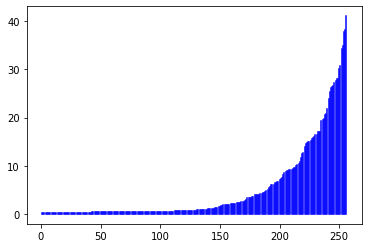

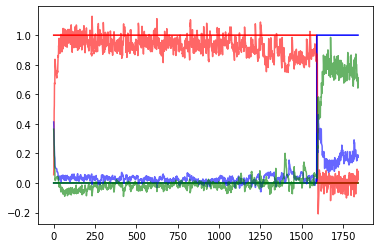

In [15]:
for i in range(len(tasks)):
    test = MultyReduceTasks(
        tasks=task_dict,
        batch_size=1,
        delay_between=0,
        enable_fixation_delay=True,
        mode="random",
        task_number=i
    )
    print(i)
    check_mean_fr(test)

In [16]:
model.save_states = True
sorted_tasks = sorted(tasks)
re_word = "Go"
choices_tasks = []
values_tasks = []
for i in range(len(sorted_tasks)):
    if re_word in sorted_tasks[i]:
        values_tasks.append(i)
    else:
        choices_tasks.append(i)
can = CorrectAnswerNetwork(choices_tasks, values_tasks, 0.15)
inputs, target_outputs = Task.dataset(1, delay_between=0)
inputs[:, :, 1:3] += every_bath_generator(0, 0.01, inputs.shape[0], inputs.shape[1], 2)
inputs = torch.from_numpy(inputs).type(torch.float).to(device)
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
outputs, states = model(
    inputs,
    init_state,
    additional_current=additional_current_generate(
        len(inputs),
        batch_size,
        hidden_size,
    ).to(device),
)
type_tasks = list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])
answers = can.run(
    target_outputs[:, :, 0].cpu(),
    outputs[:, :, 0].cpu(),
    target_outputs[:, :, 1:].cpu(),
    outputs[:, :, 1:].cpu(),
    type_tasks,
)
result += answers

NameError: name 'additional_current_generate' is not defined

In [ ]:
inputs, target_outputs = Task.dataset(1, delay_between=0)
inputs = torch.from_numpy(inputs).type(torch.float).to(device)# * 0
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
outputs, states, _ = model(
    inputs,
    init_state,
        
    )
task_number = sorted_tasks.index('RomoTask1')

outputs = outputs.cpu().detach()
target_outputs = target_outputs.detach().cpu()
s = []
for i in range(len(states)):
    s.append(states[i].z)
s = torch.stack(s).detach().cpu()

plt.plot(target_outputs[:, task_number, 0].cpu())
plt.plot(outputs[:, task_number, 0].detach().cpu())
plt.show()
plt.close()
plt.plot(target_outputs[:, task_number, 1].cpu())
plt.plot(outputs[:, task_number, 1].detach().cpu())
plt.show()
plt.close()
plt.plot(target_outputs[:, task_number, 2].cpu())
plt.plot(outputs[:, task_number, 2].detach().cpu())
plt.show()
plt.close()
plt.figure(figsize=(20, 10))
plt.imshow(s[:, task_number, :].T, aspect="auto", interpolation="nearest")

In [ ]:
for_sort = torch.sort(torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).indices
s_new = torch.zeros_like(s)
for i in range(hidden_size):
    s_new[:, :, i] = s[:, :, for_sort[i]]
plt.imshow(s_new[:, task_number, :].T, aspect="auto", interpolation="nearest", origin='lower',)

In [ ]:
# spike_sequence = torch.stack(spike_sequence)
freq_sequence = torch.mean(torch.mean(spike_sequence, axis=0), axis=0)

# freq_sequence = sort_elemnts_by_another (freq_sequence, freq_sequence)
print(f"{spike_sequence.shape=}")
print(f"{freq_sequence.shape=}")
for i in range(len(freq_sequence)):
    plt.plot([i + 1] * 2, [0, freq_sequence[i]], c="b")
plt.show()
plt.close()
model.save_states = False

In [ ]:
from cgtasknet.instruments.instrument_subgroups import sort_elemnts_by_another

frequency = torch.mean(torch.mean(s, axis=0), axis=0) * 1e3
frequency = sort_elemnts_by_another(freq_sequence, frequency)
for i in range(len(frequency)):
    plt.plot([i + 1] * 2, [0, frequency[i]], c="b")

In [ ]:
result

In [ ]:
list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])

# Тестовая функция

In [ ]:
def test_network(
        test_sigma: float, number_of_trials: int = 100, plot_data: bool = True
):
    result = 0
    for j in tqdm(range(number_of_trials)):
        try:
            del inputs
        except:
            pass
        try:
            del target_outputs
        except:
            pass
        try:
            del outputs
        except:
            pass
        torch.cuda.empty_cache()
        inputs, target_outputs = Task.dataset(1, delay_between=0)
        inputs[:, :, :3] += every_bath_generator(
            0, test_sigma, inputs.shape[0], inputs.shape[1], 3
        )
        inputs = torch.from_numpy(inputs).type(torch.float).to(device)
        target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
        outputs = model(inputs)[0]
        answers = correct_answer(
            outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
        )
        result += torch.sum(answers).item()

    accuracy = result / batch_size / number_of_trials * 100
    if plot_data:
        plot_results(inputs, target_outputs, outputs)
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    return accuracy

# Тестирование
```  np.random.normal(0, 0.01, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.01, 1)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.05, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.05, 10)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.1, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.1)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.5, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.5)
print(accuracy)

In [ ]:
result = 0
for j in tqdm(range(1)):
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    inputs, target_outputs = Task.dataset(1, delay_between=0)
    inputs[:, :, :3] += np.random.normal(0, 0.5, size=inputs[:, :, :3].shape)
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    outputs = model(inputs)[0]
    answers = correct_answer(
        outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
    )
    result += torch.sum(answers).item()

accuracy = result / batch_size / 100 * 100
print(accuracy)
plot_results(inputs, target_outputs, outputs)
try:
    del inputs
except:
    pass
try:
    del target_outputs
except:
    pass
try:
    del outputs
except:
    pass
torch.cuda.empty_cache()

In [ ]:
result = 0
for j in tqdm(range(1)):
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    inputs, target_outputs = Task.dataset(1, delay_between=0)
    inputs[:, :, :3] += np.random.normal(0, 0.7, size=inputs[:, :, :3].shape)
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    outputs = model(inputs)[0]
    answers = correct_answer(
        outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
    )
    result += torch.sum(answers).item()

accuracy = result / batch_size / 100 * 100
print(accuracy)
plot_results(inputs, target_outputs, outputs)
try:
    del inputs
except:
    pass
try:
    del target_outputs
except:
    pass
try:
    del outputs
except:
    pass
torch.cuda.empty_cache()

In [ ]:
inputs = 0
outputs = 0

In [ ]:
lines = []
with open("accuracy_multy.txt", "r") as f:
    while line := f.readline():
        lines.append(float(line.split("=")[2]))

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 5))
plt.plot([*range(9, 3000, 50)], lines, ".", linestyle="--", markersize=5)
plt.ylabel(r"Accuracy%")
plt.xlabel(r"Epochs")

In [ ]:
start_sigma = 0
stop_sigma = 2
step_sigma = 0.05
sigma_array = np.arange(start_sigma, stop_sigma, step_sigma)
for test_sigma in tqdm(sigma_array):
    result = 0
    for j in range(20):
        try:
            del inputs
        except:
            pass
        try:
            del target_outputs
        except:
            pass
        try:
            del outputs
        except:
            pass
        torch.cuda.empty_cache()
        inputs, target_outputs = Task.dataset(1, delay_between=0)
        inputs[:, :, 1:3] += np.random.normal(
            0, test_sigma, size=inputs[:, :, 1:3].shape
        )
        inputs = torch.from_numpy(inputs).type(torch.float).to(device)
        target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
        outputs = model(inputs)[0]
        type_tasks = list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])
        answers = can.run(
            target_outputs[50:, :, 0].cpu(),
            outputs[50:, :, 0].cpu(),
            target_outputs[50:, :, 1:].cpu(),
            outputs[50:, :, 1:].cpu(),
            type_tasks,
        )
        result += answers
    accuracy = result / batch_size / 20 * 100
    with open("accuracy_vs_noise.txt", "a") as f:
        f.write(f"noise={test_sigma}:accuracy={accuracy}\n")

In [ ]:
import matplotlib.patches as patches

plt.style.use("ggplot")


def parser(line_text: str) -> tuple:
    """
    Function parses text in form:
    ```v_name_1=v1:v_name_2:v2```
    and return (v1, v2)
    :param line_text:
    :return: (v1, v2)
    """
    line_text = line_text.split(":")
    print(line_text)
    v1 = line_text[0].split("=")[1]
    v2 = line_text[1].split("=")[1]
    return float(v1), float(v2)


x, y = [], []
# with open('accuracy_vs_noise.txt', 'r') as f:
with open(
        r"accuracy_vs_noise.txt",
        "r",
) as f:
    while line := f.readline():
        t_x, t_y = parser(line)
        x.append(t_x)
        y.append(t_y)

fig, ax = plt.subplots()
ax.plot(x, y, ".", linestyle="--")
# ax.plot([.5]*2, [50, 100])
ax.set_ylabel("Accuracy,%")
ax.set_xlabel(r"$\sigma$")
ax.add_patch(
    patches.Rectangle(
        (0, 50), 0.5, 50, edgecolor="grey", facecolor="grey", alpha=0.5, fill=True
    )
)

plt.show()
plt.close()

In [ ]:
batch_size = 1
number_of_tasks = 1
romo_parameters = RomoTaskRandomModParameters(
    romo=RomoTaskParameters(
        delay=0.6,
        positive_shift_delay_time=0.0,
        trial_time=0.1,
        positive_shift_trial_time=0.2,
    ),
)
dm_parameters = DMTaskRandomModParameters(
    dm=DMTaskParameters(trial_time=0.6, positive_shift_trial_time=0.0)
)
ctx_parameters = CtxDMTaskParameters(dm=dm_parameters.dm)
go_parameters = GoTaskRandomModParameters(
    go=GoTaskParameters(
        trial_time=0.1,
        positive_shift_trial_time=0.8,
    )
)
gort_parameters = GoRtTaskRandomModParameters(
    go=GoRtTaskParameters(
        trial_time=0.1,
        positive_shift_trial_time=0.8,
    )
)
godl_parameters = GoDlTaskRandomModParameters(
    go_dl=GoDlTaskParameters(
        go=GoTaskParameters(trial_time=0.1, positive_shift_trial_time=0.2),
        delay=0.1,
        positive_shift_delay_time=1.4,
    )
)
sigma = 0.5
tasks = [
    "RomoTask1",
    "RomoTask2",
    "DMTask1",
    "DMTask2",
    "CtxDMTask1",
    "CtxDMTask2",
    "GoTask1",
    "GoTask2",
    "GoRtTask1",
    "GoRtTask2",
    "GoDlTask1",
    "GoDlTask2",
]
task_dict = {
    tasks[0]: romo_parameters,
    tasks[1]: romo_parameters,
    tasks[2]: dm_parameters,
    tasks[3]: dm_parameters,
    tasks[4]: ctx_parameters,
    tasks[5]: ctx_parameters,
    tasks[6]: go_parameters,
    tasks[7]: go_parameters,
    tasks[8]: gort_parameters,
    tasks[9]: gort_parameters,
    tasks[10]: godl_parameters,
    tasks[11]: godl_parameters,
}

tasks_sequence = [
    MultyReduceTasks(
        tasks=task_dict,
        batch_size=batch_size,
        delay_between=0,
        enable_fixation_delay=True,
        task_number=i,
    )
    for i in range(len(tasks))
]

In [ ]:
tasks_and_names = dict([*zip(sorted(tasks), tasks_sequence)])
chosed_tasks = ["CtxDMTask1", "GoTask1", "GoRtTask1", "GoDlTask1", "RomoTask1"]
chosed_tasks_dict = {}
for key, item in tasks_and_names.items():
    if key in chosed_tasks:
        chosed_tasks_dict[key] = item
print("Tasks for PCA")
print(chosed_tasks_dict)

In [ ]:
import matplotlib.pyplot as plt
from cgtasknet.instruments.instrument_accuracy_network import correct_answer
from cgtasknet.net.states import LIFAdExInitState

name = f"Train_dm_and_romo_task_reduce_lif_adex_without_refrac_random_delay_long_a_alpha_{neuron_parameters.alpha}_N_{hidden_size}"
init_state = LIFAdExInitState(batch_size, hidden_size, device=device)
data, t_outputs = tasks_and_names["DMTask1"].dataset(2, delay_between=0)
data[:, :, 1:3] += every_bath_generator(0, sigma, data.shape[0], data.shape[1], 2)
data = torch.from_numpy(data).type(torch.float).to(device)
out, states = model(data, init_state.random_state())
out = out.detach().cpu().numpy()
plt.figure()
plt.plot(t_outputs[:, 0, 0])
plt.plot(t_outputs[:, 0, 1])
plt.plot(t_outputs[:, 0, 2])

plt.figure()
plt.plot(out[:, 0, 0])
plt.plot(out[:, 0, 1])
plt.plot(out[:, 0, 2])

In [ ]:

for name, param in model.named_parameters():
    if name == 'alif.recurrent_weights':
        final_parameters = torch.clone(param.detach().cpu())


In [ ]:
eigs_final = torch.eig(final_parameters)[0]
eigs_initial = torch.eig(initial_parameters)[0]

In [ ]:
x_final = eigs_final[:, 0]
y_final = eigs_final[:, 1]

x_initial = eigs_initial[:, 0]
y_initial = eigs_initial[:, 1]

In [ ]:
plt.scatter(x_initial, y_initial)
plt.scatter(x_final, y_final)

In [ ]:
Task_test = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
    task_number=0
)

In [ ]:
model.save_states = True
init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
inputs, target_outputs = Task.dataset(2)#Task_test.dataset(1)

inputs = torch.from_numpy(inputs).type(torch.float).to(device)
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
result = model(inputs, init_state,)
#del inputs, init_state
torch.cuda.empty_cache()
states = result[-1]
spikes = []
for state in states:
    spikes.append(state.detach().cpu())
    
s = torch.stack(spikes)
freq_sequence_new = torch.sort(
    torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).values
for i in range(len(freq_sequence_new)):
    plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")

In [ ]:
freq_sequence_new[105] * 1e3

In [ ]:
last_fix = torch.where(inputs[:, :, 0] == 1)[0][-1].item()
s = torch.stack(spikes)[:last_fix, ...]
freq_sequence_new = torch.sort(
    torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).values
for i in range(len(freq_sequence_new)):
    plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")

In [ ]:
index=10
plt.plot(target_outputs[:, index, 0].detach().cpu(), c='r')
plt.plot(target_outputs[:, index, 1].detach().cpu(), c='b')
plt.plot(target_outputs[:, index, 2].detach().cpu(), c='g')

plt.plot(result[0][:, index, 0].detach().cpu(), c='r', alpha=.6
        )
plt.plot(result[0][:, index, 1].detach().cpu(), c='b', alpha=.6
        )
plt.plot(result[0][:, index, 2].detach().cpu(), c='g', alpha=.6
        )


plt.plot(inputs[:, index, 0].detach().cpu() + 1.5)

plt.plot(inputs[:, index, 1].detach().cpu() + 1.5)
plt.plot(inputs[:, index, 2].detach().cpu() + 1.5)
plt.yticks([])

In [ ]:
plt.plot(torch.sort(torch.mean(final_parameters, axis=1)).values)
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)

In [ ]:
torch.mean(final_parameters, axis=1).shape

In [ ]:
torch.sort(torch.mean(final_parameters, axis=1))

In [ ]:
torch.mean(torch.zeros((10, 20)), axis=1).shape

In [ ]:
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)
plt.plot(torch.sort(torch.mean(final_parameters, axis=1)).values)

In [ ]:
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)